In [1]:
#####################
# Train & Eval
#####################

# coding=utf-8
# Copyright 2021 The Google Research Authors.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Lint as: python3
"""Trains TFT based on a defined set of parameters.
Uses default parameters supplied from the configs file to train a TFT model from
scratch.

Usage:
python3 script_train_fixed_params {expt_name} {output_folder}

Command line args:
  expt_name: Name of dataset/experiment to train.
  output_folder: Root folder in which experiment is saved
"""

import argparse
import datetime as dte
import os,sys
sys.path.append('/tf/crypto_prediction_ml_dl/script')
sys.path.append('/tf/crypto_prediction_ml_dl/notebook/TFT_models')

import data_formatters.base
import expt_settings.configs
import libs.hyperparam_opt
import libs.tft_custom_model
import libs.utils as utils
import numpy as np
import pandas as pd
import tensorflow.compat.v1 as tf


import tensorflow
print("Num GPUs Available: ", len(tensorflow.config.list_physical_devices('GPU')))


ExperimentConfig = expt_settings.configs.ExperimentConfig
HyperparamOptManager = libs.hyperparam_opt.HyperparamOptManager
ModelClass = libs.tft_custom_model.TemporalFusionTransformer
tf.experimental.output_all_intermediates(True)

2023-11-20 14:06:48.022073: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-11-20 14:06:48.046611: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


Num GPUs Available:  1


2023-11-20 14:06:49.030040: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:06:49.033745: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:06:49.033858: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

In [2]:
def main_train(expt_name,
         use_gpu,
         restart_opt,
         model_folder,
        hyperparam_iterations,
         data_csv_path,
         data_formatter,
         use_testing_mode=False):
    """Trains tft based on defined model params.

    Args:
        expt_name: Name of experiment
        use_gpu: Whether to run tensorflow with GPU operations
        restart_opt: Whether to run hyperparameter optimization from scratch
        model_folder: Folder path where models are serialized
        hyperparam_iterations: Number of iterations of random search
        data_csv_path: Path to csv file containing data
        data_formatter: Dataset-specific data fromatter (see
          expt_settings.dataformatter.GenericDataFormatter)
    """

    if not isinstance(data_formatter, data_formatters.base.GenericDataFormatter):
        raise ValueError(
            "Data formatters should inherit from" +
            "AbstractDataFormatter! Type={}".format(type(data_formatter)))

    # Tensorflow setup
    default_keras_session = tf.keras.backend.get_session()

    if use_gpu:
        tf_config = utils.get_default_tensorflow_config(tf_device="gpu", gpu_id=0)

    else:
        tf_config = utils.get_default_tensorflow_config(tf_device="cpu")
        
        
    print("### Running hyperparameter optimization for {} ###".format(expt_name))
    print("Loading & splitting data...")
    raw_data = pd.read_csv(data_csv_path, index_col=0)
    train, valid, test = data_formatter.split_data(raw_data)
    train_samples, valid_samples = data_formatter.get_num_samples_for_calibration(
    )


    # Sets up default params    
    fixed_params = data_formatter.get_experiment_params()
    param_ranges = ModelClass.get_hyperparm_choices()
    fixed_params["model_folder"] = model_folder
    
    print("*** Loading hyperparm manager ***")
    opt_manager = HyperparamOptManager(param_ranges, fixed_params, model_folder)

    success = opt_manager.load_results()
    if success and not restart_opt:
        print("Loaded results from previous training")
    else:
        print("Creating new hyperparameter optimisation")
        opt_manager.clear()

        
        
    print("*** Running calibration ***")
    while len(opt_manager.results.columns) < hyperparam_iterations:
        print("# Running hyperparam optimisation {} of {} for {}".format(
            len(opt_manager.results.columns) + 1, hyperparam_iterations, "TFT"))

        tf.reset_default_graph()
        with tf.Graph().as_default(), tf.Session(config=tf_config) as sess:

          tf.keras.backend.set_session(sess)

          params = opt_manager.get_next_parameters()
          model = ModelClass(params, use_cudnn=use_gpu)

          if not model.training_data_cached():
            model.cache_batched_data(train, "train", num_samples=train_samples)
            model.cache_batched_data(valid, "valid", num_samples=valid_samples)

          sess.run(tf.global_variables_initializer())
          model.fit()

          val_loss = model.evaluate()

          if np.allclose(val_loss, 0.) or np.isnan(val_loss):
            # Set all invalid losses to infintiy.
            # N.b. val_loss only becomes 0. when the weights are nan.
            print("Skipping bad configuration....")
            val_loss = np.inf

          opt_manager.update_score(params, val_loss, model)

          tf.keras.backend.set_session(default_keras_session)

    print("*** Running tests ***")
    tf.reset_default_graph()
    with tf.Graph().as_default(), tf.Session(config=tf_config) as sess:
        tf.keras.backend.set_session(sess)
        best_params = opt_manager.get_best_params()
        model = ModelClass(best_params, use_cudnn=use_gpu)

        model.load(opt_manager.hyperparam_folder)

        print("Computing best validation loss")
        val_loss = model.evaluate(valid)

        print("Computing test loss")
        output_map = model.predict_with_custom_loss(test, return_targets=True)

        targets = output_map["targets"]
        results = output_map["results"]

        tf.keras.backend.set_session(default_keras_session)

    print("Hyperparam optimisation completed @ {}".format(dte.datetime.now()))
    print("Best validation loss = {}".format(val_loss))
    print("Params:")

    for k in best_params:
        print(k, " = ", best_params[k])

    return output_map

In [3]:
dataset_name = 'crypto_day_all'
folder = '.'
use_tensorflow_with_gpu = 'yes'
restart = 'yes'


print("Using output folder {}".format(folder))

config = ExperimentConfig(dataset_name, folder)
formatter = config.make_data_formatter()

# Customise inputs to main() for new datasets.
output_map = main_train(
  expt_name=dataset_name,
  use_gpu=use_tensorflow_with_gpu,
  restart_opt=restart,
  model_folder=os.path.join(config.model_folder, "main"),
  hyperparam_iterations=config.hyperparam_iterations,
  data_csv_path=config.data_csv_path,
  data_formatter=formatter)

Using output folder .


2023-11-20 14:07:01.712099: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:07:01.712255: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:07:01.712351: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

Selecting GPU ID=0
### Running hyperparameter optimization for crypto_day_all ###
Loading & splitting data...
Formatting train-valid-test splits.
Setting scalers with training data...
*** Loading hyperparm manager ***
Loading results from ./saved_models/crypto_day_all/main
Creating new hyperparameter optimisation
*** Running calibration ***
# Running hyperparam optimisation 1 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.9
# hidden_layer_size = 80
# learning_rate = 0.01
# max_gradient_norm = 100.0
# minibatch_size = 256
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <Inpu

2023-11-20 14:07:02.332365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_2/stack_1' id:12 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_2/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:02.334773: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_2/stack_2' id:13 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_2/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

2023-11-20 14:07:02.533363: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_8/kernel/Assign' id:380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_8/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_8/kernel, TemporalFusionTransformer/time_distributed_8/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:02.539812: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_12/stack_1' id:398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_12/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:07:02.739775: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_1' id:671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 18>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:02.745337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_2' id:672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:07:02.943021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/bias/Assign' id:892 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/bias, TemporalFusionTransformer/time_distributed_21/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:02.953694: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:07:03.150361: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:03.162505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:07:03.647063: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_4/gamma/Assign' id:2083 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_4/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_4/gamma, TemporalFusionTransformer/layer_normalization_4/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:03.691978: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 sh

2023-11-20 14:07:04.073547: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:04.097582: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_2' id:2561 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:07:05.098937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_12/beta/Assign' id:3678 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_12/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_12/beta, TemporalFusionTransformer/layer_normalization_12/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:05.152354: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:07:06.265585: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_78/kernel/Assign' id:4586 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_78/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_78/kernel, TemporalFusionTransformer/time_distributed_78/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:06.336725: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:07:07.798820: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_97/bias/Assign' id:5518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_97/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_97/bias, TemporalFusionTransformer/time_distributed_97/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:07.883336: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:07:09.519081: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_119/kernel/Assign' id:6545 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_119/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_119/kernel, TemporalFusionTransformer/time_distributed_119/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:09.620979: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:07:11.314393: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:11.534196: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_32/beta/Assign' id:7538 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_32/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_32/beta, TemporalFusionTransfo

2023-11-20 14:07:13.366546: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_152/kernel/Assign' id:8185 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_152/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_152/kernel, TemporalFusionTransformer/time_distributed_152/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:13.609462: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:07:15.531783: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign' id:9029 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/bias, TemporalFusionTransformer/cu_dnnlstm_1/bias/Initializer/concat)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:15.707618: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was chang

2023-11-20 14:07:17.762957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:17.889562: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:07:18.712438: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80, 28)]         0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
          

 tf_op_layer_TemporalFusion  [(None, 1, 80, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 80)               192080    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 80)                6400      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_34 (Activation)  (None, 30, 80)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 80)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 80)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 80)               0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 80)               0         ['time_distributed_152[0][0]']
                                                                                                  
 activatio

 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 80)               6480      ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 80)               6480      ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 80)               6480      ['activation_33[0][0]']       
 Distributed)                                                                                     
          

 dropout_30 (Dropout)        (None, 30, 80)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 80)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 80)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 80)               0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 80)               0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_3

 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 80)               6480      ['dropout_17[0][0]']          
 istributed)                                                                                      
          

 time_distributed_127 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 80)               6480      ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 80)               6480      ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 80)               6480      ['dropout_31[0][0]']          
 Distribut

                                                                                                  
 multiply_16 (Multiply)      (None, 30, 80)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 80)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 80)               0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_

 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
          

 add_23 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (A

 layer_normalization_7 (Lay  (None, 30, 80)               160       ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 80)               160       ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 80)               160       ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 80)               160       ['add_10[0][0]']              
 yerNormal

                                                                                                  
 layer_normalization_35 (La  (None, 30, 80)               160       ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 80)               160       ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 80)                   6480      ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 80)                   6480      ['dropout_4[0][0]']           
          

                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 80)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 80)                   0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
          

                                                                                                  
 dense_47 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 80)               6480      ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 80)               6480      ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 80)                   0         ['dense_46[0][0]',            
          

                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (Tenso

                                                                                                  
 time_distributed_175 (Time  (None, 31, 80)               6480      ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 80)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 80)               6480      ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 80)               0         ['time_distributed_176[0][0]']
          

2023-11-20 14:07:19.492259: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:07:23.550543: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:24.365311: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_72/kernel/m/Assign' id:15704 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_72/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100


2023-11-20 14:07:30.748497: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-11-20 14:07:30.953094: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600


870/870 [==============================] - ETA: 0s - loss: 602.5984 - mae: 1.3817 - mse: 3.1717 - f1_metric: 0.4373

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:07:31.477154: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 602.5984 - mae: 1.3817 - mse: 3.1717 - f1_metric: 0.4373 - val_loss: 475.5381 - val_mae: 1.1728 - val_mse: 1.9787 - val_f1_metric: 3.7736e-09
Epoch 2/100
870/870 [==============================] - 0s 448us/sample - loss: 305.4095 - mae: 1.0376 - mse: 1.7073 - f1_metric: 0.3803 - val_loss: 365.4989 - val_mae: 1.5243 - val_mse: 3.3719 - val_f1_metric: 3.3898e-09
Epoch 3/100
870/870 [==============================] - 0s 423us/sample - loss: 235.8558 - mae: 0.9486 - mse: 1.4596 - f1_metric: 0.4064 - val_loss: 178.9614 - val_mae: 1.6013 - val_mse: 5.0817 - val_f1_metric: 3.1746e-09
Epoch 4/100
870/870 [==============================] - 0s 270us/sample - loss: 194.1322 - mae: 0.8967 - mse: 1.3438 - f1_metric: 0.4232 - val_loss: 201.4349 - val_mae: 1.5389 - val_mse: 4.5141 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 266us/sample - loss: 156.4562 - mae: 0.8674 - mse: 1.3069 - f1_metric: 

2023-11-20 14:07:45.125042: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:07:45.126303: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:07:45.126457: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

*** TemporalFusionTransformer params ***
# dropout_rate = 0.3
# hidden_layer_size = 160
# learning_rate = 0.01
# max_gradient_norm = 1.0
# minibatch_size = 128
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd_single', <D

2023-11-20 14:07:45.333873: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_6/bias/Assign' id:307 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_6/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_6/bias, TemporalFusionTransformer/time_distributed_6/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:45.341820: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_10/stack_1' id:320 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_10/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:07:45.539784: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_12/bias/Assign' id:541 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_12/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_12/bias, TemporalFusionTransformer/time_distributed_12/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:45.550335: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_16/stack_1' id:554 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_16/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:07:45.767003: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:45.780853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:07:46.183166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransformer/time_distributed_25/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:46.199016: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:07:47.128268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_46/kernel/Assign' id:1897 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_46/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_46/kernel, TemporalFusionTransformer/dense_46/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:47.198315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was

2023-11-20 14:07:47.839119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:47.870277: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:07:48.941341: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:49.070969: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_13/gamma/Assign' id:3866 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_13/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_13/gamma, TemporalFusionTran

2023-11-20 14:07:50.437804: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:50.521165: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:07:52.105106: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_101/bias/Assign' id:5711 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_101/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_101/bias, TemporalFusionTransformer/time_distributed_101/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:52.206052: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:07:54.046323: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/bias/Assign' id:6676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/bias, TemporalFusionTransformer/time_distributed_121/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:54.163847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:07:56.052822: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:56.305986: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_142/kernel/Assign' id:7674 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_142/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_142/kernel, TemporalFusionTransfo

2023-11-20 14:07:58.390948: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:07:58.514023: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:08:00.900579: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:01.260379: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_170/kernel/Assign' id:9342 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_170/kernel/Assign}} = AssignVariableOp[_has_manual_control_d

2023-11-20 14:08:03.531084: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:03.676143: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:08:04.236774: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:08:08.856164: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:09.675066: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_60/kernel/m/Assign' id:15668 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_60/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 877.1063 - mae: 2.2336 - mse: 12.1384 - f1_metric: 0.3633

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:08:15.748261: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 877.1063 - mae: 2.2336 - mse: 12.1384 - f1_metric: 0.3633 - val_loss: 128.6857 - val_mae: 0.5208 - val_mse: 0.3630 - val_f1_metric: 4.0000e-09
Epoch 2/100
870/870 [==============================] - 0s 472us/sample - loss: 152.2747 - mae: 1.0891 - mse: 1.5986 - f1_metric: 0.4123 - val_loss: 186.6175 - val_mae: 0.9158 - val_mse: 0.8564 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 1s 698us/sample - loss: 83.3228 - mae: 0.9577 - mse: 1.3383 - f1_metric: 0.3127 - val_loss: 53.0108 - val_mae: 0.6940 - val_mse: 0.6323 - val_f1_metric: 4.3478e-09
Epoch 4/100
870/870 [==============================] - 1s 706us/sample - loss: 46.2128 - mae: 0.9926 - mse: 1.5360 - f1_metric: 0.3594 - val_loss: 35.8574 - val_mae: 0.1662 - val_mse: 0.0388 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 467us/sample - loss: 33.6124 - mae: 0.9958 - mse: 1.5985 - f1_metric: 0.374

Optimal model found, updating
Model saved to: ./saved_models/crypto_day_all/main/TemporalFusionTransformer.ckpt
# Running hyperparam optimisation 3 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.2
# hidden_layer_size = 20
# learning_rate = 0.01
# max_gradient_norm = 1.0
# minibatch_size = 128
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERV

2023-11-20 14:08:37.400339: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:08:37.400884: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:08:37.402141: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:08:37.610307: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:37.619351: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:08:37.830116: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/kernel/Assign' id:497 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/kernel, TemporalFusionTransformer/time_distributed_11/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:37.842008: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_15/stack_1' id:515 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_15/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:08:38.235026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:38.250795: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:08:39.145023: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransformer/time_distributed_25/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:39.163989: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:08:39.591032: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:39.617492: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_38/bias/Assign' id:1547 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_38/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_38/bias, TemporalFusionTransformer/dense_38/bias/Initializer/zeros)}}' was changed by setting 

2023-11-20 14:08:40.411326: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:40.454307: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:08:41.299534: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:41.425573: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_53/bias/Assign' id:3395 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_53/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_53/bias, TemporalFusionTransformer/time

2023-11-20 14:08:42.745576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/bias/Assign' id:4330 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/bias, TemporalFusionTransformer/time_distributed_72/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:42.834165: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:08:44.340467: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/bias/Assign' id:5363 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/bias, TemporalFusionTransformer/time_distributed_94/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:44.432576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:08:46.210875: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:46.322077: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:08:48.151324: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:48.391260: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/kernel/Assign' id:7288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/kernel, TemporalFusionTransfo

2023-11-20 14:08:50.665697: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:50.816976: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:08:52.850159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:52.975125: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:08:55.396163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:08:55.531147: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:08:56.677969: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 30 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_17 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_20[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_18 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_21[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
          

                                                                     'time_distributed_24[0][0]', 
                                                                     'time_distributed_25[0][0]', 
                                                                     'time_distributed_26[0][0]', 
                                                                     'time_distributed_27[0][0]', 
                                                                     'time_distributed_28[0][0]'] 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20, 1)]          0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 40 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 60 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 61 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_80 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_49[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_84 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_50[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
          

                                                                                                  
 time_distributed_33 (TimeD  (None, 30, 20)               420       ['activation_7[0][0]']        
 istributed)                                                                                      
                                                                                                  
 activation_9 (Activation)   (None, 30, 20)               0         ['time_distributed_36[0][0]'] 
                                                                                                  
 activation_10 (Activation)  (None, 30, 20)               0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 20)               0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activatio

 istributed)                                                                                      
                                                                                                  
 time_distributed_53 (TimeD  (None, 30, 20)               420       ['activation_13[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_57 (TimeD  (None, 30, 20)               420       ['activation_14[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 20)               420       ['activation_15[0][0]']       
 istributed)                                                                                      
          

 activation_41 (Activation)  (None, 1, 20)                0         ['time_distributed_162[0][0]']
                                                                                                  
 time_distributed_34 (TimeD  (None, 30, 30)               630       ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_35 (TimeD  (None, 30, 30)               630       ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 20)               0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8

                                                                     'time_distributed_35[0][0]'] 
                                                                                                  
 time_distributed_38 (TimeD  (None, 30, 20)               420       ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_39 (TimeD  (None, 30, 20)               420       ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 20)               420       ['dropout_8[0][0]']           
 istributed)                                                                                      
          

 time_distributed_91 (TimeD  (None, 30, 20)               420       ['dropout_20[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_94 (TimeD  (None, 30, 20)               420       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_95 (TimeD  (None, 30, 20)               420       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 20)               420       ['dropout_22[0][0]']          
 istribute

                                                                                                  
 time_distributed_147 (Time  (None, 30, 20)               420       ['dropout_34[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_150 (Time  (None, 30, 20)               420       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_151 (Time  (None, 30, 20)               420       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_107[0][0]']
                                                                                                  
 multiply_26 (Multiply)      (None, 30, 20)               0         ['time_distributed_110[0][0]',
                                                                     'time_distributed_111[0][0]']
                                                                                                  
 multiply_27 (Multiply)      (None, 30, 20)               0         ['time_distributed_114[0][0]',
                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 20)               0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
          

                                                                    ansformer/strided_slice_43[0][
                                                                    0]',                          
                                                                     'multiply_13[0][0]']         
                                                                                                  
 add_13 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_44[0][
                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_29 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_60[0][
                                                                    0]',                          
                                                                     'multiply_30[0][0]']         
                                                                                                  
 add_30 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
          

                                                                                                  
 layer_normalization_17 (La  (None, 30, 20)               40        ['add_17[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_18 (La  (None, 30, 20)               40        ['add_18[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_19 (La  (None, 30, 20)               40        ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

 rFlowOpLayer)                                                      ',                            
                                                                     'layer_normalization_9[0][0]'
                                                                    , 'layer_normalization_10[0][0
                                                                    ]',                           
                                                                     'layer_normalization_11[0][0]
                                                                    ',                            
                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
          

 Transformer/ExpandDims_4 (                                                                       
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20, 1)]           0         ['layer_normalization_38[0][0]
 Transformer/stack_5 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
          

 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_39 (La  (None, 31, 20)               40        ['add_39[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_3[0][0]'
 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 20)               420       ['layer_normalization_39[0][0]
 Distribut

 orFlowOpLayer)                                                                                   
                                                                                                  
 dense_200 (Dense)           (None, 31, 20)               400       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_201 (Dense)           (None, 31, 20)               400       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLay

                                                                                                  
 time_distributed_180 (Time  (None, 31, 20)               420       ['layer_normalization_42[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 multiply_46 (Multiply)      (None, 31, 20)               0         ['time_distributed_179[0][0]',
                                                                     'time_distributed_180[0][0]']
                                                                                                  
 add_44 (Add)                (None, 31, 20)               0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
          

2023-11-20 14:08:57.252576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:09:01.703241: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:02.464069: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_9/beta/v/Assign' id:19532 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_9/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 240.5626 - mae: 1.4998 - mse: 3.5671 - f1_metric: 0.3912

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:09:08.309883: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 240.5626 - mae: 1.4998 - mse: 3.5671 - f1_metric: 0.3912 - val_loss: 168.7153 - val_mae: 1.4432 - val_mse: 2.4182 - val_f1_metric: 3.5088e-09
Epoch 2/100
870/870 [==============================] - 0s 530us/sample - loss: 67.8262 - mae: 1.1172 - mse: 2.4312 - f1_metric: 0.3724 - val_loss: 112.1453 - val_mae: 1.1120 - val_mse: 1.4778 - val_f1_metric: 3.7736e-09
Epoch 3/100
870/870 [==============================] - 0s 524us/sample - loss: 46.6069 - mae: 0.9605 - mse: 1.9602 - f1_metric: 0.3979 - val_loss: 43.6944 - val_mae: 0.8504 - val_mse: 0.9981 - val_f1_metric: 3.5714e-09
Epoch 4/100
870/870 [==============================] - 0s 497us/sample - loss: 37.2211 - mae: 0.8944 - mse: 1.7311 - f1_metric: 0.3568 - val_loss: 15.0273 - val_mae: 0.6932 - val_mse: 0.7420 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 388us/sample - loss: 31.3174 - mae: 0.8607 - mse: 1.6220 - f1_metric: 0.3584 

2023-11-20 14:09:25.433128: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:09:25.463869: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:09:25.464413: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.4
# hidden_layer_size = 20
# learning_rate = 0.001
# max_gradient_norm = 1.0
# minibatch_size = 64
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>)

2023-11-20 14:09:25.641593: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:25.652485: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:09:25.861811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:25.873792: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:09:26.069204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:26.095955: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/

2023-11-20 14:09:26.495972: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/kernel/Assign' id:926 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/kernel, TemporalFusionTransformer/time_distributed_22/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:26.513525: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:09:26.914151: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 4>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:26.929261: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_2' id:1180 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:09:27.859629: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:27.901452: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:09:28.964843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:29.007386: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:09:30.171849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_16/gamma/Assign' id:4445 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_16/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_16/gamma, TemporalFusionTransformer/layer_normalization_16/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:30.244864: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:09:31.697028: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/kernel/Assign' id:5320 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/kernel, TemporalFusionTransformer/time_distributed_93/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:31.787300: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:09:33.524245: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:33.635272: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:09:35.465570: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:35.697752: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/bias/Assign' id:7255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/bias, TemporalFusionTransformer/t

2023-11-20 14:09:37.977706: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:38.147839: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:09:40.245062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:40.372231: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:09:42.795058: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:42.934411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:09:44.067324: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_10 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_15[0][
          

                                                                                                  
 dense_42 (Dense)            (None, 20)                   420       ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 20)                   420       ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20, 28)]         0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
                                                                     'time_distributed_5[0][0]',  
          

 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 20)               12020     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 20)                400       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_52 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_44[0][
          

                                                                                                  
 time_distributed_136 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_144 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_35 (Activation)  (None, 30, 20)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 20)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 20)               0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 20)               0         ['time_distributed_152[0][0]']
                                                                                                  
 activation_39 (Activation)  (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 time_distributed_125 (Time  (None, 30, 20)               420       ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 20)               420       ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 20)               420       ['activation_33[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_31 (Dropout)        (None, 30, 20)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 20)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 20)               0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 20)               0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_35 (Dropout)        (None, 30, 20)               0         ['time_distributed_149[0][0]']
          

                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 20)               420       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 20)               420       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 20)               420       ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 20)               420       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 20)               420       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 20)               420       ['dropout_31[0][0]']          
 Distributed)                                                                                     
          

 multiply_16 (Multiply)      (None, 30, 20)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 20)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 20)               0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_19 (Multiply)      (None, 30, 20)               0         ['time_distributed_82[0][0]', 
          

 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 20)               40        ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 20)               40        ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 20)               40        ['add_10[0][0]']              
 yerNormalization)                                                                                
          

 layer_normalization_35 (La  (None, 30, 20)               40        ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 20)               40        ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 20)                   420       ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 20)                   420       ['dropout_4[0][0]']           
                                                                                                  
 dense_54 

                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 20)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 20)                   0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
                                                                    ']                            
          

 dense_47 (Dense)            (None, 20)                   420       ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 20)               420       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 20)               420       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 20)                   0         ['dense_46[0][0]',            
                                                                     'dense_47[0][0]']            
          

 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (TensorFlowOpLayer)                                                                           
          

 time_distributed_175 (Time  (None, 31, 20)               420       ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 20)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 20)               420       ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 20)               0         ['time_distributed_176[0][0]']
                                                                                                  
 time_dist

2023-11-20 14:09:44.671689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:09:49.478927: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:09:50.279889: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_152/kernel/v/Assign' id:18425 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_152/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 200.9924 - mae: 1.3515 - mse: 2.6575 - f1_metric: 0.3156

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:09:56.569537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 193.5229 - mae: 1.3325 - mse: 2.6029 - f1_metric: 0.3243 - val_loss: 166.6492 - val_mae: 1.1415 - val_mse: 1.7194 - val_f1_metric: 8.0303e-09
Epoch 2/100
870/870 [==============================] - 1s 826us/sample - loss: 52.8643 - mae: 1.0457 - mse: 1.8251 - f1_metric: 0.3579 - val_loss: 83.5608 - val_mae: 0.7962 - val_mse: 1.0041 - val_f1_metric: 7.1078e-09
Epoch 3/100
870/870 [==============================] - 1s 848us/sample - loss: 39.2195 - mae: 0.9577 - mse: 1.5805 - f1_metric: 0.3605 - val_loss: 68.0763 - val_mae: 0.8352 - val_mse: 1.1867 - val_f1_metric: 7.4728e-09
Epoch 4/100
870/870 [==============================] - 1s 725us/sample - loss: 30.8443 - mae: 0.9176 - mse: 1.5005 - f1_metric: 0.3655 - val_loss: 70.8543 - val_mae: 0.8887 - val_mse: 1.2369 - val_f1_metric: 8.0952e-09
Epoch 5/100
870/870 [==============================] - 1s 850us/sample - loss: 28.0533 - mae: 0.9146 - mse: 1.4960 - f1_metric: 0.3252 -

# Running hyperparam optimisation 5 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.3
# hidden_layer_size = 40
# learning_rate = 0.001
# max_gradient_norm = 0.01
# minibatch_size = 64
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataTy

2023-11-20 14:10:24.989444: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:10:24.990840: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:10:24.991045: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:10:25.201877: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:25.210907: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:10:25.403037: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:25.429128: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 14:10:25.845130: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/bias/Assign' id:814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/bias, TemporalFusionTransformer/time_distributed_19/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:25.860831: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:10:26.291538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:26.310306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:10:26.962102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_48/bias/Assign' id:1992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_48/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_48/bias, TemporalFusionTransformer/dense_48/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:27.015388: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was changed by setting attribu

2023-11-20 14:10:27.694060: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:27.726173: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:10:28.678591: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_57/kernel/Assign' id:3583 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_57/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_57/kernel, TemporalFusionTransformer/time_distributed_57/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:28.738988: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:10:30.029119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_79/kernel/Assign' id:4615 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_79/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_79/kernel, TemporalFusionTransformer/time_distributed_79/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:30.108831: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:10:31.656093: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_98/bias/Assign' id:5556 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_98/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_98/bias, TemporalFusionTransformer/time_distributed_98/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:31.752771: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:10:33.580598: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_119/kernel/Assign' id:6545 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_119/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_119/kernel, TemporalFusionTransformer/time_distributed_119/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:33.695779: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:10:35.563309: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:35.829279: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_139/bias/Assign' id:7515 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_139/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_139/bias, TemporalFusionTransformer/t

2023-11-20 14:10:37.868930: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_154/bias/Assign' id:8258 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_154/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_154/bias, TemporalFusionTransformer/time_distributed_154/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:38.141240: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:10:40.270133: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign' id:9020 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel, TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Initializer/mul_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:40.453238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:10:42.633502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:42.768357: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:10:43.629014: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_18 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_21[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_23[0][
          

                                                                     'time_distributed_28[0][0]'] 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40, 1)]          0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40, 1)]          0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 multiply_

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 61 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_84 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_50[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_52[0][
          

 activation_9 (Activation)   (None, 30, 40)               0         ['time_distributed_36[0][0]'] 
                                                                                                  
 activation_10 (Activation)  (None, 30, 40)               0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 40)               0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activation_12 (Activation)  (None, 30, 40)               0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 40)               0         ['time_distributed_52[0][0]'] 
                                                                                                  
 activatio

                                                                                                  
 time_distributed_57 (TimeD  (None, 30, 40)               1640      ['activation_14[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 40)               1640      ['activation_15[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 40)               1640      ['activation_16[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_dist

                                                                                                  
 time_distributed_35 (TimeD  (None, 30, 30)               1230      ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 40)               0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8 (Dropout)         (None, 30, 40)               0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 40)               0         ['time_distributed_45[0][0]'] 
                                                                                                  
 dropout_1

                                                                                                  
 time_distributed_39 (TimeD  (None, 30, 40)               1640      ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 40)               1640      ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 40)               1640      ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_dist

 istributed)                                                                                      
                                                                                                  
 time_distributed_95 (TimeD  (None, 30, 40)               1640      ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 40)               1640      ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 40)               1640      ['dropout_22[0][0]']          
 istributed)                                                                                      
          

 time_distributed_150 (Time  (None, 30, 40)               1640      ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_151 (Time  (None, 30, 40)               1640      ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_154 (Time  (None, 30, 40)               1640      ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_155 (Time  (None, 30, 40)               1640      ['dropout_36[0][0]']          
 Distribut

                                                                                                  
 multiply_27 (Multiply)      (None, 30, 40)               0         ['time_distributed_114[0][0]',
                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 40)               0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
                                                                                                  
 multiply_29 (Multiply)      (None, 30, 40)               0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
                                                                                                  
 multiply_

 add_13 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_44[0][
                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
                                                                                                  
 add_15 (A

                                                                     'multiply_30[0][0]']         
                                                                                                  
 add_30 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
                                                                                                  
 add_31 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
                                                                    0]',                          
          

 layer_normalization_18 (La  (None, 30, 40)               80        ['add_18[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_19 (La  (None, 30, 40)               80        ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_20 (La  (None, 30, 40)               80        ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_21 (La  (None, 30, 40)               80        ['add_21[0][0]']              
 yerNormal

                                                                     'layer_normalization_11[0][0]
                                                                    ',                            
                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
                                                                    ',                            
          

 Transformer/stack_5 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 layer_normalization_4 (Lay  (None, 40)                   80        ['add_4[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_nor

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_3[0][0]'
 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 40)               1640      ['layer_normalization_39[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 40)                1600      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_5[0][0]']
          

                                                                                                  
 dense_201 (Dense)           (None, 31, 40)               1600      ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLayer)                                                                                     
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
                                                                     'dense_201[0][0]']           
          

 multiply_46 (Multiply)      (None, 31, 40)               0         ['time_distributed_179[0][0]',
                                                                     'time_distributed_180[0][0]']
                                                                                                  
 add_44 (Add)                (None, 31, 40)               0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_43 (La  (None, 31, 40)               80        ['add_44[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_lay

2023-11-20 14:10:44.201847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:10:49.095519: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:10:49.880192: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_100/bias/v/Assign' id:18704 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_100/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 55.7582 - mae: 1.0763 - mse: 1.8411 - f1_metric: 0.3968

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:10:56.171757: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 54.1271 - mae: 1.0734 - mse: 1.8388 - f1_metric: 0.4052 - val_loss: 61.1730 - val_mae: 0.8521 - val_mse: 1.0803 - val_f1_metric: 7.4026e-09
Epoch 2/100
870/870 [==============================] - 1s 748us/sample - loss: 31.4736 - mae: 1.0112 - mse: 1.8285 - f1_metric: 0.3705 - val_loss: 67.3201 - val_mae: 0.8865 - val_mse: 1.2826 - val_f1_metric: 7.7027e-09
Epoch 3/100
870/870 [==============================] - 1s 874us/sample - loss: 24.7213 - mae: 0.9565 - mse: 1.7056 - f1_metric: 0.3539 - val_loss: 32.2048 - val_mae: 0.7939 - val_mse: 1.3229 - val_f1_metric: 8.2258e-09
Epoch 4/100
870/870 [==============================] - 1s 900us/sample - loss: 20.3055 - mae: 0.9405 - mse: 1.7052 - f1_metric: 0.3874 - val_loss: 19.7543 - val_mae: 0.7668 - val_mse: 1.2783 - val_f1_metric: 7.4866e-09
Epoch 5/100
870/870 [==============================] - 1s 742us/sample - loss: 17.8399 - mae: 0.9472 - mse: 1.7303 - f1_metric: 0.3520 - v

2023-11-20 14:11:19.947806: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:11:19.948639: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:11:19.950033: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:11:20.160113: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_distributed_5/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:20.169607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:11:20.365674: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:20.388832: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 14:11:20.812667: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:20.828728: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:11:21.217676: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 28>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:21.232319: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_2' id:1062 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:11:21.689565: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:21.716305: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_38/bias/Assign' id:1547 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_38/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_38/bias, TemporalFusionTransformer/dense_38/bias/Initializer/zeros)}}' was changed by setting 

2023-11-20 14:11:22.457579: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:22.502466: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:11:23.352852: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:23.476506: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 14:11:24.563099: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:24.615689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:11:26.011940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/bias/Assign' id:5102 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/bias, TemporalFusionTransformer/time_distributed_88/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:26.103906: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:11:27.802971: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/kernel/Assign' id:6092 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/kernel, TemporalFusionTransformer/time_distributed_109/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:27.916575: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:11:29.691074: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:29.940785: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/gamma/Assign' id:7147 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/gamma, TemporalFusionTran

2023-11-20 14:11:32.104957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:32.361473: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/bias/Assign' id:7997 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/bias, TemporalFusionTransformer/t

2023-11-20 14:11:34.506271: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/kernel/Assign' id:8705 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/kernel, TemporalFusionTransformer/time_distributed_164/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:34.689896: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:11:37.157361: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:37.288996: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:11:39.699474: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:11:45.205999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:11:46.035376: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_134/kernel/v/Assign' id:20649 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_134/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1529.8099 - mae: 3.3606 - mse: 29.2448 - f1_metric: 0.4293

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:11:52.686219: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 1529.8099 - mae: 3.3606 - mse: 29.2448 - f1_metric: 0.4293 - val_loss: 733.9476 - val_mae: 1.3915 - val_mse: 4.0672 - val_f1_metric: 3.7037e-09
Epoch 2/100
870/870 [==============================] - 1s 955us/sample - loss: 223.0153 - mae: 1.3741 - mse: 3.0928 - f1_metric: 0.3488 - val_loss: 83.3114 - val_mae: 0.9606 - val_mse: 1.9063 - val_f1_metric: 3.2787e-09
Epoch 3/100
870/870 [==============================] - 1s 948us/sample - loss: 90.1207 - mae: 1.3001 - mse: 2.9126 - f1_metric: 0.3458 - val_loss: 36.1772 - val_mae: 0.7109 - val_mse: 1.0256 - val_f1_metric: 4.0816e-09
Epoch 4/100
870/870 [==============================] - 1s 947us/sample - loss: 67.0773 - mae: 1.3020 - mse: 3.1063 - f1_metric: 0.3440 - val_loss: 9.9659 - val_mae: 0.7213 - val_mse: 1.2291 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 1s 627us/sample - loss: 50.5971 - mae: 1.3035 - mse: 3.3698 - f1_metric: 0.3717

2023-11-20 14:12:04.215193: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:12:04.216052: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:12:04.216865: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:12:04.425559: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:04.430916: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:12:04.649170: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:04.662253: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:12:05.062656: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:05.079088: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:12:05.477704: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:05.513981: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 14:12:05.883094: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:05.901625: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:12:06.698686: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/bias/Assign' id:2428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/bias, TemporalFusionTransformer/time_distributed_33/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:06.741180: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:12:07.773643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:07.816424: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:12:08.985399: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_16/beta/Assign' id:4450 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_16/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_16/beta, TemporalFusionTransformer/layer_normalization_16/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:09.061508: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:12:10.590282: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:10.687167: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:12:12.419474: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/kernel/Assign' id:6352 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/kernel, TemporalFusionTransformer/time_distributed_115/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:12.528749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:12:14.347218: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:14.577886: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/kernel/Assign' id:7317 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/kernel, TemporalFusionTransfo

2023-11-20 14:12:16.792558: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:16.946387: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:12:19.015801: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:19.140454: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:12:21.642312: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:21.778815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:12:22.929233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 3 (TensorFlowOpLayer)                                              ]                             
                                                                                                  
 dropout_2 (Dropout)         (None, 80)                   0         ['dense_41[0][0]']            
                                                                                                  
 time_distributed_1 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_4[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_2 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed

                                                                    0]']                          
                                                                                                  
 time_distributed_21 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_24[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_22 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_25[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 multiply_3 (Multiply)       (None, 80)                   0         ['dense_42[0][0]',            
                                                                     'dense_43[0][0]']            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80, 28)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_2[0][0]']     
 33 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 34 (TensorFlowOpLayer)                                                                           
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 43 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 44 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 45 (TensorFlowOpLayer)                                                                           
          

 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 64 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 65 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 66 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_96 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_53[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_100 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_54[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_14 (Activation)  (None, 30, 80)               0         ['time_distributed_56[0][0]'] 
                                                                                                  
 activation_15 (Activation)  (None, 30, 80)               0         ['time_distributed_60[0][0]'] 
                                                                                                  
 activation_16 (Activation)  (None, 30, 80)               0         ['time_distributed_64[0][0]'] 
                                                                                                  
 activation_17 (Activation)  (None, 30, 80)               0         ['time_distributed_68[0][0]'] 
                                                                                                  
 activation_18 (Activation)  (None, 30, 80)               0         ['time_distributed_72[0][0]'] 
                                                                                                  
 activatio

 time_distributed_69 (TimeD  (None, 30, 80)               6480      ['activation_17[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_73 (TimeD  (None, 30, 80)               6480      ['activation_18[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_77 (TimeD  (None, 30, 80)               6480      ['activation_19[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_81 (TimeD  (None, 30, 80)               6480      ['activation_20[0][0]']       
 istribute

 dropout_10 (Dropout)        (None, 30, 80)               0         ['time_distributed_49[0][0]'] 
                                                                                                  
 dropout_11 (Dropout)        (None, 30, 80)               0         ['time_distributed_53[0][0]'] 
                                                                                                  
 dropout_12 (Dropout)        (None, 30, 80)               0         ['time_distributed_57[0][0]'] 
                                                                                                  
 dropout_13 (Dropout)        (None, 30, 80)               0         ['time_distributed_61[0][0]'] 
                                                                                                  
 dropout_14 (Dropout)        (None, 30, 80)               0         ['time_distributed_65[0][0]'] 
                                                                                                  
 dropout_1

 time_distributed_46 (TimeD  (None, 30, 80)               6480      ['dropout_9[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_47 (TimeD  (None, 30, 80)               6480      ['dropout_9[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_50 (TimeD  (None, 30, 80)               6480      ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_51 (TimeD  (None, 30, 80)               6480      ['dropout_10[0][0]']          
 istribute

                                                                                                  
 time_distributed_102 (Time  (None, 30, 80)               6480      ['dropout_23[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_103 (Time  (None, 30, 80)               6480      ['dropout_23[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_106 (Time  (None, 30, 80)               6480      ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 activation_5 (Activation)   (None, 80)                   0         ['dense_48[0][0]']            
                                                                                                  
 activation_6 (Activation)   (None, 80)                   0         ['dense_52[0][0]']            
                                                                                                  
 time_distributed_160 (Time  (None, 1, 1)                 81        ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_161 (Time  (None, 1, 1)                 81        ['dropout_37[0][0]']          
 Distribut

 multiply_30 (Multiply)      (None, 30, 80)               0         ['time_distributed_126[0][0]',
                                                                     'time_distributed_127[0][0]']
                                                                                                  
 multiply_31 (Multiply)      (None, 30, 80)               0         ['time_distributed_130[0][0]',
                                                                     'time_distributed_131[0][0]']
                                                                                                  
 multiply_32 (Multiply)      (None, 30, 80)               0         ['time_distributed_134[0][0]',
                                                                     'time_distributed_135[0][0]']
                                                                                                  
 multiply_33 (Multiply)      (None, 30, 80)               0         ['time_distributed_138[0][0]',
          

 add_15 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_46[0][
                                                                    0]',                          
                                                                     'multiply_16[0][0]']         
                                                                                                  
 add_16 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_47[0][
                                                                    0]',                          
                                                                     'multiply_17[0][0]']         
                                                                                                  
 add_17 (A

                                                                     'multiply_32[0][0]']         
                                                                                                  
 add_32 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_63[0][
                                                                    0]',                          
                                                                     'multiply_33[0][0]']         
                                                                                                  
 add_33 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_64[0][
                                                                    0]',                          
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_22 (La  (None, 30, 80)               160       ['add_22[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_23 (La  (None, 30, 80)               160       ['add_23[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_24 (La  (None, 30, 80)               160       ['add_24[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_16[0][0]
                                                                    ',                            
                                                                     'layer_normalization_17[0][0]
                                                                    ',                            
                                                                     'layer_normalization_18[0][0]
                                                                    ',                            
                                                                     'layer_normalization_19[0][0]
                                                                    ',                            
                                                                     'layer_normalization_20[0][0]
                                                                    ',                            
          

 layer_normalization_5 (Lay  (None, 80)                   160       ['add_5[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 multiply_41 (Multiply)      (None, 1, 80, 1)             0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_4[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/stack_5[0][0]']     
                                                                                                  
 dense_44 (Dense)            (None, 80)                   6480      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['time_distributed_168[0][0]',
 Transformer/add_40 (Tensor                                          'time_distributed_169[0][0]']
 FlowOpLayer)                                                                                     
                                                                                                  
 activation_42 (Activation)  (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_40[0][0]']      
                                                                                                  
 time_distributed_170 (Time  (None, 31, 80)               6480      ['activation_42[0][0]']       
 Distributed)                                                                                     
          

                                                                                                  
 lambda_1 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 add_41 (Add)                (None, 31, 31)               0         ['lambda[0][0]',              
                                                                     'lambda_1[0][0]']            
                                                                                                  
 activation_43 (Activation)  (None, 31, 31)               0         ['add_41[0][0]']              
                                                                                                  
 dropout_41 (Dropout)        (None, 31, 31)               0         ['activation_43[0][0]']       
          

 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_43[0][0]
 Transformer/strided_slice_                                         ']                            
 75 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_181 (Time  (None, 1, 3)                 243       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_75[0][
                                                                    0]']                          
                                                                                                  
Total params: 1486003 (5.67 MB)
Trainable params: 1486003 (5.67 MB)
Non-trainable params: 0 (0.00 Byte)
__________________________________________________________________________________________________
None


2023-11-20 14:12:23.450606: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:12:29.014541: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:12:29.792445: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_15/kernel/v/Assign' id:18273 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_15/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 64.6272 - mae: 0.9927 - mse: 1.5218 - f1_metric: 0.3584

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:12:36.151234: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 64.6272 - mae: 0.9927 - mse: 1.5218 - f1_metric: 0.3584 - val_loss: 52.9208 - val_mae: 0.8731 - val_mse: 1.1599 - val_f1_metric: 7.1078e-09
Epoch 2/100
870/870 [==============================] - 1s 898us/sample - loss: 30.0215 - mae: 0.8149 - mse: 1.2197 - f1_metric: 0.3651 - val_loss: 21.9479 - val_mae: 0.7773 - val_mse: 1.0285 - val_f1_metric: 8.1250e-09
Epoch 3/100
870/870 [==============================] - 1s 722us/sample - loss: 20.9271 - mae: 0.7890 - mse: 1.2054 - f1_metric: 0.3718 - val_loss: 27.7090 - val_mae: 0.8397 - val_mse: 1.1052 - val_f1_metric: 8.3333e-09
Epoch 4/100
870/870 [==============================] - 1s 721us/sample - loss: 17.3671 - mae: 0.7894 - mse: 1.2471 - f1_metric: 0.3628 - val_loss: 30.8589 - val_mae: 0.8782 - val_mse: 1.2469 - val_f1_metric: 8.4127e-09
Epoch 5/100
870/870 [==============================] - 1s 907us/sample - loss: 15.4659 - mae: 0.7857 - mse: 1.2656 - f1_metric: 0.3837 - v

870/870 [==============================] - 1s 754us/sample - loss: 9.8569 - mae: 0.8136 - mse: 1.3064 - f1_metric: 0.3746 - val_loss: 21.1133 - val_mae: 0.7048 - val_mse: 0.8164 - val_f1_metric: 7.3925e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 8 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.9
# hidden_layer_size = 40
# learning_rate = 0.001
# max_gradient_norm = 0.01
# minibatch_size = 64
# num_heads = 4
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high'

2023-11-20 14:13:04.983282: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:13:04.984805: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:13:04.984945: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:13:05.184888: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:05.190582: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:13:05.405166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:05.416937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:13:05.615237: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:05.648844: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 14:13:06.025042: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_1' id:866 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 23>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:06.036922: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_2' id:867 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:13:06.436619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_2' id:1101 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:06.478019: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/bias/Assign' id:1126 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/bias, TemporalFusionTransformer/time

2023-11-20 14:13:07.270042: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:07.297971: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:13:08.184905: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_41/stack_1' id:3138 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_41/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 4>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:08.222715: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_41/stack_2' id:3139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_41/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:13:09.382195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_67/bias/Assign' id:4041 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_67/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_67/bias, TemporalFusionTransformer/time_distributed_67/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:09.450760: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_46/stack_1' id:4103 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_46/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:13:10.942446: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_19/gamma/Assign' id:5024 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_19/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_19/gamma, TemporalFusionTransformer/layer_normalization_19/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:11.031086: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:13:12.745051: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_105/bias/Assign' id:5904 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_105/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_105/bias, TemporalFusionTransformer/time_distributed_105/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:12.855411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:13:14.640668: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_2' id:6806 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:14.865634: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_127/kernel/Assign' id:6931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_127/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_127/kernel, TemporalFusionTransfo

2023-11-20 14:13:16.986403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:17.246147: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_34/gamma/Assign' id:7919 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_34/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_34/gamma, TemporalFusionTran

2023-11-20 14:13:19.369785: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_161/bias/Assign' id:8544 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_161/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_161/bias, TemporalFusionTransformer/time_distributed_161/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:19.527563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:13:22.034089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9492 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:22.174389: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9493 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:13:25.104626: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:13:29.369406: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:30.220954: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_46/bias/m/Assign' id:17165 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_46/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 77.9093 - mae: 1.2457 - mse: 2.3479 - f1_metric: 0.3725

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:13:37.144435: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 9s 11ms/sample - loss: 77.9093 - mae: 1.2457 - mse: 2.3479 - f1_metric: 0.3725 - val_loss: 72.0022 - val_mae: 1.5796 - val_mse: 3.3883 - val_f1_metric: 7.5758e-09
Epoch 2/100
870/870 [==============================] - 1s 767us/sample - loss: 54.3712 - mae: 1.1841 - mse: 2.1586 - f1_metric: 0.4032 - val_loss: 118.4719 - val_mae: 1.6844 - val_mse: 3.3669 - val_f1_metric: 7.8788e-09
Epoch 3/100
870/870 [==============================] - 1s 784us/sample - loss: 45.0087 - mae: 1.1574 - mse: 2.1248 - f1_metric: 0.3608 - val_loss: 79.6245 - val_mae: 1.6129 - val_mse: 3.3221 - val_f1_metric: 7.7031e-09
Epoch 4/100
870/870 [==============================] - 1s 744us/sample - loss: 40.3866 - mae: 1.1446 - mse: 2.0787 - f1_metric: 0.3365 - val_loss: 86.8753 - val_mae: 1.6750 - val_mse: 3.4783 - val_f1_metric: 7.3781e-09
Epoch 5/100
870/870 [==============================] - 1s 923us/sample - loss: 35.1160 - mae: 1.1674 - mse: 2.1890 - f1_metric: 0.3283 -

2023-11-20 14:13:59.588254: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:13:59.589886: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:13:59.591363: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:13:59.795119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:13:59.800740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:14:00.014023: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:00.026414: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:14:00.426611: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 20>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:00.437460: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:14:00.853607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:00.868575: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:14:01.273947: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:01.293618: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:14:02.085118: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:02.127155: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 14:14:02.954827: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:03.079711: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_52/kernel/Assign' id:3360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_52/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_52/kernel, TemporalFusionTransforme

2023-11-20 14:14:04.164195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:04.216450: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:14:05.570923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/kernel/Assign' id:5097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/kernel, TemporalFusionTransformer/time_distributed_88/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:05.659608: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:14:07.334410: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/beta/Assign' id:6187 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/beta, TemporalFusionTransformer/layer_normalization_25/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:07.437762: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:14:09.147613: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:09.380350: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_130/bias/Assign' id:7100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_130/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_130/bias, TemporalFusionTransformer/t

2023-11-20 14:14:11.483590: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:11.736705: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/kernel/Assign' id:7992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/kernel, TemporalFusionTransfo

2023-11-20 14:14:13.847734: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_38/gamma/Assign' id:8757 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_38/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_38/gamma, TemporalFusionTransformer/layer_normalization_38/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:14.004318: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32,

2023-11-20 14:14:16.418784: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:16.551440: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:14:17.945216: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 29 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 30 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (Tenso

 istributed)                                                        ansformer/strided_slice_19[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_17 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_20[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_18 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_21[0][
                                                                    0]']                          
          

                                                                     'time_distributed_21[0][0]', 
                                                                     'time_distributed_22[0][0]', 
                                                                     'time_distributed_23[0][0]', 
                                                                     'time_distributed_24[0][0]', 
                                                                     'time_distributed_25[0][0]', 
                                                                     'time_distributed_26[0][0]', 
                                                                     'time_distributed_27[0][0]', 
                                                                     'time_distributed_28[0][0]'] 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10, 1)]          0         ['time_distributed_29[0][0]'] 
 Transform

 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 39 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 40 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 60 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 61 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_48[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_80 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_49[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_84 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_50[0][
                                                                    0]']                          
          

 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice_36[0][
 68 (TensorFlowOpLayer)                                             0]']                          
                                                                                                  
 time_distributed_33 (TimeD  (None, 30, 10)               110       ['activation_7[0][0]']        
 istributed)                                                                                      
                                                                                                  
 activation_9 (Activation)   (None, 30, 10)               0         ['time_distributed_36[0][0]'] 
                                                                                                  
 activation_10 (Activation)  (None, 30, 10)               0         ['time_distributed_40[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_49 (TimeD  (None, 30, 10)               110       ['activation_12[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_53 (TimeD  (None, 30, 10)               110       ['activation_13[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_57 (TimeD  (None, 30, 10)               110       ['activation_14[0][0]']       
 istributed)                                                                                      
          

 time_distributed_159 (Time  (None, 1, 10)                110       ['activation_39[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 activation_41 (Activation)  (None, 1, 10)                0         ['time_distributed_162[0][0]']
                                                                                                  
 time_distributed_34 (TimeD  (None, 30, 30)               330       ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_35 (TimeD  (None, 30, 30)               330       ['dropout_6[0][0]']           
 istributed)                                                                                      
          

 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 multiply_7 (Multiply)       (None, 30, 30)               0         ['time_distributed_34[0][0]', 
                                                                     'time_distributed_35[0][0]'] 
                                                                                                  
 time_distributed_38 (TimeD  (None, 30, 10)               110       ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_39 (TimeD  (None, 30, 10)               110       ['dropout_7[0][0]']           
 istributed)                                                                                      
          

 time_distributed_90 (TimeD  (None, 30, 10)               110       ['dropout_20[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_91 (TimeD  (None, 30, 10)               110       ['dropout_20[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_94 (TimeD  (None, 30, 10)               110       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_95 (TimeD  (None, 30, 10)               110       ['dropout_21[0][0]']          
 istribute

                                                                                                  
 time_distributed_146 (Time  (None, 30, 10)               110       ['dropout_34[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_147 (Time  (None, 30, 10)               110       ['dropout_34[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_150 (Time  (None, 30, 10)               110       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_103[0][0]']
                                                                                                  
 multiply_25 (Multiply)      (None, 30, 10)               0         ['time_distributed_106[0][0]',
                                                                     'time_distributed_107[0][0]']
                                                                                                  
 multiply_26 (Multiply)      (None, 30, 10)               0         ['time_distributed_110[0][0]',
                                                                     'time_distributed_111[0][0]']
                                                                                                  
 multiply_27 (Multiply)      (None, 30, 10)               0         ['time_distributed_114[0][0]',
                                                                     'time_distributed_115[0][0]']
          

                                                                     'multiply_12[0][0]']         
                                                                                                  
 add_12 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_43[0][
                                                                    0]',                          
                                                                     'multiply_13[0][0]']         
                                                                                                  
 add_13 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_44[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_59[0][
                                                                    0]',                          
                                                                     'multiply_29[0][0]']         
                                                                                                  
 add_29 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_60[0][
                                                                    0]',                          
                                                                     'multiply_30[0][0]']         
                                                                                                  
 add_30 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 layer_normalization_16 (La  (None, 30, 10)               20        ['add_16[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_17 (La  (None, 30, 10)               20        ['add_17[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_18 (La  (None, 30, 10)               20        ['add_18[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10, 30)]         0         ['layer_normalization_7[0][0]'
 Transformer/stack_4 (Tenso                                         , 'layer_normalization_8[0][0]
 rFlowOpLayer)                                                      ',                            
                                                                     'layer_normalization_9[0][0]'
                                                                    , 'layer_normalization_10[0][0
                                                                    ]',                           
                                                                     'layer_normalization_11[0][0]
                                                                    ',                            
                                                                     'layer_normalization_12[0][0]
          

                                                                     'multiply_6[0][0]']          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 1, 1)]            0         ['activation_40[0][0]']       
 Transformer/ExpandDims_4 (                                                                       
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10, 1)]           0         ['layer_normalization_38[0][0]
 Transformer/stack_5 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_lay

                                                                    ansformer/concat_3[0][0]']    
                                                                                                  
 layer_normalization_3 (Lay  (None, 10)                   20        ['add_3[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_39 (La  (None, 31, 10)               20        ['add_39[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['layer_normalization_3[0][0]'
 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlo

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/diag (Tens                                         ansformer/eye/ones[0][0]']    
 orFlowOpLayer)                                                                                   
                                                                                                  
 dense_200 (Dense)           (None, 31, 10)               100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_201 (Dense)           (None, 31, 10)               100       ['layer_normalization_40[0][0]
                                                                    ']                            
          

                                                                                                  
 time_distributed_179 (Time  (None, 31, 10)               110       ['layer_normalization_42[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_180 (Time  (None, 31, 10)               110       ['layer_normalization_42[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 multiply_46 (Multiply)      (None, 31, 10)               0         ['time_distributed_179[0][0]',
                                                                     'time_distributed_180[0][0]']
                                                                                                  
 add_44 (A

2023-11-20 14:14:18.465760: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:14:22.302813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:14:23.064790: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_108/kernel/m/Assign' id:15748 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_108/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 88.1511 - mae: 0.6326 - mse: 0.6286 - f1_metric: 0.3796

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:14:29.117249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 88.1511 - mae: 0.6326 - mse: 0.6286 - f1_metric: 0.3796 - val_loss: 161.0076 - val_mae: 0.5782 - val_mse: 0.3683 - val_f1_metric: 3.2787e-09
Epoch 2/100
870/870 [==============================] - 0s 512us/sample - loss: 72.1299 - mae: 0.5939 - mse: 0.5730 - f1_metric: 0.3703 - val_loss: 104.7870 - val_mae: 0.4762 - val_mse: 0.2538 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 0s 381us/sample - loss: 61.1899 - mae: 0.5442 - mse: 0.5073 - f1_metric: 0.3283 - val_loss: 120.0536 - val_mae: 0.5333 - val_mse: 0.3117 - val_f1_metric: 3.1746e-09
Epoch 4/100
870/870 [==============================] - 0s 389us/sample - loss: 55.6589 - mae: 0.5456 - mse: 0.5125 - f1_metric: 0.3157 - val_loss: 125.0705 - val_mae: 0.5583 - val_mse: 0.3382 - val_f1_metric: 2.9851e-09
Epoch 5/100
870/870 [==============================] - 0s 314us/sample - loss: 50.3646 - mae: 0.5195 - mse: 0.4927 - f1_metric: 0.3713

870/870 [==============================] - 0s 515us/sample - loss: 17.9027 - mae: 0.5300 - mse: 0.6183 - f1_metric: 0.3503 - val_loss: 29.5860 - val_mae: 0.3533 - val_mse: 0.2782 - val_f1_metric: 3.5714e-09
Epoch 39/100
870/870 [==============================] - 0s 502us/sample - loss: 18.6449 - mae: 0.5400 - mse: 0.6341 - f1_metric: 0.3456 - val_loss: 26.0095 - val_mae: 0.3407 - val_mse: 0.2659 - val_f1_metric: 3.5088e-09
Epoch 40/100
870/870 [==============================] - 0s 375us/sample - loss: 18.6097 - mae: 0.5389 - mse: 0.6396 - f1_metric: 0.3488 - val_loss: 28.7166 - val_mae: 0.3324 - val_mse: 0.2485 - val_f1_metric: 3.3333e-09
Epoch 41/100
870/870 [==============================] - 0s 393us/sample - loss: 17.9189 - mae: 0.5376 - mse: 0.6311 - f1_metric: 0.3335 - val_loss: 32.2491 - val_mae: 0.3334 - val_mse: 0.2423 - val_f1_metric: 3.4483e-09
Epoch 42/100
870/870 [==============================] - 0s 404us/sample - loss: 17.0348 - mae: 0.5308 - mse: 0.6222 - f1_metric: 0.32

# Running hyperparam optimisation 10 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.3
# hidden_layer_size = 240
# learning_rate = 0.0001
# max_gradient_norm = 0.01
# minibatch_size = 64
# num_heads = 4
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <Dat

2023-11-20 14:15:01.367915: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:15:01.369035: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:15:01.369583: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:15:01.582669: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_distributed_5/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:01.592768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:15:01.794463: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:01.802454: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:15:02.212184: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 21>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:02.224285: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_2' id:789 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:15:02.620520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:02.657274: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransforme

2023-11-20 14:15:03.040448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:03.060849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:15:03.917572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:03.965320: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:15:05.032390: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:05.076643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:15:06.284768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/bias/Assign' id:4427 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/bias, TemporalFusionTransformer/time_distributed_75/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:06.366369: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:15:07.933599: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:08.032603: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:15:09.865799: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:09.985330: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:15:11.886340: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:12.135737: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/kernel/Assign' id:7317 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/kernel, TemporalFusionTransfo

2023-11-20 14:15:14.369378: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:14.514248: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:15:16.540962: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:16.661328: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:15:19.066431: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:19.207589: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:15:21.333068: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:15:25.740039: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:15:26.588877: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_117/bias/v/Assign' id:19874 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_117/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 84.3362 - mae: 1.0201 - mse: 1.5695 - f1_metric: 0.4057

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:15:33.748616: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 84.3362 - mae: 1.0201 - mse: 1.5695 - f1_metric: 0.4057 - val_loss: 179.1314 - val_mae: 1.2887 - val_mse: 1.7629 - val_f1_metric: 8.1250e-09
Epoch 2/100
870/870 [==============================] - 3s 3ms/sample - loss: 53.5832 - mae: 0.9273 - mse: 1.2891 - f1_metric: 0.3850 - val_loss: 105.2560 - val_mae: 0.8841 - val_mse: 0.8131 - val_f1_metric: 6.8765e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 39.3649 - mae: 0.8464 - mse: 1.0990 - f1_metric: 0.3281 - val_loss: 62.1860 - val_mae: 0.7185 - val_mse: 0.5483 - val_f1_metric: 7.7961e-09
Epoch 4/100
870/870 [==============================] - 1s 876us/sample - loss: 30.7732 - mae: 0.8130 - mse: 1.0273 - f1_metric: 0.3710 - val_loss: 63.3695 - val_mae: 0.7597 - val_mse: 0.6394 - val_f1_metric: 7.6190e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 26.0438 - mae: 0.8134 - mse: 1.0721 - f1_metric: 0.3613 - val_

2023-11-20 14:16:05.483504: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:16:05.484643: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:16:05.485306: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:16:05.694035: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:05.703596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:16:05.896089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:05.908356: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:16:06.104815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:06.132173: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 14:16:06.540405: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:06.558062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:16:06.977037: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:06.994643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:16:07.767875: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:07.796182: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:16:08.577646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:08.614230: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:16:09.787284: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:09.836759: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:16:11.151164: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/bias/Assign' id:4716 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/bias, TemporalFusionTransformer/time_distributed_80/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:11.239175: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:16:12.878850: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/beta/Assign' id:5801 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/beta, TemporalFusionTransformer/layer_normalization_23/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:12.985208: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:16:14.734723: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:14.954278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_122/bias/Assign' id:6714 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_122/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_122/bias, TemporalFusionTransformer/t

2023-11-20 14:16:17.032375: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:17.284855: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/beta/Assign' id:7731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/beta, TemporalFusionTransfo

2023-11-20 14:16:19.426426: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:19.558675: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:16:22.047585: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:22.410858: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/bias/Assign' id:9389 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/bias/Assign}} = AssignVariableOp[_has_manual_control_dependen

2023-11-20 14:16:24.689690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:24.833296: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:16:25.388985: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:16:29.595922: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:30.391766: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_15/gamma/v/Assign' id:20229 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_15/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 192.4957 - mae: 0.9965 - mse: 1.5603 - f1_metric: 0.3546

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:16:36.794789: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 192.4957 - mae: 0.9965 - mse: 1.5603 - f1_metric: 0.3546 - val_loss: 41.4675 - val_mae: 0.2965 - val_mse: 0.1324 - val_f1_metric: 4.1667e-09
Epoch 2/100
870/870 [==============================] - 1s 628us/sample - loss: 94.6896 - mae: 0.8733 - mse: 1.2214 - f1_metric: 0.3760 - val_loss: 64.5907 - val_mae: 0.4299 - val_mse: 0.2604 - val_f1_metric: 4.2553e-09
Epoch 3/100
870/870 [==============================] - 1s 621us/sample - loss: 82.3785 - mae: 0.8775 - mse: 1.2392 - f1_metric: 0.3598 - val_loss: 80.1557 - val_mae: 0.5131 - val_mse: 0.3706 - val_f1_metric: 3.2787e-09
Epoch 4/100
870/870 [==============================] - 1s 615us/sample - loss: 72.4541 - mae: 0.8448 - mse: 1.2033 - f1_metric: 0.3682 - val_loss: 124.7995 - val_mae: 0.5902 - val_mse: 0.4323 - val_f1_metric: 3.0769e-09
Epoch 5/100
870/870 [==============================] - 1s 615us/sample - loss: 63.9054 - mae: 0.8200 - mse: 1.1630 - f1_metric: 0.3482 -

2023-11-20 14:16:45.826262: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:16:45.827494: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:16:45.827616: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:16:46.031583: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:46.042340: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:16:46.239237: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:46.265556: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:16:46.681409: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:46.697643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:16:47.096724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:47.133683: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 14:16:47.520613: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:47.540894: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:16:48.403762: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:48.448847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:16:49.314371: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:49.445973: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/bias/Assign' id:3462 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/bias, TemporalFusionTransformer/time

2023-11-20 14:16:50.543083: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:50.597117: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:16:52.025179: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_91/bias/Assign' id:5199 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_91/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_91/bias, TemporalFusionTransformer/time_distributed_91/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:52.115961: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:16:53.847403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/gamma/Assign' id:6182 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/gamma, TemporalFusionTransformer/layer_normalization_25/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:53.957132: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:16:55.738829: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:55.976432: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/gamma/Assign' id:7147 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/gamma, TemporalFusionTran

2023-11-20 14:16:58.164709: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:16:58.427769: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/kernel/Assign' id:7992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/kernel, TemporalFusionTransfo

2023-11-20 14:17:00.624217: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/kernel/Assign' id:8637 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/kernel, TemporalFusionTransformer/time_distributed_162/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:00.787549: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:17:03.198998: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:03.333546: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:17:05.781815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:17:12.046570: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:12.868731: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_67/bias/m/Assign' id:17103 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_67/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 1555.1002 - mae: 1.6184 - mse: 4.0107 - f1_metric: 0.3334

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:17:19.202085: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 1439.5345 - mae: 1.6057 - mse: 3.9542 - f1_metric: 0.3563 - val_loss: 557.9750 - val_mae: 1.0128 - val_mse: 2.1939 - val_f1_metric: 3.2787e-09
Epoch 2/100
870/870 [==============================] - 0s 380us/sample - loss: 1346.2475 - mae: 1.5553 - mse: 3.6371 - f1_metric: 0.3356 - val_loss: 512.3306 - val_mae: 0.9450 - val_mse: 1.8798 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 0s 376us/sample - loss: 1287.3244 - mae: 1.5069 - mse: 3.3415 - f1_metric: 0.3148 - val_loss: 474.6329 - val_mae: 0.8852 - val_mse: 1.5904 - val_f1_metric: 3.1746e-09
Epoch 4/100
870/870 [==============================] - 0s 381us/sample - loss: 1202.1649 - mae: 1.4645 - mse: 3.0856 - f1_metric: 0.3709 - val_loss: 432.0241 - val_mae: 0.8348 - val_mse: 1.3290 - val_f1_metric: 3.1250e-09
Epoch 5/100
870/870 [==============================] - 0s 351us/sample - loss: 1145.0084 - mae: 1.4334 - mse: 2.8899 - f1_metr

2023-11-20 14:17:29.858239: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:17:29.859895: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:17:29.860348: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:17:30.064102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:30.083864: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:17:30.282521: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:30.294847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:17:30.714015: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:30.730232: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:17:31.161923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:31.176509: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:17:31.588793: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:31.608904: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:17:32.446055: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:32.492300: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:17:33.342995: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:33.469380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_53/bias/Assign' id:3395 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_53/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_53/bias, TemporalFusionTransformer/time

2023-11-20 14:17:34.571872: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:34.624695: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:17:35.998290: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/kernel/Assign' id:5097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/kernel, TemporalFusionTransformer/time_distributed_88/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:36.089970: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:17:37.808720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_110/kernel/Assign' id:6130 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_110/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_110/kernel, TemporalFusionTransformer/time_distributed_110/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:37.917235: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:17:39.678553: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:39.915416: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/beta/Assign' id:7152 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/beta, TemporalFusionTransfo

2023-11-20 14:17:42.081203: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:42.334319: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/bias/Assign' id:8065 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/bias, TemporalFusionTransformer/t

2023-11-20 14:17:44.463725: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_163/bias/Assign' id:8672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_163/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_163/bias, TemporalFusionTransformer/time_distributed_163/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:44.628303: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 14:17:47.031610: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:47.164535: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:17:48.540090: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 25 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_15[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_13 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istribute

 dense_43 (Dense)            (None, 160)                  25760     ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160, 28)]        0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
                                                                     'time_distributed_5[0][0]',  
                                                                     'time_distributed_6[0][0]',  
                                                                     'time_distributed_7[0][0]',  
                                                                     'time_distributed_8[0][0]',  
          

 time_distributed_31 (TimeD  (None, 30, 160)              768160    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 160)               25600     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape_1 (Ten                                         ansformer/strided_slice_36[0][
 sorFlowOpLayer)                                                    0]']                          
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 56 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_44[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_64 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_144 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_65[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_36 (Activation)  (None, 30, 160)              0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 160)              0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 160)              0         ['time_distributed_152[0][0]']
                                                                                                  
 activation_39 (Activation)  (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_37[0][0]']      
                                                                                                  
 time_distributed_162 (Time  (None, 1, 160)               25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 time_distributed_129 (Time  (None, 30, 160)              25760     ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 160)              25760     ['activation_33[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_137 (Time  (None, 30, 160)              25760     ['activation_34[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 dropout_32 (Dropout)        (None, 30, 160)              0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 160)              0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 160)              0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_35 (Dropout)        (None, 30, 160)              0         ['time_distributed_149[0][0]']
                                                                                                  
 dropout_36 (Dropout)        (None, 30, 160)              0         ['time_distributed_153[0][0]']
                                                                                                  
 dense_48 

                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 160)              25760     ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 160)              25760     ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_79 (TimeD  (None, 30, 160)              25760     ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 160)              25760     ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 160)              25760     ['dropout_31[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_135 (Time  (None, 30, 160)              25760     ['dropout_31[0][0]']          
 Distributed)                                                                                     
          

 multiply_17 (Multiply)      (None, 30, 160)              0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 160)              0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_19 (Multiply)      (None, 30, 160)              0         ['time_distributed_82[0][0]', 
                                                                     'time_distributed_83[0][0]'] 
                                                                                                  
 multiply_20 (Multiply)      (None, 30, 160)              0         ['time_distributed_86[0][0]', 
          

                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
                                                                    0]',                          
                                                                     'multiply_9[0][0]']          
                                                                                                  
 add_9 (Add)                 (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_24 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_56[0][
                                                                    0]',                          
                                                                     'multiply_26[0][0]']         
          

 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 160)              320       ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 160)              320       ['add_10[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_11 (La  (None, 30, 160)              320       ['add_11[0][0]']              
 yerNormalization)                                                                                
          

 layer_normalization_36 (La  (None, 30, 160)              320       ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 160)                  25760     ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 160)                  25760     ['dropout_4[0][0]']           
                                                                                                  
 dense_54 (Dense)            (None, 160)                  25760     ['dropout_5[0][0]']           
                                                                                                  
 dense_55 (Dense)            (None, 160)                  25760     ['dropout_5[0][0]']           
          

                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 160)                  0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_38 (La  (None, 1, 160)               320       ['add_38[0][0]']              
 yerNormalization)                                                                                
          

 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 160)              25760     ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 160)                  0         ['dense_46[0][0]',            
                                                                     'dense_47[0][0]']            
                                                                                                  
 multiply_42 (Multiply)      (None, 31, 160)              0         ['time_distributed_166[0][0]',
                                                                     'time_distributed_167[0][0]']
          

                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat/val                                         ansformer/eye/Minimum[0][0]'] 
 ues_1 (Te

 activation_44 (Activation)  (None, 31, 160)              0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 160)              25760     ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 160)              0         ['time_distributed_176[0][0]']
                                                                                                  
 time_distributed_177 (Time  (None, 31, 160)              25760     ['dropout_45[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

2023-11-20 14:17:49.134200: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:17:53.459259: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:17:54.257701: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_176/kernel/v/Assign' id:20808 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_176/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 818.3116 - mae: 2.3841 - mse: 12.8687 - f1_metric: 0.4242

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:18:00.220628: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 818.3116 - mae: 2.3841 - mse: 12.8687 - f1_metric: 0.4242 - val_loss: 20.7278 - val_mae: 1.1018 - val_mse: 2.3147 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 0s 465us/sample - loss: 260.3814 - mae: 1.4364 - mse: 2.9374 - f1_metric: 0.4216 - val_loss: 62.7296 - val_mae: 0.9826 - val_mse: 1.9452 - val_f1_metric: 4.1667e-09
Epoch 3/100
870/870 [==============================] - 0s 470us/sample - loss: 70.4891 - mae: 1.1324 - mse: 2.0761 - f1_metric: 0.3125 - val_loss: 51.8741 - val_mae: 0.9521 - val_mse: 1.8654 - val_f1_metric: 3.7037e-09
Epoch 4/100
870/870 [==============================] - 0s 472us/sample - loss: 40.0838 - mae: 0.9929 - mse: 1.7819 - f1_metric: 0.4170 - val_loss: 24.1861 - val_mae: 0.8932 - val_mse: 1.5787 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 481us/sample - loss: 36.8806 - mae: 0.9617 - mse: 1.7033 - f1_metric: 0.3563 

2023-11-20 14:18:11.903824: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:18:11.905373: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:18:11.905590: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:18:12.121870: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:12.132045: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:18:12.329873: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:12.337635: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:18:12.552267: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/time_distributed_15/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:12.566511: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_1' id:671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:18:12.982365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 25>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:12.996204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_2' id:945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:18:13.408886: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 4>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:13.425031: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_2' id:1180 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:18:14.439248: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:14.484605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:18:15.328305: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:15.451963: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/gamma/Assign' id:3480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/gamma, TemporalFusionTran

2023-11-20 14:18:16.512138: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:16.563698: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:18:17.923243: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_91/bias/Assign' id:5199 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_91/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_91/bias, TemporalFusionTransformer/time_distributed_91/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:18.013937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:18:19.696368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_110/kernel/Assign' id:6130 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_110/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_110/kernel, TemporalFusionTransformer/time_distributed_110/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:19.816411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:18:21.545179: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:21.769249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_130/kernel/Assign' id:7095 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_130/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_130/kernel, TemporalFusionTransfo

2023-11-20 14:18:23.878079: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:24.126183: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_149/kernel/Assign' id:8022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_149/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_149/kernel, TemporalFusionTransfo

2023-11-20 14:18:26.228771: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/kernel/Assign' id:8637 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/kernel, TemporalFusionTransformer/time_distributed_162/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:26.387724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:18:28.748016: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:28.882894: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:18:33.941117: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:18:38.308831: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:18:39.160713: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_24/gamma/m/Assign' id:18092 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_24/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 417.6754 - mae: 0.9987 - mse: 1.5687 - f1_metric: 0.3580

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:18:45.860906: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 417.6754 - mae: 0.9987 - mse: 1.5687 - f1_metric: 0.3580 - val_loss: 496.5831 - val_mae: 1.0068 - val_mse: 1.8186 - val_f1_metric: 3.1746e-09
Epoch 2/100
870/870 [==============================] - 0s 545us/sample - loss: 355.4529 - mae: 1.0275 - mse: 1.6323 - f1_metric: 0.3733 - val_loss: 587.3434 - val_mae: 1.2121 - val_mse: 2.6144 - val_f1_metric: 3.4483e-09
Epoch 3/100
870/870 [==============================] - 1s 885us/sample - loss: 335.2158 - mae: 1.0105 - mse: 1.6115 - f1_metric: 0.3549 - val_loss: 482.0307 - val_mae: 1.0877 - val_mse: 1.8905 - val_f1_metric: 3.6364e-09
Epoch 4/100
870/870 [==============================] - 1s 850us/sample - loss: 318.9988 - mae: 0.9983 - mse: 1.5646 - f1_metric: 0.3682 - val_loss: 358.8965 - val_mae: 0.9079 - val_mse: 1.1286 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 1s 830us/sample - loss: 298.5542 - mae: 0.9662 - mse: 1.4633 - f1_metric: 0

2023-11-20 14:19:02.928984: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:19:02.930502: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:19:02.930717: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:19:03.135507: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:03.146015: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:19:03.337191: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:03.344690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:19:03.561314: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:03.575683: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:19:03.987705: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:04.021151: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_d

2023-11-20 14:19:04.430399: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/bias/Assign' id:1165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/bias, TemporalFusionTransformer/time_distributed_28/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:04.450290: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:19:05.141416: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:05.167844: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:19:05.932462: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:06.045270: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 14:19:07.033758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:07.080159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:19:08.350533: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/bias/Assign' id:4716 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/bias, TemporalFusionTransformer/time_distributed_80/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:08.436895: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:19:10.055065: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:10.158524: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:19:11.808389: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:12.020824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTran

2023-11-20 14:19:14.042138: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:14.283594: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_143/bias/Assign' id:7708 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_143/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_143/bias, TemporalFusionTransformer/t

2023-11-20 14:19:16.274253: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:16.396362: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:19:18.810711: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:19.173128: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_40/beta/Assign' id:9441 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_40/beta/Assign}} = AssignVariableOp[_has_manual_control_depe

2023-11-20 14:19:21.664866: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_175/bias/Assign' id:10228 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_175/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_175/bias, TemporalFusionTransformer/time_distributed_175/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:21.874653: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10506 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:19:22.551523: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:19:26.932813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:27.767061: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_18/gamma/m/Assign' id:18032 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_18/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 153.4090 - mae: 1.0349 - mse: 1.6262 - f1_metric: 0.4222

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:19:34.814779: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 153.4090 - mae: 1.0349 - mse: 1.6262 - f1_metric: 0.4222 - val_loss: 56.8956 - val_mae: 0.7345 - val_mse: 0.8000 - val_f1_metric: 3.5714e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 115.4423 - mae: 1.0092 - mse: 1.6017 - f1_metric: 0.3818 - val_loss: 32.9184 - val_mae: 0.6944 - val_mse: 0.8496 - val_f1_metric: 3.1746e-09
Epoch 3/100
870/870 [==============================] - 1s 753us/sample - loss: 92.5892 - mae: 0.9810 - mse: 1.5517 - f1_metric: 0.3858 - val_loss: 182.8710 - val_mae: 0.9101 - val_mse: 1.2043 - val_f1_metric: 3.2258e-09
Epoch 4/100
870/870 [==============================] - 1s 755us/sample - loss: 77.7506 - mae: 0.9790 - mse: 1.6259 - f1_metric: 0.3675 - val_loss: 134.4622 - val_mae: 0.8539 - val_mse: 1.2154 - val_f1_metric: 3.0769e-09
Epoch 5/100
870/870 [==============================] - 1s 763us/sample - loss: 71.9684 - mae: 0.9983 - mse: 1.7097 - f1_metric: 0.3864 -

2023-11-20 14:19:46.263493: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:19:46.264300: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:19:46.265238: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:19:46.473514: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:46.483059: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:19:46.678052: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:46.701546: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:19:47.124110: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:47.140187: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:19:47.548301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:47.562865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:19:47.967488: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:47.987751: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:19:48.834691: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:48.880535: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 14:19:49.738148: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:49.873477: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_52/kernel/Assign' id:3360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_52/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_52/kernel, TemporalFusionTransforme

2023-11-20 14:19:50.960769: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:51.012505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:19:52.420619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_89/bias/Assign' id:5132 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_89/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_89/bias, TemporalFusionTransformer/time_distributed_89/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:52.513263: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:19:54.201159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/beta/Assign' id:6187 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/beta, TemporalFusionTransformer/layer_normalization_25/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:54.349498: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:19:56.088243: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:56.309411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/kernel/Assign' id:7124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/kernel, TemporalFusionTransfo

2023-11-20 14:19:58.448653: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:19:58.698163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/bias/Assign' id:7997 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/bias, TemporalFusionTransformer/t

2023-11-20 14:20:00.873851: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/kernel/Assign' id:8637 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/kernel, TemporalFusionTransformer/time_distributed_162/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:01.053965: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:20:03.524380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:03.658287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:20:05.736210: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:20:13.360375: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:14.158516: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_131/kernel/v/Assign' id:19907 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_131/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 344.0788 - mae: 1.4737 - mse: 3.1346 - f1_metric: 0.3909

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:20:20.525396: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 344.0788 - mae: 1.4737 - mse: 3.1346 - f1_metric: 0.3909 - val_loss: 89.3436 - val_mae: 1.0099 - val_mse: 2.1352 - val_f1_metric: 3.9216e-09
Epoch 2/100
870/870 [==============================] - 0s 536us/sample - loss: 244.2704 - mae: 1.4469 - mse: 3.1389 - f1_metric: 0.4429 - val_loss: 275.4146 - val_mae: 1.2669 - val_mse: 2.4837 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 1s 856us/sample - loss: 196.9655 - mae: 1.3509 - mse: 2.8788 - f1_metric: 0.3333 - val_loss: 56.8226 - val_mae: 0.8904 - val_mse: 1.7152 - val_f1_metric: 2.8986e-09
Epoch 4/100
870/870 [==============================] - 0s 530us/sample - loss: 169.7710 - mae: 1.3530 - mse: 2.8146 - f1_metric: 0.4185 - val_loss: 201.7450 - val_mae: 1.0772 - val_mse: 1.9173 - val_f1_metric: 2.7397e-09
Epoch 5/100
870/870 [==============================] - 0s 537us/sample - loss: 151.9250 - mae: 1.2898 - mse: 2.6640 - f1_metric: 0.3

2023-11-20 14:20:29.975270: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:20:29.975559: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:20:29.976652: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:20:30.184855: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:30.194594: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:20:30.391848: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:30.415366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:20:30.829992: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:30.847008: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:20:31.270999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/bias/Assign' id:1009 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/bias, TemporalFusionTransformer/time_distributed_24/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:31.289742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:20:31.711768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:31.731829: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:20:32.567373: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/gamma/Assign' id:2513 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/gamma, TemporalFusionTransformer/layer_normalization_6/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:32.611967: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, v

2023-11-20 14:20:33.476214: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:33.603782: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/bias/Assign' id:3462 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/bias, TemporalFusionTransformer/time

2023-11-20 14:20:34.723908: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:34.778544: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:20:36.178809: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_91/kernel/Assign' id:5194 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_91/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_91/kernel, TemporalFusionTransformer/time_distributed_91/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:36.271787: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:20:38.011943: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/beta/Assign' id:6187 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/beta, TemporalFusionTransformer/layer_normalization_25/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:38.121310: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:20:39.910601: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:40.133758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/bias/Assign' id:7129 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/bias, TemporalFusionTransformer/t

2023-11-20 14:20:42.240070: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:42.492287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/kernel/Assign' id:7992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/kernel, TemporalFusionTransfo

2023-11-20 14:20:44.594538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/kernel/Assign' id:8705 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/kernel, TemporalFusionTransformer/time_distributed_164/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:44.753720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:20:47.111000: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:47.248545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'


2023-11-20 14:20:48.622994: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed)                                                           ansformer/strided_slice_3[0][0
                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 tf_op_lay

 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 80)               192080    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_62[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
                                                                                                  
 activation_34 (Activation)  (None, 30, 80)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 80)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 80)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activatio

 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_121 (Time  (None, 30, 80)               6480      ['activation_30[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 80)               6480      ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 80)               6480      ['activation_32[0][0]']       
 Distribut

 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
                                                                                                  
 dropout_30 (Dropout)        (None, 30, 80)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 80)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 80)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_3

 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_71 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istribute

                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_127 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 80)               6480      ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
                                                                     'time_distributed_67[0][0]'] 
                                                                                                  
 multiply_16 (Multiply)      (None, 30, 80)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 80)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
          

                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
                                                                                                  
 add_23 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
                                                                                                  
 layer_normalization_7 (Lay  (None, 30, 80)               160       ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 80)               160       ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_nor

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_35 (La  (None, 30, 80)               160       ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 80)               160       ['add_36[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
                                                                    ',                            
                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 80)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_

 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
                                                                                                  
 dense_47 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 80)               6480      ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
          

                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_42[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_distributed_175 (Time  (None, 31, 80)               6480      ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 80)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_dist

2023-11-20 14:20:49.248842: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:20:53.340409: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:20:54.117336: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_150/kernel/v/Assign' id:20007 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_150/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 142.2609 - mae: 0.9569 - mse: 1.4616 - f1_metric: 0.4117

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:21:00.330616: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 142.2609 - mae: 0.9569 - mse: 1.4616 - f1_metric: 0.4117 - val_loss: 234.5165 - val_mae: 0.8577 - val_mse: 0.7704 - val_f1_metric: 3.0303e-09
Epoch 2/100
870/870 [==============================] - 0s 568us/sample - loss: 91.1813 - mae: 0.8389 - mse: 1.1266 - f1_metric: 0.3775 - val_loss: 170.8254 - val_mae: 0.8431 - val_mse: 0.7292 - val_f1_metric: 3.7037e-09
Epoch 3/100
870/870 [==============================] - 0s 514us/sample - loss: 74.6082 - mae: 0.7793 - mse: 1.0185 - f1_metric: 0.3614 - val_loss: 85.7541 - val_mae: 0.7699 - val_mse: 0.6704 - val_f1_metric: 3.4483e-09
Epoch 4/100
870/870 [==============================] - 0s 404us/sample - loss: 69.8034 - mae: 0.8073 - mse: 1.0667 - f1_metric: 0.3677 - val_loss: 158.1907 - val_mae: 0.8694 - val_mse: 0.8016 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 396us/sample - loss: 60.0542 - mae: 0.7834 - mse: 1.0848 - f1_metric: 0.3534

2023-11-20 14:21:14.877892: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:21:14.879377: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:21:14.879639: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:21:15.082107: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:15.087744: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:21:15.283329: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:15.307863: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:21:15.720638: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:15.736557: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:21:16.137561: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:16.152710: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:21:16.570646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:16.590814: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:21:17.442190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:17.485615: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:21:18.341837: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:18.473166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_52/kernel/Assign' id:3360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_52/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_52/kernel, TemporalFusionTransforme

2023-11-20 14:21:19.793072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:19.878532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:21:21.408305: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/kernel/Assign' id:5358 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/kernel, TemporalFusionTransformer/time_distributed_94/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:21.499449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:21:23.236497: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:23.343334: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:21:25.143637: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:25.370822: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/kernel/Assign' id:7220 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/kernel, TemporalFusionTransfo

2023-11-20 14:21:27.535326: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:27.682693: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:21:29.707170: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:29.843899: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:21:32.284216: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:32.418121: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:21:33.527605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 17 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 18 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 19 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_5 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_8[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_6 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed

                                                                    0]']                          
                                                                                                  
 time_distributed_26 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_29[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_27 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 Transformer/concat (Tensor                                         ansformer/strided_slice_33[0][
 FlowOpLayer)                                                       0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_34[0][
                                                                    0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
                                                                                                  
 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormali

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 48 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 49 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 50 (TensorFlowOpLayer)                                                                           
          

 Distributed)                                                       ansformer/ExpandDims_3[0][0]']
                                                                                                  
 activation_7 (Activation)   (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_6[0][0]']       
                                                                                                  
 time_distributed_36 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_116 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_58[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_120 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_24 (Activation)  (None, 30, 40)               0         ['time_distributed_96[0][0]'] 
                                                                                                  
 activation_25 (Activation)  (None, 30, 40)               0         ['time_distributed_100[0][0]']
                                                                                                  
 activation_26 (Activation)  (None, 30, 40)               0         ['time_distributed_104[0][0]']
                                                                                                  
 activation_27 (Activation)  (None, 30, 40)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activation_28 (Activation)  (None, 30, 40)               0         ['time_distributed_112[0][0]']
                                                                                                  
 activatio

                                                                                                  
 time_distributed_97 (TimeD  (None, 30, 40)               1640      ['activation_24[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_101 (Time  (None, 30, 40)               1640      ['activation_25[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_105 (Time  (None, 30, 40)               1640      ['activation_26[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 dropout_20 (Dropout)        (None, 30, 40)               0         ['time_distributed_89[0][0]'] 
                                                                                                  
 dropout_21 (Dropout)        (None, 30, 40)               0         ['time_distributed_93[0][0]'] 
                                                                                                  
 dropout_22 (Dropout)        (None, 30, 40)               0         ['time_distributed_97[0][0]'] 
                                                                                                  
 dropout_23 (Dropout)        (None, 30, 40)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_24 (Dropout)        (None, 30, 40)               0         ['time_distributed_105[0][0]']
                                                                                                  
 dropout_2

                                                                                                  
 time_distributed_59 (TimeD  (None, 30, 40)               1640      ['dropout_12[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_62 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_115 (Time  (None, 30, 40)               1640      ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_118 (Time  (None, 30, 40)               1640      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_119 (Time  (None, 30, 40)               1640      ['dropout_27[0][0]']          
 Distributed)                                                                                     
          

 multiply_9 (Multiply)       (None, 30, 40)               0         ['time_distributed_42[0][0]', 
                                                                     'time_distributed_43[0][0]'] 
                                                                                                  
 multiply_10 (Multiply)      (None, 30, 40)               0         ['time_distributed_46[0][0]', 
                                                                     'time_distributed_47[0][0]'] 
                                                                                                  
 multiply_11 (Multiply)      (None, 30, 40)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
                                                                                                  
 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
          

                                                                                                  
 multiply_37 (Multiply)      (None, 30, 40)               0         ['time_distributed_154[0][0]',
                                                                     'time_distributed_155[0][0]']
                                                                                                  
 dense_49 (Dense)            (None, 40)                   1640      ['activation_5[0][0]']        
                                                                                                  
 dense_53 (Dense)            (None, 40)                   1640      ['activation_6[0][0]']        
                                                                                                  
 time_distributed_156 (Time  (None, 1, 1)                 41        ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
          

 add_19 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_50[0][
                                                                    0]',                          
                                                                     'multiply_20[0][0]']         
                                                                                                  
 add_20 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
                                                                     'multiply_21[0][0]']         
                                                                                                  
 add_21 (A

                                                                     'multiply_36[0][0]']         
                                                                                                  
 add_36 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_67[0][
                                                                    0]',                          
                                                                     'multiply_37[0][0]']         
                                                                                                  
 dropout_4 (Dropout)         (None, 40)                   0         ['dense_49[0][0]']            
                                                                                                  
 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
          

 layer_normalization_28 (La  (None, 30, 40)               80        ['add_28[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_29 (La  (None, 30, 40)               80        ['add_29[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_30 (La  (None, 30, 40)               80        ['add_30[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormal

                                                                     'layer_normalization_26[0][0]
                                                                    ',                            
                                                                     'layer_normalization_27[0][0]
                                                                    ',                            
                                                                     'layer_normalization_28[0][0]
                                                                    ',                            
                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
                                                                     'layer_normalization_30[0][0]
                                                                    ',                            
          

                                                                                                  
 activation_4 (Activation)   (None, 40)                   0         ['dense_44[0][0]']            
                                                                                                  
 cu_dnnlstm_1 (CuDNNLSTM)    (None, 1, 40)                13120     ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]',       
                                                                     'cu_dnnlstm[0][1]',          
                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 (Dense)            (None, 40)                   1640      ['activation_4[0][0]']        
                                                                                                  
 tf_op_lay

                                                                     'time_distributed_172[0][0]']
                                                                                                  
 add_40 (Add)                (None, 31, 40)               0         ['layer_normalization_39[0][0]
                                                                    ',                            
                                                                     'multiply_43[0][0]']         
                                                                                                  
 layer_normalization_40 (La  (None, 31, 40)               80        ['add_40[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transform

                                                                                                  
 dropout_43 (Dropout)        (None, 31, 40)               0         ['dense_202[0][0]']           
                                                                                                  
 dropout_44 (Dropout)        (None, 31, 40)               0         ['dropout_43[0][0]']          
                                                                                                  
 time_distributed_173 (Time  (None, 31, 40)               1640      ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_174 (Time  (None, 31, 40)               1640      ['dropout_44[0][0]']          
 Distributed)                                                                                     
          

2023-11-20 14:21:34.135841: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:21:38.076879: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:38.859398: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_110/bias/m/Assign' id:16861 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_110/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 373.7730 - mae: 1.3174 - mse: 2.4753 - f1_metric: 0.3615

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:21:44.754235: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 373.7730 - mae: 1.3174 - mse: 2.4753 - f1_metric: 0.3615 - val_loss: 42.4843 - val_mae: 0.8460 - val_mse: 1.1095 - val_f1_metric: 4.2553e-09
Epoch 2/100
870/870 [==============================] - 0s 224us/sample - loss: 310.2492 - mae: 1.2848 - mse: 2.4110 - f1_metric: 0.3062 - val_loss: 54.2988 - val_mae: 0.8428 - val_mse: 1.1171 - val_f1_metric: 4.4444e-09
Epoch 3/100
870/870 [==============================] - 0s 241us/sample - loss: 275.6506 - mae: 1.2432 - mse: 2.2985 - f1_metric: 0.3326 - val_loss: 81.4368 - val_mae: 0.8767 - val_mse: 1.1678 - val_f1_metric: 4.4444e-09
Epoch 4/100
870/870 [==============================] - 0s 234us/sample - loss: 243.3932 - mae: 1.2265 - mse: 2.2646 - f1_metric: 0.3291 - val_loss: 111.2913 - val_mae: 0.9215 - val_mse: 1.2330 - val_f1_metric: 4.0816e-09
Epoch 5/100
870/870 [==============================] - 0s 230us/sample - loss: 215.2986 - mae: 1.2186 - mse: 2.2398 - f1_metric: 0.33

2023-11-20 14:21:50.245054: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:21:50.273802: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:21:50.274313: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:21:50.450639: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:50.460664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:21:50.657783: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:50.665538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:21:51.066354: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 20>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:51.077765: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:21:51.510070: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:51.524132: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:21:51.936147: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:51.997382: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 14:21:52.726111: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:52.768169: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 14:21:53.821503: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:53.864497: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:21:55.013853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_16/beta/Assign' id:4450 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_16/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_16/beta, TemporalFusionTransformer/layer_normalization_16/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:55.088562: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:21:56.566504: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/bias/Assign' id:5363 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/bias, TemporalFusionTransformer/time_distributed_94/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:56.656847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:21:58.370696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/kernel/Assign' id:6352 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/kernel, TemporalFusionTransformer/time_distributed_115/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:21:58.478142: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:22:00.264900: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:00.496346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/kernel/Assign' id:7288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/kernel, TemporalFusionTransfo

2023-11-20 14:22:02.686440: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:02.832699: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:22:08.417209: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:08.540238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:22:10.909443: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:11.037230: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

2023-11-20 14:22:12.146921: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 time_distributed_10 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_15[0][
          

                                                                                                  
 dense_42 (Dense)            (None, 10)                   110       ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 10)                   110       ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10, 28)]         0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
                                                                     'time_distributed_5[0][0]',  
          

 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 10)               3010      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 10)                100       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_52 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_44[0][
          

                                                                                                  
 time_distributed_136 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_144 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_35 (Activation)  (None, 30, 10)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 10)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 10)               0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 10)               0         ['time_distributed_152[0][0]']
                                                                                                  
 activation_39 (Activation)  (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 time_distributed_125 (Time  (None, 30, 10)               110       ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 10)               110       ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 10)               110       ['activation_33[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_31 (Dropout)        (None, 30, 10)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 10)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 10)               0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 10)               0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_35 (Dropout)        (None, 30, 10)               0         ['time_distributed_149[0][0]']
          

                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 10)               110       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 10)               110       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 10)               110       ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 10)               110       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 10)               110       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 10)               110       ['dropout_31[0][0]']          
 Distributed)                                                                                     
          

 multiply_16 (Multiply)      (None, 30, 10)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 10)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 10)               0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_19 (Multiply)      (None, 30, 10)               0         ['time_distributed_82[0][0]', 
          

 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
          

 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 10)               20        ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 10)               20        ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 10)               20        ['add_10[0][0]']              
 yerNormalization)                                                                                
          

 layer_normalization_35 (La  (None, 30, 10)               20        ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 10)               20        ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 10)                   110       ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 10)                   110       ['dropout_4[0][0]']           
                                                                                                  
 dense_54 

                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 10)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 10)                   0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
                                                                    ']                            
          

 dense_47 (Dense)            (None, 10)                   110       ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 10)               110       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 10)               110       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 10)                   0         ['dense_46[0][0]',            
                                                                     'dense_47[0][0]']            
          

 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (TensorFlowOpLayer)                                                                           
          

 time_distributed_175 (Time  (None, 31, 10)               110       ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 10)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 10)               110       ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 10)               0         ['time_distributed_176[0][0]']
                                                                                                  
 time_dist

2023-11-20 14:22:12.712663: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:22:16.514582: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:17.281214: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_35/gamma/v/Assign' id:19779 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_35/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 36.2533 - mae: 0.9441 - mse: 1.6392 - f1_metric: 0.3030

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:22:23.481322: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 35.2468 - mae: 0.9433 - mse: 1.6309 - f1_metric: 0.2997 - val_loss: 14.0655 - val_mae: 0.9187 - val_mse: 1.3908 - val_f1_metric: 7.9877e-09
Epoch 2/100
870/870 [==============================] - 1s 696us/sample - loss: 14.3615 - mae: 0.8295 - mse: 1.3762 - f1_metric: 0.3783 - val_loss: 22.4675 - val_mae: 0.7654 - val_mse: 1.0664 - val_f1_metric: 7.5758e-09
Epoch 3/100
870/870 [==============================] - 1s 674us/sample - loss: 13.3680 - mae: 0.8206 - mse: 1.3720 - f1_metric: 0.3968 - val_loss: 36.8463 - val_mae: 0.8063 - val_mse: 1.0520 - val_f1_metric: 8.0303e-09
Epoch 4/100
870/870 [==============================] - 1s 848us/sample - loss: 14.2946 - mae: 0.8357 - mse: 1.4278 - f1_metric: 0.3573 - val_loss: 10.4998 - val_mae: 0.7321 - val_mse: 1.0627 - val_f1_metric: 7.4866e-09
Epoch 5/100
870/870 [==============================] - 1s 871us/sample - loss: 12.6055 - mae: 0.8338 - mse: 1.4457 - f1_metric: 0.3378 - v

2023-11-20 14:22:42.871310: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:22:42.872246: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:22:42.873848: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:22:43.089745: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:43.099937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:22:43.298062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:43.311354: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:22:43.726927: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:43.743106: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:22:44.141090: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:44.176902: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 14:22:44.566029: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:44.628283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 14:22:45.332923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_30/kernel/Assign' id:2335 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_30/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_30/kernel, TemporalFusionTransformer/time_distributed_30/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:45.463693: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual

2023-11-20 14:22:46.521367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/bias/Assign' id:3462 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/bias, TemporalFusionTransformer/time_distributed_55/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:46.585716: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:22:47.842875: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_73/bias/Assign' id:4360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_73/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_73/bias, TemporalFusionTransformer/time_distributed_73/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:47.924075: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:22:49.455964: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/bias/Assign' id:5363 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/bias, TemporalFusionTransformer/time_distributed_94/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:49.550695: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:22:51.319163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/kernel/Assign' id:6255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/kernel, TemporalFusionTransformer/time_distributed_112/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:51.432110: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:22:53.203813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:53.430614: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/bias/Assign' id:7322 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/bias, TemporalFusionTransformer/t

2023-11-20 14:22:55.605853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:55.753318: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:22:57.731146: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:22:57.850111: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:23:00.224407: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:00.351815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:23:02.445749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:23:06.904919: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:07.765311: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_56/bias/m/Assign' id:16353 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_56/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 156.7968 - mae: 1.9738 - mse: 5.7493 - f1_metric: 0.3645

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:23:14.793328: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 152.0732 - mae: 1.9593 - mse: 5.6689 - f1_metric: 0.3631 - val_loss: 19.8766 - val_mae: 1.4816 - val_mse: 3.3881 - val_f1_metric: 7.9937e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 61.8964 - mae: 1.7056 - mse: 4.0901 - f1_metric: 0.3529 - val_loss: 14.7624 - val_mae: 1.3485 - val_mse: 2.9310 - val_f1_metric: 8.2258e-09
Epoch 3/100
870/870 [==============================] - 1s 857us/sample - loss: 39.4982 - mae: 1.6195 - mse: 3.9253 - f1_metric: 0.3514 - val_loss: 37.5174 - val_mae: 1.4679 - val_mse: 3.1603 - val_f1_metric: 7.7713e-09
Epoch 4/100
870/870 [==============================] - 1s 835us/sample - loss: 26.0150 - mae: 1.5355 - mse: 3.7620 - f1_metric: 0.3508 - val_loss: 40.2092 - val_mae: 1.5380 - val_mse: 3.4740 - val_f1_metric: 7.5758e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 20.4417 - mae: 1.4790 - mse: 3.6645 - f1_metric: 0.4040 - val_

2023-11-20 14:23:35.158446: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:23:35.158753: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:23:35.159505: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:23:35.363858: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:35.373707: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:23:35.570949: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:35.595455: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:23:36.019485: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:36.036240: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:23:36.431320: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:36.446436: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:23:36.861079: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:36.882047: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:23:37.718973: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:37.763064: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:23:38.628256: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:38.758283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/bias/Assign' id:3462 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/bias, TemporalFusionTransformer/time

2023-11-20 14:23:40.078452: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/kernel/Assign' id:4325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/kernel, TemporalFusionTransformer/time_distributed_72/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:40.193783: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:23:41.740692: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/kernel/Assign' id:5358 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/kernel, TemporalFusionTransformer/time_distributed_94/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:41.834895: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:23:43.641404: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:43.755259: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:23:45.600181: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:45.840085: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/kernel/Assign' id:7220 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/kernel, TemporalFusionTransfo

2023-11-20 14:23:48.112323: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:48.266845: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:23:50.383770: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:50.508220: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 14:23:52.998740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:23:53.131535: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:23:55.263712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:23:59.481114: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:00.296240: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_3/kernel/m/Assign' id:15930 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_3/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 622.2489 - mae: 1.2098 - mse: 1.8931 - f1_metric: 0.2781

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:24:06.618634: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 622.2489 - mae: 1.2098 - mse: 1.8931 - f1_metric: 0.2781 - val_loss: 134.5065 - val_mae: 0.7544 - val_mse: 0.7904 - val_f1_metric: 3.0769e-09
Epoch 2/100
870/870 [==============================] - 0s 394us/sample - loss: 391.5902 - mae: 1.0968 - mse: 1.6243 - f1_metric: 0.3944 - val_loss: 38.5837 - val_mae: 0.6513 - val_mse: 0.6663 - val_f1_metric: 5.1282e-09
Epoch 3/100
870/870 [==============================] - 0s 252us/sample - loss: 236.4447 - mae: 1.0278 - mse: 1.5215 - f1_metric: 0.3096 - val_loss: 94.1975 - val_mae: 0.7722 - val_mse: 0.7330 - val_f1_metric: 4.1667e-09
Epoch 4/100
870/870 [==============================] - 0s 259us/sample - loss: 163.1210 - mae: 1.0196 - mse: 1.5495 - f1_metric: 0.3241 - val_loss: 152.6948 - val_mae: 0.8898 - val_mse: 0.8619 - val_f1_metric: 3.7037e-09
Epoch 5/100
870/870 [==============================] - 0s 243us/sample - loss: 130.0606 - mae: 1.0483 - mse: 1.6358 - f1_metric: 0.3

2023-11-20 14:24:12.670267: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:24:12.671425: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:24:12.672249: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:24:12.872363: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:12.893064: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:24:13.095724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:13.108685: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:24:13.533523: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:13.550778: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:24:13.984168: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:14.004211: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:24:14.443666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:14.463042: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:24:15.329429: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/kernel/Assign' id:2461 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/kernel, TemporalFusionTransformer/time_distributed_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:15.377050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:24:16.460710: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:16.505030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:24:17.762435: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/kernel/Assign' id:4393 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/kernel, TemporalFusionTransformer/time_distributed_74/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:17.843543: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:24:19.373614: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/bias/Assign' id:5325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/bias, TemporalFusionTransformer/time_distributed_93/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:19.473262: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:24:21.332213: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:21.449801: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:24:23.265893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:23.496484: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/kernel/Assign' id:7250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/kernel, TemporalFusionTransfo

2023-11-20 14:24:25.693138: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:25.838341: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:24:27.851670: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:27.971645: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:24:30.371004: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:30.502224: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:24:37.069472: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:24:41.370714: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:24:42.181388: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_88/kernel/m/Assign' id:16444 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_88/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 351.0935 - mae: 0.9536 - mse: 1.4679 - f1_metric: 0.3598

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:24:48.684671: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 351.0935 - mae: 0.9536 - mse: 1.4679 - f1_metric: 0.3598 - val_loss: 106.9927 - val_mae: 0.8632 - val_mse: 1.3509 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 0s 536us/sample - loss: 215.1038 - mae: 0.9253 - mse: 1.3614 - f1_metric: 0.3955 - val_loss: 180.9609 - val_mae: 1.0085 - val_mse: 1.4923 - val_f1_metric: 3.3898e-09
Epoch 3/100
870/870 [==============================] - 0s 531us/sample - loss: 183.0383 - mae: 0.8415 - mse: 1.1925 - f1_metric: 0.3751 - val_loss: 145.7868 - val_mae: 0.9596 - val_mse: 1.2757 - val_f1_metric: 3.0769e-09
Epoch 4/100
870/870 [==============================] - 0s 535us/sample - loss: 172.9320 - mae: 0.8582 - mse: 1.2333 - f1_metric: 0.3910 - val_loss: 143.9767 - val_mae: 0.9770 - val_mse: 1.3298 - val_f1_metric: 3.1746e-09
Epoch 5/100
870/870 [==============================] - 0s 530us/sample - loss: 154.7519 - mae: 0.8448 - mse: 1.2169 - f1_metric: 0

2023-11-20 14:25:05.716512: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:25:05.717298: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:25:05.718726: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:25:05.919077: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:05.929042: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:25:06.122001: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:06.145032: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:25:06.545038: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:06.560836: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:25:06.986402: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time_distributed_25/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:07.005216: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:25:07.437599: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:07.464289: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_37/kernel/Assign' id:1490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_37/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_37/kernel, TemporalFusionTransformer/dense_37/kernel/Initializer/stateless_random_uniform)

2023-11-20 14:25:08.192542: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:08.236191: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:25:09.334034: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:09.378247: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:25:10.575413: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/kernel/Assign' id:4325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/kernel, TemporalFusionTransformer/time_distributed_72/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:10.653468: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:25:12.188681: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/gamma/Assign' id:5410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/gamma, TemporalFusionTransformer/layer_normalization_21/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:12.283836: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:25:14.072270: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:14.184763: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:25:16.030758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:16.268753: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/beta/Assign' id:7345 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/beta, TemporalFusionTransfo

2023-11-20 14:25:18.513696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:18.663096: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:25:20.737853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:20.908859: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:25:23.323141: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:23.455890: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:25:24.572968: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 stributed)                                                         ansformer/strided_slice_7[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_5 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_8[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_6 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
          

 time_distributed_25 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_28[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_26 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_29[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_27 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20, 30)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat (Tensor                                         ansformer/strided_slice_33[0][
 FlowOpLayer)                                                       0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_34[0][
                                                                    0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 48 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 49 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

                                                                                                  
 time_distributed_158 (Time  (None, 1, 20)                400       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_3[0][0]']
                                                                                                  
 activation_7 (Activation)   (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_6[0][0]']       
                                                                                                  
 time_distributed_36 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
          

 time_distributed_112 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_57[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_116 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_58[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_120 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
          

 activation_23 (Activation)  (None, 30, 20)               0         ['time_distributed_92[0][0]'] 
                                                                                                  
 activation_24 (Activation)  (None, 30, 20)               0         ['time_distributed_96[0][0]'] 
                                                                                                  
 activation_25 (Activation)  (None, 30, 20)               0         ['time_distributed_100[0][0]']
                                                                                                  
 activation_26 (Activation)  (None, 30, 20)               0         ['time_distributed_104[0][0]']
                                                                                                  
 activation_27 (Activation)  (None, 30, 20)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activatio

 time_distributed_93 (TimeD  (None, 30, 20)               420       ['activation_23[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_97 (TimeD  (None, 30, 20)               420       ['activation_24[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_101 (Time  (None, 30, 20)               420       ['activation_25[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_105 (Time  (None, 30, 20)               420       ['activation_26[0][0]']       
 Distribut

 dropout_19 (Dropout)        (None, 30, 20)               0         ['time_distributed_85[0][0]'] 
                                                                                                  
 dropout_20 (Dropout)        (None, 30, 20)               0         ['time_distributed_89[0][0]'] 
                                                                                                  
 dropout_21 (Dropout)        (None, 30, 20)               0         ['time_distributed_93[0][0]'] 
                                                                                                  
 dropout_22 (Dropout)        (None, 30, 20)               0         ['time_distributed_97[0][0]'] 
                                                                                                  
 dropout_23 (Dropout)        (None, 30, 20)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_2

 time_distributed_58 (TimeD  (None, 30, 20)               420       ['dropout_12[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_59 (TimeD  (None, 30, 20)               420       ['dropout_12[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_62 (TimeD  (None, 30, 20)               420       ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 20)               420       ['dropout_13[0][0]']          
 istribute

                                                                                                  
 time_distributed_114 (Time  (None, 30, 20)               420       ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_115 (Time  (None, 30, 20)               420       ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_118 (Time  (None, 30, 20)               420       ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_39[0][0]'] 
                                                                                                  
 multiply_9 (Multiply)       (None, 30, 20)               0         ['time_distributed_42[0][0]', 
                                                                     'time_distributed_43[0][0]'] 
                                                                                                  
 multiply_10 (Multiply)      (None, 30, 20)               0         ['time_distributed_46[0][0]', 
                                                                     'time_distributed_47[0][0]'] 
                                                                                                  
 multiply_11 (Multiply)      (None, 30, 20)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
          

 multiply_36 (Multiply)      (None, 30, 20)               0         ['time_distributed_150[0][0]',
                                                                     'time_distributed_151[0][0]']
                                                                                                  
 multiply_37 (Multiply)      (None, 30, 20)               0         ['time_distributed_154[0][0]',
                                                                     'time_distributed_155[0][0]']
                                                                                                  
 dense_49 (Dense)            (None, 20)                   420       ['activation_5[0][0]']        
                                                                                                  
 dense_53 (Dense)            (None, 20)                   420       ['activation_6[0][0]']        
                                                                                                  
 time_dist

                                                                     'multiply_19[0][0]']         
                                                                                                  
 add_19 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_50[0][
                                                                    0]',                          
                                                                     'multiply_20[0][0]']         
                                                                                                  
 add_20 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_66[0][
                                                                    0]',                          
                                                                     'multiply_36[0][0]']         
                                                                                                  
 add_36 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_67[0][
                                                                    0]',                          
                                                                     'multiply_37[0][0]']         
                                                                                                  
 dropout_4 (Dropout)         (None, 20)                   0         ['dense_49[0][0]']            
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_28 (La  (None, 30, 20)               40        ['add_28[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_29 (La  (None, 30, 20)               40        ['add_29[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_30 (La  (None, 30, 20)               40        ['add_30[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_25[0][0]
                                                                    ',                            
                                                                     'layer_normalization_26[0][0]
                                                                    ',                            
                                                                     'layer_normalization_27[0][0]
                                                                    ',                            
                                                                     'layer_normalization_28[0][0]
                                                                    ',                            
                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
          

 Transformer/Sum_2 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 activation_4 (Activation)   (None, 20)                   0         ['dense_44[0][0]']            
                                                                                                  
 cu_dnnlstm_1 (CuDNNLSTM)    (None, 1, 20)                3360      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]',       
                                                                     'cu_dnnlstm[0][1]',          
                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 

                                                                                                  
 multiply_43 (Multiply)      (None, 31, 20)               0         ['time_distributed_171[0][0]',
                                                                     'time_distributed_172[0][0]']
                                                                                                  
 add_40 (Add)                (None, 31, 20)               0         ['layer_normalization_39[0][0]
                                                                    ',                            
                                                                     'multiply_43[0][0]']         
                                                                                                  
 layer_normalization_40 (La  (None, 31, 20)               40        ['add_40[0][0]']              
 yerNormalization)                                                                                
          

                                                                                                  
 dense_202 (Dense)           (None, 31, 20)               400       ['dropout_42[0][0]']          
                                                                                                  
 dropout_43 (Dropout)        (None, 31, 20)               0         ['dense_202[0][0]']           
                                                                                                  
 dropout_44 (Dropout)        (None, 31, 20)               0         ['dropout_43[0][0]']          
                                                                                                  
 time_distributed_173 (Time  (None, 31, 20)               420       ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

2023-11-20 14:25:25.094059: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:25:29.067124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:29.864204: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_4/gamma/v/Assign' id:19867 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_4/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 60.3812 - mae: 0.6810 - mse: 0.7078 - f1_metric: 0.3095

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:25:36.249720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 58.9193 - mae: 0.6801 - mse: 0.7053 - f1_metric: 0.3097 - val_loss: 95.9529 - val_mae: 0.4947 - val_mse: 0.3425 - val_f1_metric: 7.7922e-09
Epoch 2/100
870/870 [==============================] - 1s 862us/sample - loss: 49.9362 - mae: 0.6631 - mse: 0.6895 - f1_metric: 0.3853 - val_loss: 64.5255 - val_mae: 0.3806 - val_mse: 0.1926 - val_f1_metric: 7.3333e-09
Epoch 3/100
870/870 [==============================] - 1s 890us/sample - loss: 47.8692 - mae: 0.6580 - mse: 0.6650 - f1_metric: 0.3418 - val_loss: 48.4468 - val_mae: 0.3422 - val_mse: 0.1486 - val_f1_metric: 8.5859e-09
Epoch 4/100
870/870 [==============================] - 1s 847us/sample - loss: 45.6773 - mae: 0.6330 - mse: 0.6351 - f1_metric: 0.3582 - val_loss: 46.7437 - val_mae: 0.3504 - val_mse: 0.1515 - val_f1_metric: 7.8571e-09
Epoch 5/100
870/870 [==============================] - 1s 749us/sample - loss: 45.2600 - mae: 0.6382 - mse: 0.6336 - f1_metric: 0.3251 - v

2023-11-20 14:25:48.460203: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:25:48.460604: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:25:48.461817: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:25:48.673140: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:48.683113: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:25:48.885443: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:48.893400: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:25:49.300050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:49.317292: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:25:49.721291: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:49.759348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 14:25:50.492204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_54/bias/Assign' id:2194 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_54/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_54/bias, TemporalFusionTransformer/dense_54/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:50.546800: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was changed by setting attribu

2023-11-20 14:25:51.230412: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:51.264925: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:25:52.391303: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:52.437813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:25:53.669066: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_77/kernel/Assign' id:4548 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_77/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_77/kernel, TemporalFusionTransformer/time_distributed_77/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:53.749121: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:25:55.307646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_97/bias/Assign' id:5518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_97/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_97/bias, TemporalFusionTransformer/time_distributed_97/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:55.404768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:25:57.253462: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_116/kernel/Assign' id:6448 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_116/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_116/kernel, TemporalFusionTransformer/time_distributed_116/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:57.367869: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:25:59.266891: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:25:59.544209: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_138/kernel/Assign' id:7481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_138/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_138/kernel, TemporalFusionTransfo

2023-11-20 14:26:01.590477: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_152/bias/Assign' id:8190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_152/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_152/bias, TemporalFusionTransformer/time_distributed_152/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:01.873233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:26:03.993106: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/kernel/Assign' id:8997 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/kernel, TemporalFusionTransformer/cu_dnnlstm_1/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:04.176810: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] 

2023-11-20 14:26:06.387091: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:06.522256: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:26:08.418416: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:26:12.522619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:13.349708: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_19/beta/m/Assign' id:17753 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_19/beta/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 529.3325 - mae: 0.7991 - mse: 1.0324 - f1_metric: 0.3698

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:26:19.851209: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 483.5145 - mae: 0.7970 - mse: 1.0185 - f1_metric: 0.3813 - val_loss: 171.4727 - val_mae: 0.4063 - val_mse: 0.2825 - val_f1_metric: 5.0000e-09
Epoch 2/100
870/870 [==============================] - 0s 246us/sample - loss: 250.6531 - mae: 0.7853 - mse: 0.9453 - f1_metric: 0.3436 - val_loss: 182.5689 - val_mae: 0.3901 - val_mse: 0.2695 - val_f1_metric: 3.7736e-09
Epoch 3/100
870/870 [==============================] - 0s 351us/sample - loss: 194.6084 - mae: 0.8117 - mse: 1.0058 - f1_metric: 0.4047 - val_loss: 118.7249 - val_mae: 0.2688 - val_mse: 0.1185 - val_f1_metric: 3.6364e-09
Epoch 4/100
870/870 [==============================] - 0s 376us/sample - loss: 163.7918 - mae: 0.7602 - mse: 0.8875 - f1_metric: 0.3891 - val_loss: 92.3355 - val_mae: 0.2219 - val_mse: 0.0777 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 0s 248us/sample - loss: 157.9820 - mae: 0.7423 - mse: 0.8653 - f1_metric: 0.

870/870 [==============================] - 0s 375us/sample - loss: 43.6307 - mae: 0.9160 - mse: 1.6130 - f1_metric: 0.3618 - val_loss: 20.2371 - val_mae: 0.2165 - val_mse: 0.0814 - val_f1_metric: 3.4483e-09
Epoch 39/100
870/870 [==============================] - 0s 216us/sample - loss: 41.6075 - mae: 0.9076 - mse: 1.5883 - f1_metric: 0.3796 - val_loss: 30.0178 - val_mae: 0.2328 - val_mse: 0.0837 - val_f1_metric: 3.5088e-09
Epoch 40/100
870/870 [==============================] - 0s 373us/sample - loss: 42.0974 - mae: 0.9108 - mse: 1.6058 - f1_metric: 0.3527 - val_loss: 19.9206 - val_mae: 0.2149 - val_mse: 0.0792 - val_f1_metric: 3.5714e-09
Epoch 41/100
870/870 [==============================] - 0s 250us/sample - loss: 41.6440 - mae: 0.9212 - mse: 1.6357 - f1_metric: 0.3354 - val_loss: 30.8561 - val_mae: 0.2390 - val_mse: 0.0868 - val_f1_metric: 3.5088e-09
Epoch 42/100
870/870 [==============================] - 0s 241us/sample - loss: 42.2140 - mae: 0.9134 - mse: 1.6159 - f1_metric: 0.30

2023-11-20 14:26:46.120055: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:26:46.121654: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:26:46.121827: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:26:46.342079: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:46.354861: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:26:46.545298: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:46.552796: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:26:46.957723: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 20>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:46.969420: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:26:47.383736: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:47.402601: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:26:47.819121: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:47.839508: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:26:48.665112: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:48.708895: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:26:49.586888: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:49.718466: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 14:26:50.840159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:50.893469: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:26:52.287633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/bias/Assign' id:5102 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/bias, TemporalFusionTransformer/time_distributed_88/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:52.396801: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:26:54.148491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_111/bias/Assign' id:6164 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_111/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_111/bias, TemporalFusionTransformer/time_distributed_111/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:54.258264: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:26:56.078332: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:56.312258: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_130/bias/Assign' id:7100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_130/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_130/bias, TemporalFusionTransformer/t

2023-11-20 14:26:58.439108: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:26:58.721221: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_151/bias/Assign' id:8094 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_151/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_151/bias, TemporalFusionTransformer/t

2023-11-20 14:27:00.787687: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_165/bias/Assign' id:8739 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_165/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_165/bias, TemporalFusionTransformer/time_distributed_165/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:00.945395: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 14:27:03.315322: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:03.447060: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 80)                   160       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 2400)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 80)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 80)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 80)               6480      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 80)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 80)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 80)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 80)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 80)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 80)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 80)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 80)               160       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 80)               160       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 80)               160       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 80)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 80)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:27:05.327930: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:27:09.312560: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:10.097840: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_132/bias/m/Assign' id:15889 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_132/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 247.2252 - mae: 1.3707 - mse: 2.9162 - f1_metric: 0.4142

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:27:16.169857: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 247.2252 - mae: 1.3707 - mse: 2.9162 - f1_metric: 0.4142 - val_loss: 661.2637 - val_mae: 2.1155 - val_mse: 5.0715 - val_f1_metric: 3.0303e-09
Epoch 2/100
870/870 [==============================] - 0s 567us/sample - loss: 134.1331 - mae: 1.2136 - mse: 2.3463 - f1_metric: 0.4292 - val_loss: 440.6077 - val_mae: 1.9081 - val_mse: 3.6721 - val_f1_metric: 3.7037e-09
Epoch 3/100
870/870 [==============================] - 0s 477us/sample - loss: 90.4811 - mae: 1.1231 - mse: 2.1034 - f1_metric: 0.3929 - val_loss: 226.4169 - val_mae: 1.3066 - val_mse: 2.0464 - val_f1_metric: 3.7736e-09
Epoch 4/100
870/870 [==============================] - 0s 553us/sample - loss: 80.1042 - mae: 1.0836 - mse: 2.0351 - f1_metric: 0.3595 - val_loss: 166.8157 - val_mae: 1.0535 - val_mse: 1.5338 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 407us/sample - loss: 69.7501 - mae: 1.0506 - mse: 1.9811 - f1_metric: 0.38

2023-11-20 14:27:32.863647: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:27:32.863912: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:27:32.865495: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:27:33.064965: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:33.083015: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:27:33.279349: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:33.293345: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:27:33.690299: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:33.706265: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:27:34.137324: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransformer/time_distributed_25/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:34.156465: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:27:34.587841: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:34.614450: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_37/bias/Assign' id:1495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_37/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_37/bias, TemporalFusionTransformer/dense_37/bias/Initializer/zeros)}}' was changed by setting 

2023-11-20 14:27:35.515756: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_2' id:2561 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:35.622715: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_39/kernel/Assign' id:2685 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_39/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_39/kernel, TemporalFusionTransforme

2023-11-20 14:27:36.726153: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_12/gamma/Assign' id:3673 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_12/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_12/gamma, TemporalFusionTransformer/layer_normalization_12/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:36.795491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:27:38.104690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_76/bias/Assign' id:4523 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_76/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_76/bias, TemporalFusionTransformer/time_distributed_76/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:38.190940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:27:39.876349: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_99/kernel/Assign' id:5580 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_99/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_99/kernel, TemporalFusionTransformer/time_distributed_99/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:39.981119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:27:41.856660: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_27/beta/Assign' id:6573 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_27/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_27/beta, TemporalFusionTransformer/layer_normalization_27/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:41.976886: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:27:43.919481: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:44.165326: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_136/bias/Assign' id:7418 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_136/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_136/bias, TemporalFusionTransformer/t

2023-11-20 14:27:46.229072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_154/bias/Assign' id:8258 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_154/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_154/bias, TemporalFusionTransformer/time_distributed_154/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:46.494937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:27:48.578765: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign' id:9022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel, TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Initializer/mul_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:48.781719: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9144 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:27:50.927797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:51.063532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:27:52.473335: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:27:56.837394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:27:57.651631: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_19/beta/m/Assign' id:17359 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_19/beta/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1621.6818 - mae: 4.0052 - mse: 39.5089 - f1_metric: 0.3516

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:28:04.143402: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 1621.6818 - mae: 4.0052 - mse: 39.5089 - f1_metric: 0.3516 - val_loss: 992.8211 - val_mae: 2.2976 - val_mse: 8.3072 - val_f1_metric: 4.0000e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 265.6595 - mae: 1.3204 - mse: 2.6664 - f1_metric: 0.3272 - val_loss: 235.8592 - val_mae: 1.5813 - val_mse: 2.6774 - val_f1_metric: 3.5714e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 156.3021 - mae: 1.3023 - mse: 2.4040 - f1_metric: 0.3577 - val_loss: 207.2698 - val_mae: 1.7664 - val_mse: 3.4773 - val_f1_metric: 3.5714e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 112.6018 - mae: 1.2967 - mse: 2.4898 - f1_metric: 0.3612 - val_loss: 118.9490 - val_mae: 1.5831 - val_mse: 3.0669 - val_f1_metric: 3.3898e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 79.5763 - mae: 1.2005 - mse: 2.3534 - f1_metric: 0.3263 -

2023-11-20 14:28:34.699178: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:28:34.700368: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:28:34.701045: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:28:34.903893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:34.922679: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:28:35.108477: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:35.120698: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:28:35.313978: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:35.340163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/

2023-11-20 14:28:35.735819: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:35.752904: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:28:36.170842: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:36.185345: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:28:36.995019: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:37.022910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:28:37.774403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:37.893334: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_44/kernel/Assign' id:2974 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_44/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_44/kernel, TemporalFusionTransforme

2023-11-20 14:28:38.881256: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:38.929367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:28:40.261178: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_82/bias/Assign' id:4784 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_82/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_82/bias, TemporalFusionTransformer/time_distributed_82/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:40.343569: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:28:41.950296: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_103/bias/Assign' id:5778 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_103/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_103/bias, TemporalFusionTransformer/time_distributed_103/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:42.052928: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:28:43.765817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:43.984379: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/beta/Assign' id:6766 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/beta, TemporalFusionTransfo

2023-11-20 14:28:46.078108: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:46.331091: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_143/bias/Assign' id:7708 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_143/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_143/bias, TemporalFusionTransformer/t

2023-11-20 14:28:48.399255: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:48.556124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:28:50.934839: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:51.298736: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_200/kernel/Assign' id:9510 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_200/kernel/Assign}} = AssignVariableOp[_has_manual_control_depende

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:28:53.685024: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 18 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 19 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (Tenso

 stributed)                                                         ansformer/strided_slice_8[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_6 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
          

 time_distributed_26 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_29[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_27 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
          

                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_34[0][
                                                                    0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
                                                                                                  
 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 49 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 activation_7 (Activation)   (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_6[0][0]']       
                                                                                                  
 time_distributed_36 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
          

 time_distributed_116 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_58[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_120 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
          

 activation_25 (Activation)  (None, 30, 40)               0         ['time_distributed_100[0][0]']
                                                                                                  
 activation_26 (Activation)  (None, 30, 40)               0         ['time_distributed_104[0][0]']
                                                                                                  
 activation_27 (Activation)  (None, 30, 40)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activation_28 (Activation)  (None, 30, 40)               0         ['time_distributed_112[0][0]']
                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activatio

 istributed)                                                                                      
                                                                                                  
 time_distributed_101 (Time  (None, 30, 40)               1640      ['activation_25[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_105 (Time  (None, 30, 40)               1640      ['activation_26[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
          

 dropout_21 (Dropout)        (None, 30, 40)               0         ['time_distributed_93[0][0]'] 
                                                                                                  
 dropout_22 (Dropout)        (None, 30, 40)               0         ['time_distributed_97[0][0]'] 
                                                                                                  
 dropout_23 (Dropout)        (None, 30, 40)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_24 (Dropout)        (None, 30, 40)               0         ['time_distributed_105[0][0]']
                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_2

 istributed)                                                                                      
                                                                                                  
 time_distributed_62 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
          

 time_distributed_115 (Time  (None, 30, 40)               1640      ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_118 (Time  (None, 30, 40)               1640      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_119 (Time  (None, 30, 40)               1640      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distribut

                                                                                                  
 multiply_10 (Multiply)      (None, 30, 40)               0         ['time_distributed_46[0][0]', 
                                                                     'time_distributed_47[0][0]'] 
                                                                                                  
 multiply_11 (Multiply)      (None, 30, 40)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
                                                                                                  
 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_

                                                                     'time_distributed_155[0][0]']
                                                                                                  
 dense_49 (Dense)            (None, 40)                   1640      ['activation_5[0][0]']        
                                                                                                  
 dense_53 (Dense)            (None, 40)                   1640      ['activation_6[0][0]']        
                                                                                                  
 time_distributed_156 (Time  (None, 1, 1)                 41        ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
          

                                                                    0]',                          
                                                                     'multiply_20[0][0]']         
                                                                                                  
 add_20 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
                                                                     'multiply_21[0][0]']         
                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
          

 add_36 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_67[0][
                                                                    0]',                          
                                                                     'multiply_37[0][0]']         
                                                                                                  
 dropout_4 (Dropout)         (None, 40)                   0         ['dense_49[0][0]']            
                                                                                                  
 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
          

                                                                                                  
 layer_normalization_29 (La  (None, 30, 40)               80        ['add_29[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_30 (La  (None, 30, 40)               80        ['add_30[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                     'layer_normalization_27[0][0]
                                                                    ',                            
                                                                     'layer_normalization_28[0][0]
                                                                    ',                            
                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
                                                                     'layer_normalization_30[0][0]
                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
          

                                                                                                  
 cu_dnnlstm_1 (CuDNNLSTM)    (None, 1, 40)                13120     ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]',       
                                                                     'cu_dnnlstm[0][1]',          
                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 (Dense)            (None, 40)                   1640      ['activation_4[0][0]']        
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpL

 add_40 (Add)                (None, 31, 40)               0         ['layer_normalization_39[0][0]
                                                                    ',                            
                                                                     'multiply_43[0][0]']         
                                                                                                  
 layer_normalization_40 (La  (None, 31, 40)               80        ['add_40[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
          

                                                                                                  
 dropout_44 (Dropout)        (None, 31, 40)               0         ['dropout_43[0][0]']          
                                                                                                  
 time_distributed_173 (Time  (None, 31, 40)               1640      ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_174 (Time  (None, 31, 40)               1640      ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
          

2023-11-20 14:28:54.239468: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:28:58.451052: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:28:59.264485: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/dense_47/bias/v/Assign' id:20610 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/dense_47/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransformer/dense_47/bias/v, t

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 118.1698 - mae: 1.4014 - mse: 2.7834 - f1_metric: 0.3721

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:29:05.559883: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 118.1698 - mae: 1.4014 - mse: 2.7834 - f1_metric: 0.3721 - val_loss: 125.9708 - val_mae: 0.9753 - val_mse: 1.0517 - val_f1_metric: 3.2258e-09
Epoch 2/100
870/870 [==============================] - 0s 524us/sample - loss: 97.9291 - mae: 1.2923 - mse: 2.4187 - f1_metric: 0.3391 - val_loss: 55.8722 - val_mae: 0.7426 - val_mse: 0.7143 - val_f1_metric: 3.1746e-09
Epoch 3/100
870/870 [==============================] - 0s 403us/sample - loss: 78.4643 - mae: 1.2440 - mse: 2.3052 - f1_metric: 0.3814 - val_loss: 160.6223 - val_mae: 0.7765 - val_mse: 0.7248 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 0s 383us/sample - loss: 62.1912 - mae: 1.1905 - mse: 2.2310 - f1_metric: 0.3503 - val_loss: 91.0680 - val_mae: 0.6276 - val_mse: 0.5593 - val_f1_metric: 3.5088e-09
Epoch 5/100
870/870 [==============================] - 0s 402us/sample - loss: 55.9845 - mae: 1.1607 - mse: 2.1360 - f1_metric: 0.3580 

2023-11-20 14:29:24.859714: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:29:24.860577: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:29:24.861951: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:29:25.063968: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:25.124680: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_

2023-11-20 14:29:25.494640: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:25.508470: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:29:25.921190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:25.953788: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_d

2023-11-20 14:29:26.356848: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/kernel/Assign' id:1160 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/kernel, TemporalFusionTransformer/time_distributed_28/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:26.375697: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:29:27.052283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:27.080448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:29:27.774456: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:27.887761: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 14:29:28.900691: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:28.947729: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:29:30.217190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_81/bias/Assign' id:4746 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_81/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_81/bias, TemporalFusionTransformer/time_distributed_81/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:30.298037: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:29:31.923564: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_101/kernel/Assign' id:5706 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_101/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_101/kernel, TemporalFusionTransformer/time_distributed_101/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:32.022611: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:29:33.870812: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/beta/Assign' id:6766 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/beta, TemporalFusionTransformer/layer_normalization_28/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:33.987976: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:29:35.954547: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:36.198916: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_143/kernel/Assign' id:7703 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_143/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_143/kernel, TemporalFusionTransfo

2023-11-20 14:29:38.198066: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:38.323646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:29:40.636060: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9231 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:40.995807: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_199/kernel/Assign' id:9582 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_199/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:29:43.388329: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_42/gamma/Assign' id:10339 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_42/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_42/gamma, TemporalFusionTransformer/layer_normalization_42/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:43.586629: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_IN

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr


2023-11-20 14:29:43.732815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
          

                                                                    0]']                          
                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 ributed)                                                           ansformer/strided_slice_3[0][0
                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 80)                   6480      ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80, 28)]         0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 80)               192080    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 80)                6400      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
          

 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 Distributed)                                                       ansformer/strided_slice_62[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
          

                                                                                                  
 activation_34 (Activation)  (None, 30, 80)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 80)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 80)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 80)               0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 80)               0         ['time_distributed_152[0][0]']
          

 time_distributed_121 (Time  (None, 30, 80)               6480      ['activation_30[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 80)               6480      ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 80)               6480      ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 80)               6480      ['activation_33[0][0]']       
 Distribut

                                                                                                  
 dropout_30 (Dropout)        (None, 30, 80)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 80)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 80)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 80)               0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 80)               0         ['time_distributed_145[0][0]']
          

 time_distributed_71 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 80)               6480      ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 80)               6480      ['dropout_17[0][0]']          
 istribute

                                                                                                  
 time_distributed_127 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 80)               6480      ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 80)               6480      ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_67[0][0]'] 
                                                                                                  
 multiply_16 (Multiply)      (None, 30, 80)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 80)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 80)               0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
          

                                                                                                  
 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_23 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
          

                                                                                                  
 layer_normalization_7 (Lay  (None, 30, 80)               160       ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 80)               160       ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 80)               160       ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_nor

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_35 (La  (None, 30, 80)               160       ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 80)               160       ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 80)                   6480      ['dropout_4[0][0]']           
                                                                                                  
 dense_51 

                                                                    ',                            
                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 80)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 80)                   0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activatio

 dense_46 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
                                                                                                  
 dense_47 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 80)               6480      ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 80)               6480      ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_

 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transform

                                                                                                  
 add_41 (Add)                (None, 31, 31)               0         ['lambda[0][0]',              
                                                                     'lambda_1[0][0]']            
                                                                                                  
 add_42 (Add)                (None, 31, 31)               0         ['lambda_3[0][0]',            
                                                                     'lambda_4[0][0]']            
                                                                                                  
 add_43 (Add)                (None, 31, 31)               0         ['lambda_6[0][0]',            
                                                                     'lambda_7[0][0]']            
                                                                                                  
 add_44 (A

                                                                                                  
 time_distributed_175 (Time  (None, 31, 80)               6480      ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 80)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 80)               6480      ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_48 (Dropout)        (None, 31, 80)               0         ['time_distributed_176[0][0]']
          

2023-11-20 14:29:44.388491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:29:48.508426: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:29:49.328438: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/dense_55/bias/v/Assign' id:21214 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/dense_55/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransformer/dense_55/bias/v, t

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 71.2931 - mae: 0.6496 - mse: 0.6576 - f1_metric: 0.4026

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:29:56.214797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 69.2714 - mae: 0.6462 - mse: 0.6525 - f1_metric: 0.4015 - val_loss: 73.8986 - val_mae: 0.5251 - val_mse: 0.3050 - val_f1_metric: 7.3781e-09
Epoch 2/100
870/870 [==============================] - 1s 934us/sample - loss: 43.2878 - mae: 0.5765 - mse: 0.5304 - f1_metric: 0.3928 - val_loss: 62.8246 - val_mae: 0.5957 - val_mse: 0.3753 - val_f1_metric: 7.8869e-09
Epoch 3/100
870/870 [==============================] - 1s 817us/sample - loss: 37.3865 - mae: 0.5408 - mse: 0.4659 - f1_metric: 0.3899 - val_loss: 74.9689 - val_mae: 0.6155 - val_mse: 0.4062 - val_f1_metric: 7.5000e-09
Epoch 4/100
870/870 [==============================] - 1s 813us/sample - loss: 31.9834 - mae: 0.5137 - mse: 0.4257 - f1_metric: 0.3608 - val_loss: 67.3930 - val_mae: 0.5775 - val_mse: 0.3660 - val_f1_metric: 7.4646e-09
Epoch 5/100
870/870 [==============================] - 1s 927us/sample - loss: 31.6670 - mae: 0.5017 - mse: 0.4226 - f1_metric: 0.3593 - v

870/870 [==============================] - 1s 806us/sample - loss: 13.3989 - mae: 0.4058 - mse: 0.3075 - f1_metric: 0.3560 - val_loss: 22.2706 - val_mae: 0.4129 - val_mse: 0.2083 - val_f1_metric: 8.0303e-09
Epoch 39/100
870/870 [==============================] - 1s 917us/sample - loss: 12.9926 - mae: 0.3901 - mse: 0.2871 - f1_metric: 0.3643 - val_loss: 13.8406 - val_mae: 0.3739 - val_mse: 0.1837 - val_f1_metric: 7.1795e-09
Epoch 40/100
870/870 [==============================] - 1s 796us/sample - loss: 12.2427 - mae: 0.3994 - mse: 0.3025 - f1_metric: 0.3658 - val_loss: 13.9527 - val_mae: 0.3924 - val_mse: 0.2058 - val_f1_metric: 6.8765e-09
Epoch 41/100
870/870 [==============================] - 1s 817us/sample - loss: 11.9751 - mae: 0.3928 - mse: 0.2956 - f1_metric: 0.3770 - val_loss: 14.3590 - val_mae: 0.3853 - val_mse: 0.1939 - val_f1_metric: 7.3333e-09
Epoch 42/100
870/870 [==============================] - 1s 798us/sample - loss: 11.6639 - mae: 0.3997 - mse: 0.3007 - f1_metric: 0.36

2023-11-20 14:30:44.394956: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:30:44.396608: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:30:44.397107: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:30:44.598288: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:44.603013: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:30:44.806405: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:44.818168: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:30:45.010837: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:45.038521: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/

2023-11-20 14:30:45.439613: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/bias/Assign' id:892 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/bias, TemporalFusionTransformer/time_distributed_21/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:45.456861: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:30:45.859580: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:45.874633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:30:46.618503: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:46.645842: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:30:47.381387: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:47.418866: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:30:48.563609: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:48.612026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:30:49.927552: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/beta/Assign' id:4836 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/beta, TemporalFusionTransformer/layer_normalization_18/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:50.015529: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:30:51.667202: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:51.774865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:30:53.480571: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:53.702124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/bias/Assign' id:6743 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/bias, TemporalFusionTransformer/t

2023-11-20 14:30:55.810298: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:56.070376: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_140/kernel/Assign' id:7606 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_140/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_140/kernel, TemporalFusionTransfo

2023-11-20 14:30:58.161003: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:30:58.288596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:31:00.729235: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9231 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:01.097666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/bias/Assign' id:9385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/bias/Assign}} = AssignVariableOp[_has_manual_control_dependen

2023-11-20 14:31:03.420032: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:03.567000: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:31:04.108348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:31:08.515121: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:09.345133: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_3/gamma/m/Assign' id:17732 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_3/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 843.3378 - mae: 1.8783 - mse: 5.1916 - f1_metric: 0.4203

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:31:15.667362: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 843.3378 - mae: 1.8783 - mse: 5.1916 - f1_metric: 0.4203 - val_loss: 176.7017 - val_mae: 1.0380 - val_mse: 1.5538 - val_f1_metric: 3.5714e-09
Epoch 2/100
870/870 [==============================] - 1s 601us/sample - loss: 262.3635 - mae: 1.2307 - mse: 2.3642 - f1_metric: 0.4017 - val_loss: 13.0331 - val_mae: 0.7163 - val_mse: 1.1829 - val_f1_metric: 3.1250e-09
Epoch 3/100
870/870 [==============================] - 0s 384us/sample - loss: 138.2953 - mae: 1.1728 - mse: 2.3004 - f1_metric: 0.3724 - val_loss: 85.0483 - val_mae: 0.7660 - val_mse: 1.0252 - val_f1_metric: 3.1250e-09
Epoch 4/100
870/870 [==============================] - 0s 393us/sample - loss: 105.8524 - mae: 1.1127 - mse: 2.1747 - f1_metric: 0.3490 - val_loss: 62.1086 - val_mae: 0.7538 - val_mse: 1.0096 - val_f1_metric: 2.8986e-09
Epoch 5/100
870/870 [==============================] - 0s 394us/sample - loss: 100.8507 - mae: 1.1262 - mse: 2.2275 - f1_metric: 0.39

2023-11-20 14:31:23.252737: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:31:23.253842: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:31:23.254967: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:31:23.460207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:23.466030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:31:23.664754: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:23.689564: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:31:24.141850: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:24.159174: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:31:24.551208: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:24.566048: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:31:24.964533: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_31/kernel/Assign' id:1250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_31/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_31/kernel, TemporalFusionTransformer/dense_31/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:24.997483: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 14:31:25.901901: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:25.949859: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:31:27.034040: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:27.078725: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:31:28.303057: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/bias/Assign' id:4398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/bias, TemporalFusionTransformer/time_distributed_74/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:28.389263: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:31:29.930312: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/kernel/Assign' id:5358 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/kernel, TemporalFusionTransformer/time_distributed_94/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:30.030605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:31:31.853887: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_114/kernel/Assign' id:6323 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_114/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_114/kernel, TemporalFusionTransformer/time_distributed_114/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:31.973010: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:31:33.893787: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:34.134394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/beta/Assign' id:7345 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/beta, TemporalFusionTransfo

2023-11-20 14:31:36.423535: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:36.574712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:31:38.654488: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:38.778702: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:31:41.280666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:41.414836: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:31:43.121439: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:31:47.665474: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:31:48.495017: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/dense/kernel/m/Assign' id:15070 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/dense/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransformer/dense/kernel/m, trai

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 161.1388 - mae: 1.7778 - mse: 4.5872 - f1_metric: 0.3814

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:31:55.196781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 161.1388 - mae: 1.7778 - mse: 4.5872 - f1_metric: 0.3814 - val_loss: 253.1042 - val_mae: 1.7561 - val_mse: 3.7948 - val_f1_metric: 3.3333e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 99.1434 - mae: 1.5881 - mse: 4.0006 - f1_metric: 0.3829 - val_loss: 182.4367 - val_mae: 1.6539 - val_mse: 3.6928 - val_f1_metric: 3.3898e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 80.9188 - mae: 1.5774 - mse: 4.0989 - f1_metric: 0.3598 - val_loss: 87.8968 - val_mae: 1.7427 - val_mse: 4.5838 - val_f1_metric: 3.5088e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 68.1161 - mae: 1.5998 - mse: 4.3467 - f1_metric: 0.3556 - val_loss: 81.9418 - val_mae: 1.8124 - val_mse: 4.9863 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 1s 770us/sample - loss: 57.7844 - mae: 1.6273 - mse: 4.5983 - f1_metric: 0.3383 - val_

2023-11-20 14:32:15.663127: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:32:15.663909: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:32:15.664652: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:32:15.868870: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:15.887728: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:32:16.304428: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_13/bias/Assign' id:580 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_13/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_13/bias, TemporalFusionTransformer/time_distributed_13/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:16.318291: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_1' id:593 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:32:16.720306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_2' id:867 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:16.755086: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/bias/Assign' id:892 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/bias, TemporalFusionTransformer/time_d

2023-11-20 14:32:17.170019: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/bias/Assign' id:1126 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/bias, TemporalFusionTransformer/time_distributed_27/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:17.190418: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:32:17.963601: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:17.994268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:32:18.784768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:18.904643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_44/bias/Assign' id:2979 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_44/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_44/bias, TemporalFusionTransformer/time

2023-11-20 14:32:19.938303: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:19.988178: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:32:21.282502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/kernel/Assign' id:4711 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/kernel, TemporalFusionTransformer/time_distributed_80/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:21.366955: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:32:23.030350: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/beta/Assign' id:5801 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/beta, TemporalFusionTransformer/layer_normalization_23/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:23.132424: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:32:24.817529: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:25.049670: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/kernel/Assign' id:6671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/kernel, TemporalFusionTransfo

2023-11-20 14:32:27.145158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:27.404530: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_142/kernel/Assign' id:7674 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_142/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_142/kernel, TemporalFusionTransfo

2023-11-20 14:32:29.497425: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:29.624865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:32:32.031166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/bias/Assign' id:9288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/bias, TemporalFusionTransformer/time_distributed_168/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:32.510471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/kernel/Assign' id:9380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies

2023-11-20 14:32:35.104436: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_178/bias/Assign' id:10321 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_178/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_178/bias, TemporalFusionTransformer/time_distributed_178/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:35.304550: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:32:35.455299: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 14 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 15 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 16 (TensorFlowOpLayer)                                             ]                             
          

                                                                    ]']                           
                                                                                                  
 time_distributed_2 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_5[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_3 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_6[0][0
                                                                    ]']                           
                                                                                                  
 time_dist

 istributed)                                                        ansformer/strided_slice_25[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_23 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_26[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_24 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_27[0][
                                                                    0]']                          
          

 tf_op_layer_TemporalFusion  [(None, 30, 20, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 34 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_1[0][0]']     
 35 (TensorFlowOpLayer)                                                                           
                                                                                                  
 add_2 (Add)                 (None, 20)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
          

 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 45 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 46 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 47 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 66 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 67 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_157 (Time  (None, 1, 20)                420       ['tf_op_layer_TemporalFusionTr
 Distribut

 Distributed)                                                       ansformer/strided_slice_54[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_104 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_55[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_108 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_56[0][
                                                                    0]']                          
          

                                                                                                  
 activation_18 (Activation)  (None, 30, 20)               0         ['time_distributed_72[0][0]'] 
                                                                                                  
 activation_19 (Activation)  (None, 30, 20)               0         ['time_distributed_76[0][0]'] 
                                                                                                  
 activation_20 (Activation)  (None, 30, 20)               0         ['time_distributed_80[0][0]'] 
                                                                                                  
 activation_21 (Activation)  (None, 30, 20)               0         ['time_distributed_84[0][0]'] 
                                                                                                  
 activation_22 (Activation)  (None, 30, 20)               0         ['time_distributed_88[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_81 (TimeD  (None, 30, 20)               420       ['activation_20[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_85 (TimeD  (None, 30, 20)               420       ['activation_21[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_89 (TimeD  (None, 30, 20)               420       ['activation_22[0][0]']       
 istributed)                                                                                      
          

                                                                                                  
 dropout_14 (Dropout)        (None, 30, 20)               0         ['time_distributed_65[0][0]'] 
                                                                                                  
 dropout_15 (Dropout)        (None, 30, 20)               0         ['time_distributed_69[0][0]'] 
                                                                                                  
 dropout_16 (Dropout)        (None, 30, 20)               0         ['time_distributed_73[0][0]'] 
                                                                                                  
 dropout_17 (Dropout)        (None, 30, 20)               0         ['time_distributed_77[0][0]'] 
                                                                                                  
 dropout_18 (Dropout)        (None, 30, 20)               0         ['time_distributed_81[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_51 (TimeD  (None, 30, 20)               420       ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_54 (TimeD  (None, 30, 20)               420       ['dropout_11[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_55 (TimeD  (None, 30, 20)               420       ['dropout_11[0][0]']          
 istributed)                                                                                      
          

 time_distributed_106 (Time  (None, 30, 20)               420       ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_107 (Time  (None, 30, 20)               420       ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_110 (Time  (None, 30, 20)               420       ['dropout_25[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_111 (Time  (None, 30, 20)               420       ['dropout_25[0][0]']          
 Distribut

 Distributed)                                                                                     
                                                                                                  
 time_distributed_161 (Time  (None, 1, 1)                 21        ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 dropout_38 (Dropout)        (None, 1, 20)                0         ['time_distributed_163[0][0]']
                                                                                                  
 add_6 (Add)                 (None, 30, 30)               0         ['time_distributed_30[0][0]', 
                                                                     'multiply_7[0][0]']          
                                                                                                  
 multiply_

                                                                     'time_distributed_135[0][0]']
                                                                                                  
 multiply_33 (Multiply)      (None, 30, 20)               0         ['time_distributed_138[0][0]',
                                                                     'time_distributed_139[0][0]']
                                                                                                  
 multiply_34 (Multiply)      (None, 30, 20)               0         ['time_distributed_142[0][0]',
                                                                     'time_distributed_143[0][0]']
                                                                                                  
 multiply_35 (Multiply)      (None, 30, 20)               0         ['time_distributed_146[0][0]',
                                                                     'time_distributed_147[0][0]']
          

                                                                    0]',                          
                                                                     'multiply_17[0][0]']         
                                                                                                  
 add_17 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_48[0][
                                                                    0]',                          
                                                                     'multiply_18[0][0]']         
                                                                                                  
 add_18 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_49[0][
          

 add_33 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_64[0][
                                                                    0]',                          
                                                                     'multiply_34[0][0]']         
                                                                                                  
 add_34 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_65[0][
                                                                    0]',                          
                                                                     'multiply_35[0][0]']         
                                                                                                  
 add_35 (A

                                                                                                  
 layer_normalization_24 (La  (None, 30, 20)               40        ['add_24[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_25 (La  (None, 30, 20)               40        ['add_25[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_26 (La  (None, 30, 20)               40        ['add_26[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                    ',                            
                                                                     'layer_normalization_20[0][0]
                                                                    ',                            
                                                                     'layer_normalization_21[0][0]
                                                                    ',                            
                                                                     'layer_normalization_22[0][0]
                                                                    ',                            
                                                                     'layer_normalization_23[0][0]
                                                                    ',                            
                                                                     'layer_normalization_24[0][0]
          

                                                                                                  
 dense_44 (Dense)            (None, 20)                   420       ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 cu_dnnlstm (CuDNNLSTM)      [(None, 30, 20),             3360      ['tf_op_layer_TemporalFusionTr
                              (None, 20),                           ansformer/Sum_1[0][0]',       
                              (None, 20)]                            'layer_normalization_4[0][0]'
                                                                    , 'layer_normalization_5[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_170 (Time  (None, 31, 20)               420       ['activation_42[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_40 (Dropout)        (None, 31, 20)               0         ['time_distributed_170[0][0]']
                                                                                                  
 time_distributed_171 (Time  (None, 31, 20)               420       ['dropout_40[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_172 (Time  (None, 31, 20)               420       ['dropout_40[0][0]']          
 Distribut

 dense_205 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_206 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_207 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(4, None, 31, 5)]           0         ['dropout_42[0][0]',          
 Transformer/stack_6 (Tenso                                          'dropout_43[0][0]',          
 rFlowOpLayer)                                                       'dropout_44[0][0]',          
                                                                     'dropout_45[0][0]']          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 5)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/Mean (TensorFl                                         ansformer/stack_6[0][0]']     
 owOpLayer)                                                                                       
                                                                                                  
 dense_208

Total params: 111823 (436.81 KB)
Trainable params: 111823 (436.81 KB)
Non-trainable params: 0 (0.00 Byte)
__________________________________________________________________________________________________
None
y_true(f1_metric): (None, None, None)
y_pred(f1_metric): (None, 1, 3)
w_true(f1_metric): (None, None)
data: (None, 1)
w_pred(f1_metric): (None, 1)
y_true: (None, None, None)
y_pred: (None, 1, 3)
l: ()
diff: (None, None)
w_true: (None, None)
data: (None, 1)
w_pred: (None, 1)
threshold: (None, None)
step_function(threshold): (None, None)
wae: (None, None)


2023-11-20 14:32:36.010207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:32:39.991526: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:32:40.769169: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_27/beta/v/Assign' id:20430 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_27/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 384.8394 - mae: 0.9860 - mse: 1.4961 - f1_metric: 0.3888

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:32:46.997873: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 13s 15ms/sample - loss: 352.9710 - mae: 0.9760 - mse: 1.4632 - f1_metric: 0.3601 - val_loss: 112.5712 - val_mae: 0.2943 - val_mse: 0.1266 - val_f1_metric: 3.5714e-09
Epoch 2/100
870/870 [==============================] - 0s 241us/sample - loss: 197.2337 - mae: 0.8365 - mse: 1.1139 - f1_metric: 0.4219 - val_loss: 195.7814 - val_mae: 0.4770 - val_mse: 0.3274 - val_f1_metric: 3.2787e-09
Epoch 3/100
870/870 [==============================] - 0s 350us/sample - loss: 147.2651 - mae: 0.7707 - mse: 0.9735 - f1_metric: 0.3721 - val_loss: 89.3908 - val_mae: 0.4775 - val_mse: 0.3028 - val_f1_metric: 3.4483e-09
Epoch 4/100
870/870 [==============================] - 0s 353us/sample - loss: 100.5227 - mae: 0.7610 - mse: 0.9788 - f1_metric: 0.3470 - val_loss: 37.3501 - val_mae: 0.6331 - val_mse: 0.7445 - val_f1_metric: 3.2258e-09
Epoch 5/100
870/870 [==============================] - 0s 221us/sample - loss: 87.0653 - mae: 0.8074 - mse: 1.1064 - f1_metric: 0.

2023-11-20 14:33:01.089405: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:33:01.091019: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:33:01.091175: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:33:01.304408: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:01.315715: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:33:01.514592: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:01.526576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:33:01.717273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:01.743955: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 14:33:02.127651: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:02.144082: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:33:02.551709: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:02.567301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:33:03.338052: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:03.367433: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:33:04.079229: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:04.200190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_45/bias/Assign' id:3009 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_45/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_45/bias, TemporalFusionTransformer/time

2023-11-20 14:33:05.220801: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:05.269835: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:33:06.566748: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/bias/Assign' id:4813 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/bias, TemporalFusionTransformer/time_distributed_83/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:06.650102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:33:08.330129: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_100/kernel/Assign' id:5676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_100/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_100/kernel, TemporalFusionTransformer/time_distributed_100/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:08.432364: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:33:10.117563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:10.339301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/bias/Assign' id:6676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/bias, TemporalFusionTransformer/t

2023-11-20 14:33:12.431692: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:12.679222: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 14:33:14.736257: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:14.863887: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:33:17.228983: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:17.620746: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_169/kernel/Assign' id:9318 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_169/kernel/Assign}} = AssignVariableOp[_has_manual_control_d

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:33:20.045056: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_10 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_15[0][
          

                                                                                                  
 dense_42 (Dense)            (None, 10)                   110       ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 10)                   110       ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10, 28)]         0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
                                                                     'time_distributed_5[0][0]',  
          

 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 10)               3010      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 10)                100       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_52 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_44[0][
          

                                                                                                  
 time_distributed_136 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_144 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_35 (Activation)  (None, 30, 10)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 10)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 10)               0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 10)               0         ['time_distributed_152[0][0]']
                                                                                                  
 activation_39 (Activation)  (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 time_distributed_125 (Time  (None, 30, 10)               110       ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 10)               110       ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 10)               110       ['activation_33[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_31 (Dropout)        (None, 30, 10)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 10)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 10)               0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 10)               0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_35 (Dropout)        (None, 30, 10)               0         ['time_distributed_149[0][0]']
          

                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 10)               110       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 10)               110       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 10)               110       ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 10)               110       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 10)               110       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 10)               110       ['dropout_31[0][0]']          
 Distributed)                                                                                     
          

 multiply_16 (Multiply)      (None, 30, 10)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 10)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 10)               0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_19 (Multiply)      (None, 30, 10)               0         ['time_distributed_82[0][0]', 
          

 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
          

 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 10)               20        ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 10)               20        ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 10)               20        ['add_10[0][0]']              
 yerNormalization)                                                                                
          

 layer_normalization_35 (La  (None, 30, 10)               20        ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 10)               20        ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 10)                   110       ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 10)                   110       ['dropout_4[0][0]']           
                                                                                                  
 dense_54 

                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 10)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 10)                   0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
                                                                    ']                            
          

 dense_47 (Dense)            (None, 10)                   110       ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 10)               110       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 10)               110       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 10)                   0         ['dense_46[0][0]',            
                                                                     'dense_47[0][0]']            
          

 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (TensorFlowOpLayer)                                                                           
          

 time_distributed_175 (Time  (None, 31, 10)               110       ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 10)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 10)               110       ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 10)               0         ['time_distributed_176[0][0]']
                                                                                                  
 time_dist

2023-11-20 14:33:20.620336: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:33:24.430854: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:25.197547: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_84/bias/v/Assign' id:18252 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_84/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 302.2547 - mae: 1.9214 - mse: 4.3399 - f1_metric: 0.4021

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:33:31.142486: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 302.2547 - mae: 1.9214 - mse: 4.3399 - f1_metric: 0.4021 - val_loss: 162.6550 - val_mae: 1.8398 - val_mse: 4.0554 - val_f1_metric: 3.0769e-09
Epoch 2/100
870/870 [==============================] - 0s 520us/sample - loss: 274.5690 - mae: 1.8909 - mse: 4.2884 - f1_metric: 0.3699 - val_loss: 143.3900 - val_mae: 1.8120 - val_mse: 4.0002 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 0s 518us/sample - loss: 252.9432 - mae: 1.8668 - mse: 4.2786 - f1_metric: 0.3511 - val_loss: 127.9988 - val_mae: 1.7859 - val_mse: 3.9546 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 0s 536us/sample - loss: 231.7824 - mae: 1.8419 - mse: 4.2540 - f1_metric: 0.3149 - val_loss: 108.3682 - val_mae: 1.7624 - val_mse: 3.9318 - val_f1_metric: 3.7736e-09
Epoch 5/100
870/870 [==============================] - 0s 517us/sample - loss: 207.4489 - mae: 1.8293 - mse: 4.2768 - f1_metric: 0

2023-11-20 14:33:41.973332: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:33:41.974133: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:33:41.974903: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:33:42.178382: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_distributed_5/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:42.188301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:33:42.381457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:42.404346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/kernel/Assign' id:497 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/kernel, TemporalFusionTransformer/

2023-11-20 14:33:42.811001: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/bias/Assign' id:814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/bias, TemporalFusionTransformer/time_distributed_19/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:42.827094: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:33:43.259717: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:43.278406: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:33:43.885034: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_50/kernel/Assign' id:2043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_50/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_50/kernel, TemporalFusionTransformer/dense_50/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:43.962445: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was

2023-11-20 14:33:44.637475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:44.669443: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:33:45.764232: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:45.895968: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_61/bias/Assign' id:3781 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_61/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_61/bias, TemporalFusionTransformer/time

2023-11-20 14:33:47.272821: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_81/kernel/Assign' id:4741 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_81/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_81/kernel, TemporalFusionTransformer/time_distributed_81/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:47.365517: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:33:48.988633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:49.093954: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:33:50.772824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:50.983739: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTran

2023-11-20 14:33:53.031747: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:53.281951: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/bias/Assign' id:7641 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/bias, TemporalFusionTransformer/t

2023-11-20 14:33:55.357221: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:55.492110: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:33:57.963960: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:33:58.345522: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/bias/Assign' id:9389 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/bias/Assign}} = AssignVariableOp[_has_manual_control_dependen

2023-11-20 14:34:00.866858: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_177/bias/Assign' id:10296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_177/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_177/bias, TemporalFusionTransformer/time_distributed_177/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:01.087403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10506 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:34:01.897182: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:34:06.376182: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:07.215220: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_64/kernel/v/Assign' id:19329 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_64/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 468.6780 - mae: 2.3304 - mse: 19.7568 - f1_metric: 0.3614

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:34:14.279211: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 468.6780 - mae: 2.3304 - mse: 19.7568 - f1_metric: 0.3614 - val_loss: 28.2014 - val_mae: 0.8173 - val_mse: 0.8911 - val_f1_metric: 8.2258e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 29.8404 - mae: 0.9369 - mse: 1.4433 - f1_metric: 0.3841 - val_loss: 51.5855 - val_mae: 0.9209 - val_mse: 0.9798 - val_f1_metric: 8.4890e-09
Epoch 3/100
870/870 [==============================] - 1s 977us/sample - loss: 25.2284 - mae: 0.9173 - mse: 1.4417 - f1_metric: 0.4117 - val_loss: 49.3418 - val_mae: 0.8783 - val_mse: 0.8943 - val_f1_metric: 7.6705e-09
Epoch 4/100
870/870 [==============================] - 1s 984us/sample - loss: 25.6063 - mae: 0.9069 - mse: 1.4166 - f1_metric: 0.3408 - val_loss: 32.7337 - val_mae: 0.8481 - val_mse: 0.8683 - val_f1_metric: 1.7361e-08
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 23.0694 - mae: 0.8663 - mse: 1.3273 - f1_metric: 0.4068 - val

Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 34 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.2
# hidden_layer_size = 80
# learning_rate = 0.0001
# max_gradient_norm = 1.0
# minibatch_size = 256
# num_heads = 4
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 

2023-11-20 14:34:52.778520: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:34:52.779919: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:34:52.780293: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:34:52.982183: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:53.001144: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:34:53.193807: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:53.206182: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:34:53.599244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:53.615903: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:34:54.009956: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_1' id:983 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 26>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:54.025136: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:34:54.492934: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_29/kernel/Assign' id:1200 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_29/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_29/kernel, TemporalFusionTransformer/time_distributed_29/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:54.523139: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:34:55.380803: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:55.425054: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 14:34:56.497987: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:56.543070: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:34:57.756114: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:57.878431: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:34:59.404223: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_92/bias/Assign' id:5295 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_92/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_92/bias, TemporalFusionTransformer/time_distributed_92/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:34:59.500457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:35:01.339627: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/bias/Assign' id:6357 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/bias, TemporalFusionTransformer/time_distributed_115/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:01.455394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:35:03.330887: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:03.572315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/kernel/Assign' id:7317 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/kernel, TemporalFusionTransfo

2023-11-20 14:35:05.846141: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:06.000351: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:35:08.087049: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:08.213817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:35:10.719119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:10.873642: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:35:12.413882: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (Tenso

 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
                                                                    0]']                          
          

 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed)                                                           ansformer/strided_slice_3[0][0
          

 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 2400)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
                                                                    0]']                          
          

 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_62[0][
          

 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 80)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 80)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
                                                                                                  
 activatio

 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 80)               6480      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_121 (Time  (None, 30, 80)               6480      ['activation_30[0][0]']       
 Distribut

 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 80)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 80)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
                                                                                                  
 dropout_3

 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_71 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istribute

                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 80)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 80)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
                                                                     'time_distributed_67[0][0]'] 
          

                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 layer_nor

 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
                                                                                                  
 add_23 (A

                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 80)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
                                                                                                  
 layer_nor

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 80)               160       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 80)               160       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
                                                                    ',                            
          

 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 80)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 (Dense)            (None, 80)                   6480      ['dropout_3[0][0]']           
          

 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
          

                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 add_41 (A

 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 80)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_45[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_dist

2023-11-20 14:35:13.056337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:35:17.179720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:17.982428: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_117/bias/v/Assign' id:19866 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_117/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 231.7435 - mae: 1.7438 - mse: 4.0987 - f1_metric: 0.3910

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:35:24.212595: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 215.3209 - mae: 1.7463 - mse: 4.1009 - f1_metric: 0.3349 - val_loss: 101.2578 - val_mae: 1.4432 - val_mse: 2.5912 - val_f1_metric: 3.5088e-09
Epoch 2/100
870/870 [==============================] - 0s 282us/sample - loss: 181.9006 - mae: 1.7459 - mse: 4.0873 - f1_metric: 0.4260 - val_loss: 126.2895 - val_mae: 1.5504 - val_mse: 2.8910 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 0s 280us/sample - loss: 164.0382 - mae: 1.7486 - mse: 4.1476 - f1_metric: 0.3532 - val_loss: 171.6561 - val_mae: 1.6407 - val_mse: 3.0886 - val_f1_metric: 3.0303e-09
Epoch 4/100
870/870 [==============================] - 0s 274us/sample - loss: 155.7939 - mae: 1.7532 - mse: 4.2269 - f1_metric: 0.4140 - val_loss: 131.7069 - val_mae: 1.6294 - val_mse: 3.2194 - val_f1_metric: 2.9412e-09
Epoch 5/100
870/870 [==============================] - 0s 282us/sample - loss: 150.0134 - mae: 1.7647 - mse: 4.3364 - f1_metric: 0

2023-11-20 14:35:34.197700: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:35:34.198256: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:35:34.199773: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:35:34.414501: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:34.424502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:35:34.821777: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:34.849526: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/

2023-11-20 14:35:35.254503: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:35.272010: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:35:35.679944: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:35.695241: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:35:36.424772: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:36.452588: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:35:37.152663: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:37.269267: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_9/beta/Assign' id:3099 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_9/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_9/beta, TemporalFusionTransforme

2023-11-20 14:35:38.296377: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:38.346566: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:35:39.593975: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/beta/Assign' id:4836 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/beta, TemporalFusionTransformer/layer_normalization_18/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:39.674752: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:35:41.263024: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_103/bias/Assign' id:5778 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_103/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_103/bias, TemporalFusionTransformer/time_distributed_103/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:41.360117: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:35:43.392120: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_122/kernel/Assign' id:6709 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_122/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_122/kernel, TemporalFusionTransformer/time_distributed_122/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:43.506219: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:35:45.397363: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:45.640690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_143/bias/Assign' id:7708 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_143/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_143/bias, TemporalFusionTransformer/t

2023-11-20 14:35:47.651131: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:47.779718: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:35:50.135890: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/bias/Assign' id:9288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/bias, TemporalFusionTransformer/time_distributed_168/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:50.517150: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_170/kernel/Assign' id:9342 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_170/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies

2023-11-20 14:35:52.810176: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:52.951368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_42[0][0]']              
 yerNormal

2023-11-20 14:35:53.576910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:35:57.465657: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:35:58.239364: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_10/bias/m/Assign' id:15301 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_10/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 146.8686 - mae: 1.1197 - mse: 1.9075 - f1_metric: 0.3397

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:36:04.389029: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 146.8686 - mae: 1.1197 - mse: 1.9075 - f1_metric: 0.3397 - val_loss: 83.6783 - val_mae: 0.6301 - val_mse: 0.4479 - val_f1_metric: 3.5088e-09
Epoch 2/100
870/870 [==============================] - 0s 526us/sample - loss: 56.0482 - mae: 0.8507 - mse: 1.2917 - f1_metric: 0.3344 - val_loss: 49.6838 - val_mae: 0.3615 - val_mse: 0.1579 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 0s 514us/sample - loss: 39.0238 - mae: 0.7027 - mse: 1.0096 - f1_metric: 0.3833 - val_loss: 47.9545 - val_mae: 0.1711 - val_mse: 0.0466 - val_f1_metric: 3.3333e-09
Epoch 4/100
870/870 [==============================] - 0s 502us/sample - loss: 32.3956 - mae: 0.6405 - mse: 0.8978 - f1_metric: 0.3808 - val_loss: 11.0353 - val_mae: 0.1214 - val_mse: 0.0252 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 384us/sample - loss: 28.3124 - mae: 0.6260 - mse: 0.8491 - f1_metric: 0.3667 - 

2023-11-20 14:36:17.842828: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:36:17.843618: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:36:17.843799: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:36:18.053491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:18.063371: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:36:18.258731: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:18.283681: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 14:36:18.702067: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:18.718314: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:36:19.113992: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 28>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:19.129335: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_2' id:1062 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:36:19.547516: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:19.574734: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_1/beta/Assign' id:1627 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_1/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_1/beta, TemporalFusionTransformer/layer_normalization_

2023-11-20 14:36:20.380143: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/kernel/Assign' id:2461 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/kernel, TemporalFusionTransformer/time_distributed_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:20.425082: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:36:21.272277: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:21.396462: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/gamma/Assign' id:3480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/gamma, TemporalFusionTran

2023-11-20 14:36:22.470206: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:22.521651: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:36:23.914639: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/bias/Assign' id:5102 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/bias, TemporalFusionTransformer/time_distributed_88/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:24.006847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:36:25.692698: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/bias/Assign' id:6097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/bias, TemporalFusionTransformer/time_distributed_109/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:25.803573: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:36:27.551289: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:27.774280: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/kernel/Assign' id:7124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/kernel, TemporalFusionTransfo

2023-11-20 14:36:29.925559: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:30.187308: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_35/gamma/Assign' id:8112 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_35/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_35/gamma, TemporalFusionTran

2023-11-20 14:36:39.485536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/bias/Assign' id:8710 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/bias, TemporalFusionTransformer/time_distributed_164/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:39.649049: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 14:36:42.064346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:42.193100: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:36:44.645394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:36:49.073911: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:36:49.931633: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/dense_200/kernel/m/Assign' id:18511 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/dense_200/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransformer/dense_200/ke

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 262.4031 - mae: 1.2771 - mse: 2.4052 - f1_metric: 0.3819

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:36:56.663826: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 262.4031 - mae: 1.2771 - mse: 2.4052 - f1_metric: 0.3819 - val_loss: 18.9403 - val_mae: 0.6753 - val_mse: 0.9135 - val_f1_metric: 2.9412e-09
Epoch 2/100
870/870 [==============================] - 1s 639us/sample - loss: 110.3034 - mae: 1.0799 - mse: 1.7772 - f1_metric: 0.4529 - val_loss: 266.5687 - val_mae: 1.1478 - val_mse: 1.9128 - val_f1_metric: 3.2258e-09
Epoch 3/100
870/870 [==============================] - 1s 624us/sample - loss: 91.4596 - mae: 1.0374 - mse: 1.7234 - f1_metric: 0.3669 - val_loss: 82.6610 - val_mae: 0.9157 - val_mse: 1.3527 - val_f1_metric: 2.7027e-09
Epoch 4/100
870/870 [==============================] - 1s 628us/sample - loss: 79.8971 - mae: 1.0439 - mse: 1.7557 - f1_metric: 0.3657 - val_loss: 127.6765 - val_mae: 1.0140 - val_mse: 1.5583 - val_f1_metric: 2.5316e-09
Epoch 5/100
870/870 [==============================] - 1s 633us/sample - loss: 68.8597 - mae: 0.9928 - mse: 1.6637 - f1_metric: 0.3584

2023-11-20 14:37:05.875332: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:37:05.876962: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:37:05.877212: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:37:06.096811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_6/stack_1' id:164 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_6/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 5>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:06.101706: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_6/stack_2' id:165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_6/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:37:06.304897: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_8/kernel/Assign' id:380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_8/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_8/kernel, TemporalFusionTransformer/time_distributed_8/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:06.316532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_12/stack_1' id:398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_12/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:37:06.540659: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_13/bias/Assign' id:580 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_13/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_13/bias, TemporalFusionTransformer/time_distributed_13/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:06.556441: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_1' id:593 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:37:06.962769: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_1' id:866 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 23>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:06.976191: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_2' id:867 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:37:07.368742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/kernel/Assign' id:1082 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/kernel, TemporalFusionTransformer/time_distributed_26/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:07.389408: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:37:08.031338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_44/kernel/Assign' id:1841 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_44/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_44/kernel, TemporalFusionTransformer/dense_44/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:08.108087: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was

2023-11-20 14:37:08.797315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:08.831244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:37:09.938674: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:09.986119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:37:11.260578: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_17/beta/Assign' id:4643 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_17/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_17/beta, TemporalFusionTransformer/layer_normalization_17/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:11.345357: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:37:12.938974: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_22/gamma/Assign' id:5603 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_22/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_22/gamma, TemporalFusionTransformer/layer_normalization_22/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:13.043691: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:37:14.711797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_2' id:6420 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:14.930062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_119/kernel/Assign' id:6545 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_119/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_119/kernel, TemporalFusionTransfo

2023-11-20 14:37:17.032097: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:17.280110: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_139/kernel/Assign' id:7510 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_139/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_139/kernel, TemporalFusionTransfo

2023-11-20 14:37:19.395311: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_153/bias/Assign' id:8220 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_153/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_153/bias, TemporalFusionTransformer/time_distributed_153/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:19.667708: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:37:21.805505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign' id:9029 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/bias, TemporalFusionTransformer/cu_dnnlstm_1/bias/Initializer/concat)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:22.000802: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was chang

2023-11-20 14:37:24.223956: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:24.362505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:37:25.826478: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:37:30.161830: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:30.954444: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_25/bias/v/Assign' id:18382 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_25/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 305.2820 - mae: 2.1934 - mse: 10.1864 - f1_metric: 0.3590

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:37:37.385418: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 292.5065 - mae: 2.1655 - mse: 9.9501 - f1_metric: 0.3753 - val_loss: 35.0420 - val_mae: 0.9501 - val_mse: 1.7523 - val_f1_metric: 7.7961e-09
Epoch 2/100
870/870 [==============================] - 1s 975us/sample - loss: 22.8246 - mae: 1.5195 - mse: 4.5867 - f1_metric: 0.3686 - val_loss: 11.2931 - val_mae: 0.7165 - val_mse: 1.2187 - val_f1_metric: 7.7381e-09
Epoch 3/100
870/870 [==============================] - 1s 716us/sample - loss: 18.1609 - mae: 1.4336 - mse: 3.9348 - f1_metric: 0.3736 - val_loss: 22.9118 - val_mae: 0.6910 - val_mse: 1.0142 - val_f1_metric: 6.8571e-09
Epoch 4/100
870/870 [==============================] - 1s 742us/sample - loss: 17.5414 - mae: 1.3555 - mse: 3.4686 - f1_metric: 0.3655 - val_loss: 15.6897 - val_mae: 0.6850 - val_mse: 0.9619 - val_f1_metric: 7.9937e-09
Epoch 5/100
870/870 [==============================] - 1s 749us/sample - loss: 14.4247 - mae: 1.3021 - mse: 3.2147 - f1_metric: 0.3673 - 

2023-11-20 14:37:59.730367: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:37:59.731617: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:37:59.732152: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:37:59.931522: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:37:59.946333: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:38:00.142411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:00.149285: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:38:00.354957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_distributed_14/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:00.369274: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:38:00.770536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:00.783798: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:38:01.193722: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/bias/Assign' id:1126 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/bias, TemporalFusionTransformer/time_distributed_27/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:01.212528: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:38:01.959038: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:01.988813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:38:02.736657: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:02.849712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_9/beta/Assign' id:3099 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_9/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_9/beta, TemporalFusionTransforme

2023-11-20 14:38:03.833457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:03.880510: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:38:05.178817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/bias/Assign' id:4813 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/bias, TemporalFusionTransformer/time_distributed_83/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:05.262945: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:38:06.857232: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:06.962498: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:38:08.615994: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:08.829768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/bias/Assign' id:6676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/bias, TemporalFusionTransformer/t

2023-11-20 14:38:10.952805: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:11.203607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/beta/Assign' id:7731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/beta, TemporalFusionTransfo

2023-11-20 14:38:13.291959: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:13.418461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:38:15.816311: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/bias/Assign' id:9292 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/bias, TemporalFusionTransformer/time_distributed_168/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:16.194763: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_170/bias/Assign' id:9351 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_170/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=tru

2023-11-20 14:38:18.515146: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:18.660470: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:38:19.221314: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:38:23.486848: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:24.278822: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_159/kernel/m/Assign' id:16344 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_159/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 780.3587 - mae: 1.5101 - mse: 3.7730 - f1_metric: 0.4303

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:38:30.557661: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 780.3587 - mae: 1.5101 - mse: 3.7730 - f1_metric: 0.4303 - val_loss: 27.8157 - val_mae: 0.5988 - val_mse: 0.5002 - val_f1_metric: 3.1250e-09
Epoch 2/100
870/870 [==============================] - 0s 536us/sample - loss: 375.0351 - mae: 1.1658 - mse: 2.0948 - f1_metric: 0.4164 - val_loss: 445.0463 - val_mae: 1.3658 - val_mse: 2.0915 - val_f1_metric: 3.1250e-09
Epoch 3/100
870/870 [==============================] - 0s 534us/sample - loss: 294.7318 - mae: 1.2359 - mse: 2.4003 - f1_metric: 0.5056 - val_loss: 451.4816 - val_mae: 1.5216 - val_mse: 2.4596 - val_f1_metric: 3.0769e-09
Epoch 4/100
870/870 [==============================] - 0s 531us/sample - loss: 196.2108 - mae: 1.1901 - mse: 2.3192 - f1_metric: 0.4089 - val_loss: 217.2070 - val_mae: 1.2160 - val_mse: 1.5378 - val_f1_metric: 2.9412e-09
Epoch 5/100
870/870 [==============================] - 0s 534us/sample - loss: 183.3602 - mae: 1.1491 - mse: 2.2410 - f1_metric: 0.

2023-11-20 14:38:38.740665: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:38:38.741399: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:38:38.742860: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:38:38.952814: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:38.962601: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:38:39.154740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:39.162156: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:38:39.373213: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:39.391733: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:38:39.813995: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:39.847063: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_d

2023-11-20 14:38:40.245931: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:40.261413: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:38:41.016286: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:41.043948: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:38:41.778306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:41.893351: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_9/gamma/Assign' id:3094 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_9/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_9/gamma, TemporalFusionTransfo

2023-11-20 14:38:42.882003: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:42.928699: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:38:44.198619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/bias/Assign' id:4716 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/bias, TemporalFusionTransformer/time_distributed_80/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:44.283607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:38:45.861608: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:45.963448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:38:47.808933: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTransformer/layer_normalization_28/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:47.930139: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:38:49.845057: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:50.123549: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/gamma/Assign' id:7726 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/gamma, TemporalFusionTran

2023-11-20 14:38:52.108537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:52.232032: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:38:54.565763: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:54.945125: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_172/kernel/Assign' id:9409 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_172/kernel/Assign}} = AssignVariableOp[_has_

2023-11-20 14:38:57.180043: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:38:57.328550: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:38:57.925166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:39:02.239929: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:03.036727: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_6/kernel/v/Assign' id:18187 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_6/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 112.1426 - mae: 1.1781 - mse: 2.1360 - f1_metric: 0.3985

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:39:09.596271: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 108.6660 - mae: 1.1647 - mse: 2.0929 - f1_metric: 0.3946 - val_loss: 65.0355 - val_mae: 0.6990 - val_mse: 0.6631 - val_f1_metric: 7.4728e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 40.0446 - mae: 0.8158 - mse: 1.0910 - f1_metric: 0.3332 - val_loss: 36.3823 - val_mae: 0.6674 - val_mse: 0.6249 - val_f1_metric: 8.8235e-09
Epoch 3/100
870/870 [==============================] - 1s 984us/sample - loss: 31.1975 - mae: 0.7492 - mse: 0.9216 - f1_metric: 0.3679 - val_loss: 19.5709 - val_mae: 0.6366 - val_mse: 0.6059 - val_f1_metric: 8.0128e-09
Epoch 4/100
870/870 [==============================] - 1s 783us/sample - loss: 27.8520 - mae: 0.7062 - mse: 0.8541 - f1_metric: 0.3645 - val_loss: 27.1477 - val_mae: 0.7053 - val_mse: 0.6728 - val_f1_metric: 7.2890e-09
Epoch 5/100
870/870 [==============================] - 1s 781us/sample - loss: 24.5361 - mae: 0.6850 - mse: 0.8304 - f1_metric: 0.3494 - va

870/870 [==============================] - 1s 753us/sample - loss: 9.6912 - mae: 0.6280 - mse: 0.7580 - f1_metric: 0.3948 - val_loss: 9.2296 - val_mae: 0.6301 - val_mse: 0.7518 - val_f1_metric: 8.1203e-09
Epoch 38/100
870/870 [==============================] - 1s 760us/sample - loss: 10.2290 - mae: 0.6283 - mse: 0.7590 - f1_metric: 0.3913 - val_loss: 13.3352 - val_mae: 0.6134 - val_mse: 0.7144 - val_f1_metric: 8.2583e-09
Epoch 39/100
870/870 [==============================] - 1s 776us/sample - loss: 10.3658 - mae: 0.6005 - mse: 0.7050 - f1_metric: 0.3339 - val_loss: 8.0872 - val_mae: 0.5504 - val_mse: 0.6134 - val_f1_metric: 7.5397e-09
Epoch 40/100
870/870 [==============================] - 1s 770us/sample - loss: 9.9986 - mae: 0.5538 - mse: 0.6031 - f1_metric: 0.3574 - val_loss: 5.2337 - val_mae: 0.5224 - val_mse: 0.4865 - val_f1_metric: 7.1256e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 40 of

2023-11-20 14:39:40.744982: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:39:40.746394: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:39:40.746776: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:39:40.949751: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:40.955824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:39:41.172338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:41.185005: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:39:41.579011: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:41.595364: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:39:42.028830: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:42.043322: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:39:42.451238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:42.471031: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:39:43.332010: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/bias/Assign' id:2428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/bias, TemporalFusionTransformer/time_distributed_33/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:43.378430: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:39:44.235975: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:44.360253: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_52/kernel/Assign' id:3360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_52/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_52/kernel, TemporalFusionTransforme

2023-11-20 14:39:45.449383: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:45.501595: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:39:46.880596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/kernel/Assign' id:5097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/kernel, TemporalFusionTransformer/time_distributed_88/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:46.974235: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:39:48.690909: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/kernel/Assign' id:6092 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/kernel, TemporalFusionTransformer/time_distributed_109/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:48.801991: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:39:50.553778: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:50.785189: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/bias/Assign' id:7032 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/bias, TemporalFusionTransformer/t

2023-11-20 14:39:53.032661: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:53.286521: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/kernel/Assign' id:7992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/kernel, TemporalFusionTransfo

2023-11-20 14:39:55.389688: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_163/bias/Assign' id:8672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_163/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_163/bias, TemporalFusionTransformer/time_distributed_163/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:55.552450: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 14:39:57.994607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:39:58.132463: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:40:00.124832: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:40:04.430532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:05.241623: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_110/kernel/m/Assign' id:16860 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_110/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 192.6083 - mae: 1.2298 - mse: 2.3731 - f1_metric: 0.3561

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:40:11.762473: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 192.6083 - mae: 1.2298 - mse: 2.3731 - f1_metric: 0.3561 - val_loss: 507.0054 - val_mae: 1.8406 - val_mse: 3.8741 - val_f1_metric: 4.4444e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 174.3971 - mae: 1.2556 - mse: 2.4498 - f1_metric: 0.4117 - val_loss: 334.3305 - val_mae: 1.5080 - val_mse: 2.6088 - val_f1_metric: 4.3478e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 148.3379 - mae: 1.1870 - mse: 2.2935 - f1_metric: 0.3990 - val_loss: 260.3023 - val_mae: 1.3045 - val_mse: 2.0396 - val_f1_metric: 3.8462e-09
Epoch 4/100
870/870 [==============================] - 1s 762us/sample - loss: 140.7232 - mae: 1.1549 - mse: 2.1065 - f1_metric: 0.3949 - val_loss: 335.1535 - val_mae: 1.3090 - val_mse: 2.1266 - val_f1_metric: 3.7736e-09
Epoch 5/100
870/870 [==============================] - 1s 750us/sample - loss: 131.1960 - mae: 1.1379 - mse: 2.1177 - f1_metric: 0.402

# Running hyperparam optimisation 41 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.5
# hidden_layer_size = 160
# learning_rate = 0.01
# max_gradient_norm = 1.0
# minibatch_size = 256
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataT

2023-11-20 14:40:42.855242: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:40:42.883439: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:40:42.885001: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:40:43.061627: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_3/bias/Assign' id:190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_3/bias, TemporalFusionTransformer/time_distributed_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:43.071304: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:40:43.274012: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:43.286338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:40:43.476303: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:43.503961: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 14:40:43.895678: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:43.913808: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:40:44.317726: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:44.332703: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:40:45.076450: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:45.104260: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:40:45.849324: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:45.966207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_46/kernel/Assign' id:3042 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_46/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_46/kernel, TemporalFusionTransforme

2023-11-20 14:40:46.946434: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:46.993910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:40:48.263166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/bias/Assign' id:4813 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/bias, TemporalFusionTransformer/time_distributed_83/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:48.350301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:40:49.995040: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_100/kernel/Assign' id:5676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_100/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_100/kernel, TemporalFusionTransformer/time_distributed_100/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:50.099133: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:40:51.945146: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/beta/Assign' id:6766 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/beta, TemporalFusionTransformer/layer_normalization_28/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:52.096659: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:40:53.990704: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:54.231838: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/gamma/Assign' id:7726 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/gamma, TemporalFusionTran

2023-11-20 14:40:56.232258: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:56.355420: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:40:58.686458: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9231 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:40:59.049350: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_40/gamma/Assign' id:9432 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_40/gamma/Assign}} = AssignVariableOp[_has_manual_control_de

2023-11-20 14:41:01.320435: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:01.464326: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:41:02.093510: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:41:06.291849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:07.056919: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_27/bias/m/Assign' id:15487 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_27/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1639.7385 - mae: 2.9498 - mse: 16.5033 - f1_metric: 0.4085

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:41:13.031021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 15s 18ms/sample - loss: 1639.7385 - mae: 2.9498 - mse: 16.5033 - f1_metric: 0.4085 - val_loss: 1237.0261 - val_mae: 3.6183 - val_mse: 17.3561 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 1s 631us/sample - loss: 1171.3147 - mae: 2.0459 - mse: 6.6150 - f1_metric: 0.3816 - val_loss: 456.2606 - val_mae: 2.1879 - val_mse: 5.9948 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 1s 597us/sample - loss: 220.7024 - mae: 1.2947 - mse: 3.0151 - f1_metric: 0.3678 - val_loss: 120.4556 - val_mae: 1.5386 - val_mse: 3.5784 - val_f1_metric: 3.5714e-09
Epoch 4/100
870/870 [==============================] - 1s 625us/sample - loss: 105.3159 - mae: 1.2737 - mse: 3.1061 - f1_metric: 0.3553 - val_loss: 16.4438 - val_mae: 1.2613 - val_mse: 2.9703 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 392us/sample - loss: 97.8945 - mae: 1.2823 - mse: 3.1073 - f1_metr

870/870 [==============================] - 0s 393us/sample - loss: 67.9142 - mae: 1.2919 - mse: 3.4053 - f1_metric: 0.3306 - val_loss: 19.6306 - val_mae: 1.3655 - val_mse: 3.6641 - val_f1_metric: 3.5714e-09
Epoch 39/100
870/870 [==============================] - 0s 389us/sample - loss: 50.2147 - mae: 1.2799 - mse: 3.3312 - f1_metric: 0.3733 - val_loss: 9.9539 - val_mae: 1.3383 - val_mse: 3.6316 - val_f1_metric: 3.5714e-09
Epoch 40/100
870/870 [==============================] - 0s 398us/sample - loss: 53.0006 - mae: 1.2700 - mse: 3.3171 - f1_metric: 0.3386 - val_loss: 39.6274 - val_mae: 1.3850 - val_mse: 3.7184 - val_f1_metric: 3.5714e-09
Epoch 41/100
870/870 [==============================] - 0s 386us/sample - loss: 87.4657 - mae: 1.2854 - mse: 3.3148 - f1_metric: 0.3503 - val_loss: 48.1352 - val_mae: 1.3454 - val_mse: 3.4519 - val_f1_metric: 3.5714e-09
Epoch 42/100
870/870 [==============================] - 0s 394us/sample - loss: 98.2551 - mae: 1.2917 - mse: 3.1895 - f1_metric: 0.399

2023-11-20 14:41:41.110139: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:41:41.110874: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:41:41.112508: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:41:41.315028: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:41.319917: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:41:41.529804: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:41.542226: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:41:41.738922: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:41.768238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/

2023-11-20 14:41:42.151062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:42.165065: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:41:42.564724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:42.581039: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:41:43.344998: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:43.374097: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:41:44.135093: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:44.179191: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:41:45.344365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:45.392167: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:41:46.699558: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/gamma/Assign' id:4831 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/gamma, TemporalFusionTransformer/layer_normalization_18/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:46.787069: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:41:48.434195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_100/kernel/Assign' id:5676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_100/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_100/kernel, TemporalFusionTransformer/time_distributed_100/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:48.542451: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:41:50.267046: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:50.484735: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/kernel/Assign' id:6738 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/kernel, TemporalFusionTransfo

2023-11-20 14:41:52.569347: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:52.820340: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_140/kernel/Assign' id:7606 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_140/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_140/kernel, TemporalFusionTransfo

2023-11-20 14:41:54.928992: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:55.058089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:41:57.453486: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:41:57.824867: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_172/kernel/Assign' id:9409 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_172/kernel/Assign}} = AssignVariableOp[_has_manual_control_d

2023-11-20 14:42:00.115177: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10119 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:00.259080: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:42:00.779273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:42:05.140120: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:05.972669: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/beta_2/Assign' id:15051 op device:{requested: '', assigned: ''} def:{{{node training/Adam/beta_2/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/beta_2, training/Adam/beta_2/Initializer/initial_value)}}' was changed by setting attribute after it was run by a 

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 252.8912 - mae: 1.7301 - mse: 8.3484 - f1_metric: 0.3948

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:42:12.573134: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 242.7837 - mae: 1.7049 - mse: 8.0783 - f1_metric: 0.4081 - val_loss: 10.7446 - val_mae: 0.6440 - val_mse: 0.8224 - val_f1_metric: 8.2258e-09
Epoch 2/100
870/870 [==============================] - 1s 775us/sample - loss: 23.2942 - mae: 1.0441 - mse: 2.0301 - f1_metric: 0.3099 - val_loss: 86.0340 - val_mae: 0.9994 - val_mse: 1.2090 - val_f1_metric: 7.1078e-09
Epoch 3/100
870/870 [==============================] - 1s 753us/sample - loss: 28.8653 - mae: 1.0279 - mse: 1.9040 - f1_metric: 0.3936 - val_loss: 18.0461 - val_mae: 0.6996 - val_mse: 0.7690 - val_f1_metric: 7.0238e-09
Epoch 4/100
870/870 [==============================] - 1s 765us/sample - loss: 27.4715 - mae: 0.9884 - mse: 1.8500 - f1_metric: 0.3451 - val_loss: 40.2681 - val_mae: 0.6889 - val_mse: 0.6609 - val_f1_metric: 1.4216e-08
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 35.4425 - mae: 0.9517 - mse: 1.6344 - f1_metric: 0.3753 - va

2023-11-20 14:42:38.460439: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:42:38.461726: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:42:38.462029: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:42:38.661689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:38.671822: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:42:38.863710: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:38.921412: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:42:39.286915: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:39.303689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:42:39.709590: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:39.745966: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/bias/Assign' id:1009 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/bias, TemporalFusionTransformer/time_

2023-11-20 14:42:40.181246: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_35/bias/Assign' id:1359 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_35/bias, TemporalFusionTransformer/dense_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:40.213944: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}'

2023-11-20 14:42:40.981940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_30/bias/Assign' id:2340 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_30/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_30/bias, TemporalFusionTransformer/time_distributed_30/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:41.122664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true,

2023-11-20 14:42:42.211174: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/bias/Assign' id:3433 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/bias, TemporalFusionTransformer/time_distributed_54/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:42.276359: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:42:43.530089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/bias/Assign' id:4398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/bias, TemporalFusionTransformer/time_distributed_74/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:43.612603: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:42:45.153656: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:45.253210: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:42:47.048292: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/kernel/Assign' id:6352 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/kernel, TemporalFusionTransformer/time_distributed_115/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:47.165948: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:42:49.055653: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:49.293278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/bias/Assign' id:7322 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/bias, TemporalFusionTransformer/t

2023-11-20 14:42:51.634482: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:51.785340: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:42:53.856446: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:53.983240: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:42:56.505370: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:42:56.637880: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:42:58.400135: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:43:02.892796: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:03.724140: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_42/gamma/m/Assign' id:17931 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_42/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 632.8375 - mae: 1.7906 - mse: 7.7614 - f1_metric: 0.3399

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:43:10.342208: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 632.8375 - mae: 1.7906 - mse: 7.7614 - f1_metric: 0.3399 - val_loss: 800.8055 - val_mae: 1.6117 - val_mse: 5.2082 - val_f1_metric: 4.2553e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 181.3183 - mae: 1.0308 - mse: 1.7521 - f1_metric: 0.3438 - val_loss: 108.9701 - val_mae: 0.7398 - val_mse: 0.6547 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 1s 770us/sample - loss: 120.1972 - mae: 0.9680 - mse: 1.4492 - f1_metric: 0.4292 - val_loss: 119.9413 - val_mae: 0.6975 - val_mse: 0.6169 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 92.3000 - mae: 0.9230 - mse: 1.3243 - f1_metric: 0.3776 - val_loss: 49.0373 - val_mae: 0.6129 - val_mse: 0.5512 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 1s 765us/sample - loss: 53.9076 - mae: 0.8499 - mse: 1.2098 - f1_metric: 0.3897 -

2023-11-20 14:43:39.249446: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:43:39.251062: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:43:39.252628: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:43:39.453278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:39.472553: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_

2023-11-20 14:43:39.658904: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:39.671467: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:43:39.867668: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:39.894728: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/

2023-11-20 14:43:40.293517: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_20/bias/Assign' id:853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_20/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_20/bias, TemporalFusionTransformer/time_distributed_20/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:40.310846: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_24/stack_1' id:866 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_24/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:43:40.726437: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 29>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:40.741436: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_2' id:1101 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:43:41.577864: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:41.606148: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:43:42.339177: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:42.376268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:43:43.493687: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_63/bias/Assign' id:3848 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_63/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_63/bias, TemporalFusionTransformer/time_distributed_63/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:43.564283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:43:44.927189: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/kernel/Assign' id:4711 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/kernel, TemporalFusionTransformer/time_distributed_80/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:45.015781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:43:46.657914: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/bias/Assign' id:5749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/bias, TemporalFusionTransformer/time_distributed_102/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:46.765985: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:43:48.493148: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:48.715253: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/kernel/Assign' id:6671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/kernel, TemporalFusionTransfo

2023-11-20 14:43:50.822159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:51.075356: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_140/bias/Assign' id:7611 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_140/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_140/bias, TemporalFusionTransformer/t

2023-11-20 14:43:53.173585: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:53.300088: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:43:55.685096: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:56.051158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_40/beta/Assign' id:9437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_40/beta/Assign}} = AssignVariableOp[_has_

2023-11-20 14:43:58.535299: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_179/bias/Assign' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_179/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_179/bias, TemporalFusionTransformer/time_distributed_179/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:43:58.751502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:43:59.505932: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:44:04.035031: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:04.868570: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_44/bias/m/Assign' id:16313 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_44/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 56.0297 - mae: 0.7240 - mse: 0.8166 - f1_metric: 0.4249

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:44:11.940367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 54.9627 - mae: 0.7203 - mse: 0.8117 - f1_metric: 0.4303 - val_loss: 10.6960 - val_mae: 0.2678 - val_mse: 0.1326 - val_f1_metric: 7.2482e-09
Epoch 2/100
870/870 [==============================] - 1s 796us/sample - loss: 44.8484 - mae: 0.7036 - mse: 0.7750 - f1_metric: 0.3973 - val_loss: 44.4141 - val_mae: 0.3792 - val_mse: 0.2151 - val_f1_metric: 7.9937e-09
Epoch 3/100
870/870 [==============================] - 1s 754us/sample - loss: 38.1762 - mae: 0.6449 - mse: 0.6603 - f1_metric: 0.3456 - val_loss: 55.4638 - val_mae: 0.4507 - val_mse: 0.2838 - val_f1_metric: 9.1667e-09
Epoch 4/100
870/870 [==============================] - 1s 800us/sample - loss: 34.8537 - mae: 0.6265 - mse: 0.6331 - f1_metric: 0.3608 - val_loss: 74.3225 - val_mae: 0.4866 - val_mse: 0.3000 - val_f1_metric: 7.4866e-09
Epoch 5/100
870/870 [==============================] - 1s 776us/sample - loss: 31.4683 - mae: 0.6070 - mse: 0.5986 - f1_metric: 0.3317 - v

2023-11-20 14:44:22.564953: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:44:22.566477: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:44:22.566665: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:44:22.775423: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_3/bias/Assign' id:190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_3/bias, TemporalFusionTransformer/time_distributed_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:22.786039: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:44:22.991504: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:23.003071: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:44:23.218442: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_distributed_14/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:23.232226: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:44:23.637830: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:23.670527: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/kernel/Assign' id:926 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/kernel, TemporalFusionTransformer/

2023-11-20 14:44:24.077216: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/kernel/Assign' id:1160 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/kernel, TemporalFusionTransformer/time_distributed_28/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:24.097257: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:44:24.776128: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:24.803900: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:44:25.494388: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:25.610742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 14:44:26.660824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:26.710030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:44:28.011743: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_82/kernel/Assign' id:4779 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_82/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_82/kernel, TemporalFusionTransformer/time_distributed_82/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:28.096222: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:44:29.735501: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_101/bias/Assign' id:5711 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_101/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_101/bias, TemporalFusionTransformer/time_distributed_101/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:29.837632: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:44:31.529294: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:31.749363: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_120/kernel/Assign' id:6641 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_120/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_120/kernel, TemporalFusionTransfo

2023-11-20 14:44:33.824338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:34.089109: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 14:44:36.198753: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:36.326917: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:44:38.703828: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:39.069050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_200/kernel/Assign' id:9510 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_200/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtyp

2023-11-20 14:44:41.580326: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_173/kernel/Assign' id:10112 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_173/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_173/kernel, TemporalFusionTransformer/time_distributed_173/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:41.782519: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=t

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:44:42.613248: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:44:46.635461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:44:47.428414: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_64/bias/v/Assign' id:19306 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_64/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 184.2706 - mae: 1.0239 - mse: 1.4524 - f1_metric: 0.4045

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:44:53.900679: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 184.2706 - mae: 1.0239 - mse: 1.4524 - f1_metric: 0.4045 - val_loss: 129.4215 - val_mae: 0.7081 - val_mse: 0.5306 - val_f1_metric: 2.6667e-09
Epoch 2/100
870/870 [==============================] - 0s 484us/sample - loss: 64.2626 - mae: 0.8761 - mse: 1.1546 - f1_metric: 0.3703 - val_loss: 110.7044 - val_mae: 0.6711 - val_mse: 0.4875 - val_f1_metric: 3.0769e-09
Epoch 3/100
870/870 [==============================] - 0s 560us/sample - loss: 50.2425 - mae: 0.8801 - mse: 1.2039 - f1_metric: 0.3398 - val_loss: 82.6964 - val_mae: 0.6174 - val_mse: 0.4326 - val_f1_metric: 3.2787e-09
Epoch 4/100
870/870 [==============================] - 0s 550us/sample - loss: 39.8364 - mae: 0.8651 - mse: 1.2488 - f1_metric: 0.3530 - val_loss: 39.3532 - val_mae: 0.4670 - val_mse: 0.2804 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 550us/sample - loss: 34.8797 - mae: 0.7992 - mse: 1.1008 - f1_metric: 0.3897 

2023-11-20 14:45:02.761277: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:45:02.762819: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:45:02.763406: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:45:02.980068: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:02.989937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:45:03.183433: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:03.206364: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 14:45:03.611685: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:03.627136: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:45:04.048590: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:04.067346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:45:04.692107: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_4/beta/Assign' id:2088 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_4/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_4/beta, TemporalFusionTransformer/layer_normalization_4/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:04.765441: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape

2023-11-20 14:45:05.429972: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:05.508533: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:45:06.572493: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:06.617022: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:45:07.849271: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_78/bias/Assign' id:4591 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_78/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_78/bias, TemporalFusionTransformer/time_distributed_78/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:07.937059: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:45:09.504428: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_22/gamma/Assign' id:5603 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_22/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_22/gamma, TemporalFusionTransformer/layer_normalization_22/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:09.602687: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:45:11.403429: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_118/kernel/Assign' id:6516 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_118/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_118/kernel, TemporalFusionTransformer/time_distributed_118/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:11.519744: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:45:13.372301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:13.610908: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_139/kernel/Assign' id:7510 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_139/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_139/kernel, TemporalFusionTransfo

2023-11-20 14:45:15.605337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_153/kernel/Assign' id:8215 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_153/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_153/kernel, TemporalFusionTransformer/time_distributed_153/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:15.877794: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:45:17.944234: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/kernel/Assign' id:8999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/kernel, TemporalFusionTransformer/cu_dnnlstm_1/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:18.137418: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9144 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] 

2023-11-20 14:45:20.302287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:20.431911: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:45:21.277891: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 3 (Tensor

 istributed)                                                        ansformer/strided_slice_21[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_23[0][
                                                                    0]']                          
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240, 1)]         0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240, 1)]         0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 multiply_3 (Multiply)       (None, 240)                  0         ['dense_42[0][0]',            
          

 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 43 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_50[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_52[0][
                                                                    0]']                          
          

                                                                                                  
 activation_10 (Activation)  (None, 30, 240)              0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 240)              0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activation_12 (Activation)  (None, 30, 240)              0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 240)              0         ['time_distributed_52[0][0]'] 
                                                                                                  
 activation_14 (Activation)  (None, 30, 240)              0         ['time_distributed_56[0][0]'] 
          

 time_distributed_57 (TimeD  (None, 30, 240)              57840     ['activation_14[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 240)              57840     ['activation_15[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 240)              57840     ['activation_16[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_69 (TimeD  (None, 30, 240)              57840     ['activation_17[0][0]']       
 istribute

 time_distributed_35 (TimeD  (None, 30, 30)               7230      ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 240)              0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8 (Dropout)         (None, 30, 240)              0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 240)              0         ['time_distributed_45[0][0]'] 
                                                                                                  
 dropout_10 (Dropout)        (None, 30, 240)              0         ['time_distributed_49[0][0]'] 
          

 time_distributed_39 (TimeD  (None, 30, 240)              57840     ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 240)              57840     ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 240)              57840     ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_46 (TimeD  (None, 30, 240)              57840     ['dropout_9[0][0]']           
 istribute

                                                                                                  
 time_distributed_95 (TimeD  (None, 30, 240)              57840     ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 240)              57840     ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 240)              57840     ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_151 (Time  (None, 30, 240)              57840     ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_154 (Time  (None, 30, 240)              57840     ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_155 (Time  (None, 30, 240)              57840     ['dropout_36[0][0]']          
 Distributed)                                                                                     
          

 multiply_27 (Multiply)      (None, 30, 240)              0         ['time_distributed_114[0][0]',
                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 240)              0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
                                                                                                  
 multiply_29 (Multiply)      (None, 30, 240)              0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
                                                                                                  
 multiply_30 (Multiply)      (None, 30, 240)              0         ['time_distributed_126[0][0]',
          

                                                                    ansformer/strided_slice_44[0][
                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
                                                                                                  
 add_15 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_30 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
                                                                                                  
 add_31 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
                                                                    0]',                          
                                                                     'multiply_32[0][0]']         
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_19 (La  (None, 30, 240)              480       ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_20 (La  (None, 30, 240)              480       ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_21 (La  (None, 30, 240)              480       ['add_21[0][0]']              
 yerNormalization)                                                                                
          

                                                                    ',                            
                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
                                                                    ',                            
                                                                     'layer_normalization_16[0][0]
          

 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 layer_normalization_4 (Lay  (None, 240)                  480       ['add_4[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_5 (Lay  (None, 240)                  480       ['add_5[0][0]']               
 erNormali

 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_3[0][0]'
 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 240)              57840     ['layer_normalization_39[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 240)               57600     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_5[0][0]']
                                                                                                  
 tf_op_lay

 dense_201 (Dense)           (None, 31, 240)              57600     ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLayer)                                                                                     
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
                                                                     'dense_201[0][0]']           
                                                                                                  
 lambda_1 

                                                                     'time_distributed_180[0][0]']
                                                                                                  
 add_44 (Add)                (None, 31, 240)              0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_43 (La  (None, 31, 240)              480       ['add_44[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_43[0][0]
 Transform

2023-11-20 14:45:21.781126: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:45:25.984060: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:45:26.770790: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_3/kernel/m/Assign' id:15246 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_3/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 148.8673 - mae: 1.4339 - mse: 3.9213 - f1_metric: 0.4249

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:45:33.301545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 144.2921 - mae: 1.4206 - mse: 3.8265 - f1_metric: 0.4013 - val_loss: 144.5665 - val_mae: 1.5300 - val_mse: 2.4902 - val_f1_metric: 7.1256e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 49.4307 - mae: 1.1183 - mse: 1.9150 - f1_metric: 0.4061 - val_loss: 23.1626 - val_mae: 0.9937 - val_mse: 1.5848 - val_f1_metric: 7.1256e-09
Epoch 3/100
870/870 [==============================] - 1s 848us/sample - loss: 35.7551 - mae: 1.0855 - mse: 1.9271 - f1_metric: 0.3643 - val_loss: 24.4649 - val_mae: 0.9800 - val_mse: 1.5207 - val_f1_metric: 7.3232e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 32.7120 - mae: 1.0945 - mse: 1.9646 - f1_metric: 0.3705 - val_loss: 9.6900 - val_mae: 0.9508 - val_mse: 1.7404 - val_f1_metric: 7.7922e-09
Epoch 5/100
870/870 [==============================] - 1s 834us/sample - loss: 30.6221 - mae: 1.1063 - mse: 2.0644 - f1_metric: 0.3587 - val_

2023-11-20 14:46:03.384060: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:46:03.385280: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:46:03.386554: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:46:03.591826: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_2/bias/Assign' id:151 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_2/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_2/bias, TemporalFusionTransformer/time_distributed_2/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:03.600194: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_6/stack_1' id:164 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_6/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:46:03.798134: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_12/stack_1' id:398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_12/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 11>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:03.804845: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_12/stack_2' id:399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_12/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:46:04.009170: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_1' id:593 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 16>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:04.017957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:46:04.444459: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:04.463727: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:46:04.863036: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:04.878142: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:46:05.616218: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:05.643990: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:46:06.367079: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:06.481806: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 14:46:07.479981: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:07.529384: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:46:08.835111: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/gamma/Assign' id:4831 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/gamma, TemporalFusionTransformer/layer_normalization_18/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:08.919269: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:46:10.561333: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:10.667072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:46:12.338026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:12.557005: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTran

2023-11-20 14:46:14.635204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:14.883578: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 14:46:16.908674: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:17.031227: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:46:19.380749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9231 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:19.753999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/kernel/Assign' id:9380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/kernel/Assign}} = AssignVariableOp[_has_manual_control_depe

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed) 

2023-11-20 14:46:22.140510: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                     'time_distributed_10[0][0]', 
                                                                     'time_distributed_11[0][0]', 
                                                                     'time_distributed_12[0][0]', 
                                                                     'time_distributed_13[0][0]', 
                                                                     'time_distributed_14[0][0]', 
                                                                     'time_distributed_15[0][0]', 
                                                                     'time_distributed_16[0][0]', 
                                                                     'time_distributed_17[0][0]', 
                                                                     'time_distributed_18[0][0]', 
                                                                     'time_distributed_19[0][0]', 
          

 Transformer/ExpandDims_3 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['time_distributed_31[0][0]', 
 Transformer/add_6 (TensorF                                          'time_distributed_32[0][0]'] 
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 38 (TensorFlowOpLayer)                                                                           
          

 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 57 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 58 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 59 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_68 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_46[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_72 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_47[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 Distributed)                                                       ansformer/strided_slice_66[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_152 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_67[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['time_distributed_157[0][0]',
 Transformer/add_37 (Tensor                                          'time_distributed_158[0][0]']
 FlowOpLayer)                                                                                     
          

                                                                    0]']                          
                                                                                                  
 dropout_6 (Dropout)         (None, 30, 80)               0         ['time_distributed_33[0][0]'] 
                                                                                                  
 time_distributed_37 (TimeD  (None, 30, 80)               6480      ['activation_9[0][0]']        
 istributed)                                                                                      
                                                                                                  
 time_distributed_41 (TimeD  (None, 30, 80)               6480      ['activation_10[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_145 (Time  (None, 30, 80)               6480      ['activation_36[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_149 (Time  (None, 30, 80)               6480      ['activation_37[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_153 (Time  (None, 30, 80)               6480      ['activation_38[0][0]']       
 Distributed)                                                                                     
          

                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dense_52 (Dense)            (None, 80)                   6480      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dropout_37 (Dropout)        (None, 1, 80)                0         ['time_distributed_159[0][0]']
                                                                                                  
 time_distributed_163 (Time  (None, 1, 80)                6480      ['activation_41[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 istributed)                                                                                      
                                                                                                  
 time_distributed_83 (TimeD  (None, 30, 80)               6480      ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_86 (TimeD  (None, 30, 80)               6480      ['dropout_19[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_87 (TimeD  (None, 30, 80)               6480      ['dropout_19[0][0]']          
 istributed)                                                                                      
          

 time_distributed_138 (Time  (None, 30, 80)               6480      ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_139 (Time  (None, 30, 80)               6480      ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_142 (Time  (None, 30, 80)               6480      ['dropout_33[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_143 (Time  (None, 30, 80)               6480      ['dropout_33[0][0]']          
 Distribut

                                                                                                  
 multiply_21 (Multiply)      (None, 30, 80)               0         ['time_distributed_90[0][0]', 
                                                                     'time_distributed_91[0][0]'] 
                                                                                                  
 multiply_22 (Multiply)      (None, 30, 80)               0         ['time_distributed_94[0][0]', 
                                                                     'time_distributed_95[0][0]'] 
                                                                                                  
 multiply_23 (Multiply)      (None, 30, 80)               0         ['time_distributed_98[0][0]', 
                                                                     'time_distributed_99[0][0]'] 
                                                                                                  
 multiply_

                                                                    0]',                          
                                                                     'multiply_10[0][0]']         
                                                                                                  
 add_10 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_41[0][
                                                                    0]',                          
                                                                     'multiply_11[0][0]']         
                                                                                                  
 add_11 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_42[0][
          

 add_26 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_57[0][
                                                                    0]',                          
                                                                     'multiply_27[0][0]']         
                                                                                                  
 add_27 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_58[0][
                                                                    0]',                          
                                                                     'multiply_28[0][0]']         
                                                                                                  
 add_28 (A

 layer_normalization_12 (La  (None, 30, 80)               160       ['add_12[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_13 (La  (None, 30, 80)               160       ['add_13[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_14 (La  (None, 30, 80)               160       ['add_14[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_15 (La  (None, 30, 80)               160       ['add_15[0][0]']              
 yerNormal

 layer_normalization_37 (La  (None, 1, 1)                 2         ['add_37[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 add_38 (Add)                (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_68[0][
                                                                    0]',                          
                                                                     'multiply_40[0][0]']         
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1, 30)]          0         ['activation_8[0][0]']        
 Transformer/ExpandDims_2 (                                                                       
 TensorFlo

 multiply_38 (Multiply)      (None, 30, 80, 30)           0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_2[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/stack_4[0][0]']     
                                                                                                  
 add_4 (Add)                 (None, 80)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_5[0][0]']          
                                                                                                  
 add_5 (Add)                 (None, 80)                   0         ['tf_op_layer_TemporalFusionTr
          

 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat_3 (Tens                                         ansformer/Sum_1[0][0]',       
 orFlowOpLayer)                                                      'tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]']       
                                                                                                  
 add_3 (Add)                 (None, 80)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_4[0][0]']          
                                                                                                  
 add_39 (Add)                (None, 31, 80)               0         ['multiply_42[0][0]',         
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(2,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat (Te                                         ansformer/strided_slice_70[0][
 nsorFlowOpLayer)                                                   0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/eye/concat/values_1[
                                                                    0][0]']                       
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31)]                 0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/ones (Tens                                         ansformer/eye/concat[0][0]']  
 orFlowOpL

 Distributed)                                                                                     
                                                                                                  
 multiply_45 (Multiply)      (None, 31, 80)               0         ['time_distributed_177[0][0]',
                                                                     'time_distributed_178[0][0]']
                                                                                                  
 add_43 (Add)                (None, 31, 80)               0         ['layer_normalization_41[0][0]
                                                                    ',                            
                                                                     'multiply_45[0][0]']         
                                                                                                  
 layer_normalization_42 (La  (None, 31, 80)               160       ['add_43[0][0]']              
 yerNormal

2023-11-20 14:46:22.685519: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:46:26.668602: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:27.452075: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_109/bias/v/Assign' id:19112 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_109/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 302.1454 - mae: 1.5412 - mse: 3.8881 - f1_metric: 0.4121

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:46:33.541578: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 302.1454 - mae: 1.5412 - mse: 3.8881 - f1_metric: 0.4121 - val_loss: 409.8410 - val_mae: 1.1687 - val_mse: 1.7966 - val_f1_metric: 3.2258e-09
Epoch 2/100
870/870 [==============================] - 0s 550us/sample - loss: 110.3421 - mae: 1.1588 - mse: 2.1929 - f1_metric: 0.4055 - val_loss: 117.0966 - val_mae: 0.8117 - val_mse: 1.0298 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 10s 12ms/sample - loss: 65.3877 - mae: 0.9799 - mse: 1.6934 - f1_metric: 0.3219 - val_loss: 56.1000 - val_mae: 0.5578 - val_mse: 0.4051 - val_f1_metric: 3.4483e-09
Epoch 4/100
870/870 [==============================] - 0s 355us/sample - loss: 51.6279 - mae: 0.7716 - mse: 1.0574 - f1_metric: 0.3049 - val_loss: 68.1421 - val_mae: 0.6620 - val_mse: 0.5093 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 402us/sample - loss: 41.8845 - mae: 0.7198 - mse: 0.9592 - f1_metric: 0.3607

2023-11-20 14:46:52.639080: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:46:52.640513: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:46:52.640760: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:46:52.845067: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:52.855273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:46:53.047475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:53.070618: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 14:46:53.467587: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/bias/Assign' id:814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/bias, TemporalFusionTransformer/time_distributed_19/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:53.484014: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:46:53.908084: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:53.926572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:46:54.533400: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_4/beta/Assign' id:2088 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_4/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_4/beta, TemporalFusionTransformer/layer_normalization_4/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:54.612289: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape

2023-11-20 14:46:55.299811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:55.332609: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:46:56.440475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:56.485449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:46:57.715009: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_76/bias/Assign' id:4523 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_76/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_76/bias, TemporalFusionTransformer/time_distributed_76/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:57.798920: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:46:59.348913: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_22/gamma/Assign' id:5603 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_22/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_22/gamma, TemporalFusionTransformer/layer_normalization_22/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:46:59.454540: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:47:01.283464: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_118/kernel/Assign' id:6516 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_118/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_118/kernel, TemporalFusionTransformer/time_distributed_118/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:01.401262: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:47:03.296627: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:03.531291: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_139/bias/Assign' id:7515 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_139/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_139/bias, TemporalFusionTransformer/t

2023-11-20 14:47:05.518137: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_155/kernel/Assign' id:8282 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_155/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_155/kernel, TemporalFusionTransformer/time_distributed_155/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:05.787017: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:47:07.849124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign' id:9022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel, TemporalFusionTransformer/cu_dnnlstm_1/recurrent_kernel/Initializer/mul_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:08.054629: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9144 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:47:10.218014: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:10.348348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:47:11.695400: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:47:16.042510: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:47:16.888979: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_12/gamma/v/Assign' id:20199 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_12/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 69.5818 - mae: 1.0192 - mse: 1.5525 - f1_metric: 0.4165

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:47:23.536295: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 67.9076 - mae: 1.0150 - mse: 1.5435 - f1_metric: 0.4114 - val_loss: 29.2620 - val_mae: 0.9278 - val_mse: 1.1471 - val_f1_metric: 7.5736e-09
Epoch 2/100
870/870 [==============================] - 1s 971us/sample - loss: 47.2460 - mae: 1.0391 - mse: 1.7054 - f1_metric: 0.3851 - val_loss: 73.0040 - val_mae: 1.2182 - val_mse: 2.6499 - val_f1_metric: 6.8571e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 43.3981 - mae: 1.0940 - mse: 1.9067 - f1_metric: 0.3898 - val_loss: 20.2357 - val_mae: 0.9323 - val_mse: 2.0607 - val_f1_metric: 7.4026e-09
Epoch 4/100
870/870 [==============================] - 1s 954us/sample - loss: 38.8943 - mae: 1.0528 - mse: 1.7529 - f1_metric: 0.3674 - val_loss: 39.3167 - val_mae: 1.0164 - val_mse: 2.1028 - val_f1_metric: 8.0952e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 33.7181 - mae: 0.9805 - mse: 1.5692 - f1_metric: 0.3604 - val_l

870/870 [==============================] - 1s 960us/sample - loss: 12.1038 - mae: 0.6495 - mse: 0.8258 - f1_metric: 0.3477 - val_loss: 24.8666 - val_mae: 0.3724 - val_mse: 0.2131 - val_f1_metric: 7.5736e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 49 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.1
# hidden_layer_size = 240
# learning_rate = 0.001
# max_gradient_norm = 1.0
# minibatch_size = 256
# num_heads = 4
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_hi

2023-11-20 14:47:59.929232: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:47:59.930904: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:47:59.932444: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:48:00.131843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_3/bias/Assign' id:190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_3/bias, TemporalFusionTransformer/time_distributed_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:00.140433: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:48:00.359748: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:00.373821: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:48:00.569362: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:00.596572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 14:48:01.008649: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/bias/Assign' id:892 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/bias, TemporalFusionTransformer/time_distributed_21/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:01.026617: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:48:01.433375: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/kernel/Assign' id:1121 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/kernel, TemporalFusionTransformer/time_distributed_27/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:01.453721: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:48:02.248434: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:02.277593: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:48:03.208618: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_45/kernel/Assign' id:3004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_45/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_45/kernel, TemporalFusionTransformer/time_distributed_45/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:03.270275: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_41/stack_1' id:3138 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_41/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:48:04.488793: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_14/gamma/Assign' id:4059 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_14/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_14/gamma, TemporalFusionTransformer/layer_normalization_14/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:04.567207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_46/stack_1' id:4103 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_46/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:48:06.072273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_85/kernel/Assign' id:4934 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_85/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_85/kernel, TemporalFusionTransformer/time_distributed_85/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:06.167520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:48:07.922539: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_105/kernel/Assign' id:5899 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_105/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_105/kernel, TemporalFusionTransformer/time_distributed_105/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:08.037187: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:48:09.832166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_2' id:6806 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:10.082537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_29/beta/Assign' id:6959 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_29/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_29/beta, TemporalFusionTransfo

2023-11-20 14:48:12.314778: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:12.575764: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_146/kernel/Assign' id:7867 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_146/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_146/kernel, TemporalFusionTransfo

2023-11-20 14:48:14.726790: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_158/kernel/Assign' id:8448 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_158/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_158/kernel, TemporalFusionTransformer/time_distributed_158/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:14.910911: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:48:17.463966: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9496 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:17.598299: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9497 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:48:20.657794: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:48:25.186206: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:26.032014: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_3/beta/m/Assign' id:18429 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_3/beta/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1269.3125 - mae: 3.0507 - mse: 14.1622 - f1_metric: 0.4124

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:48:32.745396: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 1269.3125 - mae: 3.0507 - mse: 14.1622 - f1_metric: 0.4124 - val_loss: 442.2036 - val_mae: 2.4992 - val_mse: 6.5821 - val_f1_metric: 3.9216e-09
Epoch 2/100
870/870 [==============================] - 1s 855us/sample - loss: 377.1551 - mae: 2.2664 - mse: 6.9976 - f1_metric: 0.3832 - val_loss: 41.2372 - val_mae: 1.8931 - val_mse: 5.3022 - val_f1_metric: 3.5088e-09
Epoch 3/100
870/870 [==============================] - 0s 533us/sample - loss: 188.8845 - mae: 2.0776 - mse: 6.3543 - f1_metric: 0.3799 - val_loss: 81.5230 - val_mae: 1.9315 - val_mse: 5.2171 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 0s 539us/sample - loss: 154.3363 - mae: 2.1023 - mse: 6.5285 - f1_metric: 0.3630 - val_loss: 199.4555 - val_mae: 2.1616 - val_mse: 5.8345 - val_f1_metric: 3.0769e-09
Epoch 5/100
870/870 [==============================] - 0s 536us/sample - loss: 121.5005 - mae: 2.1632 - mse: 7.0706 - f1_metric: 0

2023-11-20 14:48:45.305466: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:48:45.306929: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:48:45.308376: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:48:45.507935: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_3/bias/Assign' id:190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_3/bias, TemporalFusionTransformer/time_distributed_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:45.516744: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:48:45.726740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:45.738273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:48:45.949811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_distributed_14/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:45.964018: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:48:46.381196: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:46.415072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_d

2023-11-20 14:48:46.793384: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:46.809172: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:48:47.563094: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:47.590620: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:48:48.335245: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:48.454306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/bias/Assign' id:3076 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/bias, TemporalFusionTransformer/time

2023-11-20 14:48:49.441487: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:49.494789: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:48:50.775853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:50.862207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:48:52.462598: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:52.566548: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:48:54.407853: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_121/kernel/Assign' id:6671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_121/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_121/kernel, TemporalFusionTransformer/time_distributed_121/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:54.558240: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:48:56.446250: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:56.686868: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/bias/Assign' id:7641 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/bias, TemporalFusionTransformer/t

2023-11-20 14:48:58.707969: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:48:58.832138: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:49:01.179314: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/bias/Assign' id:9292 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/bias, TemporalFusionTransformer/time_distributed_168/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:01.535153: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_199/kernel/Assign' id:9586 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_199/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT,

2023-11-20 14:49:03.793629: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:03.931013: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:49:04.450514: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:49:08.627733: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:09.402227: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_30/beta/v/Assign' id:20384 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_30/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1751.2719 - mae: 2.3646 - mse: 12.0745 - f1_metric: 0.3136

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:49:15.637302: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 1751.2719 - mae: 2.3646 - mse: 12.0745 - f1_metric: 0.3136 - val_loss: 959.4978 - val_mae: 2.1390 - val_mse: 8.3650 - val_f1_metric: 5.0000e-09
Epoch 2/100
870/870 [==============================] - 1s 857us/sample - loss: 979.0156 - mae: 1.8195 - mse: 5.6022 - f1_metric: 0.4086 - val_loss: 164.6564 - val_mae: 1.1152 - val_mse: 1.3393 - val_f1_metric: 3.5088e-09
Epoch 3/100
870/870 [==============================] - 1s 864us/sample - loss: 410.4398 - mae: 1.2004 - mse: 2.2430 - f1_metric: 0.3747 - val_loss: 81.9807 - val_mae: 0.6834 - val_mse: 0.5399 - val_f1_metric: 4.1667e-09
Epoch 4/100
870/870 [==============================] - 0s 538us/sample - loss: 255.8092 - mae: 1.0425 - mse: 1.7629 - f1_metric: 0.3872 - val_loss: 115.7196 - val_mae: 0.4410 - val_mse: 0.2151 - val_f1_metric: 4.3478e-09
Epoch 5/100
870/870 [==============================] - 0s 541us/sample - loss: 181.6131 - mae: 0.9837 - mse: 1.6500 - f1_metric: 

2023-11-20 14:49:27.016570: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:49:27.017825: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:49:27.018143: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:49:27.218315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:27.223101: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:49:27.438024: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:27.451468: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:49:27.847368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:27.863851: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:49:28.304678: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:28.319633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:49:28.736619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:28.757719: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:49:29.610136: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:29.656742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:49:30.695049: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:30.737043: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:49:31.954366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/bias/Assign' id:4398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/bias, TemporalFusionTransformer/time_distributed_74/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:32.033712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:49:33.507173: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/kernel/Assign' id:5387 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/kernel, TemporalFusionTransformer/time_distributed_95/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:33.602579: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:49:35.366749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/kernel/Assign' id:6255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/kernel, TemporalFusionTransformer/time_distributed_112/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:35.481563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:49:37.282873: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:37.520188: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/beta/Assign' id:7345 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/beta, TemporalFusionTransfo

2023-11-20 14:49:39.724208: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:39.868692: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:49:41.923928: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:42.049530: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:49:44.505523: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:44.641056: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:49:46.439821: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:49:50.773300: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:49:51.591674: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_66/kernel/v/Assign' id:19511 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_66/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 471.0737 - mae: 1.4815 - mse: 3.4633 - f1_metric: 0.4066

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:49:58.091659: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 471.0737 - mae: 1.4815 - mse: 3.4633 - f1_metric: 0.4066 - val_loss: 245.5954 - val_mae: 1.2588 - val_mse: 1.6166 - val_f1_metric: 3.7037e-09
Epoch 2/100
870/870 [==============================] - 0s 539us/sample - loss: 365.2765 - mae: 1.2517 - mse: 2.4682 - f1_metric: 0.4278 - val_loss: 701.7140 - val_mae: 1.7609 - val_mse: 4.2841 - val_f1_metric: 3.7037e-09
Epoch 3/100
870/870 [==============================] - 0s 529us/sample - loss: 299.8536 - mae: 1.1862 - mse: 2.2401 - f1_metric: 0.4148 - val_loss: 283.6282 - val_mae: 0.8765 - val_mse: 0.8843 - val_f1_metric: 3.2787e-09
Epoch 4/100
870/870 [==============================] - 0s 525us/sample - loss: 231.0889 - mae: 1.1165 - mse: 2.0495 - f1_metric: 0.4762 - val_loss: 591.1766 - val_mae: 1.1926 - val_mse: 2.4935 - val_f1_metric: 3.0303e-09
Epoch 5/100
870/870 [==============================] - 0s 537us/sample - loss: 212.2108 - mae: 1.1068 - mse: 2.0384 - f1_metric: 0

2023-11-20 14:50:06.393286: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:50:06.394832: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:50:06.395041: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:50:06.608416: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:06.617895: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 14:50:06.813258: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:06.836524: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:50:07.249983: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:07.266051: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:50:07.661296: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:07.679616: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:50:08.092038: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_32/bias/Assign' id:1278 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_32/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_32/bias, TemporalFusionTransformer/dense_32/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:08.120632: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}'

2023-11-20 14:50:08.939975: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:08.982780: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:50:09.821955: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:09.951486: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/kernel/Assign' id:3457 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/kernel, TemporalFusionTransforme

2023-11-20 14:50:11.064679: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:11.118757: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:50:12.501300: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_91/bias/Assign' id:5199 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_91/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_91/bias, TemporalFusionTransformer/time_distributed_91/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:12.591735: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:50:14.308995: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_108/kernel/Assign' id:6062 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_108/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_108/kernel, TemporalFusionTransformer/time_distributed_108/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:14.417196: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:50:16.198249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:16.432797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/bias/Assign' id:7032 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/bias, TemporalFusionTransformer/t

2023-11-20 14:50:18.643021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:18.907745: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_149/bias/Assign' id:8027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_149/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_149/bias, TemporalFusionTransformer/t

2023-11-20 14:50:21.080359: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_163/bias/Assign' id:8672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_163/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_163/bias, TemporalFusionTransformer/time_distributed_163/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:21.246431: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 14:50:23.670638: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:23.804899: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:50:25.211786: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 3 (TensorFlowOpLayer)                                              ]                             
          

                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_23[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 tf_op_layer_TemporalFusion  [(None, 31, 20, 1)]          0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20, 1)]          0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 multiply_3 (Multiply)       (None, 20)                   0         ['dense_42[0][0]',            
                                                                     'dense_43[0][0]']            
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 43 (TensorFlowOpLayer)                                                                           
          

 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 64 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_52[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_10 (Activation)  (None, 30, 20)               0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 20)               0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activation_12 (Activation)  (None, 30, 20)               0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 20)               0         ['time_distributed_52[0][0]'] 
                                                                                                  
 activation_14 (Activation)  (None, 30, 20)               0         ['time_distributed_56[0][0]'] 
                                                                                                  
 activatio

 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 20)               420       ['activation_15[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 20)               420       ['activation_16[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_69 (TimeD  (None, 30, 20)               420       ['activation_17[0][0]']       
 istributed)                                                                                      
          

 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 20)               0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8 (Dropout)         (None, 30, 20)               0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 20)               0         ['time_distributed_45[0][0]'] 
                                                                                                  
 dropout_10 (Dropout)        (None, 30, 20)               0         ['time_distributed_49[0][0]'] 
                                                                                                  
 dropout_1

 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 20)               420       ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 20)               420       ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_46 (TimeD  (None, 30, 20)               420       ['dropout_9[0][0]']           
 istributed)                                                                                      
          

 time_distributed_95 (TimeD  (None, 30, 20)               420       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 20)               420       ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 20)               420       ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_102 (Time  (None, 30, 20)               420       ['dropout_23[0][0]']          
 Distribut

                                                                                                  
 time_distributed_151 (Time  (None, 30, 20)               420       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_154 (Time  (None, 30, 20)               420       ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_155 (Time  (None, 30, 20)               420       ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 activatio

                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 20)               0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
                                                                                                  
 multiply_29 (Multiply)      (None, 30, 20)               0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
                                                                                                  
 multiply_30 (Multiply)      (None, 30, 20)               0         ['time_distributed_126[0][0]',
                                                                     'time_distributed_127[0][0]']
          

                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
                                                                                                  
 add_15 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_46[0][
          

 add_30 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
                                                                                                  
 add_31 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
                                                                    0]',                          
                                                                     'multiply_32[0][0]']         
                                                                                                  
 add_32 (A

                                                                                                  
 layer_normalization_19 (La  (None, 30, 20)               40        ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_20 (La  (None, 30, 20)               40        ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_21 (La  (None, 30, 20)               40        ['add_21[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
                                                                    ',                            
                                                                     'layer_normalization_16[0][0]
                                                                    ',                            
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 layer_normalization_4 (Lay  (None, 20)                   40        ['add_4[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_5 (Lay  (None, 20)                   40        ['add_5[0][0]']               
 erNormalization)                                                                                 
          

 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 20)               420       ['layer_normalization_39[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 20)                400       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_5[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['time_distributed_168[0][0]',
 Transform

                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLayer)                                                                                     
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
                                                                     'dense_201[0][0]']           
                                                                                                  
 lambda_1 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_44 (Add)                (None, 31, 20)               0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_43 (La  (None, 31, 20)               40        ['add_44[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_43[0][0]
 Transformer/strided_slice_                                         ']                            
 75 (Tenso

2023-11-20 14:50:25.819349: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:50:29.884647: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:30.683114: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_156/bias/v/Assign' id:19472 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_156/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 79.6823 - mae: 0.6612 - mse: 0.6984 - f1_metric: 0.4953

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:50:36.959900: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 78.0344 - mae: 0.6625 - mse: 0.6991 - f1_metric: 0.4980 - val_loss: 20.7035 - val_mae: 0.3032 - val_mse: 0.1296 - val_f1_metric: 7.2917e-09
Epoch 2/100
870/870 [==============================] - 1s 747us/sample - loss: 52.7965 - mae: 0.6233 - mse: 0.6462 - f1_metric: 0.3896 - val_loss: 69.0921 - val_mae: 0.4381 - val_mse: 0.2378 - val_f1_metric: 7.4728e-09
Epoch 3/100
870/870 [==============================] - 1s 724us/sample - loss: 46.1843 - mae: 0.6366 - mse: 0.6897 - f1_metric: 0.3380 - val_loss: 83.6094 - val_mae: 0.4981 - val_mse: 0.3078 - val_f1_metric: 7.4483e-09
Epoch 4/100
870/870 [==============================] - 1s 734us/sample - loss: 42.0207 - mae: 0.6357 - mse: 0.7003 - f1_metric: 0.3425 - val_loss: 75.1256 - val_mae: 0.4993 - val_mse: 0.2934 - val_f1_metric: 7.4026e-09
Epoch 5/100
870/870 [==============================] - 1s 709us/sample - loss: 38.1323 - mae: 0.6154 - mse: 0.6699 - f1_metric: 0.3837 - v

2023-11-20 14:50:46.599952: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:50:46.600631: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:50:46.601266: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:50:46.801048: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:46.819295: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:50:47.015162: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:47.027542: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:50:47.422396: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:47.444428: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:50:47.833962: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:47.868316: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransforme

2023-11-20 14:50:48.250823: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:48.313033: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 14:50:49.063618: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:49.106740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:50:50.168233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:50.212238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:50:51.429862: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/bias/Assign' id:4330 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/bias, TemporalFusionTransformer/time_distributed_72/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:51.507517: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:50:53.020270: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/kernel/Assign' id:5358 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/kernel, TemporalFusionTransformer/time_distributed_94/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:53.114646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:50:54.920946: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_113/kernel/Assign' id:6285 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_113/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_113/kernel, TemporalFusionTransformer/time_distributed_113/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:55.038157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:50:56.905331: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:57.144898: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/beta/Assign' id:7345 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/beta, TemporalFusionTransfo

2023-11-20 14:50:59.407175: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:50:59.565659: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:51:01.628960: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:01.755337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:51:04.206441: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:04.340210: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 14:51:05.496984: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 3 (TensorFlowOpLayer)                                              ]                             
          

                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_23[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 tf_op_layer_TemporalFusion  [(None, 31, 80, 1)]          0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80, 1)]          0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 multiply_3 (Multiply)       (None, 80)                   0         ['dense_42[0][0]',            
                                                                     'dense_43[0][0]']            
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 43 (TensorFlowOpLayer)                                                                           
          

 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 64 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_52[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_10 (Activation)  (None, 30, 80)               0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 80)               0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activation_12 (Activation)  (None, 30, 80)               0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 80)               0         ['time_distributed_52[0][0]'] 
                                                                                                  
 activation_14 (Activation)  (None, 30, 80)               0         ['time_distributed_56[0][0]'] 
                                                                                                  
 activatio

 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 80)               6480      ['activation_15[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 80)               6480      ['activation_16[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_69 (TimeD  (None, 30, 80)               6480      ['activation_17[0][0]']       
 istributed)                                                                                      
          

 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 80)               0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8 (Dropout)         (None, 30, 80)               0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 80)               0         ['time_distributed_45[0][0]'] 
                                                                                                  
 dropout_10 (Dropout)        (None, 30, 80)               0         ['time_distributed_49[0][0]'] 
                                                                                                  
 dropout_1

 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 80)               6480      ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 80)               6480      ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_46 (TimeD  (None, 30, 80)               6480      ['dropout_9[0][0]']           
 istributed)                                                                                      
          

 time_distributed_95 (TimeD  (None, 30, 80)               6480      ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 80)               6480      ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 80)               6480      ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_102 (Time  (None, 30, 80)               6480      ['dropout_23[0][0]']          
 Distribut

                                                                                                  
 time_distributed_151 (Time  (None, 30, 80)               6480      ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_154 (Time  (None, 30, 80)               6480      ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_155 (Time  (None, 30, 80)               6480      ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 activatio

                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 80)               0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
                                                                                                  
 multiply_29 (Multiply)      (None, 30, 80)               0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
                                                                                                  
 multiply_30 (Multiply)      (None, 30, 80)               0         ['time_distributed_126[0][0]',
                                                                     'time_distributed_127[0][0]']
          

                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
                                                                                                  
 add_15 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_46[0][
          

 add_30 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
                                                                                                  
 add_31 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
                                                                    0]',                          
                                                                     'multiply_32[0][0]']         
                                                                                                  
 add_32 (A

                                                                                                  
 layer_normalization_19 (La  (None, 30, 80)               160       ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_20 (La  (None, 30, 80)               160       ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_21 (La  (None, 30, 80)               160       ['add_21[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
                                                                    ',                            
                                                                     'layer_normalization_16[0][0]
                                                                    ',                            
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 layer_normalization_4 (Lay  (None, 80)                   160       ['add_4[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_5 (Lay  (None, 80)                   160       ['add_5[0][0]']               
 erNormalization)                                                                                 
          

 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 80)               6480      ['layer_normalization_39[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 80)                6400      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_5[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['time_distributed_168[0][0]',
 Transform

                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLayer)                                                                                     
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
                                                                     'dense_201[0][0]']           
                                                                                                  
 lambda_1 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_44 (Add)                (None, 31, 80)               0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_43 (La  (None, 31, 80)               160       ['add_44[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_43[0][0]
 Transformer/strided_slice_                                         ']                            
 75 (Tenso

2023-11-20 14:51:06.066627: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:51:10.201021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:11.018242: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_106/kernel/v/Assign' id:19743 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_106/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 318.4556 - mae: 1.5618 - mse: 4.0834 - f1_metric: 0.3773

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:51:17.171241: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 318.4556 - mae: 1.5618 - mse: 4.0834 - f1_metric: 0.3773 - val_loss: 239.3703 - val_mae: 0.8368 - val_mse: 0.9105 - val_f1_metric: 3.4483e-09
Epoch 2/100
870/870 [==============================] - 0s 540us/sample - loss: 87.1054 - mae: 1.2267 - mse: 2.5106 - f1_metric: 0.3684 - val_loss: 90.2986 - val_mae: 0.5179 - val_mse: 0.4372 - val_f1_metric: 3.2258e-09
Epoch 3/100
870/870 [==============================] - 0s 563us/sample - loss: 52.3726 - mae: 1.1004 - mse: 2.3231 - f1_metric: 0.3383 - val_loss: 33.0608 - val_mae: 0.2372 - val_mse: 0.0786 - val_f1_metric: 2.9851e-09
Epoch 4/100
870/870 [==============================] - 0s 406us/sample - loss: 45.5717 - mae: 1.0157 - mse: 2.1007 - f1_metric: 0.3757 - val_loss: 109.2588 - val_mae: 0.3487 - val_mse: 0.1530 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 387us/sample - loss: 36.0514 - mae: 0.9469 - mse: 2.0288 - f1_metric: 0.3641 

2023-11-20 14:51:29.239828: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:51:29.241401: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:51:29.243021: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:51:29.445940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:29.451079: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:51:29.652385: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:29.675472: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:51:30.086365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:30.102898: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:51:30.500550: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:30.515408: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:51:30.931551: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:30.952026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 14:51:31.844910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/bias/Assign' id:2466 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/bias, TemporalFusionTransformer/time_distributed_34/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:31.893194: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:51:33.002040: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:33.046846: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:51:34.279122: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_73/kernel/Assign' id:4355 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_73/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_73/kernel, TemporalFusionTransformer/time_distributed_73/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:34.365093: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:51:35.911805: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/bias/Assign' id:5392 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/bias, TemporalFusionTransformer/time_distributed_95/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:36.010824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:51:37.815366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:37.933046: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:51:39.788471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:40.026641: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/bias/Assign' id:7293 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/bias, TemporalFusionTransformer/t

2023-11-20 14:51:42.355811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:42.505667: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:51:44.583566: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:44.711044: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:51:47.464484: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:47.599195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:51:49.667999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:51:54.290044: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:51:55.198606: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_81/kernel/m/Assign' id:16804 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_81/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 383.5122 - mae: 1.4119 - mse: 3.0499 - f1_metric: 0.3971

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:52:02.793764: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 9s 10ms/sample - loss: 383.5122 - mae: 1.4119 - mse: 3.0499 - f1_metric: 0.3971 - val_loss: 313.4930 - val_mae: 1.8632 - val_mse: 3.7295 - val_f1_metric: 3.1746e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 351.5725 - mae: 1.4372 - mse: 3.1871 - f1_metric: 0.3698 - val_loss: 309.7729 - val_mae: 1.7923 - val_mse: 3.4378 - val_f1_metric: 3.2787e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 345.5193 - mae: 1.4543 - mse: 3.2675 - f1_metric: 0.3541 - val_loss: 137.8059 - val_mae: 1.4461 - val_mse: 2.5612 - val_f1_metric: 3.0303e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 287.5736 - mae: 1.3429 - mse: 2.8833 - f1_metric: 0.4172 - val_loss: 113.5883 - val_mae: 1.3553 - val_mse: 2.3037 - val_f1_metric: 2.9851e-09
Epoch 5/100
870/870 [==============================] - 1s 696us/sample - loss: 277.5103 - mae: 1.3360 - mse: 2.8469 - f1_metric: 0.4041

2023-11-20 14:52:15.504182: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:52:15.505369: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:52:15.505914: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:52:15.719525: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:15.729499: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:52:15.924093: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:15.946652: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 14:52:16.342107: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:16.358395: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:52:16.785570: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time_distributed_25/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:16.804205: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:52:17.245345: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:17.273075: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_37/kernel/Assign' id:1490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_37/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_37/kernel, TemporalFusionTransformer/dense_37/kernel/Initializer/stateless_random_uniform)

2023-11-20 14:52:18.017202: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:18.064394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 14:52:19.139908: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:19.184380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:52:20.390594: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_16/beta/Assign' id:4450 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_16/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_16/beta, TemporalFusionTransformer/layer_normalization_16/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:20.466992: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:52:21.964189: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:22.057008: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:52:23.824158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/kernel/Assign' id:6352 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/kernel, TemporalFusionTransformer/time_distributed_115/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:23.935540: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:52:25.775494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:26.032400: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/bias/Assign' id:7322 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/bias, TemporalFusionTransformer/t

2023-11-20 14:52:28.258256: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:28.408259: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:52:30.462440: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:30.586339: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:52:33.020126: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:33.154502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:52:34.685429: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 11 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 12 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 13 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 3 (TensorFlowOpLayer)                                              ]                             
                                                                                                  
 dropout_2 (Dropout)         (None, 80)                   0         ['dense_41[0][0]']            
                                                                                                  
 time_distributed_1 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed

                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_23[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_21 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_24[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 tf_op_layer_TemporalFusion  [(None, 31, 80, 1)]          0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 multiply_3 (Multiply)       (None, 80)                   0         ['dense_42[0][0]',            
                                                                     'dense_43[0][0]']            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80, 28)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_2[0][0]']     
 33 (TensorFlowOpLayer)                                                                           
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 43 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 44 (TensorFlowOpLayer)                                                                           
          

 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 64 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 65 (Tenso

                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_52[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_96 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_53[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_12 (Activation)  (None, 30, 80)               0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 80)               0         ['time_distributed_52[0][0]'] 
                                                                                                  
 activation_14 (Activation)  (None, 30, 80)               0         ['time_distributed_56[0][0]'] 
                                                                                                  
 activation_15 (Activation)  (None, 30, 80)               0         ['time_distributed_60[0][0]'] 
                                                                                                  
 activation_16 (Activation)  (None, 30, 80)               0         ['time_distributed_64[0][0]'] 
                                                                                                  
 activatio

                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 80)               6480      ['activation_16[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_69 (TimeD  (None, 30, 80)               6480      ['activation_17[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_73 (TimeD  (None, 30, 80)               6480      ['activation_18[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_dist

 dropout_8 (Dropout)         (None, 30, 80)               0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 80)               0         ['time_distributed_45[0][0]'] 
                                                                                                  
 dropout_10 (Dropout)        (None, 30, 80)               0         ['time_distributed_49[0][0]'] 
                                                                                                  
 dropout_11 (Dropout)        (None, 30, 80)               0         ['time_distributed_53[0][0]'] 
                                                                                                  
 dropout_12 (Dropout)        (None, 30, 80)               0         ['time_distributed_57[0][0]'] 
                                                                                                  
 dropout_1

                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 80)               6480      ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_46 (TimeD  (None, 30, 80)               6480      ['dropout_9[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_47 (TimeD  (None, 30, 80)               6480      ['dropout_9[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_dist

 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 80)               6480      ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_102 (Time  (None, 30, 80)               6480      ['dropout_23[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_103 (Time  (None, 30, 80)               6480      ['dropout_23[0][0]']          
 Distributed)                                                                                     
          

 time_distributed_154 (Time  (None, 30, 80)               6480      ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_155 (Time  (None, 30, 80)               6480      ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 activation_5 (Activation)   (None, 80)                   0         ['dense_48[0][0]']            
                                                                                                  
 activation_6 (Activation)   (None, 80)                   0         ['dense_52[0][0]']            
                                                                                                  
 time_dist

                                                                                                  
 multiply_29 (Multiply)      (None, 30, 80)               0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
                                                                                                  
 multiply_30 (Multiply)      (None, 30, 80)               0         ['time_distributed_126[0][0]',
                                                                     'time_distributed_127[0][0]']
                                                                                                  
 multiply_31 (Multiply)      (None, 30, 80)               0         ['time_distributed_130[0][0]',
                                                                     'time_distributed_131[0][0]']
                                                                                                  
 multiply_

                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
                                                                                                  
 add_15 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_46[0][
                                                                    0]',                          
                                                                     'multiply_16[0][0]']         
                                                                                                  
 add_16 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_31 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
                                                                    0]',                          
                                                                     'multiply_32[0][0]']         
                                                                                                  
 add_32 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_63[0][
                                                                    0]',                          
                                                                     'multiply_33[0][0]']         
          

 layer_normalization_20 (La  (None, 30, 80)               160       ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_21 (La  (None, 30, 80)               160       ['add_21[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_22 (La  (None, 30, 80)               160       ['add_22[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_23 (La  (None, 30, 80)               160       ['add_23[0][0]']              
 yerNormal

                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
                                                                    ',                            
                                                                     'layer_normalization_16[0][0]
                                                                    ',                            
                                                                     'layer_normalization_17[0][0]
                                                                    ',                            
                                                                     'layer_normalization_18[0][0]
                                                                    ',                            
          

                                                                                                  
 layer_normalization_4 (Lay  (None, 80)                   160       ['add_4[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_5 (Lay  (None, 80)                   160       ['add_5[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 multiply_41 (Multiply)      (None, 1, 80, 1)             0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_4[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
          

 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 80)                6400      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_5[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['time_distributed_168[0][0]',
 Transformer/add_40 (Tensor                                          'time_distributed_169[0][0]']
 FlowOpLayer)                                                                                     
                                                                                                  
 activation_42 (Activation)  (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
          

 FlowOpLayer)                                                                                     
                                                                                                  
 dense_202 (Dense)           (None, 31, 20)               1600      ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_203 (Dense)           (None, 31, 20)               1600      ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_204 (Dense)           (None, 31, 20)               1600      ['layer_normalization_40[0][0]
                                                                    ']                            
          

                                                                                                  
 lambda_11 (Lambda)          (None, 31, 20)               0         ['dropout_41[3][0]',          
                                                                     'dense_199[3][0]']           
                                                                                                  
 dropout_42 (Dropout)        (None, 31, 20)               0         ['lambda_2[0][0]']            
                                                                                                  
 dropout_43 (Dropout)        (None, 31, 20)               0         ['lambda_5[0][0]']            
                                                                                                  
 dropout_44 (Dropout)        (None, 31, 20)               0         ['lambda_8[0][0]']            
                                                                                                  
 dropout_4

 layer_normalization_43 (La  (None, 31, 80)               160       ['add_47[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_43[0][0]
 Transformer/strided_slice_                                         ']                            
 78 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_181 (Time  (None, 1, 3)                 243       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_78[0][
                                                                    0]']                          
          

2023-11-20 14:52:35.377817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:52:39.540309: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:52:40.351626: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_34/gamma/v/Assign' id:21141 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_34/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 1058.7727 - mae: 2.3622 - mse: 9.3279 - f1_metric: 0.4132

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:52:46.781912: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 961.4493 - mae: 2.2738 - mse: 8.6363 - f1_metric: 0.3542 - val_loss: 48.0912 - val_mae: 1.0702 - val_mse: 1.6127 - val_f1_metric: 3.7037e-09
Epoch 2/100
870/870 [==============================] - 0s 281us/sample - loss: 265.8838 - mae: 1.6477 - mse: 3.9806 - f1_metric: 0.3616 - val_loss: 65.9943 - val_mae: 1.1757 - val_mse: 1.8416 - val_f1_metric: 3.5088e-09
Epoch 3/100
870/870 [==============================] - 0s 274us/sample - loss: 186.3630 - mae: 1.4648 - mse: 3.2919 - f1_metric: 0.3990 - val_loss: 66.5180 - val_mae: 1.1358 - val_mse: 1.6742 - val_f1_metric: 3.5714e-09
Epoch 4/100
870/870 [==============================] - 12s 14ms/sample - loss: 98.6734 - mae: 1.2705 - mse: 2.6941 - f1_metric: 0.3860 - val_loss: 15.2966 - val_mae: 0.7605 - val_mse: 1.0083 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 0s 462us/sample - loss: 72.6586 - mae: 1.0383 - mse: 1.9541 - f1_metric: 0.3068 

2023-11-20 14:53:05.946092: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:53:05.947753: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:53:05.948123: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:53:06.150643: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:06.156117: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:53:06.370929: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:06.383219: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:53:06.777696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:06.794211: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:53:07.193131: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:07.227194: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 14:53:07.609346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:07.669612: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 14:53:08.403103: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:08.444496: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:53:09.274494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:09.397572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/kernel/Assign' id:3428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/kernel, TemporalFusionTransforme

2023-11-20 14:53:10.447022: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:10.499147: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:53:11.836954: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_89/bias/Assign' id:5132 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_89/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_89/bias, TemporalFusionTransformer/time_distributed_89/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:11.923374: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:53:13.595482: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/kernel/Assign' id:6092 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/kernel, TemporalFusionTransformer/time_distributed_109/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:13.701532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:53:15.410177: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:15.637150: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_130/kernel/Assign' id:7095 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_130/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_130/kernel, TemporalFusionTransfo

2023-11-20 14:53:17.783647: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:18.038054: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/bias/Assign' id:7997 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/bias, TemporalFusionTransformer/t

2023-11-20 14:53:20.128652: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/kernel/Assign' id:8705 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/kernel, TemporalFusionTransformer/time_distributed_164/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:20.283580: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:53:22.692246: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:22.826664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'


2023-11-20 14:53:24.239721: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed)                                                           ansformer/strided_slice_3[0][0
                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 20)                   420       ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 20)                   420       ['dropout_2[0][0]']           
                                                                                                  
 tf_op_lay

 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 20)               12020     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
          

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_62[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
                                                                                                  
 activation_34 (Activation)  (None, 30, 20)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 20)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 20)               0         ['time_distributed_144[0][0]']
                                                                                                  
 activatio

 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_121 (Time  (None, 30, 20)               420       ['activation_30[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 20)               420       ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 20)               420       ['activation_32[0][0]']       
 Distribut

 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
                                                                                                  
 dropout_30 (Dropout)        (None, 30, 20)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 20)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 20)               0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_3

 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_71 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 20)               420       ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 20)               420       ['dropout_16[0][0]']          
 istribute

                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_127 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 20)               420       ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
                                                                     'time_distributed_67[0][0]'] 
                                                                                                  
 multiply_16 (Multiply)      (None, 30, 20)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 20)               0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
          

                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
                                                                                                  
 add_23 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
                                                                                                  
 layer_normalization_7 (Lay  (None, 30, 20)               40        ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 20)               40        ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_nor

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_35 (La  (None, 30, 20)               40        ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 20)               40        ['add_36[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
                                                                    ',                            
                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 20)                   0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_

 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 (Dense)            (None, 20)                   420       ['dropout_3[0][0]']           
                                                                                                  
 dense_47 (Dense)            (None, 20)                   420       ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 20)               420       ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
          

                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_42[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_distributed_175 (Time  (None, 31, 20)               420       ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 20)               0         ['time_distributed_175[0][0]']
                                                                                                  
 time_dist

2023-11-20 14:53:24.831198: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:53:28.805908: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:53:29.597370: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_128/bias/v/Assign' id:18370 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_128/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 48.3899 - mae: 1.4234 - mse: 2.9092 - f1_metric: 0.3902

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:53:35.906536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 47.2105 - mae: 1.4225 - mse: 2.9084 - f1_metric: 0.3891 - val_loss: 61.6542 - val_mae: 1.2138 - val_mse: 1.9078 - val_f1_metric: 7.3333e-09
Epoch 2/100
870/870 [==============================] - 1s 738us/sample - loss: 31.4881 - mae: 1.3280 - mse: 2.6240 - f1_metric: 0.3562 - val_loss: 61.8371 - val_mae: 1.2970 - val_mse: 2.1792 - val_f1_metric: 7.6812e-09
Epoch 3/100
870/870 [==============================] - 1s 907us/sample - loss: 27.4350 - mae: 1.3068 - mse: 2.6002 - f1_metric: 0.3451 - val_loss: 42.2549 - val_mae: 1.3326 - val_mse: 2.5030 - val_f1_metric: 7.6190e-09
Epoch 4/100
870/870 [==============================] - 1s 866us/sample - loss: 21.7207 - mae: 1.3010 - mse: 2.6682 - f1_metric: 0.3178 - val_loss: 34.3308 - val_mae: 1.3162 - val_mse: 2.5532 - val_f1_metric: 7.5397e-09
Epoch 5/100
870/870 [==============================] - 1s 850us/sample - loss: 19.1169 - mae: 1.2750 - mse: 2.6674 - f1_metric: 0.3709 - v

2023-11-20 14:54:02.512197: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:54:02.513710: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:54:02.513835: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:54:02.719878: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:02.729475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:54:02.932689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:02.945114: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:54:03.141280: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:03.168870: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/

2023-11-20 14:54:03.571994: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_distributed_22/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:03.589473: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:54:03.991720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/kernel/Assign' id:1160 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/kernel, TemporalFusionTransformer/time_distributed_28/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:04.013994: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:54:04.693519: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:04.721183: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 14:54:05.445431: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:05.480456: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:54:06.591546: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:06.638170: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:54:07.899942: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/gamma/Assign' id:4831 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/gamma, TemporalFusionTransformer/layer_normalization_18/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:07.996905: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:54:09.577293: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:09.678691: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:54:11.326324: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:11.538102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/bias/Assign' id:6743 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/bias, TemporalFusionTransformer/t

2023-11-20 14:54:13.563885: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:13.805984: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_142/kernel/Assign' id:7674 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_142/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_142/kernel, TemporalFusionTransfo

2023-11-20 14:54:15.803705: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:15.926003: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:54:18.299235: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:18.679986: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_40/gamma/Assign' id:9436 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_40/gamma/Assign}} = AssignVariableOp[_has_manual_control

2023-11-20 14:54:21.018917: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:21.164316: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 14:54:21.722735: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:54:26.155951: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:26.978784: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_181/kernel/m/Assign' id:17975 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_181/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 338.4764 - mae: 2.0582 - mse: 13.2001 - f1_metric: 0.4143

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:54:33.622561: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 338.4764 - mae: 2.0582 - mse: 13.2001 - f1_metric: 0.4143 - val_loss: 50.8706 - val_mae: 0.9216 - val_mse: 0.9890 - val_f1_metric: 7.2050e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 34.7353 - mae: 1.0056 - mse: 1.7063 - f1_metric: 0.3981 - val_loss: 46.6749 - val_mae: 0.7667 - val_mse: 0.6650 - val_f1_metric: 7.2050e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 29.1333 - mae: 0.9512 - mse: 1.5566 - f1_metric: 0.3443 - val_loss: 11.9457 - val_mae: 0.6314 - val_mse: 0.5706 - val_f1_metric: 8.3882e-09
Epoch 4/100
870/870 [==============================] - 1s 879us/sample - loss: 34.4652 - mae: 0.9309 - mse: 1.4745 - f1_metric: 0.3483 - val_loss: 41.4034 - val_mae: 0.7040 - val_mse: 0.5664 - val_f1_metric: 8.3333e-09
Epoch 5/100
870/870 [==============================] - 1s 833us/sample - loss: 25.9049 - mae: 0.8436 - mse: 1.2950 - f1_metric: 0.3473 - val

2023-11-20 14:54:58.751605: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:54:58.753206: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:54:58.753470: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:54:58.958912: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:58.971226: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:54:59.166067: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:59.179372: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 14:54:59.595667: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/bias/Assign' id:736 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/bias, TemporalFusionTransformer/time_distributed_17/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:54:59.612074: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:55:00.018634: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_1' id:983 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 26>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:00.038072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:55:00.521737: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_31/kernel/Assign' id:1250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_31/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_31/kernel, TemporalFusionTransformer/dense_31/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:00.551555: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 14:55:01.409910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/gamma/Assign' id:2513 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/gamma, TemporalFusionTransformer/layer_normalization_6/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:01.453921: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, v

2023-11-20 14:55:02.319331: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:02.450833: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/bias/Assign' id:3433 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/bias, TemporalFusionTransformer/time

2023-11-20 14:55:03.559797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:03.613471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 14:55:05.024735: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_20/gamma/Assign' id:5217 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_20/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_20/gamma, TemporalFusionTransformer/layer_normalization_20/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:05.122507: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:55:06.880297: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_110/kernel/Assign' id:6130 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_110/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_110/kernel, TemporalFusionTransformer/time_distributed_110/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:06.990410: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:55:08.777941: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:09.011080: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/kernel/Assign' id:7027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/kernel, TemporalFusionTransfo

2023-11-20 14:55:11.210190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:11.472639: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/kernel/Assign' id:8060 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/kernel, TemporalFusionTransfo

2023-11-20 14:55:13.707178: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/kernel/Assign' id:8637 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/kernel, TemporalFusionTransformer/time_distributed_162/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:13.871428: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 14:55:16.305105: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:16.434966: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 14:55:18.221008: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 18 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 19 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (Tenso

 stributed)                                                         ansformer/strided_slice_8[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_6 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
          

 time_distributed_26 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_29[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_27 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
          

                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_34[0][
                                                                    0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
                                                                                                  
 layer_normalization_2 (Lay  (None, 80)                   160       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 49 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 activation_7 (Activation)   (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_6[0][0]']       
                                                                                                  
 time_distributed_36 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_40 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
          

 time_distributed_116 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_58[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_120 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
          

 activation_25 (Activation)  (None, 30, 80)               0         ['time_distributed_100[0][0]']
                                                                                                  
 activation_26 (Activation)  (None, 30, 80)               0         ['time_distributed_104[0][0]']
                                                                                                  
 activation_27 (Activation)  (None, 30, 80)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activation_28 (Activation)  (None, 30, 80)               0         ['time_distributed_112[0][0]']
                                                                                                  
 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activatio

 istributed)                                                                                      
                                                                                                  
 time_distributed_101 (Time  (None, 30, 80)               6480      ['activation_25[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_105 (Time  (None, 30, 80)               6480      ['activation_26[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
          

 dropout_21 (Dropout)        (None, 30, 80)               0         ['time_distributed_93[0][0]'] 
                                                                                                  
 dropout_22 (Dropout)        (None, 30, 80)               0         ['time_distributed_97[0][0]'] 
                                                                                                  
 dropout_23 (Dropout)        (None, 30, 80)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_24 (Dropout)        (None, 30, 80)               0         ['time_distributed_105[0][0]']
                                                                                                  
 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_2

 istributed)                                                                                      
                                                                                                  
 time_distributed_62 (TimeD  (None, 30, 80)               6480      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 80)               6480      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
          

 time_distributed_115 (Time  (None, 30, 80)               6480      ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_118 (Time  (None, 30, 80)               6480      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_119 (Time  (None, 30, 80)               6480      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distribut

                                                                                                  
 multiply_10 (Multiply)      (None, 30, 80)               0         ['time_distributed_46[0][0]', 
                                                                     'time_distributed_47[0][0]'] 
                                                                                                  
 multiply_11 (Multiply)      (None, 30, 80)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
                                                                                                  
 multiply_12 (Multiply)      (None, 30, 80)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_

                                                                     'time_distributed_155[0][0]']
                                                                                                  
 dense_49 (Dense)            (None, 80)                   6480      ['activation_5[0][0]']        
                                                                                                  
 dense_53 (Dense)            (None, 80)                   6480      ['activation_6[0][0]']        
                                                                                                  
 time_distributed_156 (Time  (None, 1, 1)                 81        ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
          

                                                                    0]',                          
                                                                     'multiply_20[0][0]']         
                                                                                                  
 add_20 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
                                                                     'multiply_21[0][0]']         
                                                                                                  
 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
          

 add_36 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_67[0][
                                                                    0]',                          
                                                                     'multiply_37[0][0]']         
                                                                                                  
 dropout_4 (Dropout)         (None, 80)                   0         ['dense_49[0][0]']            
                                                                                                  
 dropout_5 (Dropout)         (None, 80)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
          

                                                                                                  
 layer_normalization_29 (La  (None, 30, 80)               160       ['add_29[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_30 (La  (None, 30, 80)               160       ['add_30[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_31 (La  (None, 30, 80)               160       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                     'layer_normalization_27[0][0]
                                                                    ',                            
                                                                     'layer_normalization_28[0][0]
                                                                    ',                            
                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
                                                                     'layer_normalization_30[0][0]
                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
          

                                                                                                  
 cu_dnnlstm_1 (CuDNNLSTM)    (None, 1, 80)                51840     ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]',       
                                                                     'cu_dnnlstm[0][1]',          
                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 (Dense)            (None, 80)                   6480      ['activation_4[0][0]']        
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpL

 add_40 (Add)                (None, 31, 80)               0         ['layer_normalization_39[0][0]
                                                                    ',                            
                                                                     'multiply_43[0][0]']         
                                                                                                  
 layer_normalization_40 (La  (None, 31, 80)               160       ['add_40[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
          

 lambda_3 (Lambda)           (None, 31, 31)               0         ['dense_202[0][0]',           
                                                                     'dense_203[0][0]']           
                                                                                                  
 lambda_4 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_6 (Lambda)           (None, 31, 31)               0         ['dense_204[0][0]',           
                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
          

 dropout_47 (Dropout)        (None, 31, 80)               0         ['dropout_46[0][0]']          
                                                                                                  
 time_distributed_173 (Time  (None, 31, 80)               6480      ['dropout_47[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_174 (Time  (None, 31, 80)               6480      ['dropout_47[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
          

2023-11-20 14:55:18.845675: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:55:22.990528: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:55:23.820388: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_133/bias/m/Assign' id:16961 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_133/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 142.1338 - mae: 1.0099 - mse: 2.4186 - f1_metric: 0.4016

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:55:30.432877: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 137.0655 - mae: 0.9959 - mse: 2.3444 - f1_metric: 0.4126 - val_loss: 48.7205 - val_mae: 0.9309 - val_mse: 1.0031 - val_f1_metric: 6.8571e-09
Epoch 2/100
870/870 [==============================] - 1s 965us/sample - loss: 32.1218 - mae: 0.8138 - mse: 0.9928 - f1_metric: 0.3483 - val_loss: 47.7671 - val_mae: 0.7462 - val_mse: 0.6214 - val_f1_metric: 7.2890e-09
Epoch 3/100
870/870 [==============================] - 1s 906us/sample - loss: 21.1517 - mae: 0.9139 - mse: 1.5826 - f1_metric: 0.3383 - val_loss: 13.6160 - val_mae: 0.4964 - val_mse: 0.3367 - val_f1_metric: 7.3781e-09
Epoch 4/100
870/870 [==============================] - 1s 935us/sample - loss: 18.4723 - mae: 0.9010 - mse: 1.6204 - f1_metric: 0.3589 - val_loss: 9.0721 - val_mae: 0.5349 - val_mse: 0.4126 - val_f1_metric: 7.0303e-09
Epoch 5/100
870/870 [==============================] - 1s 907us/sample - loss: 18.5928 - mae: 0.9404 - mse: 1.8014 - f1_metric: 0.3363 - v

870/870 [==============================] - 1s 745us/sample - loss: 13.8294 - mae: 0.9706 - mse: 1.9705 - f1_metric: 0.3700 - val_loss: 7.1610 - val_mae: 0.1855 - val_mse: 0.0617 - val_f1_metric: 7.7922e-09
Epoch 39/100
870/870 [==============================] - 1s 758us/sample - loss: 10.7352 - mae: 0.9598 - mse: 1.9845 - f1_metric: 0.3787 - val_loss: 7.8974 - val_mae: 0.1694 - val_mse: 0.0493 - val_f1_metric: 7.6190e-09
Epoch 40/100
870/870 [==============================] - 1s 779us/sample - loss: 12.1322 - mae: 0.9644 - mse: 1.9691 - f1_metric: 0.3519 - val_loss: 11.4755 - val_mae: 0.1649 - val_mse: 0.0421 - val_f1_metric: 7.7713e-09
Epoch 41/100
870/870 [==============================] - 1s 789us/sample - loss: 11.6954 - mae: 0.9596 - mse: 1.9863 - f1_metric: 0.3591 - val_loss: 8.2738 - val_mae: 0.1948 - val_mse: 0.0646 - val_f1_metric: 8.5965e-09
Epoch 42/100
870/870 [==============================] - 1s 763us/sample - loss: 12.3049 - mae: 1.0066 - mse: 2.1553 - f1_metric: 0.3601 

2023-11-20 14:56:03.270832: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:56:03.272462: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:56:03.272909: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:56:03.475792: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:03.482249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 14:56:03.683945: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:03.691916: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:56:04.097129: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:04.114402: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:56:04.519039: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_1' id:983 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 26>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:04.534766: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:56:05.011861: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_31/bias/Assign' id:1255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_31/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_31/bias, TemporalFusionTransformer/dense_31/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:05.044690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}'

2023-11-20 14:56:05.835525: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_31/kernel/Assign' id:2364 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_31/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_31/kernel, TemporalFusionTransformer/time_distributed_31/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:05.968931: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual

2023-11-20 14:56:06.991542: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransformer/layer_normalization_11/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:07.054290: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 14:56:08.277872: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:08.357748: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:56:09.861591: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/kernel/Assign' id:5387 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/kernel, TemporalFusionTransformer/time_distributed_95/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:09.959766: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:56:11.786696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/bias/Assign' id:6357 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/bias, TemporalFusionTransformer/time_distributed_115/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:11.903176: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:56:13.764900: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:14.006502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/kernel/Assign' id:7288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/kernel, TemporalFusionTransfo

2023-11-20 14:56:16.298666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:16.451437: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:56:18.523087: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:18.647705: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 14:56:21.172459: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:21.308651: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:56:23.490024: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:56:28.079464: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:28.943089: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_72/kernel/v/Assign' id:19353 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_72/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 110.4789 - mae: 1.1544 - mse: 2.2957 - f1_metric: 0.4503

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:56:36.176102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 110.4789 - mae: 1.1544 - mse: 2.2957 - f1_metric: 0.4503 - val_loss: 46.3397 - val_mae: 0.6262 - val_mse: 0.5096 - val_f1_metric: 1.1930e-08
Epoch 2/100
870/870 [==============================] - 1s 867us/sample - loss: 55.4927 - mae: 0.8601 - mse: 1.1948 - f1_metric: 0.4310 - val_loss: 51.1022 - val_mae: 0.7537 - val_mse: 0.7888 - val_f1_metric: 7.1970e-09
Epoch 3/100
870/870 [==============================] - 1s 959us/sample - loss: 56.1760 - mae: 0.8833 - mse: 1.2398 - f1_metric: 0.4037 - val_loss: 69.5447 - val_mae: 0.6600 - val_mse: 0.5789 - val_f1_metric: 7.4866e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 42.4324 - mae: 0.8425 - mse: 1.1903 - f1_metric: 0.3474 - val_loss: 21.6283 - val_mae: 0.7138 - val_mse: 0.9165 - val_f1_metric: 7.7713e-09
Epoch 5/100
870/870 [==============================] - 1s 913us/sample - loss: 41.9181 - mae: 0.8776 - mse: 1.3086 - f1_metric: 0.3556 - v

2023-11-20 14:56:53.732872: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:56:53.734426: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:56:53.735969: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:56:53.934920: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:53.945430: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 14:56:54.139075: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:54.146704: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:56:54.546877: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 20>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:54.557939: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 14:56:54.977083: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:54.996488: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:56:55.399617: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_29/bias/Assign' id:1205 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_29/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_29/bias, TemporalFusionTransformer/time_distributed_29/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:55.433244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:56:56.344099: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:56.391893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:56:57.495319: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:57.539490: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:56:58.786957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/kernel/Assign' id:4393 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/kernel, TemporalFusionTransformer/time_distributed_74/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:56:58.870471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:57:00.418722: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/bias/Assign' id:5392 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/bias, TemporalFusionTransformer/time_distributed_95/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:00.518169: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:57:02.323808: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_113/kernel/Assign' id:6285 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_113/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_113/kernel, TemporalFusionTransformer/time_distributed_113/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:02.442481: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:57:04.302535: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:04.548494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/kernel/Assign' id:7317 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/kernel, TemporalFusionTransfo

2023-11-20 14:57:06.842045: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:06.993322: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:57:09.067942: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:09.192705: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:57:11.729193: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:11.866988: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:57:14.049818: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:57:18.718931: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:19.593316: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_7/gamma/v/Assign' id:20879 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_7/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1473.2836 - mae: 3.7133 - mse: 34.0438 - f1_metric: 0.4477

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:57:26.822268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 1473.2836 - mae: 3.7133 - mse: 34.0438 - f1_metric: 0.4477 - val_loss: 396.5255 - val_mae: 1.4056 - val_mse: 2.6086 - val_f1_metric: 5.8824e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 198.7495 - mae: 1.2481 - mse: 2.4376 - f1_metric: 0.3502 - val_loss: 40.5408 - val_mae: 0.8629 - val_mse: 1.6288 - val_f1_metric: 4.0000e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 73.7237 - mae: 0.9668 - mse: 1.6524 - f1_metric: 0.3736 - val_loss: 34.5051 - val_mae: 0.8551 - val_mse: 1.4174 - val_f1_metric: 3.5088e-09
Epoch 4/100
870/870 [==============================] - 1s 766us/sample - loss: 55.5536 - mae: 0.9075 - mse: 1.4634 - f1_metric: 0.3422 - val_loss: 64.6367 - val_mae: 0.8773 - val_mse: 1.3596 - val_f1_metric: 3.5714e-09
Epoch 5/100
870/870 [==============================] - 1s 769us/sample - loss: 45.2642 - mae: 0.8502 - mse: 1.3184 - f1_metric: 0.3956 -

2023-11-20 14:57:47.462489: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:57:47.464270: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:57:47.464508: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:57:47.665085: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:47.683972: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:57:47.869713: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:47.881657: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 14:57:48.070930: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:48.097457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 14:57:48.502165: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/bias/Assign' id:892 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/bias, TemporalFusionTransformer/time_distributed_21/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:48.520305: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:57:48.924526: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/bias/Assign' id:1126 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/bias, TemporalFusionTransformer/time_distributed_27/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:48.944806: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:57:49.734119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:49.762538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:57:50.490943: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:50.610888: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/bias/Assign' id:3076 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/bias, TemporalFusionTransformer/time

2023-11-20 14:57:51.606580: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:51.655983: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:57:52.942193: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:53.024675: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:57:54.667169: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:54.771134: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:57:56.481347: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:56.704782: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/bias/Assign' id:6743 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/bias, TemporalFusionTransformer/t

2023-11-20 14:57:58.797148: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:57:59.050960: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_140/kernel/Assign' id:7606 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_140/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_140/kernel, TemporalFusionTransfo

2023-11-20 14:58:01.160165: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:01.291956: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 14:58:03.699749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:04.075763: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/bias/Assign' id:9385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/bias/Assign}} = AssignVariableOp[_has_manu

2023-11-20 14:58:06.621203: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_41/gamma/Assign' id:10164 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_41/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_41/gamma, TemporalFusionTransformer/layer_normalization_41/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:06.825487: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_IN

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:58:07.613270: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:58:11.616323: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:12.388164: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_171/bias/v/Assign' id:20753 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_171/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 196.1690 - mae: 0.7960 - mse: 0.9644 - f1_metric: 0.4246

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:58:18.774483: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 196.1690 - mae: 0.7960 - mse: 0.9644 - f1_metric: 0.4246 - val_loss: 119.0757 - val_mae: 0.4894 - val_mse: 0.2957 - val_f1_metric: 3.0303e-09
Epoch 2/100
870/870 [==============================] - 0s 531us/sample - loss: 150.1111 - mae: 0.7281 - mse: 0.8045 - f1_metric: 0.4238 - val_loss: 44.2077 - val_mae: 0.4445 - val_mse: 0.2550 - val_f1_metric: 4.7619e-09
Epoch 3/100
870/870 [==============================] - 0s 401us/sample - loss: 124.7104 - mae: 0.7025 - mse: 0.7524 - f1_metric: 0.4387 - val_loss: 56.5257 - val_mae: 0.5102 - val_mse: 0.3218 - val_f1_metric: 5.1282e-09
Epoch 4/100
870/870 [==============================] - 0s 360us/sample - loss: 106.8855 - mae: 0.6609 - mse: 0.6756 - f1_metric: 0.4244 - val_loss: 112.8965 - val_mae: 0.6378 - val_mse: 0.4643 - val_f1_metric: 5.2632e-09
Epoch 5/100
870/870 [==============================] - 0s 413us/sample - loss: 101.2309 - mae: 0.6543 - mse: 0.6562 - f1_metric: 0.3

2023-11-20 14:58:26.255143: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:58:26.256814: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:58:26.257333: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:58:26.459674: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:26.479764: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:58:26.682895: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:26.695820: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:58:27.101842: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:27.117904: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:58:27.519762: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:27.538576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:58:27.931747: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_34/kernel/Assign' id:1331 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_34/kernel, TemporalFusionTransformer/dense_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:27.959919: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 14:58:28.811232: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:28.856050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:58:29.918347: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:29.962479: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:58:31.182916: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/kernel/Assign' id:4393 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/kernel, TemporalFusionTransformer/time_distributed_74/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:31.259754: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:58:32.781276: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/kernel/Assign' id:5320 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/kernel, TemporalFusionTransformer/time_distributed_93/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:32.877615: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 14:58:34.691721: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:34.805275: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 14:58:36.681843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:36.926560: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/kernel/Assign' id:7317 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/kernel, TemporalFusionTransfo

2023-11-20 14:58:39.229318: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:39.382131: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 14:58:41.475533: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:41.602741: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 14:58:44.131766: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:44.272797: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 10)                   20        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 300)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 10)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 10)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 10)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 10)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 10)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 10)               110       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 10)               110       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 10)               110       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 10)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 10)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 10)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 10)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 10)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 10)               110       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 10)               110       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 10)               110       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 10)               110       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 10)               110       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 10)               110       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 10)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 10)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 10)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 10)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 10)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 10)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 10)               20        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 10)               20        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 10)               20        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 10)               20        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 10)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 10)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 10)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 10)               20        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:58:46.437157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:58:50.382856: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:58:51.179569: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization/gamma/m/Assign' id:15854 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 224.8159 - mae: 0.9357 - mse: 1.3017 - f1_metric: 0.4444

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:58:57.256583: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 205.5744 - mae: 0.9186 - mse: 1.2583 - f1_metric: 0.4074 - val_loss: 223.6866 - val_mae: 0.6886 - val_mse: 0.5671 - val_f1_metric: 3.4483e-09
Epoch 2/100
870/870 [==============================] - 0s 383us/sample - loss: 149.8363 - mae: 0.7890 - mse: 0.9200 - f1_metric: 0.2945 - val_loss: 28.9915 - val_mae: 0.4397 - val_mse: 0.3092 - val_f1_metric: 3.2258e-09
Epoch 3/100
870/870 [==============================] - 0s 231us/sample - loss: 106.2596 - mae: 0.7825 - mse: 0.8690 - f1_metric: 0.3720 - val_loss: 159.8488 - val_mae: 0.5958 - val_mse: 0.4134 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 0s 229us/sample - loss: 79.6404 - mae: 0.7820 - mse: 0.9085 - f1_metric: 0.3923 - val_loss: 31.5882 - val_mae: 0.5369 - val_mse: 0.5052 - val_f1_metric: 3.3898e-09
Epoch 5/100
870/870 [==============================] - 0s 236us/sample - loss: 72.7709 - mae: 0.7831 - mse: 0.9310 - f1_metric: 0.362

2023-11-20 14:59:08.737212: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:59:08.737451: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 14:59:08.738663: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 14:59:08.940843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:08.961893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 14:59:09.155207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:09.167729: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 14:59:09.360123: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:09.387243: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 14:59:09.793265: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_distributed_22/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:09.810474: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 14:59:10.215415: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/bias/Assign' id:1165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/bias, TemporalFusionTransformer/time_distributed_28/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:10.234841: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:59:10.930070: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:10.957448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 14:59:11.651337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:11.766153: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 14:59:12.771327: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:12.908332: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_65/kernel/Assign' id:3969 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_65/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_65/kernel, TemporalFusionTransforme

2023-11-20 14:59:14.366348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_87/bias/Assign' id:5006 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_87/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_87/bias, TemporalFusionTransformer/time_distributed_87/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:14.450427: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 14:59:16.076968: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_106/bias/Assign' id:5942 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_106/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_106/bias, TemporalFusionTransformer/time_distributed_106/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:16.178886: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 14:59:17.849811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_2' id:6806 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:18.068856: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_127/kernel/Assign' id:6931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_127/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_127/kernel, TemporalFusionTransfo

2023-11-20 14:59:20.162602: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:20.413880: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_145/bias/Assign' id:7834 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_145/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_145/bias, TemporalFusionTransformer/t

2023-11-20 14:59:22.469221: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_158/kernel/Assign' id:8448 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_158/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_158/kernel, TemporalFusionTransformer/time_distributed_158/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:22.619938: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 14:59:25.047171: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9492 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:25.181329: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9493 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 14:59:28.177411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 14:59:32.408577: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 14:59:33.248368: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_20/bias/v/Assign' id:19038 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_20/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 345.9296 - mae: 1.2242 - mse: 2.4160 - f1_metric: 0.3423

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 14:59:39.675037: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 321.5026 - mae: 1.2171 - mse: 2.3869 - f1_metric: 0.3321 - val_loss: 337.7746 - val_mae: 1.0019 - val_mse: 1.1639 - val_f1_metric: 3.2258e-09
Epoch 2/100
870/870 [==============================] - 0s 377us/sample - loss: 319.5890 - mae: 1.2088 - mse: 2.3197 - f1_metric: 0.3252 - val_loss: 299.6952 - val_mae: 0.9525 - val_mse: 1.0320 - val_f1_metric: 3.5714e-09
Epoch 3/100
870/870 [==============================] - 0s 380us/sample - loss: 316.1757 - mae: 1.1693 - mse: 2.1592 - f1_metric: 0.3729 - val_loss: 275.8765 - val_mae: 0.9057 - val_mse: 0.9204 - val_f1_metric: 3.4483e-09
Epoch 4/100
870/870 [==============================] - 14s 16ms/sample - loss: 290.8913 - mae: 1.1747 - mse: 2.2368 - f1_metric: 0.3625 - val_loss: 253.5949 - val_mae: 0.8634 - val_mse: 0.8329 - val_f1_metric: 3.4483e-09
Epoch 5/100
870/870 [==============================] - 0s 380us/sample - loss: 290.9984 - mae: 1.1792 - mse: 2.2315 - f1_metric: 0

870/870 [==============================] - 0s 309us/sample - loss: 176.2903 - mae: 1.0564 - mse: 1.8313 - f1_metric: 0.3672 - val_loss: 172.5838 - val_mae: 0.6599 - val_mse: 0.5132 - val_f1_metric: 3.2258e-09
Epoch 39/100
870/870 [==============================] - 0s 363us/sample - loss: 175.7263 - mae: 1.0601 - mse: 1.8746 - f1_metric: 0.3535 - val_loss: 171.2254 - val_mae: 0.6630 - val_mse: 0.5146 - val_f1_metric: 3.2258e-09
Epoch 40/100
870/870 [==============================] - 0s 357us/sample - loss: 178.9974 - mae: 1.0577 - mse: 1.8893 - f1_metric: 0.3821 - val_loss: 168.2830 - val_mae: 0.6604 - val_mse: 0.5116 - val_f1_metric: 3.2787e-09
Epoch 41/100
870/870 [==============================] - 0s 372us/sample - loss: 174.1081 - mae: 1.0476 - mse: 1.8501 - f1_metric: 0.3736 - val_loss: 166.2030 - val_mae: 0.6562 - val_mse: 0.5075 - val_f1_metric: 3.2787e-09
Epoch 42/100
870/870 [==============================] - 0s 235us/sample - loss: 178.2964 - mae: 1.0827 - mse: 1.9514 - f1_met

2023-11-20 15:00:14.731305: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:00:14.732873: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:00:14.733209: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:00:14.946476: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:14.955923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:00:15.151626: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:15.159690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:00:15.373241: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/time_distributed_15/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:15.387650: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_1' id:671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:00:15.801026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 25>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:15.814605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_2' id:945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:00:16.208514: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 4>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:16.223428: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_2' id:1180 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:00:17.153622: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/gamma/Assign' id:2513 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/gamma, TemporalFusionTransformer/layer_normalization_6/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:17.196047: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, v

2023-11-20 15:00:18.044002: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:18.172250: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/bias/Assign' id:3433 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/bias, TemporalFusionTransformer/time

2023-11-20 15:00:19.256155: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:19.309652: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:00:20.730731: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_20/beta/Assign' id:5222 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_20/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_20/beta, TemporalFusionTransformer/layer_normalization_20/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:20.821648: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:00:22.553207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/beta/Assign' id:6187 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/beta, TemporalFusionTransformer/layer_normalization_25/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:22.661587: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:00:24.446397: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:24.683116: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/kernel/Assign' id:7027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/kernel, TemporalFusionTransfo

2023-11-20 15:00:26.893174: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:27.161567: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/kernel/Assign' id:8060 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/kernel, TemporalFusionTransfo

2023-11-20 15:00:29.255467: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_165/kernel/Assign' id:8734 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_165/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_165/kernel, TemporalFusionTransformer/time_distributed_165/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:29.413466: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 15:00:31.755841: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:31.884699: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 15:00:33.650253: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 14 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 15 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 16 (Tenso

 stributed)                                                         ansformer/strided_slice_4[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_2 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_5[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_3 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_6[0][0
                                                                    ]']                           
          

 time_distributed_22 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_25[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_23 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_26[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_24 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_27[0][
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 34 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_1[0][0]']     
 35 (TensorFlowOpLayer)                                                                           
                                                                                                  
 add_2 (Add)                 (None, 20)                   0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 45 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 46 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 65 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 66 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 67 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_dist

 time_distributed_100 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_54[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_104 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_55[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_108 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_56[0][
          

 activation_17 (Activation)  (None, 30, 20)               0         ['time_distributed_68[0][0]'] 
                                                                                                  
 activation_18 (Activation)  (None, 30, 20)               0         ['time_distributed_72[0][0]'] 
                                                                                                  
 activation_19 (Activation)  (None, 30, 20)               0         ['time_distributed_76[0][0]'] 
                                                                                                  
 activation_20 (Activation)  (None, 30, 20)               0         ['time_distributed_80[0][0]'] 
                                                                                                  
 activation_21 (Activation)  (None, 30, 20)               0         ['time_distributed_84[0][0]'] 
                                                                                                  
 activatio

 time_distributed_77 (TimeD  (None, 30, 20)               420       ['activation_19[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_81 (TimeD  (None, 30, 20)               420       ['activation_20[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_85 (TimeD  (None, 30, 20)               420       ['activation_21[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_89 (TimeD  (None, 30, 20)               420       ['activation_22[0][0]']       
 istribute

 dropout_13 (Dropout)        (None, 30, 20)               0         ['time_distributed_61[0][0]'] 
                                                                                                  
 dropout_14 (Dropout)        (None, 30, 20)               0         ['time_distributed_65[0][0]'] 
                                                                                                  
 dropout_15 (Dropout)        (None, 30, 20)               0         ['time_distributed_69[0][0]'] 
                                                                                                  
 dropout_16 (Dropout)        (None, 30, 20)               0         ['time_distributed_73[0][0]'] 
                                                                                                  
 dropout_17 (Dropout)        (None, 30, 20)               0         ['time_distributed_77[0][0]'] 
                                                                                                  
 dropout_1

 time_distributed_50 (TimeD  (None, 30, 20)               420       ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_51 (TimeD  (None, 30, 20)               420       ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_54 (TimeD  (None, 30, 20)               420       ['dropout_11[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_55 (TimeD  (None, 30, 20)               420       ['dropout_11[0][0]']          
 istribute

                                                                                                  
 time_distributed_106 (Time  (None, 30, 20)               420       ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_107 (Time  (None, 30, 20)               420       ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_110 (Time  (None, 30, 20)               420       ['dropout_25[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

 time_distributed_160 (Time  (None, 1, 1)                 21        ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_161 (Time  (None, 1, 1)                 21        ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 dropout_38 (Dropout)        (None, 1, 20)                0         ['time_distributed_163[0][0]']
                                                                                                  
 add_6 (Add)                 (None, 30, 30)               0         ['time_distributed_30[0][0]', 
                                                                     'multiply_7[0][0]']          
          

 multiply_32 (Multiply)      (None, 30, 20)               0         ['time_distributed_134[0][0]',
                                                                     'time_distributed_135[0][0]']
                                                                                                  
 multiply_33 (Multiply)      (None, 30, 20)               0         ['time_distributed_138[0][0]',
                                                                     'time_distributed_139[0][0]']
                                                                                                  
 multiply_34 (Multiply)      (None, 30, 20)               0         ['time_distributed_142[0][0]',
                                                                     'time_distributed_143[0][0]']
                                                                                                  
 multiply_35 (Multiply)      (None, 30, 20)               0         ['time_distributed_146[0][0]',
          

                                                                    ansformer/strided_slice_47[0][
                                                                    0]',                          
                                                                     'multiply_17[0][0]']         
                                                                                                  
 add_17 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_48[0][
                                                                    0]',                          
                                                                     'multiply_18[0][0]']         
                                                                                                  
 add_18 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_33 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_64[0][
                                                                    0]',                          
                                                                     'multiply_34[0][0]']         
                                                                                                  
 add_34 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_65[0][
                                                                    0]',                          
                                                                     'multiply_35[0][0]']         
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_24 (La  (None, 30, 20)               40        ['add_24[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_25 (La  (None, 30, 20)               40        ['add_25[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_26 (La  (None, 30, 20)               40        ['add_26[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_19[0][0]
                                                                    ',                            
                                                                     'layer_normalization_20[0][0]
                                                                    ',                            
                                                                     'layer_normalization_21[0][0]
                                                                    ',                            
                                                                     'layer_normalization_22[0][0]
                                                                    ',                            
                                                                     'layer_normalization_23[0][0]
                                                                    ',                            
          

                                                                    ansformer/stack_5[0][0]']     
                                                                                                  
 dense_44 (Dense)            (None, 20)                   420       ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 cu_dnnlstm (CuDNNLSTM)      [(None, 30, 20),             3360      ['tf_op_layer_TemporalFusionTr
                              (None, 20),                           ansformer/Sum_1[0][0]',       
                              (None, 20)]                            'layer_normalization_4[0][0]'
                                                                    , 'layer_normalization_5[0][0]
                                                                    ']                            
          

                                                                    ansformer/add_40[0][0]']      
                                                                                                  
 time_distributed_170 (Time  (None, 31, 20)               420       ['activation_42[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_40 (Dropout)        (None, 31, 20)               0         ['time_distributed_170[0][0]']
                                                                                                  
 time_distributed_171 (Time  (None, 31, 20)               420       ['dropout_40[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dense_205 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_206 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_207 (Dense)           (None, 31, 5)                100       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 lambda (L

 dropout_45 (Dropout)        (None, 31, 5)                0         ['lambda_11[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(4, None, 31, 5)]           0         ['dropout_42[0][0]',          
 Transformer/stack_6 (Tenso                                          'dropout_43[0][0]',          
 rFlowOpLayer)                                                       'dropout_44[0][0]',          
                                                                     'dropout_45[0][0]']          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 5)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/Mean (TensorFl                                         ansformer/stack_6[0][0]']     
 owOpLayer)                                                                                       
          

                                                                                                  
Total params: 111823 (436.81 KB)
Trainable params: 111823 (436.81 KB)
Non-trainable params: 0 (0.00 Byte)
__________________________________________________________________________________________________
None
y_true(f1_metric): (None, None, None)
y_pred(f1_metric): (None, 1, 3)
w_true(f1_metric): (None, None)
data: (None, 1)
w_pred(f1_metric): (None, 1)
y_true: (None, None, None)
y_pred: (None, 1, 3)
l: ()
diff: (None, None)
w_true: (None, None)
data: (None, 1)
w_pred: (None, 1)
threshold: (None, None)
step_function(threshold): (None, None)
wae: (None, None)


2023-11-20 15:00:34.301385: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:00:38.283576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:00:39.098360: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_51/kernel/v/Assign' id:19615 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_51/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 77.3041 - mae: 0.9307 - mse: 1.3137 - f1_metric: 0.3507

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:00:45.899286: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 75.7495 - mae: 0.9273 - mse: 1.3057 - f1_metric: 0.3512 - val_loss: 29.6588 - val_mae: 0.3648 - val_mse: 0.1971 - val_f1_metric: 7.1250e-09
Epoch 2/100
870/870 [==============================] - 1s 785us/sample - loss: 71.0904 - mae: 0.9235 - mse: 1.2993 - f1_metric: 0.4056 - val_loss: 48.5510 - val_mae: 0.4637 - val_mse: 0.2788 - val_f1_metric: 1.4973e-08
Epoch 3/100
870/870 [==============================] - 1s 780us/sample - loss: 68.0956 - mae: 0.9151 - mse: 1.2741 - f1_metric: 0.3827 - val_loss: 64.4778 - val_mae: 0.5103 - val_mse: 0.3338 - val_f1_metric: 7.7961e-09
Epoch 4/100
870/870 [==============================] - 1s 770us/sample - loss: 68.9705 - mae: 0.9186 - mse: 1.2940 - f1_metric: 0.4216 - val_loss: 54.3727 - val_mae: 0.4955 - val_mse: 0.3220 - val_f1_metric: 9.1093e-09
Epoch 5/100
870/870 [==============================] - 1s 750us/sample - loss: 63.5112 - mae: 0.9073 - mse: 1.2697 - f1_metric: 0.3559 - v

2023-11-20 15:01:09.716176: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:01:09.717894: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:01:09.719437: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:01:09.933157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:09.942953: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:01:10.136449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:10.154647: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:01:10.550393: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:10.567453: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:01:10.956718: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:10.971745: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:01:11.389458: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:11.409330: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:01:12.283517: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:12.330564: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 15:01:13.430650: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:13.475353: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:01:14.704348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/bias/Assign' id:4330 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/bias, TemporalFusionTransformer/time_distributed_72/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:14.785472: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:01:16.336479: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/bias/Assign' id:5363 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/bias, TemporalFusionTransformer/time_distributed_94/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:16.436315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:01:18.254065: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_114/kernel/Assign' id:6323 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_114/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_114/kernel, TemporalFusionTransformer/time_distributed_114/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:18.370703: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:01:20.246126: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:20.485700: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/kernel/Assign' id:7250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/kernel, TemporalFusionTransfo

2023-11-20 15:01:22.786498: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:22.941370: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:01:25.011444: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:25.137675: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:01:27.618292: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:27.752562: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:01:29.436136: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:01:33.806252: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:34.613548: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_96/kernel/m/Assign' id:15776 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_96/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 799.0493 - mae: 1.6333 - mse: 4.5464 - f1_metric: 0.4290

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:01:40.731583: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 799.0493 - mae: 1.6333 - mse: 4.5464 - f1_metric: 0.4290 - val_loss: 406.1238 - val_mae: 1.2206 - val_mse: 2.1457 - val_f1_metric: 3.6364e-09
Epoch 2/100
870/870 [==============================] - 1s 593us/sample - loss: 443.1737 - mae: 1.2737 - mse: 2.3817 - f1_metric: 0.3806 - val_loss: 252.6689 - val_mae: 1.0875 - val_mse: 1.7241 - val_f1_metric: 3.6364e-09
Epoch 3/100
870/870 [==============================] - 1s 620us/sample - loss: 221.2919 - mae: 1.1302 - mse: 2.0343 - f1_metric: 0.4288 - val_loss: 135.1689 - val_mae: 0.8250 - val_mse: 1.0949 - val_f1_metric: 3.0303e-09
Epoch 4/100
870/870 [==============================] - 1s 605us/sample - loss: 143.4945 - mae: 1.0670 - mse: 1.9436 - f1_metric: 0.3380 - val_loss: 66.8939 - val_mae: 0.7622 - val_mse: 1.1348 - val_f1_metric: 3.9216e-09
Epoch 5/100
870/870 [==============================] - 0s 388us/sample - loss: 131.5533 - mae: 1.1108 - mse: 2.0746 - f1_metric: 0.

2023-11-20 15:01:57.722845: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:01:57.724416: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:01:57.725725: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:01:57.927033: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:57.945103: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:01:58.136125: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:58.148888: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:01:58.556617: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:58.572596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:01:58.978698: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:59.014353: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 15:01:59.404578: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:01:59.467421: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 15:02:00.242537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:00.286473: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:02:01.143649: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:01.274119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/gamma/Assign' id:3480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/gamma, TemporalFusionTran

2023-11-20 15:02:02.358287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:02.412180: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:02:03.810660: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_20/beta/Assign' id:5222 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_20/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_20/beta, TemporalFusionTransformer/layer_normalization_20/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:03.900425: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:02:05.641242: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_111/kernel/Assign' id:6159 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_111/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_111/kernel, TemporalFusionTransformer/time_distributed_111/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:05.749327: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:02:07.494892: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:07.719120: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_130/kernel/Assign' id:7095 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_130/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_130/kernel, TemporalFusionTransfo

2023-11-20 15:02:09.859601: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:10.118881: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_149/bias/Assign' id:8027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_149/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_149/bias, TemporalFusionTransformer/t

2023-11-20 15:02:12.191225: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_163/bias/Assign' id:8672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_163/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_163/bias, TemporalFusionTransformer/time_distributed_163/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:12.345269: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 15:02:14.728885: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:14.859094: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'


2023-11-20 15:02:16.670151: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 ributed)                                                           ansformer/strided_slice_3[0][0
                                                                    ]']                           
                                                                                                  
 dense_42 

 tf_op_layer_TemporalFusion  [(None, 30, 300)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (Tenso

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_62[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_30 (Activation)  (None, 30, 10)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 10)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 10)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 10)               0         ['time_distributed_132[0][0]']
                                                                                                  
 activation_34 (Activation)  (None, 30, 10)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activatio

                                                                                                  
 time_distributed_113 (Time  (None, 30, 10)               110       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 10)               110       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_121 (Time  (None, 30, 10)               110       ['activation_30[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 dropout_26 (Dropout)        (None, 30, 10)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 10)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 10)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 10)               0         ['time_distributed_125[0][0]']
                                                                                                  
 dropout_30 (Dropout)        (None, 30, 10)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_3

                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 10)               110       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 10)               110       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_71 (TimeD  (None, 30, 10)               110       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 10)               110       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 10)               110       ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_127 (Time  (None, 30, 10)               110       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_13 (Multiply)      (None, 30, 10)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 10)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 10)               0         ['time_distributed_66[0][0]', 
                                                                     'time_distributed_67[0][0]'] 
                                                                                                  
 multiply_16 (Multiply)      (None, 30, 10)               0         ['time_distributed_70[0][0]', 
          

                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
          

                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
                                                                                                  
 add_23 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
          

                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 10)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
                                                                                                  
 layer_normalization_7 (Lay  (None, 30, 10)               20        ['add_7[0][0]']               
 erNormalization)                                                                                 
          

 layer_normalization_32 (La  (None, 30, 10)               20        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 10)               20        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 10)               20        ['add_34[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_35 (La  (None, 30, 10)               20        ['add_35[0][0]']              
 yerNormal

                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
                                                                    ',                            
                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
          

 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 10)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 (Dense)            (None, 10)                   110       ['dropout_3[0][0]']           
                                                                                                  
 dense_47 (Dense)            (None, 10)                   110       ['dropout_3[0][0]']           
          

                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transform

                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 add_41 (Add)                (None, 31, 31)               0         ['lambda[0][0]',              
                                                                     'lambda_1[0][0]']            
          

                                                                                                  
 add_45 (Add)                (None, 31, 10)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 10)               20        ['add_45[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_distributed_175 (Time  (None, 31, 10)               110       ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
          

2023-11-20 15:02:17.217373: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:02:21.245987: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:22.027210: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_134/bias/v/Assign' id:20022 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_134/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 331.4481 - mae: 1.8237 - mse: 5.3433 - f1_metric: 0.3356

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:02:28.327413: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 331.4481 - mae: 1.8237 - mse: 5.3433 - f1_metric: 0.3356 - val_loss: 83.8112 - val_mae: 1.4826 - val_mse: 4.9874 - val_f1_metric: 3.9216e-09
Epoch 2/100
870/870 [==============================] - 0s 372us/sample - loss: 94.5333 - mae: 1.5342 - mse: 4.4928 - f1_metric: 0.2933 - val_loss: 65.7048 - val_mae: 1.4548 - val_mse: 5.0089 - val_f1_metric: 3.8462e-09
Epoch 3/100
870/870 [==============================] - 0s 379us/sample - loss: 67.4244 - mae: 1.4386 - mse: 4.1534 - f1_metric: 0.3709 - val_loss: 39.8474 - val_mae: 1.4554 - val_mse: 4.8243 - val_f1_metric: 3.7037e-09
Epoch 4/100
870/870 [==============================] - 0s 359us/sample - loss: 55.1957 - mae: 1.3773 - mse: 3.9887 - f1_metric: 0.3681 - val_loss: 21.1194 - val_mae: 1.4574 - val_mse: 4.6370 - val_f1_metric: 3.8462e-09
Epoch 5/100
870/870 [==============================] - 0s 386us/sample - loss: 49.8946 - mae: 1.3455 - mse: 3.8384 - f1_metric: 0.3913 - 

870/870 [==============================] - 0s 227us/sample - loss: 30.7478 - mae: 1.3107 - mse: 3.7371 - f1_metric: 0.3569 - val_loss: 13.5931 - val_mae: 1.5256 - val_mse: 4.3967 - val_f1_metric: 3.3898e-09
Epoch 39/100
870/870 [==============================] - 0s 232us/sample - loss: 34.4681 - mae: 1.3068 - mse: 3.7140 - f1_metric: 0.3653 - val_loss: 20.7380 - val_mae: 1.5245 - val_mse: 4.3611 - val_f1_metric: 3.4483e-09
Epoch 40/100
870/870 [==============================] - 0s 240us/sample - loss: 36.4287 - mae: 1.2981 - mse: 3.6780 - f1_metric: 0.3934 - val_loss: 26.6554 - val_mae: 1.5458 - val_mse: 4.4521 - val_f1_metric: 3.4483e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 67 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.4
# hidden_layer_size = 320
# learning_rate = 0.001
# max_gradient_norm = 0.01
# minibatch_size = 64
# num_heads = 4


2023-11-20 15:02:41.003575: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:02:41.004673: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:02:41.004825: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:02:41.206746: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:41.227030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:02:41.425800: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:41.438540: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:02:41.836199: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:41.852461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:02:42.249100: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:42.265586: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:02:42.680595: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:42.700459: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:02:43.580055: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:43.625572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:02:44.480485: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:44.604572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 15:02:45.917654: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/bias/Assign' id:4427 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/bias, TemporalFusionTransformer/time_distributed_75/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:45.999571: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:02:47.551309: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/bias/Assign' id:5325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/bias, TemporalFusionTransformer/time_distributed_93/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:47.654339: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:02:49.469155: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/bias/Assign' id:6260 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/bias, TemporalFusionTransformer/time_distributed_112/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:49.591449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:02:51.401461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:51.630844: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/kernel/Assign' id:7288 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/kernel, TemporalFusionTransfo

2023-11-20 15:02:53.866775: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:54.013315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:02:56.029301: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:56.150214: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:02:58.607475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:02:58.740341: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:03:00.945134: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:03:05.520425: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:06.394683: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_138/kernel/m/Assign' id:17716 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_138/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 187.0857 - mae: 1.6349 - mse: 5.9892 - f1_metric: 0.4072

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:03:13.671607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 180.5288 - mae: 1.6169 - mse: 5.8317 - f1_metric: 0.4301 - val_loss: 45.7437 - val_mae: 0.8897 - val_mse: 1.6351 - val_f1_metric: 7.3781e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 45.3564 - mae: 1.1083 - mse: 2.0202 - f1_metric: 0.3004 - val_loss: 7.6866 - val_mae: 1.0906 - val_mse: 2.2916 - val_f1_metric: 7.9193e-09
Epoch 3/100
870/870 [==============================] - 1s 981us/sample - loss: 33.2186 - mae: 1.0645 - mse: 1.9873 - f1_metric: 0.3393 - val_loss: 20.6427 - val_mae: 1.1901 - val_mse: 2.5729 - val_f1_metric: 6.6964e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 34.0189 - mae: 1.0401 - mse: 1.9191 - f1_metric: 0.3262 - val_loss: 12.9490 - val_mae: 1.0970 - val_mse: 2.2621 - val_f1_metric: 8.9669e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 30.5981 - mae: 1.0044 - mse: 1.8080 - f1_metric: 0.3479 - val_lo

2023-11-20 15:03:51.235301: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:03:51.238879: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:03:51.240418: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:03:51.440274: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:51.460127: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:03:51.659368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:51.671777: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 15:03:52.076482: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 20>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:52.088001: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:03:52.507268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:52.526466: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:03:52.943578: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_33/bias/Assign' id:1302 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_33/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_33/bias, TemporalFusionTransformer/dense_33/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:52.975392: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}'

2023-11-20 15:03:53.858385: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:53.905748: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:03:54.991480: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:55.035529: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:03:56.262978: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_73/bias/Assign' id:4360 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_73/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_73/bias, TemporalFusionTransformer/time_distributed_73/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:56.343865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:03:57.872729: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/bias/Assign' id:5325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/bias, TemporalFusionTransformer/time_distributed_93/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:57.972812: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:03:59.594945: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_2' id:6227 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:03:59.806551: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTran

2023-11-20 15:04:01.794202: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:02.034243: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/beta/Assign' id:7345 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/beta, TemporalFusionTransfo

2023-11-20 15:04:04.339891: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:04.492338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:04:06.570734: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:06.695534: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:04:09.174310: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:09.312102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:04:11.063545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:04:15.427686: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:16.280982: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_108/kernel/v/Assign' id:18727 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_108/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 267.3494 - mae: 1.2354 - mse: 2.4115 - f1_metric: 0.3808

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:04:22.716176: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 267.3494 - mae: 1.2354 - mse: 2.4115 - f1_metric: 0.3808 - val_loss: 64.8443 - val_mae: 0.8277 - val_mse: 1.1739 - val_f1_metric: 3.3333e-09
Epoch 2/100
870/870 [==============================] - 0s 491us/sample - loss: 101.4235 - mae: 1.0376 - mse: 1.7481 - f1_metric: 0.3849 - val_loss: 121.0397 - val_mae: 1.0255 - val_mse: 1.6690 - val_f1_metric: 2.9851e-09
Epoch 3/100
870/870 [==============================] - 0s 485us/sample - loss: 62.3333 - mae: 1.0471 - mse: 1.9149 - f1_metric: 0.3415 - val_loss: 193.4052 - val_mae: 1.2343 - val_mse: 2.0947 - val_f1_metric: 3.6364e-09
Epoch 4/100
870/870 [==============================] - 0s 486us/sample - loss: 55.5739 - mae: 1.0405 - mse: 1.9296 - f1_metric: 0.3824 - val_loss: 72.6824 - val_mae: 1.0807 - val_mse: 1.9734 - val_f1_metric: 4.0816e-09
Epoch 5/100
870/870 [==============================] - 0s 463us/sample - loss: 58.2083 - mae: 1.0657 - mse: 1.9852 - f1_metric: 0.3463

2023-11-20 15:04:39.386682: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:04:39.388149: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:04:39.388426: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:04:39.595865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:39.600852: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:04:39.815107: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:39.827097: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:04:40.022469: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:40.050216: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 15:04:40.440460: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:40.453157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:04:40.857038: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:40.874706: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:04:41.614724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:41.643149: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:04:42.328068: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:42.441592: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_46/bias/Assign' id:3047 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_46/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_46/bias, TemporalFusionTransformer/time

2023-11-20 15:04:43.440448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:43.576440: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_14/beta/Assign' id:4064 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_14/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_14/beta, TemporalFusionTransfo

2023-11-20 15:04:44.975815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_19/beta/Assign' id:5029 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_19/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_19/beta, TemporalFusionTransformer/layer_normalization_19/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:45.059623: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:04:46.676679: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_107/bias/Assign' id:5971 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_107/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_107/bias, TemporalFusionTransformer/time_distributed_107/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:46.779370: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:04:48.461750: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_2' id:6806 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:48.682626: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_127/bias/Assign' id:6936 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_127/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_127/bias, TemporalFusionTransformer/t

2023-11-20 15:04:50.809473: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:51.058506: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_147/bias/Assign' id:7901 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_147/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_147/bias, TemporalFusionTransformer/t

2023-11-20 15:04:53.096632: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_159/kernel/Assign' id:8472 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_159/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_159/kernel, TemporalFusionTransformer/time_distributed_159/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:53.247700: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:04:55.633774: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9492 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:04:55.767165: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9493 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:04:58.777633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:05:03.025906: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:03.858762: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_139/bias/m/Assign' id:17729 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_139/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 127.0193 - mae: 1.3425 - mse: 2.7158 - f1_metric: 0.3198

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:05:10.370898: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 127.0193 - mae: 1.3425 - mse: 2.7158 - f1_metric: 0.3198 - val_loss: 107.4688 - val_mae: 1.1769 - val_mse: 1.9689 - val_f1_metric: 3.5714e-09
Epoch 2/100
870/870 [==============================] - 0s 393us/sample - loss: 83.6742 - mae: 1.4096 - mse: 3.1399 - f1_metric: 0.3864 - val_loss: 178.5804 - val_mae: 1.3041 - val_mse: 2.3093 - val_f1_metric: 3.7037e-09
Epoch 3/100
870/870 [==============================] - 0s 401us/sample - loss: 62.9401 - mae: 1.4075 - mse: 3.2854 - f1_metric: 0.3981 - val_loss: 116.1564 - val_mae: 1.2752 - val_mse: 2.5241 - val_f1_metric: 3.5714e-09
Epoch 4/100
870/870 [==============================] - 0s 384us/sample - loss: 51.4063 - mae: 1.3976 - mse: 3.4451 - f1_metric: 0.3862 - val_loss: 119.5660 - val_mae: 1.3404 - val_mse: 2.8138 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 0s 500us/sample - loss: 45.9551 - mae: 1.4226 - mse: 3.6014 - f1_metric: 0.315

870/870 [==============================] - 0s 397us/sample - loss: 19.8185 - mae: 1.5349 - mse: 4.0157 - f1_metric: 0.3555 - val_loss: 23.3931 - val_mae: 1.5328 - val_mse: 3.7222 - val_f1_metric: 3.3898e-09
Epoch 39/100
870/870 [==============================] - 0s 379us/sample - loss: 18.4003 - mae: 1.5382 - mse: 4.0305 - f1_metric: 0.3332 - val_loss: 24.8591 - val_mae: 1.5239 - val_mse: 3.7018 - val_f1_metric: 3.3898e-09
Epoch 40/100
870/870 [==============================] - 0s 390us/sample - loss: 19.3625 - mae: 1.5494 - mse: 4.0568 - f1_metric: 0.3746 - val_loss: 23.0617 - val_mae: 1.5246 - val_mse: 3.7768 - val_f1_metric: 3.4483e-09
Epoch 41/100
870/870 [==============================] - 0s 395us/sample - loss: 19.1363 - mae: 1.5448 - mse: 4.0669 - f1_metric: 0.3913 - val_loss: 20.9193 - val_mae: 1.5527 - val_mse: 3.9219 - val_f1_metric: 3.4483e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 

2023-11-20 15:05:29.303499: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:05:29.305115: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:05:29.305618: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:05:29.523304: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:29.533341: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:05:29.741091: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:29.754481: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:05:30.161704: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_2' id:750 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:30.193534: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_d

2023-11-20 15:05:30.581523: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:30.600781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:05:31.007287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_35/bias/Assign' id:1359 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_35/bias, TemporalFusionTransformer/dense_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:31.039113: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}'

2023-11-20 15:05:31.921330: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:31.969475: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:05:33.049447: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:33.092914: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:05:34.298148: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/bias/Assign' id:4330 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/bias, TemporalFusionTransformer/time_distributed_72/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:34.379923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:05:35.950679: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/bias/Assign' id:5325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/bias, TemporalFusionTransformer/time_distributed_93/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:36.061480: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:05:37.894869: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_113/bias/Assign' id:6290 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_113/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_113/bias, TemporalFusionTransformer/time_distributed_113/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:38.012283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:05:39.869718: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:40.116391: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/bias/Assign' id:7293 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/bias, TemporalFusionTransformer/t

2023-11-20 15:05:42.402054: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:42.552917: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:05:44.618394: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:44.744379: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:05:47.247163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:47.382850: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:05:49.133013: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:05:53.977576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:05:54.750670: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_73/bias/m/Assign' id:16097 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_73/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 505.8395 - mae: 1.3937 - mse: 3.7034 - f1_metric: 0.3756

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:06:00.904607: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 505.8395 - mae: 1.3937 - mse: 3.7034 - f1_metric: 0.3756 - val_loss: 594.7643 - val_mae: 1.3227 - val_mse: 2.9608 - val_f1_metric: 3.7037e-09
Epoch 2/100
870/870 [==============================] - 1s 961us/sample - loss: 174.8172 - mae: 0.8467 - mse: 1.1375 - f1_metric: 0.4592 - val_loss: 287.6225 - val_mae: 0.8056 - val_mse: 0.8097 - val_f1_metric: 3.2787e-09
Epoch 3/100
870/870 [==============================] - 1s 937us/sample - loss: 82.4363 - mae: 0.7880 - mse: 1.0066 - f1_metric: 0.3310 - val_loss: 119.4143 - val_mae: 0.5684 - val_mse: 0.3693 - val_f1_metric: 2.7778e-09
Epoch 4/100
870/870 [==============================] - 1s 912us/sample - loss: 66.7343 - mae: 0.7651 - mse: 0.9696 - f1_metric: 0.4158 - val_loss: 78.7917 - val_mae: 0.4489 - val_mse: 0.2249 - val_f1_metric: 3.0303e-09
Epoch 5/100
870/870 [==============================] - 1s 613us/sample - loss: 53.7797 - mae: 0.8005 - mse: 1.1320 - f1_metric: 0.346

2023-11-20 15:06:18.299732: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:06:18.300935: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:06:18.302374: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:06:18.507584: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:18.512740: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:06:18.713408: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:18.736417: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/

2023-11-20 15:06:19.139959: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:19.156112: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:06:19.545233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:19.561497: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:06:19.968596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:19.986958: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:06:20.822110: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:20.874015: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:06:21.952412: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:21.996116: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:06:23.185997: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/kernel/Assign' id:4325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/kernel, TemporalFusionTransformer/time_distributed_72/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:23.262648: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:06:25.003056: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:25.097321: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:06:26.965158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/bias/Assign' id:6260 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/bias, TemporalFusionTransformer/time_distributed_112/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:27.078799: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:06:28.928561: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:29.170775: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/bias/Assign' id:7225 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/bias, TemporalFusionTransformer/t

2023-11-20 15:06:31.488967: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:31.640313: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:06:33.693076: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:33.819681: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:06:36.271901: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:36.405433: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_42[0][0]']              
 yerNormal

2023-11-20 15:06:53.830985: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:06:58.064084: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:06:58.897254: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_152/kernel/v/Assign' id:18855 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_152/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 51.9410 - mae: 0.7097 - mse: 0.7925 - f1_metric: 0.3408

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:07:05.533732: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 50.7792 - mae: 0.7130 - mse: 0.8043 - f1_metric: 0.3411 - val_loss: 57.5334 - val_mae: 0.3896 - val_mse: 0.1754 - val_f1_metric: 7.7922e-09
Epoch 2/100
870/870 [==============================] - 1s 841us/sample - loss: 41.3507 - mae: 0.7001 - mse: 0.7681 - f1_metric: 0.3356 - val_loss: 48.7321 - val_mae: 0.3715 - val_mse: 0.1545 - val_f1_metric: 7.4026e-09
Epoch 3/100
870/870 [==============================] - 1s 896us/sample - loss: 36.7749 - mae: 0.6792 - mse: 0.7453 - f1_metric: 0.3451 - val_loss: 46.8426 - val_mae: 0.3532 - val_mse: 0.1424 - val_f1_metric: 8.3882e-09
Epoch 4/100
870/870 [==============================] - 1s 758us/sample - loss: 33.4941 - mae: 0.6530 - mse: 0.6988 - f1_metric: 0.3811 - val_loss: 51.7730 - val_mae: 0.3422 - val_mse: 0.1448 - val_f1_metric: 8.4890e-09
Epoch 5/100
870/870 [==============================] - 1s 753us/sample - loss: 31.3341 - mae: 0.6462 - mse: 0.6984 - f1_metric: 0.3723 - v

870/870 [==============================] - 1s 753us/sample - loss: 12.0464 - mae: 0.5861 - mse: 0.7216 - f1_metric: 0.3716 - val_loss: 13.7464 - val_mae: 0.4128 - val_mse: 0.2372 - val_f1_metric: 7.7713e-09
Epoch 39/100
870/870 [==============================] - 1s 766us/sample - loss: 12.1156 - mae: 0.5969 - mse: 0.7289 - f1_metric: 0.3301 - val_loss: 16.8505 - val_mae: 0.3998 - val_mse: 0.2200 - val_f1_metric: 7.6812e-09
Epoch 40/100
870/870 [==============================] - 1s 730us/sample - loss: 11.7613 - mae: 0.5855 - mse: 0.7202 - f1_metric: 0.3904 - val_loss: 16.6023 - val_mae: 0.4133 - val_mse: 0.2342 - val_f1_metric: 7.6190e-09
Epoch 41/100
870/870 [==============================] - 1s 736us/sample - loss: 11.7460 - mae: 0.5945 - mse: 0.7289 - f1_metric: 0.4115 - val_loss: 16.3479 - val_mae: 0.4103 - val_mse: 0.2325 - val_f1_metric: 7.4728e-09
Epoch 42/100
870/870 [==============================] - 1s 742us/sample - loss: 11.4886 - mae: 0.5907 - mse: 0.7323 - f1_metric: 0.35

2023-11-20 15:07:40.488215: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:07:40.489711: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:07:40.489932: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:07:40.704605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_distributed_5/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:40.714700: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 15:07:40.908869: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:40.916729: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:07:41.310323: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 21>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:41.321567: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_2' id:789 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:07:41.751282: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 28>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:41.766469: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_2' id:1062 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:07:42.170246: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:42.196365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_39/kernel/Assign' id:1585 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_39/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_39/kernel, TemporalFusionTransformer/dense_39/kernel/Initializer/stateless_random_uniform)

2023-11-20 15:07:42.935366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:42.980600: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:07:43.827936: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:43.951835: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 15:07:45.027467: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:45.080132: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:07:46.445849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_89/bias/Assign' id:5132 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_89/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_89/bias, TemporalFusionTransformer/time_distributed_89/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:46.539058: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:07:48.232025: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/kernel/Assign' id:6092 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/kernel, TemporalFusionTransformer/time_distributed_109/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:48.341768: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:07:50.100066: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:50.333931: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/beta/Assign' id:7152 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/beta, TemporalFusionTransfo

2023-11-20 15:07:52.491027: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:52.746042: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/bias/Assign' id:8065 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/bias, TemporalFusionTransformer/t

2023-11-20 15:07:54.833222: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/kernel/Assign' id:8705 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/kernel, TemporalFusionTransformer/time_distributed_164/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:54.995208: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 15:07:57.374204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:07:57.507454: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

2023-11-20 15:07:58.877752: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 19 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (Tenso

 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
          

 time_distributed_27 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
          

                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
                                                                                                  
 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
          

 time_distributed_120 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
          

 activation_27 (Activation)  (None, 30, 240)              0         ['time_distributed_108[0][0]']
                                                                                                  
 activation_28 (Activation)  (None, 30, 240)              0         ['time_distributed_112[0][0]']
                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activatio

                                                                                                  
 time_distributed_105 (Time  (None, 30, 240)              57840     ['activation_26[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 dropout_23 (Dropout)        (None, 30, 240)              0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_24 (Dropout)        (None, 30, 240)              0         ['time_distributed_105[0][0]']
                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_2

                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 240)              57840     ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_119 (Time  (None, 30, 240)              57840     ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
          

 multiply_11 (Multiply)      (None, 30, 240)              0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
                                                                                                  
 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
          

 dense_53 (Dense)            (None, 240)                  57840     ['activation_6[0][0]']        
                                                                                                  
 time_distributed_156 (Time  (None, 1, 1)                 241       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
                                                                     'multiply_21[0][0]']         
                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 dropout_4 (Dropout)         (None, 240)                  0         ['dense_49[0][0]']            
                                                                                                  
 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
          

 layer_normalization_30 (La  (None, 30, 240)              480       ['add_30[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormal

                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
                                                                     'layer_normalization_30[0][0]
                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
          

                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 (Dense)            (None, 240)                  57840     ['activation_4[0][0]']        
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_3

 layer_normalization_40 (La  (None, 31, 240)              480       ['add_40[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
          

 Distributed)                                                                                     
                                                                                                  
 time_distributed_174 (Time  (None, 31, 240)              57840     ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
          

2023-11-20 15:07:59.500000: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:08:03.977215: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:04.796708: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_22/kernel/m/Assign' id:15436 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_22/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 151.8458 - mae: 2.3511 - mse: 8.0316 - f1_metric: 0.4048

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:08:11.544831: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 146.7628 - mae: 2.3337 - mse: 7.9290 - f1_metric: 0.3902 - val_loss: 147.6196 - val_mae: 1.6118 - val_mse: 2.8251 - val_f1_metric: 7.7713e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 50.7013 - mae: 1.9745 - mse: 5.7573 - f1_metric: 0.3457 - val_loss: 9.2231 - val_mae: 1.2054 - val_mse: 2.1135 - val_f1_metric: 8.0952e-09
Epoch 3/100
870/870 [==============================] - 1s 832us/sample - loss: 38.6011 - mae: 1.8527 - mse: 5.0285 - f1_metric: 0.3861 - val_loss: 31.7188 - val_mae: 1.1996 - val_mse: 1.8799 - val_f1_metric: 8.5859e-09
Epoch 4/100
870/870 [==============================] - 1s 835us/sample - loss: 30.7246 - mae: 1.6869 - mse: 4.2915 - f1_metric: 0.4062 - val_loss: 16.1624 - val_mae: 1.0628 - val_mse: 1.6635 - val_f1_metric: 7.4728e-09
Epoch 5/100
870/870 [==============================] - 1s 804us/sample - loss: 23.1165 - mae: 1.6498 - mse: 4.2163 - f1_metric: 0.3559 - va

870/870 [==============================] - 1s 834us/sample - loss: 10.4974 - mae: 1.1770 - mse: 2.5352 - f1_metric: 0.3721 - val_loss: 10.1643 - val_mae: 1.0154 - val_mse: 2.4739 - val_f1_metric: 7.1250e-09
Epoch 39/100
870/870 [==============================] - 1s 821us/sample - loss: 10.2502 - mae: 1.1709 - mse: 2.5131 - f1_metric: 0.3737 - val_loss: 12.4480 - val_mae: 1.0207 - val_mse: 2.4570 - val_f1_metric: 7.9412e-09
Epoch 40/100
870/870 [==============================] - 1s 824us/sample - loss: 9.2671 - mae: 1.1703 - mse: 2.5192 - f1_metric: 0.3776 - val_loss: 7.7075 - val_mae: 0.9980 - val_mse: 2.4506 - val_f1_metric: 7.2890e-09
Epoch 41/100
870/870 [==============================] - 1s 830us/sample - loss: 9.2857 - mae: 1.1654 - mse: 2.5057 - f1_metric: 0.3906 - val_loss: 5.2319 - val_mae: 0.9868 - val_mse: 2.4423 - val_f1_metric: 7.8947e-09
Epoch 42/100
870/870 [==============================] - 1s 813us/sample - loss: 9.2665 - mae: 1.1637 - mse: 2.5136 - f1_metric: 0.3527 - 

2023-11-20 15:08:47.849380: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:08:47.849911: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:08:47.851312: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:08:48.051530: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:48.056603: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:08:48.265000: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:48.277207: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:08:48.467688: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:48.494403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 15:08:48.911420: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_distributed_22/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:48.928872: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:08:49.336694: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/kernel/Assign' id:1160 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/kernel, TemporalFusionTransformer/time_distributed_28/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:49.356495: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:08:50.050636: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:50.079592: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:08:50.796298: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:50.911779: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_9/beta/Assign' id:3099 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_9/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_9/beta, TemporalFusionTransforme

2023-11-20 15:08:51.934865: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:52.074561: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_67/kernel/Assign' id:4036 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_67/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_67/kernel, TemporalFusionTransforme

2023-11-20 15:08:53.507192: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_87/kernel/Assign' id:5001 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_87/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_87/kernel, TemporalFusionTransformer/time_distributed_87/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:53.589898: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:08:55.211597: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_107/bias/Assign' id:5971 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_107/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_107/bias, TemporalFusionTransformer/time_distributed_107/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:55.315227: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:08:57.228848: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_126/kernel/Assign' id:6902 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_126/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_126/kernel, TemporalFusionTransformer/time_distributed_126/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:57.355748: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_1' id:6998 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:08:59.341277: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:08:59.601687: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_144/kernel/Assign' id:7799 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_144/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_144/kernel, TemporalFusionTransfo

2023-11-20 15:09:01.704400: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_37/beta/Assign' id:8567 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_37/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_37/beta, TemporalFusionTransformer/layer_normalization_37/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:01.860158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:09:04.297404: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9492 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:04.429563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9493 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:09:06.374946: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 25 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 26 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_15[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_13 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_16[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_14 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istribute

 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
                                                                     'time_distributed_5[0][0]',  
                                                                     'time_distributed_6[0][0]',  
                                                                     'time_distributed_7[0][0]',  
                                                                     'time_distributed_8[0][0]',  
                                                                     'time_distributed_9[0][0]',  
                                                                     'time_distributed_10[0][0]', 
                                                                     'time_distributed_11[0][0]', 
                                                                     'time_distributed_12[0][0]', 
          

 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape_1 (Ten                                         ansformer/strided_slice_36[0][
 sorFlowOpLayer)                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_3 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 56 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 57 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_44[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_64 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_45[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_68 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_144 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_65[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_148 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_66[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_38 (Activation)  (None, 30, 80)               0         ['time_distributed_152[0][0]']
                                                                                                  
 activation_39 (Activation)  (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_37[0][0]']      
                                                                                                  
 time_distributed_162 (Time  (None, 1, 80)                6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_68[0][
                                                                    0]']                          
                                                                                                  
 dropout_6 (Dropout)         (None, 30, 80)               0         ['time_distributed_33[0][0]'] 
          

 time_distributed_133 (Time  (None, 30, 80)               6480      ['activation_33[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_137 (Time  (None, 30, 80)               6480      ['activation_34[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_141 (Time  (None, 30, 80)               6480      ['activation_35[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_145 (Time  (None, 30, 80)               6480      ['activation_36[0][0]']       
 Distribut

 dropout_34 (Dropout)        (None, 30, 80)               0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_35 (Dropout)        (None, 30, 80)               0         ['time_distributed_149[0][0]']
                                                                                                  
 dropout_36 (Dropout)        (None, 30, 80)               0         ['time_distributed_153[0][0]']
                                                                                                  
 dense_48 (Dense)            (None, 80)                   6480      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dense_52 (Dense)            (None, 80)                   6480      ['tf_op_layer_TemporalFusionTr
          

 time_distributed_78 (TimeD  (None, 30, 80)               6480      ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_79 (TimeD  (None, 30, 80)               6480      ['dropout_17[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_82 (TimeD  (None, 30, 80)               6480      ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_83 (TimeD  (None, 30, 80)               6480      ['dropout_18[0][0]']          
 istribute

                                                                                                  
 time_distributed_134 (Time  (None, 30, 80)               6480      ['dropout_31[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_135 (Time  (None, 30, 80)               6480      ['dropout_31[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_138 (Time  (None, 30, 80)               6480      ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_19 (Multiply)      (None, 30, 80)               0         ['time_distributed_82[0][0]', 
                                                                     'time_distributed_83[0][0]'] 
                                                                                                  
 multiply_20 (Multiply)      (None, 30, 80)               0         ['time_distributed_86[0][0]', 
                                                                     'time_distributed_87[0][0]'] 
                                                                                                  
 multiply_21 (Multiply)      (None, 30, 80)               0         ['time_distributed_90[0][0]', 
                                                                     'time_distributed_91[0][0]'] 
          

 add_8 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
                                                                    0]',                          
                                                                     'multiply_9[0][0]']          
                                                                                                  
 add_9 (Add)                 (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_40[0][
                                                                    0]',                          
                                                                     'multiply_10[0][0]']         
                                                                                                  
 add_10 (A

                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_56[0][
                                                                    0]',                          
                                                                     'multiply_26[0][0]']         
                                                                                                  
 add_26 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_57[0][
                                                                    0]',                          
          

                                                                                                  
 layer_normalization_10 (La  (None, 30, 80)               160       ['add_10[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_11 (La  (None, 30, 80)               160       ['add_11[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_12 (La  (None, 30, 80)               160       ['add_12[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                                                  
 dense_51 (Dense)            (None, 80)                   6480      ['dropout_4[0][0]']           
                                                                                                  
 dense_54 (Dense)            (None, 80)                   6480      ['dropout_5[0][0]']           
                                                                                                  
 dense_55 (Dense)            (None, 80)                   6480      ['dropout_5[0][0]']           
                                                                                                  
 layer_normalization_37 (La  (None, 1, 1)                 2         ['add_37[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 add_38 (A

                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_38 (La  (None, 1, 80)                160       ['add_38[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 multiply_38 (Multiply)      (None, 30, 80, 30)           0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_2[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
          

                                                                                                  
 multiply_4 (Multiply)       (None, 80)                   0         ['dense_46[0][0]',            
                                                                     'dense_47[0][0]']            
                                                                                                  
 multiply_42 (Multiply)      (None, 31, 80)               0         ['time_distributed_166[0][0]',
                                                                     'time_distributed_167[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat_3 (Tens                                         ansformer/Sum_1[0][0]',       
 orFlowOpLayer)                                                      'tf_op_layer_TemporalFusionTr
          

 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat/val                                         ansformer/eye/Minimum[0][0]'] 
 ues_1 (TensorFlowOpLayer)                                                                        
                                                                                                  
 tf_op_layer_TemporalFusion  [(2,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat (Te                                         ansformer/strided_slice_70[0][
 nsorFlowO

                                                                                                  
 dropout_45 (Dropout)        (None, 31, 80)               0         ['time_distributed_176[0][0]']
                                                                                                  
 time_distributed_177 (Time  (None, 31, 80)               6480      ['dropout_45[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_178 (Time  (None, 31, 80)               6480      ['dropout_45[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_45 (Multiply)      (None, 31, 80)               0         ['time_distributed_177[0][0]',
          

2023-11-20 15:09:06.936374: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:09:11.114858: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:11.928198: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_3/gamma/v/Assign' id:20639 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_3/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 648.2689 - mae: 1.3560 - mse: 2.5770 - f1_metric: 0.3698

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:09:18.151991: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 596.4221 - mae: 1.3737 - mse: 2.6030 - f1_metric: 0.3578 - val_loss: 414.3959 - val_mae: 1.5267 - val_mse: 3.0493 - val_f1_metric: 4.0816e-09
Epoch 2/100
870/870 [==============================] - 0s 454us/sample - loss: 279.7384 - mae: 1.0898 - mse: 1.7095 - f1_metric: 0.4653 - val_loss: 173.8242 - val_mae: 1.0987 - val_mse: 1.8842 - val_f1_metric: 4.2553e-09
Epoch 3/100
870/870 [==============================] - 0s 286us/sample - loss: 219.0120 - mae: 0.9669 - mse: 1.4248 - f1_metric: 0.4660 - val_loss: 312.1131 - val_mae: 1.2028 - val_mse: 2.1724 - val_f1_metric: 3.3898e-09
Epoch 4/100
870/870 [==============================] - 0s 436us/sample - loss: 191.8706 - mae: 0.9599 - mse: 1.4377 - f1_metric: 0.3341 - val_loss: 78.4876 - val_mae: 0.7368 - val_mse: 1.0050 - val_f1_metric: 3.1250e-09
Epoch 5/100
870/870 [==============================] - 0s 279us/sample - loss: 123.9690 - mae: 0.8390 - mse: 1.1579 - f1_metric: 0.

2023-11-20 15:09:25.181640: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:09:25.182672: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:09:25.184079: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:09:25.385187: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:25.404022: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_

2023-11-20 15:09:25.598664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:25.611356: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:09:26.007161: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:26.023771: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:09:26.426287: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:26.442463: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:09:26.860819: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_31/kernel/Assign' id:1250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_31/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_31/kernel, TemporalFusionTransformer/dense_31/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:26.893185: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 15:09:27.789139: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:27.836289: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 15:09:28.908103: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:28.950946: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:09:30.131001: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:30.209370: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:09:31.666644: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/kernel/Assign' id:5320 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/kernel, TemporalFusionTransformer/time_distributed_93/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:31.760698: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:09:33.519904: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/kernel/Assign' id:6255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/kernel, TemporalFusionTransformer/time_distributed_112/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:33.633936: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:09:35.424367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:35.657398: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_135/bias/Assign' id:7322 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_135/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_135/bias, TemporalFusionTransformer/t

2023-11-20 15:09:37.870686: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:38.017582: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:09:40.020209: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:40.149431: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8864 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:09:42.565457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:42.696294: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:09:43.811708: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 24 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_11 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_14[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_12 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 240)                  57840     ['dropout_2[0][0]']           
                                                                                                  
 dense_43 (Dense)            (None, 240)                  57840     ['dropout_2[0][0]']           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240, 28)]        0         ['time_distributed_1[0][0]',  
 Transformer/stack_2 (Tenso                                          'time_distributed_2[0][0]',  
 rFlowOpLayer)                                                       'time_distributed_3[0][0]',  
                                                                     'time_distributed_4[0][0]',  
          

 tf_op_layer_TemporalFusion  [(None, 1, 240, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_31 (TimeD  (None, 30, 240)              1728240   ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 time_distributed_32 (TimeD  (None, 1, 240)               57600     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/ExpandDims_1[0][0]']
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 54 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 55 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_56 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_43[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_60 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_140 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_64[0][
                                                                    0]']                          
                                                                                                  
 time_dist

 activation_34 (Activation)  (None, 30, 240)              0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 240)              0         ['time_distributed_140[0][0]']
                                                                                                  
 activation_36 (Activation)  (None, 30, 240)              0         ['time_distributed_144[0][0]']
                                                                                                  
 activation_37 (Activation)  (None, 30, 240)              0         ['time_distributed_148[0][0]']
                                                                                                  
 activation_38 (Activation)  (None, 30, 240)              0         ['time_distributed_152[0][0]']
                                                                                                  
 activatio

 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 240)              57840     ['activation_31[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_129 (Time  (None, 30, 240)              57840     ['activation_32[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_133 (Time  (None, 30, 240)              57840     ['activation_33[0][0]']       
 Distributed)                                                                                     
          

 dropout_30 (Dropout)        (None, 30, 240)              0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 240)              0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_32 (Dropout)        (None, 30, 240)              0         ['time_distributed_137[0][0]']
                                                                                                  
 dropout_33 (Dropout)        (None, 30, 240)              0         ['time_distributed_141[0][0]']
                                                                                                  
 dropout_34 (Dropout)        (None, 30, 240)              0         ['time_distributed_145[0][0]']
                                                                                                  
 dropout_3

 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 240)              57840     ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_75 (TimeD  (None, 30, 240)              57840     ['dropout_16[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_78 (TimeD  (None, 30, 240)              57840     ['dropout_17[0][0]']          
 istributed)                                                                                      
          

 time_distributed_127 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 240)              57840     ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_131 (Time  (None, 30, 240)              57840     ['dropout_30[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_134 (Time  (None, 30, 240)              57840     ['dropout_31[0][0]']          
 Distribut

                                                                                                  
 multiply_16 (Multiply)      (None, 30, 240)              0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_17 (Multiply)      (None, 30, 240)              0         ['time_distributed_74[0][0]', 
                                                                     'time_distributed_75[0][0]'] 
                                                                                                  
 multiply_18 (Multiply)      (None, 30, 240)              0         ['time_distributed_78[0][0]', 
                                                                     'time_distributed_79[0][0]'] 
                                                                                                  
 multiply_

 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_38[0][
                                                                    0]',                          
                                                                     'multiply_8[0][0]']          
                                                                                                  
 add_8 (Add)                 (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_39[0][
          

 add_23 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
                                                                                                  
 add_24 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_55[0][
                                                                    0]',                          
                                                                     'multiply_25[0][0]']         
                                                                                                  
 add_25 (A

 layer_normalization_7 (Lay  (None, 30, 240)              480       ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 240)              480       ['add_8[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_9 (Lay  (None, 30, 240)              480       ['add_9[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_10 (La  (None, 30, 240)              480       ['add_10[0][0]']              
 yerNormal

                                                                                                  
 layer_normalization_35 (La  (None, 30, 240)              480       ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_36 (La  (None, 30, 240)              480       ['add_36[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 dense_50 (Dense)            (None, 240)                  57840     ['dropout_4[0][0]']           
                                                                                                  
 dense_51 (Dense)            (None, 240)                  57840     ['dropout_4[0][0]']           
          

                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 240)                  0         ['dense_50[0][0]',            
                                                                     'dense_51[0][0]']            
                                                                                                  
 multiply_6 (Multiply)       (None, 240)                  0         ['dense_54[0][0]',            
                                                                     'dense_55[0][0]']            
                                                                                                  
 activation_40 (Activation)  (None, 1, 1)                 0         ['layer_normalization_37[0][0]
          

                                                                                                  
 dense_47 (Dense)            (None, 240)                  57840     ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 240)              57840     ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_167 (Time  (None, 31, 240)              57840     ['dropout_39[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_4 (Multiply)       (None, 240)                  0         ['dense_46[0][0]',            
          

                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_69[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape_1[0][0]']     
 70 (Tenso

                                                                                                  
 time_distributed_175 (Time  (None, 31, 240)              57840     ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activation_44 (Activation)  (None, 31, 240)              0         ['time_distributed_175[0][0]']
                                                                                                  
 time_distributed_176 (Time  (None, 31, 240)              57840     ['activation_44[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_45 (Dropout)        (None, 31, 240)              0         ['time_distributed_176[0][0]']
          

2023-11-20 15:09:44.403562: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:09:48.635765: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:09:49.440335: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_67/kernel/m/Assign' id:16608 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_67/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1378.0996 - mae: 2.9689 - mse: 24.1490 - f1_metric: 0.3538

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:09:55.763501: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 1378.0996 - mae: 2.9689 - mse: 24.1490 - f1_metric: 0.3538 - val_loss: 115.0567 - val_mae: 1.0761 - val_mse: 1.3427 - val_f1_metric: 3.3898e-09
Epoch 2/100
870/870 [==============================] - 1s 634us/sample - loss: 128.2013 - mae: 0.9335 - mse: 1.2758 - f1_metric: 0.4013 - val_loss: 120.1817 - val_mae: 0.9152 - val_mse: 0.9233 - val_f1_metric: 4.0816e-09
Epoch 3/100
870/870 [==============================] - 1s 623us/sample - loss: 62.2993 - mae: 0.8212 - mse: 1.0218 - f1_metric: 0.3459 - val_loss: 127.6511 - val_mae: 0.8912 - val_mse: 0.8560 - val_f1_metric: 4.5455e-09
Epoch 4/100
870/870 [==============================] - 1s 623us/sample - loss: 55.1011 - mae: 0.7750 - mse: 0.9265 - f1_metric: 0.3612 - val_loss: 130.9072 - val_mae: 0.8680 - val_mse: 0.8161 - val_f1_metric: 4.0816e-09
Epoch 5/100
870/870 [==============================] - 1s 945us/sample - loss: 48.2809 - mae: 0.7498 - mse: 0.8882 - f1_metric: 0.

# Running hyperparam optimisation 75 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.3
# hidden_layer_size = 40
# learning_rate = 0.001
# max_gradient_norm = 100.0
# minibatch_size = 256
# num_heads = 1
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <Dat

2023-11-20 15:10:21.446597: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:10:21.448126: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:10:21.448399: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:10:21.658541: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:21.669893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:10:21.865341: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:21.872856: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:10:22.093228: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:22.107690: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:10:22.524173: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:22.538801: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:10:22.937962: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/kernel/Assign' id:1121 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/kernel, TemporalFusionTransformer/time_distributed_27/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:22.959824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:10:23.731746: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:23.764465: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:10:24.487934: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:24.527781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:10:25.662487: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:25.711971: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:10:27.052796: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_80/kernel/Assign' id:4711 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_80/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_80/kernel, TemporalFusionTransformer/time_distributed_80/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:27.135537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:10:28.756364: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:28.857726: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:10:30.546914: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:30.769369: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_122/bias/Assign' id:6714 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_122/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_122/bias, TemporalFusionTransformer/t

2023-11-20 15:10:32.821028: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:33.072494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 15:10:35.096194: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:35.222756: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:10:37.623884: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:37.991871: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_199/kernel/Assign' id:9582 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_199/kernel/Assign}} = AssignVariableOp[_has_manual_control_depende

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 15:10:40.405062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 17 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 18 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 19 (Tenso

 stributed)                                                         ansformer/strided_slice_7[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_5 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_8[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_6 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_9[0][0
                                                                    ]']                           
          

 time_distributed_25 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_28[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_26 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_29[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_27 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40, 30)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat (Tensor                                         ansformer/strided_slice_33[0][
 FlowOpLayer)                                                       0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_34[0][
                                                                    0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 48 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 49 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

                                                                                                  
 time_distributed_158 (Time  (None, 1, 40)                1600      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/ExpandDims_3[0][0]']
                                                                                                  
 activation_7 (Activation)   (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/add_6[0][0]']       
                                                                                                  
 time_distributed_36 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
          

 time_distributed_112 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_57[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_116 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_58[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_120 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
          

 activation_23 (Activation)  (None, 30, 40)               0         ['time_distributed_92[0][0]'] 
                                                                                                  
 activation_24 (Activation)  (None, 30, 40)               0         ['time_distributed_96[0][0]'] 
                                                                                                  
 activation_25 (Activation)  (None, 30, 40)               0         ['time_distributed_100[0][0]']
                                                                                                  
 activation_26 (Activation)  (None, 30, 40)               0         ['time_distributed_104[0][0]']
                                                                                                  
 activation_27 (Activation)  (None, 30, 40)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activatio

 time_distributed_93 (TimeD  (None, 30, 40)               1640      ['activation_23[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_97 (TimeD  (None, 30, 40)               1640      ['activation_24[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_101 (Time  (None, 30, 40)               1640      ['activation_25[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_105 (Time  (None, 30, 40)               1640      ['activation_26[0][0]']       
 Distribut

 dropout_19 (Dropout)        (None, 30, 40)               0         ['time_distributed_85[0][0]'] 
                                                                                                  
 dropout_20 (Dropout)        (None, 30, 40)               0         ['time_distributed_89[0][0]'] 
                                                                                                  
 dropout_21 (Dropout)        (None, 30, 40)               0         ['time_distributed_93[0][0]'] 
                                                                                                  
 dropout_22 (Dropout)        (None, 30, 40)               0         ['time_distributed_97[0][0]'] 
                                                                                                  
 dropout_23 (Dropout)        (None, 30, 40)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_2

 time_distributed_58 (TimeD  (None, 30, 40)               1640      ['dropout_12[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_59 (TimeD  (None, 30, 40)               1640      ['dropout_12[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_62 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 40)               1640      ['dropout_13[0][0]']          
 istribute

                                                                                                  
 time_distributed_114 (Time  (None, 30, 40)               1640      ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_115 (Time  (None, 30, 40)               1640      ['dropout_26[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_118 (Time  (None, 30, 40)               1640      ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_39[0][0]'] 
                                                                                                  
 multiply_9 (Multiply)       (None, 30, 40)               0         ['time_distributed_42[0][0]', 
                                                                     'time_distributed_43[0][0]'] 
                                                                                                  
 multiply_10 (Multiply)      (None, 30, 40)               0         ['time_distributed_46[0][0]', 
                                                                     'time_distributed_47[0][0]'] 
                                                                                                  
 multiply_11 (Multiply)      (None, 30, 40)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
          

 multiply_36 (Multiply)      (None, 30, 40)               0         ['time_distributed_150[0][0]',
                                                                     'time_distributed_151[0][0]']
                                                                                                  
 multiply_37 (Multiply)      (None, 30, 40)               0         ['time_distributed_154[0][0]',
                                                                     'time_distributed_155[0][0]']
                                                                                                  
 dense_49 (Dense)            (None, 40)                   1640      ['activation_5[0][0]']        
                                                                                                  
 dense_53 (Dense)            (None, 40)                   1640      ['activation_6[0][0]']        
                                                                                                  
 time_dist

                                                                     'multiply_19[0][0]']         
                                                                                                  
 add_19 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_50[0][
                                                                    0]',                          
                                                                     'multiply_20[0][0]']         
                                                                                                  
 add_20 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
          

                                                                    ansformer/strided_slice_66[0][
                                                                    0]',                          
                                                                     'multiply_36[0][0]']         
                                                                                                  
 add_36 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_67[0][
                                                                    0]',                          
                                                                     'multiply_37[0][0]']         
                                                                                                  
 dropout_4 (Dropout)         (None, 40)                   0         ['dense_49[0][0]']            
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_28 (La  (None, 30, 40)               80        ['add_28[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_29 (La  (None, 30, 40)               80        ['add_29[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_30 (La  (None, 30, 40)               80        ['add_30[0][0]']              
 yerNormalization)                                                                                
          

                                                                     'layer_normalization_25[0][0]
                                                                    ',                            
                                                                     'layer_normalization_26[0][0]
                                                                    ',                            
                                                                     'layer_normalization_27[0][0]
                                                                    ',                            
                                                                     'layer_normalization_28[0][0]
                                                                    ',                            
                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
          

 Transformer/Sum_2 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 activation_4 (Activation)   (None, 40)                   0         ['dense_44[0][0]']            
                                                                                                  
 cu_dnnlstm_1 (CuDNNLSTM)    (None, 1, 40)                13120     ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]',       
                                                                     'cu_dnnlstm[0][1]',          
                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 

                                                                                                  
 multiply_43 (Multiply)      (None, 31, 40)               0         ['time_distributed_171[0][0]',
                                                                     'time_distributed_172[0][0]']
                                                                                                  
 add_40 (Add)                (None, 31, 40)               0         ['layer_normalization_39[0][0]
                                                                    ',                            
                                                                     'multiply_43[0][0]']         
                                                                                                  
 layer_normalization_40 (La  (None, 31, 40)               80        ['add_40[0][0]']              
 yerNormalization)                                                                                
          

                                                                                                  
 dense_202 (Dense)           (None, 31, 40)               1600      ['dropout_42[0][0]']          
                                                                                                  
 dropout_43 (Dropout)        (None, 31, 40)               0         ['dense_202[0][0]']           
                                                                                                  
 dropout_44 (Dropout)        (None, 31, 40)               0         ['dropout_43[0][0]']          
                                                                                                  
 time_distributed_173 (Time  (None, 31, 40)               1640      ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

2023-11-20 15:10:40.975051: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:10:45.117967: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:10:45.922148: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_177/bias/m/Assign' id:17906 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_177/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 208.9699 - mae: 1.1031 - mse: 1.7906 - f1_metric: 0.3547

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:10:52.156726: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 192.5716 - mae: 1.0919 - mse: 1.7605 - f1_metric: 0.3609 - val_loss: 135.0708 - val_mae: 0.8224 - val_mse: 0.8813 - val_f1_metric: 4.3478e-09
Epoch 2/100
870/870 [==============================] - 0s 357us/sample - loss: 141.9684 - mae: 0.9911 - mse: 1.5473 - f1_metric: 0.3422 - val_loss: 106.2246 - val_mae: 0.7635 - val_mse: 0.6823 - val_f1_metric: 3.3898e-09
Epoch 3/100
870/870 [==============================] - 0s 373us/sample - loss: 134.1409 - mae: 0.9649 - mse: 1.3832 - f1_metric: 0.3863 - val_loss: 44.0493 - val_mae: 0.6311 - val_mse: 0.5579 - val_f1_metric: 2.9851e-09
Epoch 4/100
870/870 [==============================] - 0s 245us/sample - loss: 109.4304 - mae: 0.9224 - mse: 1.2981 - f1_metric: 0.3597 - val_loss: 129.4696 - val_mae: 0.7561 - val_mse: 0.6423 - val_f1_metric: 2.9412e-09
Epoch 5/100
870/870 [==============================] - 0s 388us/sample - loss: 101.3411 - mae: 0.9011 - mse: 1.2697 - f1_metric: 0.

870/870 [==============================] - 0s 239us/sample - loss: 38.2201 - mae: 0.8084 - mse: 1.2246 - f1_metric: 0.3334 - val_loss: 17.7407 - val_mae: 0.7580 - val_mse: 1.2354 - val_f1_metric: 3.3898e-09
Epoch 39/100
870/870 [==============================] - 0s 235us/sample - loss: 38.6170 - mae: 0.8079 - mse: 1.2102 - f1_metric: 0.3609 - val_loss: 25.9223 - val_mae: 0.7618 - val_mse: 1.2244 - val_f1_metric: 3.2787e-09
Epoch 40/100
870/870 [==============================] - 0s 232us/sample - loss: 40.7419 - mae: 0.7995 - mse: 1.2089 - f1_metric: 0.3666 - val_loss: 12.0014 - val_mae: 0.7735 - val_mse: 1.3482 - val_f1_metric: 3.3898e-09
Epoch 41/100
870/870 [==============================] - 0s 249us/sample - loss: 40.4239 - mae: 0.8112 - mse: 1.2088 - f1_metric: 0.3994 - val_loss: 16.1048 - val_mae: 0.7841 - val_mse: 1.3599 - val_f1_metric: 3.3333e-09
Epoch 42/100
870/870 [==============================] - 0s 237us/sample - loss: 37.2322 - mae: 0.8065 - mse: 1.2171 - f1_metric: 0.36

2023-11-20 15:11:05.675671: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:11:05.677258: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:11:05.678860: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:11:05.877239: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:05.896724: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:11:06.100014: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:06.113219: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:11:06.513307: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:06.529884: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:11:06.925491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:06.940671: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:11:07.353629: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:07.379401: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:11:08.214250: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:08.257892: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:11:09.118790: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:09.249153: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/kernel/Assign' id:3457 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/kernel, TemporalFusionTransforme

2023-11-20 15:11:10.565434: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:10.642760: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:11:12.144023: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_92/bias/Assign' id:5295 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_92/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_92/bias, TemporalFusionTransformer/time_distributed_92/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:12.236676: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:11:14.008709: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/bias/Assign' id:6260 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/bias, TemporalFusionTransformer/time_distributed_112/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:14.124152: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:11:15.997077: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:16.242716: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_134/bias/Assign' id:7293 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_134/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_134/bias, TemporalFusionTransformer/t

2023-11-20 15:11:18.505537: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:18.653696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:11:20.682265: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:20.823931: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:11:23.159546: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:23.289771: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:11:24.379843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 26 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 27 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 28 (Tenso

 istributed)                                                        ansformer/strided_slice_16[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_14 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_17[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_15 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_18[0][
                                                                    0]']                          
          

                                                                     'time_distributed_9[0][0]',  
                                                                     'time_distributed_10[0][0]', 
                                                                     'time_distributed_11[0][0]', 
                                                                     'time_distributed_12[0][0]', 
                                                                     'time_distributed_13[0][0]', 
                                                                     'time_distributed_14[0][0]', 
                                                                     'time_distributed_15[0][0]', 
                                                                     'time_distributed_16[0][0]', 
                                                                     'time_distributed_17[0][0]', 
                                                                     'time_distributed_18[0][0]', 
          

 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_3 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['time_distributed_31[0][0]', 
 Transformer/add_6 (TensorF                                          'time_distributed_32[0][0]'] 
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 38 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 57 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 58 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_45[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_68 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_46[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_72 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_47[0][
                                                                    0]']                          
          

 time_distributed_148 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_66[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_152 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_67[0][
                                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['time_distributed_157[0][0]',
 Transformer/add_37 (Tensor                                          'time_distributed_158[0][0]']
 FlowOpLay

 Distributed)                                                       ansformer/strided_slice_68[0][
                                                                    0]']                          
                                                                                                  
 dropout_6 (Dropout)         (None, 30, 20)               0         ['time_distributed_33[0][0]'] 
                                                                                                  
 time_distributed_37 (TimeD  (None, 30, 20)               420       ['activation_9[0][0]']        
 istributed)                                                                                      
                                                                                                  
 time_distributed_41 (TimeD  (None, 30, 20)               420       ['activation_10[0][0]']       
 istributed)                                                                                      
          

 time_distributed_141 (Time  (None, 30, 20)               420       ['activation_35[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_145 (Time  (None, 30, 20)               420       ['activation_36[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_149 (Time  (None, 30, 20)               420       ['activation_37[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_153 (Time  (None, 30, 20)               420       ['activation_38[0][0]']       
 Distribut

 dense_48 (Dense)            (None, 20)                   420       ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dense_52 (Dense)            (None, 20)                   420       ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dropout_37 (Dropout)        (None, 1, 20)                0         ['time_distributed_159[0][0]']
                                                                                                  
 time_distributed_163 (Time  (None, 1, 20)                420       ['activation_41[0][0]']       
 Distributed)                                                                                     
          

 time_distributed_82 (TimeD  (None, 30, 20)               420       ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_83 (TimeD  (None, 30, 20)               420       ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_86 (TimeD  (None, 30, 20)               420       ['dropout_19[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_87 (TimeD  (None, 30, 20)               420       ['dropout_19[0][0]']          
 istribute

                                                                                                  
 time_distributed_138 (Time  (None, 30, 20)               420       ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_139 (Time  (None, 30, 20)               420       ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_142 (Time  (None, 30, 20)               420       ['dropout_33[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_87[0][0]'] 
                                                                                                  
 multiply_21 (Multiply)      (None, 30, 20)               0         ['time_distributed_90[0][0]', 
                                                                     'time_distributed_91[0][0]'] 
                                                                                                  
 multiply_22 (Multiply)      (None, 30, 20)               0         ['time_distributed_94[0][0]', 
                                                                     'time_distributed_95[0][0]'] 
                                                                                                  
 multiply_23 (Multiply)      (None, 30, 20)               0         ['time_distributed_98[0][0]', 
                                                                     'time_distributed_99[0][0]'] 
          

                                                                    ansformer/strided_slice_40[0][
                                                                    0]',                          
                                                                     'multiply_10[0][0]']         
                                                                                                  
 add_10 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_41[0][
                                                                    0]',                          
                                                                     'multiply_11[0][0]']         
                                                                                                  
 add_11 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_26 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_57[0][
                                                                    0]',                          
                                                                     'multiply_27[0][0]']         
                                                                                                  
 add_27 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_58[0][
                                                                    0]',                          
                                                                     'multiply_28[0][0]']         
          

                                                                                                  
 layer_normalization_12 (La  (None, 30, 20)               40        ['add_12[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_13 (La  (None, 30, 20)               40        ['add_13[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_14 (La  (None, 30, 20)               40        ['add_14[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                                                  
 layer_normalization_37 (La  (None, 1, 1)                 2         ['add_37[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 add_38 (Add)                (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_68[0][
                                                                    0]',                          
                                                                     'multiply_40[0][0]']         
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1, 30)]          0         ['activation_8[0][0]']        
 Transform

                                                                                                  
 multiply_38 (Multiply)      (None, 30, 20, 30)           0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_2[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/stack_4[0][0]']     
                                                                                                  
 add_4 (Add)                 (None, 20)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_5[0][0]']          
                                                                                                  
 add_5 (Ad

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat_3 (Tens                                         ansformer/Sum_1[0][0]',       
 orFlowOpLayer)                                                      'tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]']       
                                                                                                  
 add_3 (Add)                 (None, 20)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_4[0][0]']          
                                                                                                  
 add_39 (A

 ues_1 (TensorFlowOpLayer)                                                                        
                                                                                                  
 tf_op_layer_TemporalFusion  [(2,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat (Te                                         ansformer/strided_slice_70[0][
 nsorFlowOpLayer)                                                   0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/eye/concat/values_1[
                                                                    0][0]']                       
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31)]                 0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_178 (Time  (None, 31, 20)               420       ['dropout_45[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_45 (Multiply)      (None, 31, 20)               0         ['time_distributed_177[0][0]',
                                                                     'time_distributed_178[0][0]']
                                                                                                  
 add_43 (Add)                (None, 31, 20)               0         ['layer_normalization_41[0][0]
                                                                    ',                            
                                                                     'multiply_45[0][0]']         
                                                                                                  
 layer_nor

2023-11-20 15:11:24.959666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:11:28.748511: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:29.513552: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_25/beta/m/Assign' id:17125 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_25/beta/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 731.0308 - mae: 1.3876 - mse: 2.6904 - f1_metric: 0.3669

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:11:35.307122: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 676.7239 - mae: 1.3896 - mse: 2.7018 - f1_metric: 0.3531 - val_loss: 394.3389 - val_mae: 0.9563 - val_mse: 1.4494 - val_f1_metric: 4.0816e-09
Epoch 2/100
870/870 [==============================] - 0s 352us/sample - loss: 675.9562 - mae: 1.4011 - mse: 2.7512 - f1_metric: 0.3081 - val_loss: 373.8041 - val_mae: 0.9335 - val_mse: 1.3538 - val_f1_metric: 4.2553e-09
Epoch 3/100
870/870 [==============================] - 0s 319us/sample - loss: 617.9600 - mae: 1.3723 - mse: 2.6537 - f1_metric: 0.3642 - val_loss: 354.8632 - val_mae: 0.9104 - val_mse: 1.2599 - val_f1_metric: 4.3478e-09
Epoch 4/100
870/870 [==============================] - 0s 362us/sample - loss: 598.8241 - mae: 1.3626 - mse: 2.6524 - f1_metric: 0.3115 - val_loss: 338.9921 - val_mae: 0.8862 - val_mse: 1.1644 - val_f1_metric: 4.1667e-09
Epoch 5/100
870/870 [==============================] - 0s 365us/sample - loss: 588.2375 - mae: 1.3713 - mse: 2.6487 - f1_metric: 0

2023-11-20 15:11:46.112310: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:11:46.113223: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:11:46.114607: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:11:46.318285: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:46.328306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:11:46.541633: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_distributed_11/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:46.553811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_15/stack_1' id:515 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_15/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:11:46.749828: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_2' id:672 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:46.777407: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_16/kernel/Assign' id:692 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_16/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_16/kernel, TemporalFusionTransformer/

2023-11-20 15:11:47.178491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_23/bias/Assign' id:970 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_23/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_23/bias, TemporalFusionTransformer/time_distributed_23/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:47.196202: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_1' id:983 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:11:47.650340: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_34/kernel/Assign' id:1331 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_34/kernel, TemporalFusionTransformer/dense_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:47.681229: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 15:11:48.520137: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/gamma/Assign' id:2513 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/gamma, TemporalFusionTransformer/layer_normalization_6/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:48.569983: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, v

2023-11-20 15:11:49.416367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:49.539397: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/bias/Assign' id:3433 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/bias, TemporalFusionTransformer/time

2023-11-20 15:11:50.654086: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:50.706019: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:11:52.075772: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_20/gamma/Assign' id:5217 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_20/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_20/gamma, TemporalFusionTransformer/layer_normalization_20/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:52.171496: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:11:53.874849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_111/bias/Assign' id:6164 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_111/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_111/bias, TemporalFusionTransformer/time_distributed_111/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:53.984256: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:11:55.718859: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:55.943703: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/bias/Assign' id:7129 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/bias, TemporalFusionTransformer/t

2023-11-20 15:11:58.074041: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:11:58.326564: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/kernel/Assign' id:8060 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/kernel, TemporalFusionTransfo

2023-11-20 15:12:00.432156: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/bias/Assign' id:8642 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/bias, TemporalFusionTransformer/time_distributed_162/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:00.594213: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 15:12:02.944190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:03.072572: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

2023-11-20 15:12:04.436102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 14 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 15 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 16 (TensorFlowOpLayer)                                             ]                             
          

                                                                    ]']                           
                                                                                                  
 time_distributed_2 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_5[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_3 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_6[0][0
                                                                    ]']                           
                                                                                                  
 time_dist

 istributed)                                                        ansformer/strided_slice_25[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_23 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_26[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_24 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_27[0][
                                                                    0]']                          
          

 tf_op_layer_TemporalFusion  [(None, 30, 160, 1)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 34 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160, 1)]         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_1[0][0]']     
 35 (TensorFlowOpLayer)                                                                           
                                                                                                  
 add_2 (Add)                 (None, 160)                  0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
          

 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 45 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 46 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 47 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 66 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 67 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_157 (Time  (None, 1, 160)               25760     ['tf_op_layer_TemporalFusionTr
 Distribut

 Distributed)                                                       ansformer/strided_slice_54[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_104 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_55[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_108 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_56[0][
                                                                    0]']                          
          

                                                                                                  
 activation_18 (Activation)  (None, 30, 160)              0         ['time_distributed_72[0][0]'] 
                                                                                                  
 activation_19 (Activation)  (None, 30, 160)              0         ['time_distributed_76[0][0]'] 
                                                                                                  
 activation_20 (Activation)  (None, 30, 160)              0         ['time_distributed_80[0][0]'] 
                                                                                                  
 activation_21 (Activation)  (None, 30, 160)              0         ['time_distributed_84[0][0]'] 
                                                                                                  
 activation_22 (Activation)  (None, 30, 160)              0         ['time_distributed_88[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_81 (TimeD  (None, 30, 160)              25760     ['activation_20[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_85 (TimeD  (None, 30, 160)              25760     ['activation_21[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_89 (TimeD  (None, 30, 160)              25760     ['activation_22[0][0]']       
 istributed)                                                                                      
          

                                                                                                  
 dropout_14 (Dropout)        (None, 30, 160)              0         ['time_distributed_65[0][0]'] 
                                                                                                  
 dropout_15 (Dropout)        (None, 30, 160)              0         ['time_distributed_69[0][0]'] 
                                                                                                  
 dropout_16 (Dropout)        (None, 30, 160)              0         ['time_distributed_73[0][0]'] 
                                                                                                  
 dropout_17 (Dropout)        (None, 30, 160)              0         ['time_distributed_77[0][0]'] 
                                                                                                  
 dropout_18 (Dropout)        (None, 30, 160)              0         ['time_distributed_81[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_51 (TimeD  (None, 30, 160)              25760     ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_54 (TimeD  (None, 30, 160)              25760     ['dropout_11[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_55 (TimeD  (None, 30, 160)              25760     ['dropout_11[0][0]']          
 istributed)                                                                                      
          

 time_distributed_106 (Time  (None, 30, 160)              25760     ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_107 (Time  (None, 30, 160)              25760     ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_110 (Time  (None, 30, 160)              25760     ['dropout_25[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_111 (Time  (None, 30, 160)              25760     ['dropout_25[0][0]']          
 Distribut

 Distributed)                                                                                     
                                                                                                  
 time_distributed_161 (Time  (None, 1, 1)                 161       ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 dropout_38 (Dropout)        (None, 1, 160)               0         ['time_distributed_163[0][0]']
                                                                                                  
 add_6 (Add)                 (None, 30, 30)               0         ['time_distributed_30[0][0]', 
                                                                     'multiply_7[0][0]']          
                                                                                                  
 multiply_

                                                                     'time_distributed_135[0][0]']
                                                                                                  
 multiply_33 (Multiply)      (None, 30, 160)              0         ['time_distributed_138[0][0]',
                                                                     'time_distributed_139[0][0]']
                                                                                                  
 multiply_34 (Multiply)      (None, 30, 160)              0         ['time_distributed_142[0][0]',
                                                                     'time_distributed_143[0][0]']
                                                                                                  
 multiply_35 (Multiply)      (None, 30, 160)              0         ['time_distributed_146[0][0]',
                                                                     'time_distributed_147[0][0]']
          

                                                                    0]',                          
                                                                     'multiply_17[0][0]']         
                                                                                                  
 add_17 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_48[0][
                                                                    0]',                          
                                                                     'multiply_18[0][0]']         
                                                                                                  
 add_18 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_49[0][
          

 add_33 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_64[0][
                                                                    0]',                          
                                                                     'multiply_34[0][0]']         
                                                                                                  
 add_34 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_65[0][
                                                                    0]',                          
                                                                     'multiply_35[0][0]']         
                                                                                                  
 add_35 (A

                                                                                                  
 layer_normalization_24 (La  (None, 30, 160)              320       ['add_24[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_25 (La  (None, 30, 160)              320       ['add_25[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_26 (La  (None, 30, 160)              320       ['add_26[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                    ',                            
                                                                     'layer_normalization_20[0][0]
                                                                    ',                            
                                                                     'layer_normalization_21[0][0]
                                                                    ',                            
                                                                     'layer_normalization_22[0][0]
                                                                    ',                            
                                                                     'layer_normalization_23[0][0]
                                                                    ',                            
                                                                     'layer_normalization_24[0][0]
          

                                                                                                  
 dense_44 (Dense)            (None, 160)                  25760     ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 cu_dnnlstm (CuDNNLSTM)      [(None, 30, 160),            206080    ['tf_op_layer_TemporalFusionTr
                              (None, 160),                          ansformer/Sum_1[0][0]',       
                              (None, 160)]                           'layer_normalization_4[0][0]'
                                                                    , 'layer_normalization_5[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_170 (Time  (None, 31, 160)              25760     ['activation_42[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 dropout_40 (Dropout)        (None, 31, 160)              0         ['time_distributed_170[0][0]']
                                                                                                  
 time_distributed_171 (Time  (None, 31, 160)              25760     ['dropout_40[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_172 (Time  (None, 31, 160)              25760     ['dropout_40[0][0]']          
 Distribut

 activation_43 (Activation)  (None, 31, 31)               0         ['add_41[0][0]']              
                                                                                                  
 dropout_41 (Dropout)        (None, 31, 31)               0         ['activation_43[0][0]']       
                                                                                                  
 dense_199 (Dense)           (None, 31, 160)              25600     ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 lambda_2 (Lambda)           (None, 31, 160)              0         ['dropout_41[0][0]',          
                                                                     'dense_199[0][0]']           
                                                                                                  
 dropout_4

                                                                                                  
Total params: 5736643 (21.88 MB)
Trainable params: 5736643 (21.88 MB)
Non-trainable params: 0 (0.00 Byte)
__________________________________________________________________________________________________
None
y_true(f1_metric): (None, None, None)
y_pred(f1_metric): (None, 1, 3)
w_true(f1_metric): (None, None)
data: (None, 1)
w_pred(f1_metric): (None, 1)
y_true: (None, None, None)
y_pred: (None, 1, 3)
l: ()
diff: (None, None)
w_true: (None, None)
data: (None, 1)
w_pred: (None, 1)
threshold: (None, None)
step_function(threshold): (None, None)
wae: (None, None)


2023-11-20 15:12:05.046261: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:12:09.275524: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:10.145665: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_164/bias/v/Assign' id:20118 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_164/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 96.9712 - mae: 1.7698 - mse: 4.7557 - f1_metric: 0.4020 

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:12:16.726610: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 94.5472 - mae: 1.7600 - mse: 4.7346 - f1_metric: 0.3979 - val_loss: 107.4715 - val_mae: 1.5265 - val_mse: 3.1070 - val_f1_metric: 8.1250e-09
Epoch 2/100
870/870 [==============================] - 1s 761us/sample - loss: 43.5534 - mae: 1.6381 - mse: 4.6898 - f1_metric: 0.3877 - val_loss: 119.7448 - val_mae: 1.4843 - val_mse: 3.9415 - val_f1_metric: 7.5758e-09
Epoch 3/100
870/870 [==============================] - 1s 991us/sample - loss: 34.1645 - mae: 1.5647 - mse: 4.7570 - f1_metric: 0.3629 - val_loss: 77.4446 - val_mae: 1.4126 - val_mse: 3.9947 - val_f1_metric: 7.5397e-09
Epoch 4/100
870/870 [==============================] - 1s 994us/sample - loss: 27.2608 - mae: 1.5095 - mse: 4.6905 - f1_metric: 0.3607 - val_loss: 61.4244 - val_mae: 1.4807 - val_mse: 4.3507 - val_f1_metric: 7.5736e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 25.3153 - mae: 1.5133 - mse: 4.8720 - f1_metric: 0.3375 - v

2023-11-20 15:12:33.646352: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:12:33.647826: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:12:33.648202: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:12:33.848220: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:33.868221: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:12:34.067673: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:34.080574: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:12:34.277523: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:34.304683: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 15:12:34.721581: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_distributed_22/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:34.739805: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:12:35.155055: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 4>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:35.171413: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_2' id:1180 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:12:36.179386: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:36.226346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:12:37.085936: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:37.210406: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/bias/Assign' id:3462 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/bias, TemporalFusionTransformer/time

2023-11-20 15:12:38.300307: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:38.351712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:12:39.718119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/kernel/Assign' id:5097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/kernel, TemporalFusionTransformer/time_distributed_88/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:39.811527: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:12:41.508777: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/kernel/Assign' id:6092 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/kernel, TemporalFusionTransformer/time_distributed_109/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:41.619370: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:12:43.356087: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:43.582538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/gamma/Assign' id:7147 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/gamma, TemporalFusionTran

2023-11-20 15:12:45.749781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:46.012143: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_149/bias/Assign' id:8027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_149/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_149/bias, TemporalFusionTransformer/t

2023-11-20 15:12:48.137795: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_164/kernel/Assign' id:8705 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_164/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_164/kernel, TemporalFusionTransformer/time_distributed_164/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:48.301468: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 15:12:50.735260: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:50.868371: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:12:53.278212: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:12:57.850494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:12:58.762808: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_61/kernel/v/Assign' id:19701 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_61/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 161.2128 - mae: 0.9159 - mse: 1.3247 - f1_metric: 0.3782

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:13:05.861919: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 161.2128 - mae: 0.9159 - mse: 1.3247 - f1_metric: 0.3782 - val_loss: 117.9594 - val_mae: 0.7713 - val_mse: 0.9268 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 135.4273 - mae: 0.9029 - mse: 1.2563 - f1_metric: 0.4242 - val_loss: 34.1222 - val_mae: 0.6002 - val_mse: 0.7735 - val_f1_metric: 3.0303e-09
Epoch 3/100
870/870 [==============================] - 1s 764us/sample - loss: 118.0874 - mae: 0.9054 - mse: 1.2787 - f1_metric: 0.4595 - val_loss: 53.5185 - val_mae: 0.5997 - val_mse: 0.6591 - val_f1_metric: 2.9412e-09
Epoch 4/100
870/870 [==============================] - 1s 761us/sample - loss: 103.2036 - mae: 0.8450 - mse: 1.1428 - f1_metric: 0.4062 - val_loss: 227.5133 - val_mae: 0.8480 - val_mse: 0.8958 - val_f1_metric: 2.8986e-09
Epoch 5/100
870/870 [==============================] - 1s 765us/sample - loss: 102.8824 - mae: 0.8468 - mse: 1.1632 - f1_metric: 0.41

2023-11-20 15:13:17.503225: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:13:17.504457: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:13:17.504870: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:13:17.712458: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:17.716954: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:13:17.928098: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:17.940682: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 15:13:18.332646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:18.349005: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:13:18.749567: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:18.784322: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer

2023-11-20 15:13:19.217222: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_32/kernel/Assign' id:1273 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_32/kernel, TemporalFusionTransformer/dense_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:19.246631: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 15:13:20.070986: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/kernel/Assign' id:2461 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/kernel, TemporalFusionTransformer/time_distributed_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:20.118306: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:13:20.953755: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:21.077980: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/kernel/Assign' id:3428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/kernel, TemporalFusionTransforme

2023-11-20 15:13:22.134664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:22.187062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:13:23.546316: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_90/bias/Assign' id:5170 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_90/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_90/bias, TemporalFusionTransformer/time_distributed_90/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:23.634545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:13:25.308677: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/bias/Assign' id:6097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/bias, TemporalFusionTransformer/time_distributed_109/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:25.417727: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:13:27.136967: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:27.362448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_30/gamma/Assign' id:7147 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_30/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_30/gamma, TemporalFusionTran

2023-11-20 15:13:29.494098: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:29.753419: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_149/bias/Assign' id:8027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_149/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_149/bias, TemporalFusionTransformer/t

2023-11-20 15:13:31.927779: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_162/kernel/Assign' id:8637 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_162/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_162/kernel, TemporalFusionTransformer/time_distributed_162/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:32.124192: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true,

2023-11-20 15:13:34.585441: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:34.726027: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 20)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 20)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 20)               420       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 20)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 20)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 20)               420       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 20)               420       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 20)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 20)               40        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 20)               40        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:13:37.171947: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:13:41.096089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:13:41.881630: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_88/kernel/m/Assign' id:16386 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_88/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 126.5067 - mae: 0.7864 - mse: 0.9321 - f1_metric: 0.3209

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:13:48.242499: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 122.0093 - mae: 0.7750 - mse: 0.9147 - f1_metric: 0.3206 - val_loss: 237.1458 - val_mae: 1.2733 - val_mse: 1.6591 - val_f1_metric: 4.0000e-09
Epoch 2/100
870/870 [==============================] - 0s 537us/sample - loss: 111.3745 - mae: 0.7819 - mse: 0.9359 - f1_metric: 0.3327 - val_loss: 206.9160 - val_mae: 1.2260 - val_mse: 1.5541 - val_f1_metric: 4.0000e-09
Epoch 3/100
870/870 [==============================] - 0s 549us/sample - loss: 104.0121 - mae: 0.7752 - mse: 0.9223 - f1_metric: 0.3680 - val_loss: 192.6197 - val_mae: 1.2070 - val_mse: 1.5188 - val_f1_metric: 3.9216e-09
Epoch 4/100
870/870 [==============================] - 0s 538us/sample - loss: 100.2223 - mae: 0.7769 - mse: 0.9249 - f1_metric: 0.4129 - val_loss: 185.7910 - val_mae: 1.2006 - val_mse: 1.5113 - val_f1_metric: 3.8462e-09
Epoch 5/100
870/870 [==============================] - 0s 541us/sample - loss: 93.0764 - mae: 0.7703 - mse: 0.9117 - f1_metric: 0.

870/870 [==============================] - 0s 384us/sample - loss: 58.7508 - mae: 0.7250 - mse: 0.8433 - f1_metric: 0.3286 - val_loss: 124.2115 - val_mae: 1.2108 - val_mse: 1.7248 - val_f1_metric: 3.1250e-09
Epoch 39/100
870/870 [==============================] - 0s 541us/sample - loss: 56.3672 - mae: 0.7006 - mse: 0.8020 - f1_metric: 0.3742 - val_loss: 117.7757 - val_mae: 1.1995 - val_mse: 1.7117 - val_f1_metric: 3.1250e-09
Epoch 40/100
870/870 [==============================] - 0s 548us/sample - loss: 54.0723 - mae: 0.6899 - mse: 0.7807 - f1_metric: 0.3474 - val_loss: 110.2121 - val_mae: 1.1865 - val_mse: 1.6971 - val_f1_metric: 3.1250e-09
Epoch 41/100
870/870 [==============================] - 0s 387us/sample - loss: 49.7174 - mae: 0.6935 - mse: 0.7892 - f1_metric: 0.3615 - val_loss: 110.7967 - val_mae: 1.1838 - val_mse: 1.6866 - val_f1_metric: 3.1250e-09
Epoch 42/100
870/870 [==============================] - 0s 412us/sample - loss: 52.6629 - mae: 0.7077 - mse: 0.8099 - f1_metric: 

870/870 [==============================] - 0s 413us/sample - loss: 40.6929 - mae: 0.6953 - mse: 0.7890 - f1_metric: 0.3568 - val_loss: 72.3362 - val_mae: 1.1708 - val_mse: 1.7838 - val_f1_metric: 3.1250e-09
Epoch 76/100
870/870 [==============================] - 0s 433us/sample - loss: 39.0616 - mae: 0.6936 - mse: 0.7905 - f1_metric: 0.3665 - val_loss: 70.5739 - val_mae: 1.1659 - val_mse: 1.7761 - val_f1_metric: 3.0769e-09
Epoch 77/100
870/870 [==============================] - 0s 412us/sample - loss: 39.9834 - mae: 0.6942 - mse: 0.7857 - f1_metric: 0.3471 - val_loss: 67.4920 - val_mae: 1.1601 - val_mse: 1.7695 - val_f1_metric: 3.1250e-09
Epoch 78/100
870/870 [==============================] - 0s 407us/sample - loss: 38.6221 - mae: 0.6974 - mse: 0.7885 - f1_metric: 0.3985 - val_loss: 69.7619 - val_mae: 1.1628 - val_mse: 1.7694 - val_f1_metric: 3.1250e-09
Epoch 79/100
870/870 [==============================] - 0s 405us/sample - loss: 38.8729 - mae: 0.6942 - mse: 0.7932 - f1_metric: 0.37

2023-11-20 15:14:48.400100: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:14:48.400474: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:14:48.402007: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:14:48.604847: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:48.611349: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:14:48.815850: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:48.824032: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:14:49.229027: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/bias/Assign' id:736 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/bias, TemporalFusionTransformer/time_distributed_17/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:49.245729: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:14:49.649862: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_1' id:983 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 26>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:49.665244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:14:50.139680: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization/beta/Assign' id:1376 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization/beta, TemporalFusionTransformer/layer_normalization/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:50.174269: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:14:51.097157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/kernel/Assign' id:2490 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/kernel, TemporalFusionTransformer/time_distributed_35/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:51.145999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:14:52.243949: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:52.287817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:14:53.513788: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/kernel/Assign' id:4393 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/kernel, TemporalFusionTransformer/time_distributed_74/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:53.597457: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:14:55.155245: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/bias/Assign' id:5325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/bias, TemporalFusionTransformer/time_distributed_93/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:55.256579: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:14:57.082466: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_114/kernel/Assign' id:6323 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_114/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_114/kernel, TemporalFusionTransformer/time_distributed_114/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:57.201852: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:14:59.085082: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:14:59.325028: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/bias/Assign' id:7225 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/bias, TemporalFusionTransformer/t

2023-11-20 15:15:01.662397: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:01.813589: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:15:03.894450: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:04.017581: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:15:06.521292: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:06.665403: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:15:08.882790: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:15:13.341917: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:14.198499: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_142/kernel/m/Assign' id:17740 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_142/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 1119.2751 - mae: 2.0570 - mse: 9.2644 - f1_metric: 0.4295

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:15:21.240619: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 1119.2751 - mae: 2.0570 - mse: 9.2644 - f1_metric: 0.4295 - val_loss: 779.3254 - val_mae: 2.3765 - val_mse: 7.2113 - val_f1_metric: 3.7037e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 394.9042 - mae: 1.3815 - mse: 2.8159 - f1_metric: 0.4400 - val_loss: 99.0196 - val_mae: 1.2547 - val_mse: 2.5281 - val_f1_metric: 3.5088e-09
Epoch 3/100
870/870 [==============================] - 1s 671us/sample - loss: 281.2842 - mae: 1.3332 - mse: 2.6617 - f1_metric: 0.3883 - val_loss: 258.0762 - val_mae: 1.3404 - val_mse: 2.2967 - val_f1_metric: 2.9851e-09
Epoch 4/100
870/870 [==============================] - 1s 670us/sample - loss: 269.8151 - mae: 1.3044 - mse: 2.6630 - f1_metric: 0.3296 - val_loss: 610.3246 - val_mae: 1.8259 - val_mse: 3.9340 - val_f1_metric: 2.9851e-09
Epoch 5/100
870/870 [==============================] - 1s 671us/sample - loss: 202.3566 - mae: 1.3192 - mse: 2.6810 - f1_metric: 0.

2023-11-20 15:15:32.026029: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:15:32.027704: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:15:32.027983: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:15:32.227182: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_3/bias/Assign' id:190 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_3/bias, TemporalFusionTransformer/time_distributed_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:32.237217: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_1' id:203 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:15:32.428315: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_8/kernel/Assign' id:380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_8/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_8/kernel, TemporalFusionTransformer/time_distributed_8/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:32.440692: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_12/stack_1' id:398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_12/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 15:15:32.847584: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_16/bias/Assign' id:697 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_16/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_16/bias, TemporalFusionTransformer/time_distributed_16/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:32.867129: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_20/stack_1' id:710 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_20/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:15:33.258264: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 25>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:33.272689: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_2' id:945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:15:33.699688: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/kernel/Assign' id:1160 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/kernel, TemporalFusionTransformer/time_distributed_28/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:33.720808: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:15:34.456206: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:34.484977: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:15:35.251266: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:35.288384: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:15:36.445497: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:36.494999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:15:37.821996: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:37.919786: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:15:39.627935: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_101/kernel/Assign' id:5706 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_101/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_101/kernel, TemporalFusionTransformer/time_distributed_101/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:39.739296: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:15:41.464283: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:41.683348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/beta/Assign' id:6766 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/beta, TemporalFusionTransfo

2023-11-20 15:15:43.778658: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:44.027590: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 15:15:46.089719: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:46.217226: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:15:48.691760: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:49.074355: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/kernel/Assign' id:9384 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/kernel/Assign}} = AssignVariableOp[_has_manual_control_depe

2023-11-20 15:15:51.665586: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_178/bias/Assign' id:10325 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_178/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_178/bias, TemporalFusionTransformer/time_distributed_178/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:51.881893: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10506 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:15:52.613285: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:15:57.079344: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:15:57.907615: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_23/gamma/m/Assign' id:18082 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_23/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 232.0921 - mae: 1.6882 - mse: 6.5618 - f1_metric: 0.3436

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:16:05.170654: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 9s 10ms/sample - loss: 223.7309 - mae: 1.6634 - mse: 6.3506 - f1_metric: 0.3494 - val_loss: 58.5611 - val_mae: 0.6048 - val_mse: 0.5214 - val_f1_metric: 7.2890e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 33.7544 - mae: 0.8594 - mse: 1.1671 - f1_metric: 0.3646 - val_loss: 32.2546 - val_mae: 0.4907 - val_mse: 0.3188 - val_f1_metric: 8.2492e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 21.9586 - mae: 0.7372 - mse: 0.9475 - f1_metric: 0.3490 - val_loss: 30.4621 - val_mae: 0.4278 - val_mse: 0.2221 - val_f1_metric: 7.5758e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 20.5573 - mae: 0.7085 - mse: 0.9129 - f1_metric: 0.3105 - val_loss: 6.3974 - val_mae: 0.3182 - val_mse: 0.1523 - val_f1_metric: 8.0409e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 16.6574 - mae: 0.6632 - mse: 0.8661 - f1_metric: 0.3804 - val_loss

2023-11-20 15:16:30.507320: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:16:30.508851: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:16:30.509182: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:16:30.725036: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:30.733925: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:16:30.939142: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:30.951304: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:16:31.140062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_2' id:633 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:31.166583: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/bias/Assign' id:658 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/bias, TemporalFusionTransformer/time_d

2023-11-20 15:16:31.568821: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/kernel/Assign' id:926 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/kernel, TemporalFusionTransformer/time_distributed_22/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:31.586342: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:16:31.988566: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/bias/Assign' id:1165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/bias, TemporalFusionTransformer/time_distributed_28/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:32.008916: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:16:32.708980: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:32.736620: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:16:33.457536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:33.573041: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 15:16:34.582481: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:34.721112: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_66/bias/Assign' id:4012 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_66/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_66/bias, TemporalFusionTransformer/time

2023-11-20 15:16:36.136663: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_19/beta/Assign' id:5029 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_19/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_19/beta, TemporalFusionTransformer/layer_normalization_19/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:36.220300: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_51/stack_1' id:5068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_51/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:16:37.833603: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_104/bias/Assign' id:5874 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_104/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_104/bias, TemporalFusionTransformer/time_distributed_104/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:37.934308: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_56/stack_1' id:6033 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_56/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:16:39.633366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_2' id:6806 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:39.857119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_127/kernel/Assign' id:6931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_127/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_127/kernel, TemporalFusionTransfo

2023-11-20 15:16:41.993937: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_65/stack_2' id:7771 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_65/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:42.253269: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_144/kernel/Assign' id:7799 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_144/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_144/kernel, TemporalFusionTransfo

2023-11-20 15:16:44.397612: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_37/beta/Assign' id:8567 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_37/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_37/beta, TemporalFusionTransformer/layer_normalization_37/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:44.558410: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_68/stack_1' id:8609 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_68/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:16:47.066900: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_rows' id:9492 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_rows}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:47.200781: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/diag/num_cols' id:9493 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/diag/num_cols}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and wil

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:16:49.170957: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 25 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 26 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 27 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_13 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_16[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_14 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_17[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_15 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istribute

                                                                     'time_distributed_7[0][0]',  
                                                                     'time_distributed_8[0][0]',  
                                                                     'time_distributed_9[0][0]',  
                                                                     'time_distributed_10[0][0]', 
                                                                     'time_distributed_11[0][0]', 
                                                                     'time_distributed_12[0][0]', 
                                                                     'time_distributed_13[0][0]', 
                                                                     'time_distributed_14[0][0]', 
                                                                     'time_distributed_15[0][0]', 
                                                                     'time_distributed_16[0][0]', 
          

 sorFlowOpLayer)                                                    0]']                          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_3 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['time_distributed_31[0][0]', 
 Transformer/add_6 (TensorF                                          'time_distributed_32[0][0]'] 
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 56 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 57 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 58 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_64 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_45[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_68 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_46[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_72 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istribute

                                                                    0]']                          
                                                                                                  
 time_distributed_148 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_66[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_152 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_67[0][
                                                                    0]']                          
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_162 (Time  (None, 1, 40)                1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_68[0][
                                                                    0]']                          
                                                                                                  
 dropout_6 (Dropout)         (None, 30, 40)               0         ['time_distributed_33[0][0]'] 
                                                                                                  
 time_distributed_37 (TimeD  (None, 30, 40)               1640      ['activation_9[0][0]']        
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_141 (Time  (None, 30, 40)               1640      ['activation_35[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_145 (Time  (None, 30, 40)               1640      ['activation_36[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_149 (Time  (None, 30, 40)               1640      ['activation_37[0][0]']       
 Distributed)                                                                                     
          

 dropout_36 (Dropout)        (None, 30, 40)               0         ['time_distributed_153[0][0]']
                                                                                                  
 dense_48 (Dense)            (None, 40)                   1640      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dense_52 (Dense)            (None, 40)                   1640      ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 dropout_37 (Dropout)        (None, 1, 40)                0         ['time_distributed_159[0][0]']
                                                                                                  
 time_dist

 istributed)                                                                                      
                                                                                                  
 time_distributed_82 (TimeD  (None, 30, 40)               1640      ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_83 (TimeD  (None, 30, 40)               1640      ['dropout_18[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_86 (TimeD  (None, 30, 40)               1640      ['dropout_19[0][0]']          
 istributed)                                                                                      
          

 time_distributed_135 (Time  (None, 30, 40)               1640      ['dropout_31[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_138 (Time  (None, 30, 40)               1640      ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_139 (Time  (None, 30, 40)               1640      ['dropout_32[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_142 (Time  (None, 30, 40)               1640      ['dropout_33[0][0]']          
 Distribut

                                                                                                  
 multiply_20 (Multiply)      (None, 30, 40)               0         ['time_distributed_86[0][0]', 
                                                                     'time_distributed_87[0][0]'] 
                                                                                                  
 multiply_21 (Multiply)      (None, 30, 40)               0         ['time_distributed_90[0][0]', 
                                                                     'time_distributed_91[0][0]'] 
                                                                                                  
 multiply_22 (Multiply)      (None, 30, 40)               0         ['time_distributed_94[0][0]', 
                                                                     'time_distributed_95[0][0]'] 
                                                                                                  
 multiply_

                                                                                                  
 add_9 (Add)                 (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_40[0][
                                                                    0]',                          
                                                                     'multiply_10[0][0]']         
                                                                                                  
 add_10 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_41[0][
                                                                    0]',                          
                                                                     'multiply_11[0][0]']         
          

                                                                    0]',                          
                                                                     'multiply_26[0][0]']         
                                                                                                  
 add_26 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_57[0][
                                                                    0]',                          
                                                                     'multiply_27[0][0]']         
                                                                                                  
 add_27 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_58[0][
          

 layer_normalization_11 (La  (None, 30, 40)               80        ['add_11[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_12 (La  (None, 30, 40)               80        ['add_12[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_13 (La  (None, 30, 40)               80        ['add_13[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_14 (La  (None, 30, 40)               80        ['add_14[0][0]']              
 yerNormal

                                                                                                  
 dense_55 (Dense)            (None, 40)                   1640      ['dropout_5[0][0]']           
                                                                                                  
 layer_normalization_37 (La  (None, 1, 1)                 2         ['add_37[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 add_38 (Add)                (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_68[0][
                                                                    0]',                          
                                                                     'multiply_40[0][0]']         
          

 layer_normalization_38 (La  (None, 1, 40)                80        ['add_38[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 multiply_38 (Multiply)      (None, 30, 40, 30)           0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims_2[0][0]',
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/stack_4[0][0]']     
                                                                                                  
 add_4 (Add)                 (None, 40)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
          

 multiply_42 (Multiply)      (None, 31, 40)               0         ['time_distributed_166[0][0]',
                                                                     'time_distributed_167[0][0]']
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/concat_3 (Tens                                         ansformer/Sum_1[0][0]',       
 orFlowOpLayer)                                                      'tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum_2[0][0]']       
                                                                                                  
 add_3 (Add)                 (None, 40)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
          

 tf_op_layer_TemporalFusion  [(1,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat/val                                         ansformer/eye/Minimum[0][0]'] 
 ues_1 (TensorFlowOpLayer)                                                                        
                                                                                                  
 tf_op_layer_TemporalFusion  [(2,)]                       0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/concat (Te                                         ansformer/strided_slice_70[0][
 nsorFlowOpLayer)                                                   0]',                          
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/eye/concat/values_1[
                                                                    0][0]']                       
          

 Distributed)                                                                                     
                                                                                                  
 time_distributed_178 (Time  (None, 31, 40)               1640      ['dropout_45[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_45 (Multiply)      (None, 31, 40)               0         ['time_distributed_177[0][0]',
                                                                     'time_distributed_178[0][0]']
                                                                                                  
 add_43 (Add)                (None, 31, 40)               0         ['layer_normalization_41[0][0]
                                                                    ',                            
          

2023-11-20 15:16:49.730909: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:16:53.825815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:16:54.589599: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_106/kernel/v/Assign' id:19743 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_106/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 86.5817 - mae: 0.7536 - mse: 0.9278 - f1_metric: 0.3094

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:17:00.819545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 86.5817 - mae: 0.7536 - mse: 0.9278 - f1_metric: 0.3094 - val_loss: 53.2572 - val_mae: 0.4739 - val_mse: 0.3584 - val_f1_metric: 4.0816e-09
Epoch 2/100
870/870 [==============================] - 0s 410us/sample - loss: 75.0531 - mae: 0.7736 - mse: 0.9678 - f1_metric: 0.3686 - val_loss: 68.0721 - val_mae: 0.5667 - val_mse: 0.4596 - val_f1_metric: 3.8462e-09
Epoch 3/100
870/870 [==============================] - 0s 384us/sample - loss: 66.7322 - mae: 0.7553 - mse: 0.9582 - f1_metric: 0.3174 - val_loss: 69.2748 - val_mae: 0.5872 - val_mse: 0.4958 - val_f1_metric: 3.5088e-09
Epoch 4/100
870/870 [==============================] - 0s 410us/sample - loss: 61.4214 - mae: 0.7245 - mse: 0.8948 - f1_metric: 0.3618 - val_loss: 70.1416 - val_mae: 0.5694 - val_mse: 0.4726 - val_f1_metric: 3.7037e-09
Epoch 5/100
870/870 [==============================] - 0s 387us/sample - loss: 56.8590 - mae: 0.7172 - mse: 0.8898 - f1_metric: 0.3610 - v

2023-11-20 15:17:10.628155: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:17:10.629691: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:17:10.631247: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:17:10.831557: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:10.852866: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/kernel/Assign' id:263 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/kernel, TemporalFusionTransformer/time_

2023-11-20 15:17:11.038807: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:11.063876: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 15:17:11.476923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:11.492736: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:17:11.890183: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:11.928158: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time

2023-11-20 15:17:12.308402: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:12.370858: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 15:17:13.122596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:13.166221: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:17:14.023505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:14.152996: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 15:17:15.455670: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/kernel/Assign' id:4422 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/kernel, TemporalFusionTransformer/time_distributed_75/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:15.531329: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:17:17.034676: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/kernel/Assign' id:5387 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/kernel, TemporalFusionTransformer/time_distributed_95/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:17.129007: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:17:18.931715: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:19.046656: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:17:20.914973: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:21.174269: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/gamma/Assign' id:7340 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/gamma, TemporalFusionTran

2023-11-20 15:17:23.511401: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:23.667145: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:17:25.762323: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:25.888459: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 15:17:28.345229: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:28.482557: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 10)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 10)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 10)               20        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 10)                   20        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 300)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 10)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 10)               110       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 10)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 10)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 10)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 10)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 10)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 10)               110       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 10)               110       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 10)               110       ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 10)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 10)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 10)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 10)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 10)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 10)               110       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 10)               110       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 10)               110       ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 10)               110       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 10)               110       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 10)               110       ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 10)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 10)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 10)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 10)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 10)                110       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 10)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 10)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 10)               20        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 10)               20        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 10)               20        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 10)               20        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 10)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 10)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 10)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 10)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 10)               20        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:17:30.725231: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:17:34.795686: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:17:35.612428: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_123/bias/v/Assign' id:19972 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_123/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 949.3270 - mae: 1.6452 - mse: 3.6806 - f1_metric: 0.3729 

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:17:42.151613: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 949.3270 - mae: 1.6452 - mse: 3.6806 - f1_metric: 0.3729 - val_loss: 352.4680 - val_mae: 1.7474 - val_mse: 3.7040 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 0s 393us/sample - loss: 964.4928 - mae: 1.6728 - mse: 3.7540 - f1_metric: 0.3923 - val_loss: 340.7731 - val_mae: 1.7404 - val_mse: 3.6913 - val_f1_metric: 4.0816e-09
Epoch 3/100
870/870 [==============================] - 0s 379us/sample - loss: 912.2852 - mae: 1.6401 - mse: 3.6736 - f1_metric: 0.4047 - val_loss: 334.6608 - val_mae: 1.7356 - val_mse: 3.6866 - val_f1_metric: 4.0816e-09
Epoch 4/100
870/870 [==============================] - 0s 365us/sample - loss: 931.4749 - mae: 1.6111 - mse: 3.5441 - f1_metric: 0.3846 - val_loss: 328.5528 - val_mae: 1.7311 - val_mse: 3.6836 - val_f1_metric: 4.0816e-09
Epoch 5/100
870/870 [==============================] - 0s 341us/sample - loss: 917.0781 - mae: 1.5948 - mse: 3.4841 - f1_metric: 0

870/870 [==============================] - 0s 372us/sample - loss: 717.2240 - mae: 1.4171 - mse: 2.8620 - f1_metric: 0.3031 - val_loss: 177.6045 - val_mae: 1.6415 - val_mse: 3.8478 - val_f1_metric: 3.3333e-09
Epoch 39/100
870/870 [==============================] - 0s 334us/sample - loss: 686.0238 - mae: 1.4053 - mse: 2.8142 - f1_metric: 0.3261 - val_loss: 173.3831 - val_mae: 1.6371 - val_mse: 3.8447 - val_f1_metric: 3.3333e-09
Epoch 40/100
870/870 [==============================] - 0s 373us/sample - loss: 689.4356 - mae: 1.4120 - mse: 2.7824 - f1_metric: 0.3320 - val_loss: 169.3210 - val_mae: 1.6336 - val_mse: 3.8450 - val_f1_metric: 3.3333e-09
Epoch 41/100
870/870 [==============================] - 0s 397us/sample - loss: 692.1266 - mae: 1.3970 - mse: 2.8089 - f1_metric: 0.3034 - val_loss: 165.7691 - val_mae: 1.6305 - val_mse: 3.8458 - val_f1_metric: 3.3333e-09
Epoch 42/100
870/870 [==============================] - 0s 387us/sample - loss: 672.7017 - mae: 1.3904 - mse: 2.7304 - f1_met

870/870 [==============================] - 0s 375us/sample - loss: 471.3574 - mae: 1.2340 - mse: 2.2644 - f1_metric: 0.2916 - val_loss: 41.7793 - val_mae: 1.4126 - val_mse: 3.4915 - val_f1_metric: 3.7037e-09
Epoch 76/100
870/870 [==============================] - 0s 379us/sample - loss: 486.5122 - mae: 1.1928 - mse: 2.1194 - f1_metric: 0.3417 - val_loss: 38.9544 - val_mae: 1.4036 - val_mse: 3.4687 - val_f1_metric: 3.6364e-09
Epoch 77/100
870/870 [==============================] - 0s 345us/sample - loss: 471.0767 - mae: 1.2104 - mse: 2.1868 - f1_metric: 0.3026 - val_loss: 36.1850 - val_mae: 1.3945 - val_mse: 3.4437 - val_f1_metric: 3.6364e-09
Epoch 78/100
870/870 [==============================] - 0s 354us/sample - loss: 474.5340 - mae: 1.2051 - mse: 2.1646 - f1_metric: 0.3472 - val_loss: 33.8319 - val_mae: 1.3857 - val_mse: 3.4172 - val_f1_metric: 3.6364e-09
Epoch 79/100
870/870 [==============================] - 0s 352us/sample - loss: 481.3731 - mae: 1.2046 - mse: 2.1583 - f1_metric:

2023-11-20 15:18:15.485041: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:18:15.486473: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:18:15.486590: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:18:15.700164: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:15.710050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:18:15.905129: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:15.927857: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 15:18:16.325857: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:16.341989: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:18:16.773159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/bias/Assign' id:1087 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/bias, TemporalFusionTransformer/time_distributed_26/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:16.791367: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_30/stack_1' id:1100 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_30/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:18:17.423962: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_48/bias/Assign' id:1992 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_48/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_48/bias, TemporalFusionTransformer/dense_48/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:17.501348: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 3>]()}}' was changed by setting attribu

2023-11-20 15:18:18.199666: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:18.232684: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:18:19.352404: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:19.486827: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_60/bias/Assign' id:3751 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_60/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_60/bias, TemporalFusionTransformer/time

2023-11-20 15:18:20.889369: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:20.978082: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:18:22.570925: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_103/kernel/Assign' id:5773 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_103/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_103/kernel, TemporalFusionTransformer/time_distributed_103/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:22.674359: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:18:24.311736: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:24.522695: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/kernel/Assign' id:6738 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/kernel, TemporalFusionTransfo

2023-11-20 15:18:26.601792: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:26.848051: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/beta/Assign' id:7731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/beta, TemporalFusionTransfo

2023-11-20 15:18:28.874033: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:28.998073: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:18:31.391571: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9287 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:31.751621: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_201/kernel/Assign' id:9550 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_201/kernel/Assign}} = AssignVariableOp[_has_manual_control_depende

2023-11-20 15:18:33.948368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:34.086852: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:18:34.657053: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:18:39.155260: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:18:39.998836: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_176/bias/v/Assign' id:20817 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_176/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 440.6229 - mae: 2.6795 - mse: 20.1721 - f1_metric: 0.4305

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:18:46.775694: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 423.8270 - mae: 2.6240 - mse: 19.4475 - f1_metric: 0.4051 - val_loss: 57.5924 - val_mae: 0.9677 - val_mse: 1.8248 - val_f1_metric: 7.5736e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 39.0238 - mae: 1.4472 - mse: 3.8360 - f1_metric: 0.3866 - val_loss: 68.2461 - val_mae: 1.1370 - val_mse: 1.9681 - val_f1_metric: 1.1513e-08
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 33.6529 - mae: 1.4856 - mse: 3.9518 - f1_metric: 0.3961 - val_loss: 21.6559 - val_mae: 1.0175 - val_mse: 1.9793 - val_f1_metric: 7.2890e-09
Epoch 4/100
870/870 [==============================] - 1s 996us/sample - loss: 34.2526 - mae: 1.5066 - mse: 3.9682 - f1_metric: 0.3676 - val_loss: 48.1068 - val_mae: 1.0934 - val_mse: 1.9864 - val_f1_metric: 7.2917e-09
Epoch 5/100
870/870 [==============================] - 1s 989us/sample - loss: 31.2637 - mae: 1.4812 - mse: 3.9401 - f1_metric: 0.3490 - val

2023-11-20 15:19:01.221458: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:19:01.222387: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:19:01.223776: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:19:01.423125: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:01.441416: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:19:01.624515: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/bias/Assign' id:424 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/bias, TemporalFusionTransformer/time_distributed_9/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:01.636623: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type:

2023-11-20 15:19:01.829038: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_17/stack_2' id:594 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_17/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:01.855474: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/bias/Assign' id:619 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/bias, TemporalFusionTransformer/time_d

2023-11-20 15:19:02.255644: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_21/kernel/Assign' id:887 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_21/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_21/kernel, TemporalFusionTransformer/time_distributed_21/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:02.273075: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:19:02.692159: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:02.707346: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:19:03.457632: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:03.484955: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:19:04.242591: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:04.359074: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/bias/Assign' id:3076 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/bias, TemporalFusionTransformer/time

2023-11-20 15:19:05.348200: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:05.395959: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:19:06.668399: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/kernel/Assign' id:4808 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/kernel, TemporalFusionTransformer/time_distributed_83/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:06.754563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:19:08.360249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_102/kernel/Assign' id:5744 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_102/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_102/kernel, TemporalFusionTransformer/time_distributed_102/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:08.467435: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:19:10.110243: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:10.332882: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/bias/Assign' id:6743 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/bias, TemporalFusionTransformer/t

2023-11-20 15:19:12.390660: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:12.635259: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/beta/Assign' id:7731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/beta, TemporalFusionTransfo

2023-11-20 15:19:14.665933: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:14.791564: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:19:17.234700: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:17.730652: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_199/kernel/Assign' id:9586 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_199/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=D

2023-11-20 15:19:19.997224: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_1' id:10123 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:20.136204: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:19:20.799453: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:19:25.097174: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:25.886031: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_131/bias/m/Assign' id:16997 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_131/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 260.4228 - mae: 2.0234 - mse: 8.9395 - f1_metric: 0.4006

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:19:32.738095: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 250.2065 - mae: 1.9920 - mse: 8.6814 - f1_metric: 0.3936 - val_loss: 8.9503 - val_mae: 0.9211 - val_mse: 1.9250 - val_f1_metric: 7.7922e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 50.1474 - mae: 1.2531 - mse: 2.7693 - f1_metric: 0.3716 - val_loss: 68.8565 - val_mae: 0.9339 - val_mse: 1.2586 - val_f1_metric: 8.2935e-09
Epoch 3/100
870/870 [==============================] - 1s 990us/sample - loss: 35.4118 - mae: 1.1832 - mse: 2.5195 - f1_metric: 0.3358 - val_loss: 26.6559 - val_mae: 0.5205 - val_mse: 0.3589 - val_f1_metric: 6.9444e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 25.9849 - mae: 1.0144 - mse: 1.9208 - f1_metric: 0.3791 - val_loss: 27.8151 - val_mae: 0.6962 - val_mse: 0.7203 - val_f1_metric: 7.8788e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 22.9807 - mae: 0.9962 - mse: 1.8902 - f1_metric: 0.3343 - val_los

2023-11-20 15:19:53.468780: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:19:53.470335: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:19:53.471537: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:19:53.683427: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:53.693406: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:19:53.884371: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:53.891923: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:19:54.103587: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:54.117631: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:19:54.538129: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:54.571429: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_d

2023-11-20 15:19:54.955836: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:54.972822: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:19:55.724940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:55.753742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:19:56.463168: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:56.500190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:19:57.646364: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:57.695695: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:19:58.984536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_81/kernel/Assign' id:4741 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_81/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_81/kernel, TemporalFusionTransformer/time_distributed_81/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:19:59.065979: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:20:00.681879: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_100/kernel/Assign' id:5676 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_100/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_100/kernel, TemporalFusionTransformer/time_distributed_100/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:00.783489: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:20:02.470045: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:02.688965: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTran

2023-11-20 15:20:04.782696: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:05.035084: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_141/kernel/Assign' id:7636 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_141/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_141/kernel, TemporalFusionTransfo

2023-11-20 15:20:07.129039: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:07.262918: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:20:09.662012: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_168/kernel/Assign' id:9283 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_168/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_168/kernel, TemporalFusionTransformer/time_distributed_168/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:10.032612: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_201/kernel/Assign' id:9546 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_201/kernel/Assign}} = AssignVariableOp[_has_manual_control_depende

2023-11-20 15:20:12.534556: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_176/kernel/Assign' id:10249 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_176/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_176/kernel, TemporalFusionTransformer/time_distributed_176/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:12.736203: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=t

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 40)                   80        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 40)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 40)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 40)               1640      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 40)               1640      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 40)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 40)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 40)               1640      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 40)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 40)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 40)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 40)               80        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 40)               80        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 40)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 40)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:20:13.446726: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:20:17.489920: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:18.277430: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_50/bias/m/Assign' id:17189 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_50/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 283.4697 - mae: 1.6860 - mse: 4.0758 - f1_metric: 0.3130

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:20:24.693482: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 283.4697 - mae: 1.6860 - mse: 4.0758 - f1_metric: 0.3130 - val_loss: 305.0645 - val_mae: 1.8611 - val_mse: 3.6421 - val_f1_metric: 3.5088e-09
Epoch 2/100
870/870 [==============================] - 0s 389us/sample - loss: 170.0273 - mae: 1.6555 - mse: 3.9332 - f1_metric: 0.3937 - val_loss: 380.4287 - val_mae: 2.0627 - val_mse: 4.3946 - val_f1_metric: 3.0769e-09
Epoch 3/100
870/870 [==============================] - 0s 542us/sample - loss: 138.8554 - mae: 1.6455 - mse: 3.9713 - f1_metric: 0.3948 - val_loss: 191.8972 - val_mae: 1.8789 - val_mse: 4.1044 - val_f1_metric: 3.0769e-09
Epoch 4/100
870/870 [==============================] - 0s 407us/sample - loss: 125.5762 - mae: 1.5969 - mse: 3.8047 - f1_metric: 0.4607 - val_loss: 245.4024 - val_mae: 1.9543 - val_mse: 4.2547 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 0s 377us/sample - loss: 108.9376 - mae: 1.5996 - mse: 3.9051 - f1_metric: 0

2023-11-20 15:20:37.389007: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:20:37.390656: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:20:37.391099: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:20:37.614399: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:37.628304: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:20:37.829758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:37.843057: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:20:38.249177: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:38.265720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:20:38.655999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:38.675495: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:20:39.091722: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization/beta/Assign' id:1376 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization/beta, TemporalFusionTransformer/layer_normalization/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:39.120116: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:20:39.982750: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_35/bias/Assign' id:2495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_35/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_35/bias, TemporalFusionTransformer/time_distributed_35/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:40.026294: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:20:41.078944: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:41.122471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:20:42.332508: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_73/kernel/Assign' id:4355 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_73/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_73/kernel, TemporalFusionTransformer/time_distributed_73/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:42.409676: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:20:43.930623: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/gamma/Assign' id:5410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/gamma, TemporalFusionTransformer/layer_normalization_21/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:44.024449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:20:45.830691: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/beta/Assign' id:6380 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/beta, TemporalFusionTransformer/layer_normalization_26/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:45.943855: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:20:47.793449: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:48.036421: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_31/gamma/Assign' id:7340 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_31/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_31/gamma, TemporalFusionTran

2023-11-20 15:20:50.304624: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:50.459124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:20:52.530623: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:52.655406: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:20:55.114434: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:20:55.249818: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 80)                   160       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 2400)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 80)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 80)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 80)               6480      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 80)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 80)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 80)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 80)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 80)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 80)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 80)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 80)               160       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 80)               160       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 80)               160       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 80)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 80)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:20:57.435463: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:21:20.392954: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:21.233800: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_160/kernel/v/Assign' id:20783 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_160/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 87.5477 - mae: 1.0034 - mse: 1.4319 - f1_metric: 0.3078

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:21:27.808172: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 87.5477 - mae: 1.0034 - mse: 1.4319 - f1_metric: 0.3078 - val_loss: 91.4735 - val_mae: 1.0820 - val_mse: 1.5547 - val_f1_metric: 3.3333e-09
Epoch 2/100
870/870 [==============================] - 0s 553us/sample - loss: 71.2182 - mae: 0.9794 - mse: 1.3900 - f1_metric: 0.3603 - val_loss: 90.3362 - val_mae: 1.1034 - val_mse: 1.5758 - val_f1_metric: 3.1746e-09
Epoch 3/100
870/870 [==============================] - 0s 566us/sample - loss: 62.8313 - mae: 0.9534 - mse: 1.3690 - f1_metric: 0.3551 - val_loss: 85.8566 - val_mae: 1.1276 - val_mse: 1.6190 - val_f1_metric: 3.2787e-09
Epoch 4/100
870/870 [==============================] - 1s 592us/sample - loss: 53.8900 - mae: 0.9692 - mse: 1.4175 - f1_metric: 0.3765 - val_loss: 64.3852 - val_mae: 1.1162 - val_mse: 1.6243 - val_f1_metric: 3.2258e-09
Epoch 5/100
870/870 [==============================] - 1s 590us/sample - loss: 50.3828 - mae: 0.9587 - mse: 1.4178 - f1_metric: 0.3722 - v

2023-11-20 15:21:40.620657: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:21:40.622050: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:21:40.623474: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:21:40.840637: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:40.851157: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:21:41.049246: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:41.072832: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_11/bias/Assign' id:502 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_11/bias, TemporalFusionTransformer/time_d

2023-11-20 15:21:41.486735: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_19/kernel/Assign' id:809 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_19/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_19/kernel, TemporalFusionTransformer/time_distributed_19/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:41.502970: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_23/stack_1' id:827 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_23/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:21:41.907190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_2' id:1062 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:41.942713: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_26/kernel/Assign' id:1082 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_26/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_26/kernel, TemporalFusionTransforme

2023-11-20 15:21:42.582521: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_5/beta/Assign' id:2234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_5/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_5/beta, TemporalFusionTransformer/layer_normalization_5/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:42.635104: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat/axis' id:1230 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape

2023-11-20 15:21:43.278030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_1' id:2752 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:43.310366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_39/stack_2' id:2753 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_39/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:21:44.375361: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_2' id:3718 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:44.508612: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_62/bias/Assign' id:3819 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_62/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_62/bias, TemporalFusionTransformer/time

2023-11-20 15:21:45.877008: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_82/bias/Assign' id:4784 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_82/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_82/bias, TemporalFusionTransformer/time_distributed_82/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:45.958581: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:21:47.540836: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/beta/Assign' id:5801 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/beta, TemporalFusionTransformer/layer_normalization_23/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:47.646732: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:21:49.519552: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/gamma/Assign' id:6761 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/gamma, TemporalFusionTransformer/layer_normalization_28/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:49.643121: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_60/stack_1' id:6805 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_60/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:21:51.559195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:51.808837: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_140/bias/Assign' id:7611 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_140/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_140/bias, TemporalFusionTransformer/t

2023-11-20 15:21:53.845653: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:53.972665: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:21:56.304483: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9231 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:21:56.657563: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_40/gamma/Assign' id:9432 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_40/gamma/Assign}} = AssignVariableOp[_has_manual_control_de

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

2023-11-20 15:21:58.988249: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 time_distributed_27 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_30[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
          

                                                                    ansformer/strided_slice_35[0][
                                                                    0]']                          
                                                                                                  
 layer_normalization_2 (Lay  (None, 20)                   40        ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 600)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_lay

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_38[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_40 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
          

 time_distributed_120 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_59[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_124 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
          

 activation_27 (Activation)  (None, 30, 20)               0         ['time_distributed_108[0][0]']
                                                                                                  
 activation_28 (Activation)  (None, 30, 20)               0         ['time_distributed_112[0][0]']
                                                                                                  
 activation_29 (Activation)  (None, 30, 20)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 20)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 20)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activatio

                                                                                                  
 time_distributed_105 (Time  (None, 30, 20)               420       ['activation_26[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_109 (Time  (None, 30, 20)               420       ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 20)               420       ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

 dropout_23 (Dropout)        (None, 30, 20)               0         ['time_distributed_101[0][0]']
                                                                                                  
 dropout_24 (Dropout)        (None, 30, 20)               0         ['time_distributed_105[0][0]']
                                                                                                  
 dropout_25 (Dropout)        (None, 30, 20)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 20)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 20)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_2

                                                                                                  
 time_distributed_63 (TimeD  (None, 30, 20)               420       ['dropout_13[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 20)               420       ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_119 (Time  (None, 30, 20)               420       ['dropout_27[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 20)               420       ['dropout_28[0][0]']          
 Distributed)                                                                                     
          

 multiply_11 (Multiply)      (None, 30, 20)               0         ['time_distributed_50[0][0]', 
                                                                     'time_distributed_51[0][0]'] 
                                                                                                  
 multiply_12 (Multiply)      (None, 30, 20)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 20)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 20)               0         ['time_distributed_62[0][0]', 
          

 dense_53 (Dense)            (None, 20)                   420       ['activation_6[0][0]']        
                                                                                                  
 time_distributed_156 (Time  (None, 1, 1)                 21        ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 20)                420       ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                    ansformer/strided_slice_51[0][
                                                                    0]',                          
                                                                     'multiply_21[0][0]']         
                                                                                                  
 add_21 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 dropout_4 (Dropout)         (None, 20)                   0         ['dense_49[0][0]']            
                                                                                                  
 dropout_5 (Dropout)         (None, 20)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 20)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
          

 layer_normalization_30 (La  (None, 30, 20)               40        ['add_30[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_31 (La  (None, 30, 20)               40        ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 20)               40        ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 20)               40        ['add_33[0][0]']              
 yerNormal

                                                                     'layer_normalization_29[0][0]
                                                                    ',                            
                                                                     'layer_normalization_30[0][0]
                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
          

                                                                     'cu_dnnlstm[0][2]']          
                                                                                                  
 dense_45 (Dense)            (None, 20)                   420       ['activation_4[0][0]']        
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 20)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_3

 layer_normalization_40 (La  (None, 31, 20)               40        ['add_40[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
          

 Distributed)                                                                                     
                                                                                                  
 time_distributed_174 (Time  (None, 31, 20)               420       ['dropout_44[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 20)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 20)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
          

2023-11-20 15:21:59.473711: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:22:03.269272: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:04.049404: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_178/bias/v/Assign' id:20145 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_178/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 427.8198 - mae: 1.7426 - mse: 3.9329 - f1_metric: 0.3513

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:22:09.880459: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 390.1568 - mae: 1.7012 - mse: 3.7675 - f1_metric: 0.4135 - val_loss: 23.0100 - val_mae: 1.0161 - val_mse: 1.4887 - val_f1_metric: 3.5088e-09
Epoch 2/100
870/870 [==============================] - 0s 241us/sample - loss: 183.2526 - mae: 1.3696 - mse: 2.6366 - f1_metric: 0.3739 - val_loss: 26.7681 - val_mae: 1.1983 - val_mse: 2.0661 - val_f1_metric: 3.3333e-09
Epoch 3/100
870/870 [==============================] - 0s 235us/sample - loss: 118.1435 - mae: 1.3998 - mse: 3.0416 - f1_metric: 0.3567 - val_loss: 76.4733 - val_mae: 1.1477 - val_mse: 1.6831 - val_f1_metric: 3.3333e-09
Epoch 4/100
870/870 [==============================] - 0s 227us/sample - loss: 82.3344 - mae: 1.3360 - mse: 2.9812 - f1_metric: 0.3578 - val_loss: 73.6095 - val_mae: 0.9930 - val_mse: 1.2885 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 0s 377us/sample - loss: 77.3975 - mae: 1.2622 - mse: 2.8021 - f1_metric: 0.3803 

2023-11-20 15:22:18.522398: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:22:18.523928: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:22:18.524340: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:22:18.726514: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:18.731505: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:22:18.942454: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:18.955486: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:22:19.376244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:19.392940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:22:19.804254: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:19.823598: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:22:20.258604: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:20.279933: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:22:21.119794: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:21.165555: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 15:22:22.018102: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:22.139199: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/kernel/Assign' id:3428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/kernel, TemporalFusionTransforme

2023-11-20 15:22:23.226175: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:23.278318: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:22:24.668168: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_20/beta/Assign' id:5222 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_20/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_20/beta, TemporalFusionTransformer/layer_normalization_20/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:24.759230: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:22:26.506681: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_109/bias/Assign' id:6097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_109/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_109/bias, TemporalFusionTransformer/time_distributed_109/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:26.631181: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:22:28.463171: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:28.701455: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/kernel/Assign' id:7027 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/kernel, TemporalFusionTransfo

2023-11-20 15:22:30.938524: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:31.216825: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_150/kernel/Assign' id:8060 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_150/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_150/kernel, TemporalFusionTransfo

2023-11-20 15:22:33.394613: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_165/bias/Assign' id:8739 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_165/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_165/bias, TemporalFusionTransformer/time_distributed_165/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:33.574484: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 15:22:36.067120: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:36.201366: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:22:38.718889: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:22:43.249766: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:22:44.134240: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_105/bias/v/Assign' id:19834 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_105/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 760.7728 - mae: 1.5942 - mse: 4.1188 - f1_metric: 0.4573

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:22:50.510189: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 760.7728 - mae: 1.5942 - mse: 4.1188 - f1_metric: 0.4573 - val_loss: 405.9028 - val_mae: 1.2935 - val_mse: 2.0795 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 1s 666us/sample - loss: 350.9852 - mae: 1.1312 - mse: 1.7745 - f1_metric: 0.3792 - val_loss: 394.9799 - val_mae: 1.1019 - val_mse: 1.7231 - val_f1_metric: 3.2787e-09
Epoch 3/100
870/870 [==============================] - 1s 621us/sample - loss: 218.3715 - mae: 0.9988 - mse: 1.4653 - f1_metric: 0.3749 - val_loss: 113.0670 - val_mae: 0.6928 - val_mse: 0.7891 - val_f1_metric: 3.4483e-09
Epoch 4/100
870/870 [==============================] - 1s 620us/sample - loss: 162.7054 - mae: 0.9287 - mse: 1.3173 - f1_metric: 0.3020 - val_loss: 95.8286 - val_mae: 0.6790 - val_mse: 0.8065 - val_f1_metric: 2.8571e-09
Epoch 5/100
870/870 [==============================] - 0s 398us/sample - loss: 121.1954 - mae: 0.8782 - mse: 1.2313 - f1_metric: 0.

2023-11-20 15:23:04.935597: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:23:04.936397: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:23:04.937188: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:23:05.137168: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:05.158278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:23:05.355114: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/kernel/Assign' id:458 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/kernel, TemporalFusionTransformer/time_distributed_10/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:05.367839: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:23:05.769694: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:05.786433: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:23:06.216405: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/bias/Assign' id:1048 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/bias, TemporalFusionTransformer/time_distributed_25/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:06.235782: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:23:06.678050: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:06.706126: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_37/bias/Assign' id:1495 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_37/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_37/bias, TemporalFusionTransformer/dense_37/bias/Initializer/zeros)}}' was changed by setting 

2023-11-20 15:23:07.475720: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/bias/Assign' id:2466 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/bias, TemporalFusionTransformer/time_distributed_34/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:07.521617: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:23:08.411902: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:08.540375: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_54/kernel/Assign' id:3428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_54/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_54/kernel, TemporalFusionTransforme

2023-11-20 15:23:09.933664: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_72/bias/Assign' id:4330 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_72/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_72/bias, TemporalFusionTransformer/time_distributed_72/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:10.014378: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:23:11.524392: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_95/bias/Assign' id:5392 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_95/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_95/bias, TemporalFusionTransformer/time_distributed_95/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:11.621569: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:23:13.422733: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_112/bias/Assign' id:6260 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_112/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_112/bias, TemporalFusionTransformer/time_distributed_112/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:13.538765: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:23:15.377425: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:15.615051: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/kernel/Assign' id:7220 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/kernel, TemporalFusionTransfo

2023-11-20 15:23:17.865712: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:18.015074: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:23:20.073092: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:20.196881: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:23:22.666163: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9486 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:22.804378: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:23:24.508233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:23:28.855415: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:29.664530: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_49/kernel/v/Assign' id:18935 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_49/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 314.4678 - mae: 2.3072 - mse: 12.2078 - f1_metric: 0.4074

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:23:36.184581: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 314.4678 - mae: 2.3072 - mse: 12.2078 - f1_metric: 0.4074 - val_loss: 99.2946 - val_mae: 1.9606 - val_mse: 5.0494 - val_f1_metric: 7.7031e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 38.3413 - mae: 1.2851 - mse: 2.8416 - f1_metric: 0.3707 - val_loss: 81.0851 - val_mae: 1.8144 - val_mse: 4.2862 - val_f1_metric: 7.5000e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 25.6688 - mae: 1.1910 - mse: 2.5428 - f1_metric: 0.3559 - val_loss: 25.2486 - val_mae: 1.4681 - val_mse: 3.2513 - val_f1_metric: 7.8869e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 21.4154 - mae: 1.0784 - mse: 2.1822 - f1_metric: 0.3745 - val_loss: 8.5762 - val_mae: 1.1541 - val_mse: 2.5494 - val_f1_metric: 7.3232e-09
Epoch 5/100
870/870 [==============================] - 1s 802us/sample - loss: 25.5528 - mae: 1.0574 - mse: 1.9117 - f1_metric: 0.3973 - val_lo

2023-11-20 15:23:54.906523: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:23:54.908046: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:23:54.908218: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:23:55.112404: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:55.131544: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:23:55.331119: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:55.344471: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:23:55.744150: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:55.759871: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:23:56.186675: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransformer/time_distributed_25/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:56.207461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:23:56.657918: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:56.685460: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_36/kernel/Assign' id:1446 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_36/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_36/kernel, TemporalFusionTransformer/dense_36/kernel/Initializer/stateless_random_uniform)

2023-11-20 15:23:57.444411: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/bias/Assign' id:2428 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/bias, TemporalFusionTransformer/time_distributed_33/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:57.491065: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:23:58.346944: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:58.473432: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/gamma/Assign' id:3480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/gamma, TemporalFusionTran

2023-11-20 15:23:59.557909: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:23:59.609699: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:24:01.036825: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_89/bias/Assign' id:5132 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_89/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_89/bias, TemporalFusionTransformer/time_distributed_89/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:01.132875: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:24:02.854091: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_110/kernel/Assign' id:6130 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_110/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_110/kernel, TemporalFusionTransformer/time_distributed_110/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:02.964206: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:24:04.717896: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:04.943513: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/bias/Assign' id:7129 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/bias, TemporalFusionTransformer/t

2023-11-20 15:24:07.080665: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:07.337144: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_35/gamma/Assign' id:8112 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_35/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_35/gamma, TemporalFusionTran

2023-11-20 15:24:09.468742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_165/bias/Assign' id:8739 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_165/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_165/bias, TemporalFusionTransformer/time_distributed_165/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:09.630981: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tens

2023-11-20 15:24:12.052413: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:12.183385: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:24:14.055670: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:24:18.338541: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:19.111063: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_33/bias/m/Assign' id:15961 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_33/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 2330.8290 - mae: 3.5439 - mse: 25.1834 - f1_metric: 0.3857

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:24:25.233166: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 2330.8290 - mae: 3.5439 - mse: 25.1834 - f1_metric: 0.3857 - val_loss: 2235.4189 - val_mae: 4.8166 - val_mse: 39.5023 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 1s 611us/sample - loss: 1734.0645 - mae: 2.5476 - mse: 11.5026 - f1_metric: 0.3501 - val_loss: 107.6049 - val_mae: 0.7668 - val_mse: 0.7165 - val_f1_metric: 4.7619e-09
Epoch 3/100
870/870 [==============================] - 0s 395us/sample - loss: 252.3762 - mae: 1.3561 - mse: 2.9309 - f1_metric: 0.4783 - val_loss: 214.5481 - val_mae: 0.7808 - val_mse: 0.6642 - val_f1_metric: 4.0000e-09
Epoch 4/100
870/870 [==============================] - 1s 615us/sample - loss: 277.9802 - mae: 1.2033 - mse: 2.6023 - f1_metric: 0.3004 - val_loss: 81.9741 - val_mae: 0.6958 - val_mse: 0.6583 - val_f1_metric: 3.9216e-09
Epoch 5/100
870/870 [==============================] - 1s 591us/sample - loss: 172.4745 - mae: 1.3006 - mse: 3.0630 - f1_metr

2023-11-20 15:24:38.449697: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:24:38.451309: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:24:38.451567: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:24:38.651360: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:38.672368: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:24:38.864246: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:38.876528: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:24:39.283545: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:39.299782: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:24:39.705004: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:39.741876: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransforme

2023-11-20 15:24:40.135262: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:40.196661: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 15:24:41.022033: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:41.068671: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 15:24:41.938179: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:42.062548: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_55/kernel/Assign' id:3457 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_55/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_55/kernel, TemporalFusionTransforme

2023-11-20 15:24:43.146143: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:43.198924: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:24:44.569708: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_90/kernel/Assign' id:5165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_90/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_90/kernel, TemporalFusionTransformer/time_distributed_90/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:44.665575: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:24:46.363030: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_111/kernel/Assign' id:6159 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_111/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_111/kernel, TemporalFusionTransformer/time_distributed_111/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:46.472940: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:24:48.248582: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:48.472942: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_131/kernel/Assign' id:7124 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_131/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_131/kernel, TemporalFusionTransfo

2023-11-20 15:24:50.674423: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:50.936380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_35/gamma/Assign' id:8112 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_35/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_35/gamma, TemporalFusionTran

2023-11-20 15:24:53.094929: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_38/gamma/Assign' id:8757 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_38/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_38/gamma, TemporalFusionTransformer/layer_normalization_38/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:53.265520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32,

2023-11-20 15:24:55.767089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9491 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:24:55.900809: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 320)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 320)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 320)              640       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 320)                  640       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 9600)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 320)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 320)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 320)              102720    ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 320)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 320)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 320)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 320)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 320)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 320)              102720    ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 320)              102720    ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 320)              102720    ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 320)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 320)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 320)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 320)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 320)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 320)              102720    ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 320)              102720    ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 320)              102720    ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 320)              102720    ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 320)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 320)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 320)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 320)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 320)               102720    ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 320)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 320)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 320)              640       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 320)              640       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 320)              640       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 320)              640       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 320)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 320)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 320)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 320)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 320)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 320)              640       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:24:57.938745: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10072 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:25:02.395800: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:03.253073: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_97/kernel/v/Assign' id:19079 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_97/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 143.4016 - mae: 1.5649 - mse: 3.6124 - f1_metric: 0.4009

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:25:09.887388: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10403 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 143.4016 - mae: 1.5649 - mse: 3.6124 - f1_metric: 0.4009 - val_loss: 136.6441 - val_mae: 1.3921 - val_mse: 3.0381 - val_f1_metric: 2.8571e-09
Epoch 2/100
870/870 [==============================] - 1s 774us/sample - loss: 70.6450 - mae: 1.5224 - mse: 3.6487 - f1_metric: 0.3757 - val_loss: 189.5515 - val_mae: 1.3772 - val_mse: 2.6750 - val_f1_metric: 4.3478e-09
Epoch 3/100
870/870 [==============================] - 1s 752us/sample - loss: 68.8657 - mae: 1.5200 - mse: 3.7442 - f1_metric: 0.3434 - val_loss: 180.7372 - val_mae: 1.3766 - val_mse: 2.7085 - val_f1_metric: 3.0769e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 53.8813 - mae: 1.4769 - mse: 3.5698 - f1_metric: 0.3931 - val_loss: 107.9862 - val_mae: 1.2779 - val_mse: 2.6175 - val_f1_metric: 2.6667e-09
Epoch 5/100
870/870 [==============================] - 1s 1ms/sample - loss: 50.5640 - mae: 1.4628 - mse: 3.4671 - f1_metric: 0.3196 - 

2023-11-20 15:25:35.427093: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:25:35.438996: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:25:35.439976: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:25:35.640026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_7/stack_2' id:204 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_7/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:35.662124: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:25:35.852962: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_9/kernel/Assign' id:419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_9/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_9/kernel, TemporalFusionTransformer/time_distributed_9/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:35.867520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=D

2023-11-20 15:25:36.267727: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/bias/Assign' id:736 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/bias, TemporalFusionTransformer/time_distributed_17/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:36.283692: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:25:36.735769: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/kernel/Assign' id:1004 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/kernel, TemporalFusionTransformer/time_distributed_24/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:36.771590: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:25:37.426482: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:37.487744: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 15:25:38.408380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_2' id:2561 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:38.523233: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_38/kernel/Assign' id:2656 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_38/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_38/kernel, TemporalFusionTransforme

2023-11-20 15:25:39.613190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_59/bias/Assign' id:3655 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_59/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_59/bias, TemporalFusionTransformer/time_distributed_59/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:39.675999: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_44/stack_1' id:3717 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_44/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:25:40.947875: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_79/bias/Assign' id:4620 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_79/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_79/bias, TemporalFusionTransformer/time_distributed_79/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:41.025747: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_49/stack_1' id:4682 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_49/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:25:42.528386: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_99/bias/Assign' id:5585 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_99/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_99/bias, TemporalFusionTransformer/time_distributed_99/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:42.622009: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_54/stack_1' id:5647 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_54/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:25:44.427929: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_116/bias/Assign' id:6453 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_116/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_116/bias, TemporalFusionTransformer/time_distributed_116/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:44.539785: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_1' id:6612 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:25:46.376162: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_63/stack_2' id:7385 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_63/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:46.614776: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_136/kernel/Assign' id:7413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_136/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_136/kernel, TemporalFusionTransfo

2023-11-20 15:25:48.603659: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_153/kernel/Assign' id:8215 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_153/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_153/kernel, TemporalFusionTransformer/time_distributed_153/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:48.876820: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack' id:1232 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:25:50.980312: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign' id:9029 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm_1/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm_1/bias, TemporalFusionTransformer/cu_dnnlstm_1/bias/Initializer/concat)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:51.160215: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/concat_3/axis' id:9140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/concat_3/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was chang

2023-11-20 15:25:53.346544: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack' id:9476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:53.480846: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_69/stack_1' id:9477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_69/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  


2023-11-20 15:25:54.327186: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 22 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 23 (Tenso

 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_10 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_13[0][
                                                                    0]']                          
          

 time_distributed_29 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 ributed)                                                           ansformer/strided_slice_3[0][0
                                                                    ]']                           
                                                                                                  
 dense_42 (Dense)            (None, 40)                   1640      ['dropout_2[0][0]']           
                                                                                                  
 dense_43 

 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40, 1)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_3[0][0]']     
 36 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_dist

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 53 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_52 (TimeD  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_42[0][
                                                                    0]']                          
          

 time_distributed_128 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_62[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_136 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_63[0][
          

 activation_31 (Activation)  (None, 30, 40)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 40)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 40)               0         ['time_distributed_132[0][0]']
                                                                                                  
 activation_34 (Activation)  (None, 30, 40)               0         ['time_distributed_136[0][0]']
                                                                                                  
 activation_35 (Activation)  (None, 30, 40)               0         ['time_distributed_140[0][0]']
                                                                                                  
 activatio

 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 40)               1640      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_121 (Time  (None, 30, 40)               1640      ['activation_30[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_125 (Time  (None, 30, 40)               1640      ['activation_31[0][0]']       
 Distributed)                                                                                     
          

 dropout_27 (Dropout)        (None, 30, 40)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 40)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 40)               0         ['time_distributed_125[0][0]']
                                                                                                  
 dropout_30 (Dropout)        (None, 30, 40)               0         ['time_distributed_129[0][0]']
                                                                                                  
 dropout_31 (Dropout)        (None, 30, 40)               0         ['time_distributed_133[0][0]']
                                                                                                  
 dropout_3

 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_71 (TimeD  (None, 30, 40)               1640      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_74 (TimeD  (None, 30, 40)               1640      ['dropout_16[0][0]']          
 istributed)                                                                                      
          

 time_distributed_123 (Time  (None, 30, 40)               1640      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_127 (Time  (None, 30, 40)               1640      ['dropout_29[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_130 (Time  (None, 30, 40)               1640      ['dropout_30[0][0]']          
 Distribut

                                                                                                  
 multiply_14 (Multiply)      (None, 30, 40)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 40)               0         ['time_distributed_66[0][0]', 
                                                                     'time_distributed_67[0][0]'] 
                                                                                                  
 multiply_16 (Multiply)      (None, 30, 40)               0         ['time_distributed_70[0][0]', 
                                                                     'time_distributed_71[0][0]'] 
                                                                                                  
 multiply_

 time_distributed_164 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 40)                1640      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 layer_normalization_6 (Lay  (None, 30, 30)               60        ['add_6[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 add_7 (Add)                 (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
          

                                                                                                  
 add_22 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
                                                                                                  
 add_23 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_54[0][
                                                                    0]',                          
                                                                     'multiply_24[0][0]']         
          

 multiply_40 (Multiply)      (None, 1, 40)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
                                                                                                  
 layer_normalization_7 (Lay  (None, 30, 40)               80        ['add_7[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_8 (Lay  (None, 30, 40)               80        ['add_8[0][0]']               
 erNormali

                                                                                                  
 layer_normalization_33 (La  (None, 30, 40)               80        ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 40)               80        ['add_34[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_35 (La  (None, 30, 40)               80        ['add_35[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
                                                                    ',                            
                                                                     'layer_normalization_36[0][0]
                                                                    ']                            
                                                                                                  
 multiply_5 (Multiply)       (None, 40)                   0         ['dense_50[0][0]',            
          

 dropout_3 (Dropout)         (None, 40)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 (Dense)            (None, 40)                   1640      ['dropout_3[0][0]']           
                                                                                                  
 dense_47 (Dense)            (None, 40)                   1640      ['dropout_3[0][0]']           
                                                                                                  
 time_distributed_166 (Time  (None, 31, 40)               1640      ['dropout_39[0][0]']          
 Distribut

 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/Minimum (T                                         ansformer/strided_slice_69[0][
 ensorFlowOpLayer)                                                  0]',                          
          

 add_42 (Add)                (None, 31, 40)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 40)               80        ['add_42[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_distributed_175 (Time  (None, 31, 40)               1640      ['layer_normalization_41[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 activatio

2023-11-20 15:25:54.953021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:25:58.896631: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:25:59.683791: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_150/bias/m/Assign' id:17101 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_150/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransf

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 418.8274 - mae: 1.4993 - mse: 3.3770 - f1_metric: 0.3141

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:26:05.967091: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 418.8274 - mae: 1.4993 - mse: 3.3770 - f1_metric: 0.3141 - val_loss: 23.3118 - val_mae: 1.1148 - val_mse: 2.0167 - val_f1_metric: 4.8780e-09
Epoch 2/100
870/870 [==============================] - 0s 414us/sample - loss: 216.1853 - mae: 1.2168 - mse: 2.3780 - f1_metric: 0.3774 - val_loss: 362.6752 - val_mae: 1.4618 - val_mse: 2.2665 - val_f1_metric: 3.5714e-09
Epoch 3/100
870/870 [==============================] - 0s 377us/sample - loss: 158.2390 - mae: 1.1573 - mse: 2.0979 - f1_metric: 0.4221 - val_loss: 450.0346 - val_mae: 1.4272 - val_mse: 2.2817 - val_f1_metric: 3.1746e-09
Epoch 4/100
870/870 [==============================] - 0s 379us/sample - loss: 129.0753 - mae: 1.1288 - mse: 2.0342 - f1_metric: 0.4284 - val_loss: 360.7035 - val_mae: 1.2491 - val_mse: 1.7317 - val_f1_metric: 3.7736e-09
Epoch 5/100
870/870 [==============================] - 0s 403us/sample - loss: 112.5495 - mae: 1.1059 - mse: 1.9996 - f1_metric: 0.

2023-11-20 15:26:13.032211: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:26:13.033188: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:26:13.034650: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:26:13.235894: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:13.241543: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:26:13.441742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:13.467551: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_d

2023-11-20 15:26:13.897006: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/bias/Assign' id:775 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/bias, TemporalFusionTransformer/time_distributed_18/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:13.913646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:26:14.309849: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:14.324063: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:26:14.738201: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:14.758654: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:26:15.604991: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:15.650350: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:26:16.511087: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:16.639446: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 15:26:17.941480: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/bias/Assign' id:4427 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/bias, TemporalFusionTransformer/time_distributed_75/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:18.018187: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:26:19.540149: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_93/kernel/Assign' id:5320 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_93/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_93/kernel, TemporalFusionTransformer/time_distributed_93/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:19.634658: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:26:21.435884: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:21.548498: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:26:23.441997: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:23.684087: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/bias/Assign' id:7255 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/bias, TemporalFusionTransformer/t

2023-11-20 15:26:26.002373: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:26.159175: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:26:28.249288: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:28.373683: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/kernel/Assign' id:8830 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/kernel, TemporalFusionTransformer/cu_dnnlstm/kernel/Initializer

2023-11-20 15:26:30.829026: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:30.964811: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 40)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 40)]                 0         ['multiply_2[0][0]']          
 Transform

2023-11-20 15:26:32.539744: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_2' id:10503 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 15 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 16 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_2 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_5[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_3 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_6[0][0
                                                                    ]']                           
                                                                                                  
 time_distributed_4 (TimeDi  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_7[0][0
          

                                                                                                  
 time_distributed_23 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_26[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_24 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_27[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_25 (TimeD  (None, 31, 40)               80        ['tf_op_layer_TemporalFusionTr
 istribute

 34 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40, 1)]          0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/stack_1[0][0]']     
 35 (TensorFlowOpLayer)                                                                           
                                                                                                  
 add_2 (Add)                 (None, 40)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_3[0][0]']          
                                                                                                  
 tf_op_lay

 45 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 46 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 47 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 66 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 40)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 67 (TensorFlowOpLayer)                                                                           
                                                                                                  
 time_distributed_157 (Time  (None, 1, 40)                1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 time_dist

                                                                                                  
 time_distributed_104 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_55[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_108 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_56[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_112 (Time  (None, 30, 40)               1640      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_19 (Activation)  (None, 30, 40)               0         ['time_distributed_76[0][0]'] 
                                                                                                  
 activation_20 (Activation)  (None, 30, 40)               0         ['time_distributed_80[0][0]'] 
                                                                                                  
 activation_21 (Activation)  (None, 30, 40)               0         ['time_distributed_84[0][0]'] 
                                                                                                  
 activation_22 (Activation)  (None, 30, 40)               0         ['time_distributed_88[0][0]'] 
                                                                                                  
 activation_23 (Activation)  (None, 30, 40)               0         ['time_distributed_92[0][0]'] 
          

 time_distributed_81 (TimeD  (None, 30, 40)               1640      ['activation_20[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_85 (TimeD  (None, 30, 40)               1640      ['activation_21[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_89 (TimeD  (None, 30, 40)               1640      ['activation_22[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_93 (TimeD  (None, 30, 40)               1640      ['activation_23[0][0]']       
 istribute

                                                                                                  
 dropout_15 (Dropout)        (None, 30, 40)               0         ['time_distributed_69[0][0]'] 
                                                                                                  
 dropout_16 (Dropout)        (None, 30, 40)               0         ['time_distributed_73[0][0]'] 
                                                                                                  
 dropout_17 (Dropout)        (None, 30, 40)               0         ['time_distributed_77[0][0]'] 
                                                                                                  
 dropout_18 (Dropout)        (None, 30, 40)               0         ['time_distributed_81[0][0]'] 
                                                                                                  
 dropout_19 (Dropout)        (None, 30, 40)               0         ['time_distributed_85[0][0]'] 
          

 time_distributed_51 (TimeD  (None, 30, 40)               1640      ['dropout_10[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_54 (TimeD  (None, 30, 40)               1640      ['dropout_11[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_55 (TimeD  (None, 30, 40)               1640      ['dropout_11[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_58 (TimeD  (None, 30, 40)               1640      ['dropout_12[0][0]']          
 istribute

                                                                                                  
 time_distributed_107 (Time  (None, 30, 40)               1640      ['dropout_24[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_110 (Time  (None, 30, 40)               1640      ['dropout_25[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_111 (Time  (None, 30, 40)               1640      ['dropout_25[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

 time_distributed_161 (Time  (None, 1, 1)                 41        ['dropout_37[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 dropout_38 (Dropout)        (None, 1, 40)                0         ['time_distributed_163[0][0]']
                                                                                                  
 add_6 (Add)                 (None, 30, 30)               0         ['time_distributed_30[0][0]', 
                                                                     'multiply_7[0][0]']          
                                                                                                  
 multiply_8 (Multiply)       (None, 30, 40)               0         ['time_distributed_38[0][0]', 
                                                                     'time_distributed_39[0][0]'] 
          

 multiply_33 (Multiply)      (None, 30, 40)               0         ['time_distributed_138[0][0]',
                                                                     'time_distributed_139[0][0]']
                                                                                                  
 multiply_34 (Multiply)      (None, 30, 40)               0         ['time_distributed_142[0][0]',
                                                                     'time_distributed_143[0][0]']
                                                                                                  
 multiply_35 (Multiply)      (None, 30, 40)               0         ['time_distributed_146[0][0]',
                                                                     'time_distributed_147[0][0]']
                                                                                                  
 multiply_36 (Multiply)      (None, 30, 40)               0         ['time_distributed_150[0][0]',
          

                                                                                                  
 add_17 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_48[0][
                                                                    0]',                          
                                                                     'multiply_18[0][0]']         
                                                                                                  
 add_18 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_49[0][
                                                                    0]',                          
                                                                     'multiply_19[0][0]']         
          

                                                                    0]',                          
                                                                     'multiply_34[0][0]']         
                                                                                                  
 add_34 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_65[0][
                                                                    0]',                          
                                                                     'multiply_35[0][0]']         
                                                                                                  
 add_35 (Add)                (None, 30, 40)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_66[0][
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_25 (La  (None, 30, 40)               80        ['add_25[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_26 (La  (None, 30, 40)               80        ['add_26[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_27 (La  (None, 30, 40)               80        ['add_27[0][0]']              
 yerNormalization)                                                                                
          

                                                                    ',                            
                                                                     'layer_normalization_21[0][0]
                                                                    ',                            
                                                                     'layer_normalization_22[0][0]
                                                                    ',                            
                                                                     'layer_normalization_23[0][0]
                                                                    ',                            
                                                                     'layer_normalization_24[0][0]
                                                                    ',                            
                                                                     'layer_normalization_25[0][0]
          

                                                                    ansformer/Sum[0][0]']         
                                                                                                  
 cu_dnnlstm (CuDNNLSTM)      [(None, 30, 40),             13120     ['tf_op_layer_TemporalFusionTr
                              (None, 40),                           ansformer/Sum_1[0][0]',       
                              (None, 40)]                            'layer_normalization_4[0][0]'
                                                                    , 'layer_normalization_5[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 40)]              0         ['multiply_41[0][0]']         
 Transformer/Sum_2 (TensorF                                                                       
 lowOpLaye

 Distributed)                                                                                     
                                                                                                  
 dropout_40 (Dropout)        (None, 31, 40)               0         ['time_distributed_170[0][0]']
                                                                                                  
 time_distributed_171 (Time  (None, 31, 40)               1640      ['dropout_40[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_172 (Time  (None, 31, 40)               1640      ['dropout_40[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 multiply_

                                                                                                  
 dense_206 (Dense)           (None, 31, 10)               400       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 dense_207 (Dense)           (None, 31, 10)               400       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
                                                                     'dense_201[0][0]']           
                                                                                                  
 lambda_1 

 Transformer/stack_6 (Tenso                                          'dropout_43[0][0]',          
 rFlowOpLayer)                                                       'dropout_44[0][0]',          
                                                                     'dropout_45[0][0]']          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 10)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Mean (TensorFl                                         ansformer/stack_6[0][0]']     
 owOpLayer)                                                                                       
                                                                                                  
 dense_208 (Dense)           (None, 31, 40)               400       ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Mean[0][0]']        
          

__________________________________________________________________________________________________
None
y_true(f1_metric): (None, None, None)
y_pred(f1_metric): (None, 1, 3)
w_true(f1_metric): (None, None)
data: (None, 1)
w_pred(f1_metric): (None, 1)
y_true: (None, None, None)
y_pred: (None, 1, 3)
l: ()
diff: (None, None)
w_true: (None, None)
data: (None, 1)
w_pred: (None, 1)
threshold: (None, None)
step_function(threshold): (None, None)
wae: (None, None)


2023-11-20 15:26:33.229417: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:26:37.358709: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:38.201594: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_36/beta/v/Assign' id:21146 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_36/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
768/870 [=========================>....] - ETA: 0s - loss: 475.5312 - mae: 0.9787 - mse: 1.4903 - f1_metric: 0.3208

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:26:44.715355: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 9ms/sample - loss: 431.8350 - mae: 0.9627 - mse: 1.4470 - f1_metric: 0.3393 - val_loss: 409.9355 - val_mae: 1.1084 - val_mse: 1.6876 - val_f1_metric: 4.1667e-09
Epoch 2/100
870/870 [==============================] - 0s 394us/sample - loss: 267.8249 - mae: 0.8959 - mse: 1.2354 - f1_metric: 0.3746 - val_loss: 282.9270 - val_mae: 0.9313 - val_mse: 1.0373 - val_f1_metric: 4.4444e-09
Epoch 3/100
870/870 [==============================] - 0s 385us/sample - loss: 223.8228 - mae: 0.8824 - mse: 1.2221 - f1_metric: 0.4648 - val_loss: 148.9496 - val_mae: 0.7023 - val_mse: 0.5943 - val_f1_metric: 3.8462e-09
Epoch 4/100
870/870 [==============================] - 0s 244us/sample - loss: 196.6281 - mae: 0.8374 - mse: 1.1249 - f1_metric: 0.4207 - val_loss: 195.7596 - val_mae: 0.7231 - val_mse: 0.7214 - val_f1_metric: 3.8462e-09
Epoch 5/100
870/870 [==============================] - 0s 247us/sample - loss: 172.9837 - mae: 0.7920 - mse: 1.0300 - f1_metric: 0

870/870 [==============================] - 0s 247us/sample - loss: 53.0652 - mae: 0.8229 - mse: 1.3432 - f1_metric: 0.3622 - val_loss: 26.2206 - val_mae: 0.4415 - val_mse: 0.2970 - val_f1_metric: 3.9216e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 95 of 100 for TFT
Resetting temp folder...
*** TemporalFusionTransformer params ***
# dropout_rate = 0.1
# hidden_layer_size = 80
# learning_rate = 0.001
# max_gradient_norm = 1.0
# minibatch_size = 256
# num_heads = 4
# stack_size = 1
# total_time_steps = 31
# num_encoder_steps = 30
# num_epochs = 100
# early_stopping_patience = 10
# multiprocessing_workers = 10
# column_definition = [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_hig

2023-11-20 15:26:57.831656: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:26:57.832440: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:26:57.833733: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:26:58.038502: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:58.049611: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:26:58.246885: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:58.257028: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:26:58.661380: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 21>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:58.672959: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_2' id:789 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:26:59.082330: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:59.118593: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransforme

2023-11-20 15:26:59.514101: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:26:59.584817: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no eff

2023-11-20 15:27:00.333991: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_34/kernel/Assign' id:2461 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_34/kernel, TemporalFusionTransformer/time_distributed_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:00.377179: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:27:01.208736: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:01.333536: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/gamma/Assign' id:3480 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/gamma, TemporalFusionTran

2023-11-20 15:27:02.411495: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_1' id:4296 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 10>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:02.465217: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_47/stack_2' id:4297 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_47/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:27:03.833338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_88/kernel/Assign' id:5097 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_88/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_88/kernel, TemporalFusionTransformer/time_distributed_88/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:03.921983: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_52/stack_1' id:5261 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_52/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:27:05.623646: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_25/beta/Assign' id:6187 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_25/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_25/beta, TemporalFusionTransformer/layer_normalization_25/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:05.732307: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_57/stack_1' id:6226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_57/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:27:07.483190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_61/stack_2' id:6999 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_61/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:07.736002: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_128/bias/Assign' id:7032 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_128/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_128/bias, TemporalFusionTransformer/t

2023-11-20 15:27:09.892699: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_66/stack_2' id:7964 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_66/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:10.149966: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_148/bias/Assign' id:7997 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_148/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_148/bias, TemporalFusionTransformer/t

2023-11-20 15:27:12.275062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_38/beta/Assign' id:8762 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_38/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_38/beta, TemporalFusionTransformer/layer_normalization_38/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:12.432496: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_1/reduction_indices' id:8362 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_1/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, va

2023-11-20 15:27:14.826910: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/eye/concat/axis' id:9487 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/eye/concat/axis}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:14.954862: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack' id:9481 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, an

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 80)                   160       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 2400)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 80)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 80)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 80)               6480      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 80)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 80)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 80)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 80)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 80)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 80)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 80)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 80)               160       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 80)               160       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 80)               160       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 80)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 80)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:27:17.361973: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:27:21.615586: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:22.434696: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_33/beta/m/Assign' id:18183 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_33/beta/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTr

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 464.3844 - mae: 1.2932 - mse: 2.4162 - f1_metric: 0.3487

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:27:28.756668: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 464.3844 - mae: 1.2932 - mse: 2.4162 - f1_metric: 0.3487 - val_loss: 126.6751 - val_mae: 0.6856 - val_mse: 0.6871 - val_f1_metric: 3.8462e-09
Epoch 2/100
870/870 [==============================] - 0s 292us/sample - loss: 311.4156 - mae: 0.9966 - mse: 1.5152 - f1_metric: 0.4894 - val_loss: 153.3851 - val_mae: 0.8733 - val_mse: 1.1609 - val_f1_metric: 4.0816e-09
Epoch 3/100
870/870 [==============================] - 0s 442us/sample - loss: 167.8032 - mae: 1.0497 - mse: 1.7339 - f1_metric: 0.3146 - val_loss: 25.6554 - val_mae: 0.7832 - val_mse: 1.1984 - val_f1_metric: 3.9216e-09
Epoch 4/100
870/870 [==============================] - 0s 283us/sample - loss: 143.9007 - mae: 0.9830 - mse: 1.6464 - f1_metric: 0.3616 - val_loss: 155.5329 - val_mae: 0.7800 - val_mse: 0.9970 - val_f1_metric: 3.8462e-09
Epoch 5/100
870/870 [==============================] - 0s 278us/sample - loss: 127.7786 - mae: 1.0159 - mse: 1.7212 - f1_metric: 0.

2023-11-20 15:27:35.430558: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:27:35.430964: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:27:35.432486: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:27:35.632402: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:35.651494: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distri

2023-11-20 15:27:35.850135: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:35.862877: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:27:36.259206: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:36.275295: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:27:36.700605: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_25/kernel/Assign' id:1043 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_25/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_25/kernel, TemporalFusionTransformer/time_distributed_25/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:36.719019: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_29/stack_1' id:1061 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_29/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:27:37.150451: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims/dim' id:1410 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:37.177921: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_1/beta/Assign' id:1627 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_1/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_1/beta, TemporalFusionTransformer/layer_normalization_

2023-11-20 15:27:37.928739: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_33/kernel/Assign' id:2423 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_33/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_33/kernel, TemporalFusionTransformer/time_distributed_33/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:37.975088: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:27:39.045829: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:39.089066: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:27:40.315783: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_16/beta/Assign' id:4450 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_16/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_16/beta, TemporalFusionTransformer/layer_normalization_16/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:40.399476: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:27:41.930227: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:42.029101: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:27:43.839945: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_26/gamma/Assign' id:6375 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_26/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_26/gamma, TemporalFusionTransformer/layer_normalization_26/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:43.957169: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:27:45.811149: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:46.049365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_132/kernel/Assign' id:7220 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_132/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_132/kernel, TemporalFusionTransfo

2023-11-20 15:27:48.324580: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:48.475153: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:27:50.591070: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:50.719894: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 15:27:53.178448: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:27:53.313938: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 160)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 160)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 160)              320       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 160)                  320       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 4800)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 160)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 160)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 160)              25760     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 160)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 160)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 160)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 160)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 160)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 160)              25760     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 160)              25760     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 160)              25760     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 160)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 160)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 160)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 160)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 160)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 160)              25760     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 160)              25760     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 160)              25760     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 160)              25760     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 160)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 160)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 160)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 160)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 160)               25760     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 160)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 160)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 160)              320       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 160)              320       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 160)              320       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 160)              320       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 160)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 160)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 160)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

 Distributed)                                                                                     
                                                                                                  
 multiply_44 (Multiply)      (None, 31, 160)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_42 (Add)                (None, 31, 160)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 160)              320       ['add_42[0][0]']              
 yerNormal

2023-11-20 15:27:55.062758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:27:59.479813: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:00.310913: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_36/gamma/m/Assign' id:17520 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_36/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusion

Epoch 1/100
832/870 [===========================>..] - ETA: 0s - loss: 71.2269 - mae: 0.7195 - mse: 0.7984 - f1_metric: 0.3901

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:28:06.905856: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 69.3631 - mae: 0.7164 - mse: 0.7923 - f1_metric: 0.3899 - val_loss: 101.6099 - val_mae: 0.5245 - val_mse: 0.3664 - val_f1_metric: 7.1795e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 37.8775 - mae: 0.6379 - mse: 0.6411 - f1_metric: 0.3647 - val_loss: 91.0644 - val_mae: 0.5105 - val_mse: 0.3364 - val_f1_metric: 7.9937e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 31.5495 - mae: 0.6470 - mse: 0.6569 - f1_metric: 0.3415 - val_loss: 83.3120 - val_mae: 0.5649 - val_mse: 0.3606 - val_f1_metric: 7.9877e-09
Epoch 4/100
870/870 [==============================] - 1s 967us/sample - loss: 30.0607 - mae: 0.6484 - mse: 0.6719 - f1_metric: 0.3913 - val_loss: 45.2973 - val_mae: 0.4062 - val_mse: 0.2034 - val_f1_metric: 7.7922e-09
Epoch 5/100
870/870 [==============================] - 1s 756us/sample - loss: 26.6958 - mae: 0.6313 - mse: 0.6554 - f1_metric: 0.3500 - val_

2023-11-20 15:28:22.112671: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:28:22.114238: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:28:22.114403: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:28:22.314092: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 7>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:22.319728: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_2' id:243 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation wi

2023-11-20 15:28:22.536372: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_10/bias/Assign' id:463 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_10/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_10/bias, TemporalFusionTransformer/time_distributed_10/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:22.549084: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:28:22.955854: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_17/kernel/Assign' id:731 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_17/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_17/kernel, TemporalFusionTransformer/time_distributed_17/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:22.971454: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_21/stack_1' id:749 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_21/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:28:23.368103: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_27/stack_2' id:984 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_27/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:23.404816: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_24/bias/Assign' id:1009 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_24/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_24/bias, TemporalFusionTransformer/time_

2023-11-20 15:28:23.833700: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/dense_34/kernel/Assign' id:1331 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/dense_34/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/dense_34/kernel, TemporalFusionTransformer/dense_34/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:23.865616: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shap

2023-11-20 15:28:24.720419: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_32/kernel/Assign' id:2399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_32/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_32/kernel, TemporalFusionTransformer/time_distributed_32/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:24.764803: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:28:25.624205: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_42/stack_2' id:3332 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_42/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:25.753043: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_11/beta/Assign' id:3485 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_11/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_11/beta, TemporalFusionTransfo

2023-11-20 15:28:27.053238: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_74/bias/Assign' id:4398 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_74/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_74/bias, TemporalFusionTransformer/time_distributed_74/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:27.128571: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:28:28.651305: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_94/bias/Assign' id:5363 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_94/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_94/bias, TemporalFusionTransformer/time_distributed_94/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:28.748089: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:28:30.533126: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/bias/Assign' id:6357 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/bias, TemporalFusionTransformer/time_distributed_115/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:30.647117: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Te

2023-11-20 15:28:32.469493: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:32.709422: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/kernel/Assign' id:7250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/kernel, TemporalFusionTransfo

2023-11-20 15:28:34.963009: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:35.114278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:28:37.181758: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:37.306592: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign' id:8853 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/recurrent_kernel, TemporalFusionTransformer

2023-11-20 15:28:39.757982: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:39.891584: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:28:41.059752: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 30 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 31 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 32 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_lay

                                                                                                  
 time_distributed_18 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_21[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_19 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_22[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_20 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istribute

                                                                     'time_distributed_27[0][0]', 
                                                                     'time_distributed_28[0][0]'] 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20, 1)]          0         ['time_distributed_29[0][0]'] 
 Transformer/stack_3 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 20, 1)]          0         ['time_distributed[0][0]']    
 Transformer/stack_1 (Tenso                                                                       
 rFlowOpLayer)                                                                                    
          

 40 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 41 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 42 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 61 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 62 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 63 (TensorFlowOpLayer)                                                                           
          

                                                                                                  
 time_distributed_84 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_50[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_88 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_51[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_92 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istribute

                                                                                                  
 activation_9 (Activation)   (None, 30, 20)               0         ['time_distributed_36[0][0]'] 
                                                                                                  
 activation_10 (Activation)  (None, 30, 20)               0         ['time_distributed_40[0][0]'] 
                                                                                                  
 activation_11 (Activation)  (None, 30, 20)               0         ['time_distributed_44[0][0]'] 
                                                                                                  
 activation_12 (Activation)  (None, 30, 20)               0         ['time_distributed_48[0][0]'] 
                                                                                                  
 activation_13 (Activation)  (None, 30, 20)               0         ['time_distributed_52[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_57 (TimeD  (None, 30, 20)               420       ['activation_14[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_61 (TimeD  (None, 30, 20)               420       ['activation_15[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_65 (TimeD  (None, 30, 20)               420       ['activation_16[0][0]']       
 istributed)                                                                                      
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_35 (TimeD  (None, 30, 30)               630       ['dropout_6[0][0]']           
 istributed)                                                                                      
                                                                                                  
 dropout_7 (Dropout)         (None, 30, 20)               0         ['time_distributed_37[0][0]'] 
                                                                                                  
 dropout_8 (Dropout)         (None, 30, 20)               0         ['time_distributed_41[0][0]'] 
                                                                                                  
 dropout_9 (Dropout)         (None, 30, 20)               0         ['time_distributed_45[0][0]'] 
          

 istributed)                                                                                      
                                                                                                  
 time_distributed_39 (TimeD  (None, 30, 20)               420       ['dropout_7[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_42 (TimeD  (None, 30, 20)               420       ['dropout_8[0][0]']           
 istributed)                                                                                      
                                                                                                  
 time_distributed_43 (TimeD  (None, 30, 20)               420       ['dropout_8[0][0]']           
 istributed)                                                                                      
          

 time_distributed_94 (TimeD  (None, 30, 20)               420       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_95 (TimeD  (None, 30, 20)               420       ['dropout_21[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_98 (TimeD  (None, 30, 20)               420       ['dropout_22[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_99 (TimeD  (None, 30, 20)               420       ['dropout_22[0][0]']          
 istribute

                                                                                                  
 time_distributed_150 (Time  (None, 30, 20)               420       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_151 (Time  (None, 30, 20)               420       ['dropout_35[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_154 (Time  (None, 30, 20)               420       ['dropout_36[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                     'time_distributed_111[0][0]']
                                                                                                  
 multiply_27 (Multiply)      (None, 30, 20)               0         ['time_distributed_114[0][0]',
                                                                     'time_distributed_115[0][0]']
                                                                                                  
 multiply_28 (Multiply)      (None, 30, 20)               0         ['time_distributed_118[0][0]',
                                                                     'time_distributed_119[0][0]']
                                                                                                  
 multiply_29 (Multiply)      (None, 30, 20)               0         ['time_distributed_122[0][0]',
                                                                     'time_distributed_123[0][0]']
          

                                                                                                  
 add_13 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_44[0][
                                                                    0]',                          
                                                                     'multiply_14[0][0]']         
                                                                                                  
 add_14 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_45[0][
                                                                    0]',                          
                                                                     'multiply_15[0][0]']         
          

                                                                    0]',                          
                                                                     'multiply_30[0][0]']         
                                                                                                  
 add_30 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_61[0][
                                                                    0]',                          
                                                                     'multiply_31[0][0]']         
                                                                                                  
 add_31 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_62[0][
          

                                                                                                  
 layer_normalization_18 (La  (None, 30, 20)               40        ['add_18[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_19 (La  (None, 30, 20)               40        ['add_19[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_20 (La  (None, 30, 20)               40        ['add_20[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_nor

                                                                    ]',                           
                                                                     'layer_normalization_11[0][0]
                                                                    ',                            
                                                                     'layer_normalization_12[0][0]
                                                                    ',                            
                                                                     'layer_normalization_13[0][0]
                                                                    ',                            
                                                                     'layer_normalization_14[0][0]
                                                                    ',                            
                                                                     'layer_normalization_15[0][0]
          

 tf_op_layer_TemporalFusion  [(None, 1, 20, 1)]           0         ['layer_normalization_38[0][0]
 Transformer/stack_5 (Tenso                                         ']                            
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['multiply_38[0][0]']         
 Transformer/Sum_1 (TensorF                                                                       
 lowOpLayer)                                                                                      
                                                                                                  
 layer_normalization_4 (Lay  (None, 20)                   40        ['add_4[0][0]']               
 erNormalization)                                                                                 
          

 yerNormalization)                                                                                
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['layer_normalization_3[0][0]'
 Transformer/ExpandDims_5 (                                         ]                             
 TensorFlowOpLayer)                                                                               
                                                                                                  
 time_distributed_168 (Time  (None, 31, 20)               420       ['layer_normalization_39[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_169 (Time  (None, 1, 20)                400       ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                    ']                            
                                                                                                  
 dense_201 (Dense)           (None, 31, 20)               400       ['layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/Cumsum (Tensor                                         ansformer/eye/diag[0][0]']    
 FlowOpLayer)                                                                                     
                                                                                                  
 lambda (Lambda)             (None, 31, 31)               0         ['dense_200[0][0]',           
          

                                                                                                  
 multiply_46 (Multiply)      (None, 31, 20)               0         ['time_distributed_179[0][0]',
                                                                     'time_distributed_180[0][0]']
                                                                                                  
 add_44 (Add)                (None, 31, 20)               0         ['multiply_46[0][0]',         
                                                                     'layer_normalization_39[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_43 (La  (None, 31, 20)               40        ['add_44[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:28:41.613500: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10068 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:28:45.534037: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:28:46.314994: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_52/bias/m/Assign' id:15613 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_52/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransfor

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 90.0960 - mae: 0.9575 - mse: 1.3559 - f1_metric: 0.3965

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:28:52.276020: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 7s 8ms/sample - loss: 90.0960 - mae: 0.9575 - mse: 1.3559 - f1_metric: 0.3965 - val_loss: 94.8957 - val_mae: 0.6014 - val_mse: 0.4196 - val_f1_metric: 4.2553e-09
Epoch 2/100
870/870 [==============================] - 0s 440us/sample - loss: 82.8296 - mae: 0.9475 - mse: 1.3469 - f1_metric: 0.3702 - val_loss: 107.1679 - val_mae: 0.6249 - val_mse: 0.4450 - val_f1_metric: 4.3478e-09
Epoch 3/100
870/870 [==============================] - 0s 397us/sample - loss: 79.5982 - mae: 0.9362 - mse: 1.3119 - f1_metric: 0.3588 - val_loss: 113.6699 - val_mae: 0.6305 - val_mse: 0.4490 - val_f1_metric: 4.2553e-09
Epoch 4/100
870/870 [==============================] - 0s 374us/sample - loss: 74.8354 - mae: 0.9165 - mse: 1.2668 - f1_metric: 0.3600 - val_loss: 115.3885 - val_mae: 0.6273 - val_mse: 0.4434 - val_f1_metric: 4.0816e-09
Epoch 5/100
870/870 [==============================] - 0s 387us/sample - loss: 71.2877 - mae: 0.9086 - mse: 1.2544 - f1_metric: 0.3520 

870/870 [==============================] - 0s 400us/sample - loss: 36.7029 - mae: 0.6889 - mse: 0.8032 - f1_metric: 0.3499 - val_loss: 48.8094 - val_mae: 0.4313 - val_mse: 0.2163 - val_f1_metric: 3.0769e-09
Epoch 39/100
870/870 [==============================] - 0s 365us/sample - loss: 34.4541 - mae: 0.6837 - mse: 0.8024 - f1_metric: 0.3728 - val_loss: 42.3660 - val_mae: 0.4224 - val_mse: 0.2129 - val_f1_metric: 3.0769e-09
Epoch 40/100
870/870 [==============================] - 0s 380us/sample - loss: 34.8456 - mae: 0.6679 - mse: 0.7700 - f1_metric: 0.3849 - val_loss: 42.0054 - val_mae: 0.4241 - val_mse: 0.2148 - val_f1_metric: 3.1746e-09
Epoch 41/100
870/870 [==============================] - 0s 400us/sample - loss: 35.5049 - mae: 0.6846 - mse: 0.7973 - f1_metric: 0.3810 - val_loss: 48.1073 - val_mae: 0.4357 - val_mse: 0.2217 - val_f1_metric: 3.1746e-09
Epoch 42/100
870/870 [==============================] - 0s 393us/sample - loss: 34.5682 - mae: 0.6855 - mse: 0.8109 - f1_metric: 0.34

870/870 [==============================] - 0s 382us/sample - loss: 25.5477 - mae: 0.6265 - mse: 0.6879 - f1_metric: 0.3652 - val_loss: 29.4991 - val_mae: 0.3899 - val_mse: 0.1937 - val_f1_metric: 3.1250e-09
Epoch 76/100
870/870 [==============================] - 0s 403us/sample - loss: 25.5461 - mae: 0.6254 - mse: 0.6917 - f1_metric: 0.3562 - val_loss: 29.6986 - val_mae: 0.3904 - val_mse: 0.1941 - val_f1_metric: 3.1250e-09
Epoch 77/100
870/870 [==============================] - 0s 397us/sample - loss: 25.4180 - mae: 0.6245 - mse: 0.6939 - f1_metric: 0.3570 - val_loss: 36.1332 - val_mae: 0.3994 - val_mse: 0.1969 - val_f1_metric: 3.0769e-09
Epoch 78/100
870/870 [==============================] - 0s 395us/sample - loss: 25.2422 - mae: 0.6232 - mse: 0.6899 - f1_metric: 0.3233 - val_loss: 31.0237 - val_mae: 0.3930 - val_mse: 0.1952 - val_f1_metric: 3.2258e-09
Epoch 79/100
870/870 [==============================] - 0s 386us/sample - loss: 25.9977 - mae: 0.6231 - mse: 0.6829 - f1_metric: 0.36

2023-11-20 15:29:26.839491: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:29:26.839775: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:29:26.841144: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:29:27.059392: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:27.069273: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:29:27.269757: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:27.277570: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:29:27.703941: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_18/kernel/Assign' id:770 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_18/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_18/kernel, TemporalFusionTransformer/time_distributed_18/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:27.721076: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_22/stack_1' id:788 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_22/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:29:28.107532: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_1' id:1022 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 27>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:28.122021: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_28/stack_2' id:1023 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_28/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:29:28.532824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_1' id:1413 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 1 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:28.552604: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_37/stack_2' id:1414 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_37/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This m

2023-11-20 15:29:29.377275: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_6/beta/Assign' id:2518 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_6/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_6/beta, TemporalFusionTransformer/layer_normalization_6/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:29.421355: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_38/stack_1' id:2560 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_38/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, valu

2023-11-20 15:29:30.484731: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_1' id:3524 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 6>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:30.528780: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_43/stack_2' id:3525 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_43/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:29:31.725062: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_75/bias/Assign' id:4427 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_75/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_75/bias, TemporalFusionTransformer/time_distributed_75/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:31.801565: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_48/stack_1' id:4489 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_48/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:29:33.326409: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_21/beta/Assign' id:5415 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_21/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_21/beta, TemporalFusionTransformer/layer_normalization_21/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:33.420461: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_53/stack_1' id:5454 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_53/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:29:35.235134: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_115/kernel/Assign' id:6352 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_115/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_115/kernel, TemporalFusionTransformer/time_distributed_115/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:35.348420: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_58/stack_1' id:6419 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_58/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:29:37.190195: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_62/stack_2' id:7192 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_62/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:37.424896: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_133/kernel/Assign' id:7250 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_133/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_133/kernel, TemporalFusionTransfo

2023-11-20 15:29:39.696843: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_67/stack_2' id:8157 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_67/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:39.852762: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_2/dim' id:2557 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_2/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 2>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no ef

2023-11-20 15:29:41.908365: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/Sum_2/reduction_indices' id:8814 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/Sum_2/reduction_indices}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: -1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:42.041379: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/cu_dnnlstm/bias/Assign' id:8862 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/cu_dnnlstm/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/cu_dnnlstm/bias, TemporalFusionTransformer/cu_dnnlstm/bias/Initializer/concat)

2023-11-20 15:29:44.510913: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_1' id:9482 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:44.643527: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_70/stack_2' id:9483 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_70/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [1] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation 

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 80)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 80)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 80)               160       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 80)                   160       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 2400)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 80)]              0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 80)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 80)               6480      ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 80)               0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 80)               0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 80)               0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 80)               0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 80)               0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 80)               6480      ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 80)               6480      ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 80)               6480      ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 80)               0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 80)               0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 80)               0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 80)               0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 80)               0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 80)               6480      ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 80)               6480      ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 80)               6480      ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 80)               6480      ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 80)               0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 80)               0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 80)               0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 80)               0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 80)                6480      ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 80)                   0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 80)                0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 80)               160       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 80)               160       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 80)               160       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 80)               160       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 80)]             0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 80)                   0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 80)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 80)               0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 80)               0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 80)               160       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:29:46.830520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10451 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:29:51.127250: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:29:51.992307: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/time_distributed_17/kernel/m/Assign' id:16070 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/time_distributed_17/kernel/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 180.2060 - mae: 1.2340 - mse: 2.3848 - f1_metric: 0.3756

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:29:58.779190: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10782 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 180.2060 - mae: 1.2340 - mse: 2.3848 - f1_metric: 0.3756 - val_loss: 472.8237 - val_mae: 1.7923 - val_mse: 3.5518 - val_f1_metric: 3.7736e-09
Epoch 2/100
870/870 [==============================] - 0s 555us/sample - loss: 125.4069 - mae: 1.1830 - mse: 2.2062 - f1_metric: 0.4231 - val_loss: 275.1062 - val_mae: 1.5226 - val_mse: 2.9623 - val_f1_metric: 3.7736e-09
Epoch 3/100
870/870 [==============================] - 1s 586us/sample - loss: 114.9959 - mae: 1.1330 - mse: 2.1216 - f1_metric: 0.3912 - val_loss: 274.6372 - val_mae: 1.7081 - val_mse: 3.8166 - val_f1_metric: 3.5088e-09
Epoch 4/100
870/870 [==============================] - 1s 578us/sample - loss: 97.6437 - mae: 1.1497 - mse: 2.1993 - f1_metric: 0.3605 - val_loss: 217.8713 - val_mae: 1.6441 - val_mse: 3.5981 - val_f1_metric: 3.3333e-09
Epoch 5/100
870/870 [==============================] - 1s 583us/sample - loss: 84.4236 - mae: 1.1346 - mse: 2.1263 - f1_metric: 0.3

2023-11-20 15:30:13.378811: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:30:13.380449: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:30:13.380925: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:30:13.593850: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_5/bias/Assign' id:268 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_5/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_5/bias, TemporalFusionTransformer/time_distributed_5/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:13.603673: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_9/stack_1' id:281 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_9/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:30:13.803726: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_1' id:476 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 13>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:13.811694: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_14/stack_2' id:477 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_14/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:30:14.030422: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_15/kernel/Assign' id:653 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_15/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_15/kernel, TemporalFusionTransformer/time_distributed_15/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:14.044919: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_19/stack_1' id:671 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_19/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:30:14.461001: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_22/bias/Assign' id:931 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_22/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_22/bias, TemporalFusionTransformer/time_distributed_22/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:14.481006: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_26/stack_1' id:944 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_26/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<t

2023-11-20 15:30:14.884763: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_28/bias/Assign' id:1165 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_28/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_28/bias, TemporalFusionTransformer/time_distributed_28/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:14.904859: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_32/stack_1' id:1179 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_32/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:30:15.612550: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:15.640685: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:30:16.376292: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:16.412097: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:30:17.541338: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:17.589538: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:30:18.903558: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_18/beta/Assign' id:4836 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_18/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_18/beta, TemporalFusionTransformer/layer_normalization_18/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:18.991576: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:30:20.619749: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_103/kernel/Assign' id:5773 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_103/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_103/kernel, TemporalFusionTransformer/time_distributed_103/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:20.725844: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=tru

2023-11-20 15:30:22.436551: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:22.656353: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_28/beta/Assign' id:6766 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_28/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_28/beta, TemporalFusionTransfo

2023-11-20 15:30:24.774072: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:25.027787: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_143/kernel/Assign' id:7703 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_143/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_143/kernel, TemporalFusionTransfo

2023-11-20 15:30:27.197173: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:27.325101: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:30:29.775731: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:30.147438: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/bias/Assign' id:9389 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/bias/Assign}} = AssignVariableOp[_has_manual_control_dependen

2023-11-20 15:30:32.651742: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_42/gamma/Assign' id:10343 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_42/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_42/gamma, TemporalFusionTransformer/layer_normalization_42/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:30:32.865591: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10506 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_IN

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

IOStream.flush timed out
2023-11-20 15:30:55.798989: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:31:00.336464: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:01.217189: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/layer_normalization_5/beta/v/Assign' id:21262 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/layer_normalization_5/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTran

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 386.5771 - mae: 2.2803 - mse: 15.5993 - f1_metric: 0.4202

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:31:08.480965: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 10ms/sample - loss: 386.5771 - mae: 2.2803 - mse: 15.5993 - f1_metric: 0.4202 - val_loss: 41.8202 - val_mae: 0.8338 - val_mse: 0.9232 - val_f1_metric: 7.3781e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 45.6725 - mae: 0.9083 - mse: 1.3116 - f1_metric: 0.3488 - val_loss: 92.0552 - val_mae: 0.8915 - val_mse: 0.8197 - val_f1_metric: 7.5397e-09
Epoch 3/100
870/870 [==============================] - 1s 877us/sample - loss: 28.6026 - mae: 0.7137 - mse: 0.9156 - f1_metric: 0.3769 - val_loss: 67.3466 - val_mae: 0.6840 - val_mse: 0.4904 - val_f1_metric: 7.7031e-09
Epoch 4/100
870/870 [==============================] - 1s 1ms/sample - loss: 22.4161 - mae: 0.8005 - mse: 1.1642 - f1_metric: 0.3949 - val_loss: 35.4303 - val_mae: 0.7593 - val_mse: 0.7125 - val_f1_metric: 7.2482e-09
Epoch 5/100
870/870 [==============================] - 1s 883us/sample - loss: 22.9510 - mae: 0.8413 - mse: 1.2743 - f1_metric: 0.3856 - va

870/870 [==============================] - 1s 950us/sample - loss: 11.3337 - mae: 0.6167 - mse: 0.6375 - f1_metric: 0.3282 - val_loss: 14.8768 - val_mae: 0.4272 - val_mse: 0.3684 - val_f1_metric: 7.7922e-09
Epoch 39/100
870/870 [==============================] - 1s 988us/sample - loss: 15.4114 - mae: 0.6179 - mse: 0.6244 - f1_metric: 0.3576 - val_loss: 11.1815 - val_mae: 0.3976 - val_mse: 0.3298 - val_f1_metric: 8.1250e-09
Epoch 40/100
870/870 [==============================] - 1s 849us/sample - loss: 13.2982 - mae: 0.6020 - mse: 0.6131 - f1_metric: 0.3595 - val_loss: 5.8597 - val_mae: 0.4029 - val_mse: 0.3699 - val_f1_metric: 7.4026e-09
Epoch 41/100
870/870 [==============================] - 1s 862us/sample - loss: 14.9837 - mae: 0.5857 - mse: 0.5916 - f1_metric: 0.3893 - val_loss: 9.1704 - val_mae: 0.3979 - val_mse: 0.3452 - val_f1_metric: 7.9659e-09
Cannot load from ./saved_models/crypto_day_all/main/tmp, skipping ...
Using cached validation data
# Running hyperparam optimisation 10

2023-11-20 15:31:44.094447: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:31:44.095304: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:31:44.096195: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:31:44.300660: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/kernel/Assign' id:224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/kernel, TemporalFusionTransformer/time_distributed_4/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:44.311244: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_

2023-11-20 15:31:44.505896: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:44.513478: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:31:44.731331: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:44.746389: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:31:45.180933: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:45.194794: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:31:45.602053: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_27/bias/Assign' id:1126 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_27/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_27/bias, TemporalFusionTransformer/time_distributed_27/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:45.623569: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:31:46.425610: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_1' id:1223 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 30 0>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:46.454442: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This 

2023-11-20 15:31:47.201732: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_1' id:2945 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 3>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:47.238767: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:31:48.405138: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:48.455004: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:31:49.797278: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_83/bias/Assign' id:4813 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_83/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_83/bias, TemporalFusionTransformer/time_distributed_83/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:49.887398: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor

2023-11-20 15:31:51.549337: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/gamma/Assign' id:5796 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/gamma, TemporalFusionTransformer/layer_normalization_23/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:51.658092: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT3

2023-11-20 15:31:53.394083: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:53.616766: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_123/bias/Assign' id:6743 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_123/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_123/bias, TemporalFusionTransformer/t

2023-11-20 15:31:55.761382: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:56.016979: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_33/gamma/Assign' id:7726 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_33/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_33/gamma, TemporalFusionTran

2023-11-20 15:31:58.122954: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:31:58.252989: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:32:00.710520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/beta/Assign' id:9235 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/beta, TemporalFusionTransformer/layer_normalization_39/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:01.082979: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_171/kernel/Assign' id:9384 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_171/kernel/Assign}} = AssignVariableOp[_has_manual_control_depe

2023-11-20 15:32:03.599329: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_176/bias/Assign' id:10258 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_176/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_176/bias, TemporalFusionTransformer/time_distributed_176/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:03.815303: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_78/stack_1' id:10506 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_78/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 240)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 240)]                0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

 time_distributed_7 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_10[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_8 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_11[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_9 (TimeDi  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 stributed)                                                         ansformer/strided_slice_12[0][
          

                                                                                                  
 time_distributed_28 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_31[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_29 (TimeD  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_32[0][
                                                                    0]']                          
                                                                                                  
 time_distributed (TimeDist  (None, 31, 240)              480       ['tf_op_layer_TemporalFusionTr
 ributed) 

 layer_normalization_2 (Lay  (None, 240)                  480       ['add_2[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 7200)]           0         ['tf_op_layer_TemporalFusionTr
 Transformer/Reshape (Tenso                                         ansformer/concat[0][0]']      
 rFlowOpLayer)                                                                                    
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 240)]             0         ['layer_normalization_2[0][0]'
 Transformer/ExpandDims_1 (                                         ]                             
 TensorFlowOpLayer)                                                                               
          

 50 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 51 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 240)]            0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 52 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_lay

 time_distributed_40 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_39[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_44 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_40[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_48 (TimeD  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_41[0][
          

                                                                                                  
 time_distributed_124 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_60[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_128 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distributed)                                                       ansformer/strided_slice_61[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_132 (Time  (None, 30, 240)              57840     ['tf_op_layer_TemporalFusionTr
 Distribut

                                                                                                  
 activation_29 (Activation)  (None, 30, 240)              0         ['time_distributed_116[0][0]']
                                                                                                  
 activation_30 (Activation)  (None, 30, 240)              0         ['time_distributed_120[0][0]']
                                                                                                  
 activation_31 (Activation)  (None, 30, 240)              0         ['time_distributed_124[0][0]']
                                                                                                  
 activation_32 (Activation)  (None, 30, 240)              0         ['time_distributed_128[0][0]']
                                                                                                  
 activation_33 (Activation)  (None, 30, 240)              0         ['time_distributed_132[0][0]']
          

                                                                                                  
 time_distributed_109 (Time  (None, 30, 240)              57840     ['activation_27[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_113 (Time  (None, 30, 240)              57840     ['activation_28[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_117 (Time  (None, 30, 240)              57840     ['activation_29[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_dist

                                                                                                  
 dropout_25 (Dropout)        (None, 30, 240)              0         ['time_distributed_109[0][0]']
                                                                                                  
 dropout_26 (Dropout)        (None, 30, 240)              0         ['time_distributed_113[0][0]']
                                                                                                  
 dropout_27 (Dropout)        (None, 30, 240)              0         ['time_distributed_117[0][0]']
                                                                                                  
 dropout_28 (Dropout)        (None, 30, 240)              0         ['time_distributed_121[0][0]']
                                                                                                  
 dropout_29 (Dropout)        (None, 30, 240)              0         ['time_distributed_125[0][0]']
          

                                                                                                  
 time_distributed_66 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_67 (TimeD  (None, 30, 240)              57840     ['dropout_14[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_70 (TimeD  (None, 30, 240)              57840     ['dropout_15[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_122 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_123 (Time  (None, 30, 240)              57840     ['dropout_28[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_126 (Time  (None, 30, 240)              57840     ['dropout_29[0][0]']          
 Distributed)                                                                                     
          

 multiply_12 (Multiply)      (None, 30, 240)              0         ['time_distributed_54[0][0]', 
                                                                     'time_distributed_55[0][0]'] 
                                                                                                  
 multiply_13 (Multiply)      (None, 30, 240)              0         ['time_distributed_58[0][0]', 
                                                                     'time_distributed_59[0][0]'] 
                                                                                                  
 multiply_14 (Multiply)      (None, 30, 240)              0         ['time_distributed_62[0][0]', 
                                                                     'time_distributed_63[0][0]'] 
                                                                                                  
 multiply_15 (Multiply)      (None, 30, 240)              0         ['time_distributed_66[0][0]', 
          

 Distributed)                                                       ansformer/Reshape_1[0][0]']   
                                                                                                  
 multiply_39 (Multiply)      (None, 1, 1)                 0         ['time_distributed_160[0][0]',
                                                                     'time_distributed_161[0][0]']
                                                                                                  
 time_distributed_164 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_165 (Time  (None, 1, 240)               57840     ['dropout_38[0][0]']          
 Distributed)                                                                                     
          

                                                                                                  
 add_21 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_52[0][
                                                                    0]',                          
                                                                     'multiply_22[0][0]']         
                                                                                                  
 add_22 (Add)                (None, 30, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_53[0][
                                                                    0]',                          
                                                                     'multiply_23[0][0]']         
          

 dropout_5 (Dropout)         (None, 240)                  0         ['dense_53[0][0]']            
                                                                                                  
 add_37 (Add)                (None, 1, 1)                 0         ['time_distributed_156[0][0]',
                                                                     'multiply_39[0][0]']         
                                                                                                  
 multiply_40 (Multiply)      (None, 1, 240)               0         ['time_distributed_164[0][0]',
                                                                     'time_distributed_165[0][0]']
                                                                                                  
 activation_8 (Activation)   (None, 30, 30)               0         ['layer_normalization_6[0][0]'
                                                                    ]                             
          

 layer_normalization_31 (La  (None, 30, 240)              480       ['add_31[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_32 (La  (None, 30, 240)              480       ['add_32[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_33 (La  (None, 30, 240)              480       ['add_33[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_34 (La  (None, 30, 240)              480       ['add_34[0][0]']              
 yerNormal

                                                                    ',                            
                                                                     'layer_normalization_31[0][0]
                                                                    ',                            
                                                                     'layer_normalization_32[0][0]
                                                                    ',                            
                                                                     'layer_normalization_33[0][0]
                                                                    ',                            
                                                                     'layer_normalization_34[0][0]
                                                                    ',                            
                                                                     'layer_normalization_35[0][0]
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 240)]            0         ['cu_dnnlstm[0][0]',          
 Transformer/concat_2 (Tens                                          'cu_dnnlstm_1[0][0]']        
 orFlowOpLayer)                                                                                   
                                                                                                  
 dropout_3 (Dropout)         (None, 240)                  0         ['dense_45[0][0]']            
                                                                                                  
 dropout_39 (Dropout)        (None, 31, 240)              0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_2[0][0]']    
                                                                                                  
 dense_46 

 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape (TensorF                                         ']                            
 lowOpLayer)                                                                                      
                                                                                                  
 tf_op_layer_TemporalFusion  [()]                         0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/Shape[0][0]']       
 69 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(3,)]                       0         ['layer_normalization_40[0][0]
 Transformer/Shape_1 (Tenso                                         ']                            
 rFlowOpLa

                                                                     'dense_205[0][0]']           
                                                                                                  
 lambda_7 (Lambda)           (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
                                                                                                  
 lambda_9 (Lambda)           (None, 31, 31)               0         ['dense_206[0][0]',           
                                                                     'dense_207[0][0]']           
                                                                                                  
 lambda_10 (Lambda)          (None, 31, 31)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Cumsum[0][0]']      
          

                                                                                                  
 multiply_44 (Multiply)      (None, 31, 240)              0         ['time_distributed_173[0][0]',
                                                                     'time_distributed_174[0][0]']
                                                                                                  
 add_45 (Add)                (None, 31, 240)              0         ['multiply_44[0][0]',         
                                                                     'layer_normalization_40[0][0]
                                                                    ']                            
                                                                                                  
 layer_normalization_41 (La  (None, 31, 240)              480       ['add_45[0][0]']              
 yerNormalization)                                                                                
          

2023-11-20 15:32:04.536522: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_43/beta/Assign' id:10455 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_43/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_43/beta, TemporalFusionTransformer/layer_normalization_43/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


*** Fitting TemporalFusionTransformer ***
Getting batched_data
Using cached training data
Using cached validation data
Using keras standard fit
Train on 870 samples, validate on 107 samples


2023-11-20 15:32:09.082611: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:09.938988: W tensorflow/c/c_api.cc:304] Operation '{name:'training/Adam/TemporalFusionTransformer/dense_43/kernel/v/Assign' id:19185 op device:{requested: '', assigned: ''} def:{{{node training/Adam/TemporalFusionTransformer/dense_43/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](training/Adam/TemporalFusionTransformer/dense_43/kerne

Epoch 1/100
870/870 [==============================] - ETA: 0s - loss: 159.9362 - mae: 1.3516 - mse: 2.7917 - f1_metric: 0.4088

/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:32:16.990520: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10786 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


870/870 [==============================] - 8s 9ms/sample - loss: 159.9362 - mae: 1.3516 - mse: 2.7917 - f1_metric: 0.4088 - val_loss: 215.1446 - val_mae: 1.1475 - val_mse: 1.7516 - val_f1_metric: 7.1795e-09
Epoch 2/100
870/870 [==============================] - 1s 1ms/sample - loss: 54.7485 - mae: 1.0640 - mse: 1.7741 - f1_metric: 0.3701 - val_loss: 63.2380 - val_mae: 0.4492 - val_mse: 0.2728 - val_f1_metric: 7.5758e-09
Epoch 3/100
870/870 [==============================] - 1s 1ms/sample - loss: 39.5795 - mae: 0.7658 - mse: 0.9915 - f1_metric: 0.3552 - val_loss: 19.6874 - val_mae: 0.3561 - val_mse: 0.1725 - val_f1_metric: 7.5736e-09
Epoch 4/100
870/870 [==============================] - 1s 835us/sample - loss: 27.8991 - mae: 0.7287 - mse: 0.9226 - f1_metric: 0.3722 - val_loss: 41.8371 - val_mae: 0.4819 - val_mse: 0.3293 - val_f1_metric: 7.2050e-09
Epoch 5/100
870/870 [==============================] - 1s 835us/sample - loss: 28.8527 - mae: 0.7525 - mse: 0.9725 - f1_metric: 0.3250 - val

2023-11-20 15:32:35.932118: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:32:35.933567: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-11-20 15:32:35.933793: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:995] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

2023-11-20 15:32:36.146131: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_4/bias/Assign' id:229 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_4/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_4/bias, TemporalFusionTransformer/time_distributed_4/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:36.156596: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_8/stack_1' id:242 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_8/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: i

2023-11-20 15:32:36.350824: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_1' id:437 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 12>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:36.358873: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_13/stack_2' id:438 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_13/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:32:36.578991: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_14/kernel/Assign' id:614 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_14/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_14/kernel, TemporalFusionTransformer/time_distributed_14/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:36.593903: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_18/stack_1' id:632 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_18/stack_1}} = Const[_has_manual_control_dependencies=true, dty

2023-11-20 15:32:37.007491: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_1' id:905 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 24>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:37.020673: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_25/stack_2' id:906 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_25/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutati

2023-11-20 15:32:37.432217: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_1' id:1139 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 30>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:37.447818: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_31/stack_2' id:1140 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_31/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This muta

2023-11-20 15:32:38.230236: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_34/stack_2' id:1224 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_34/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:38.259518: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_35/stack' id:1226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_35/stack}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 0 0 0>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:32:38.980815: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_40/stack_2' id:2946 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_40/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:39.100268: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_47/kernel/Assign' id:3071 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_47/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_47/kernel, TemporalFusionTransforme

2023-11-20 15:32:40.126100: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_1' id:3910 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 0 8>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:40.175714: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_45/stack_2' id:3911 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_45/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutat

2023-11-20 15:32:41.482909: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_81/kernel/Assign' id:4741 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_81/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_81/kernel, TemporalFusionTransformer/time_distributed_81/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:41.565968: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_50/stack_1' id:4875 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_50/stack_1}} = Const[_has_manual_control_dependencies=true, d

2023-11-20 15:32:43.188719: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_23/beta/Assign' id:5801 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_23/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_23/beta, TemporalFusionTransformer/layer_normalization_23/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:43.289854: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_55/stack_1' id:5840 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_55/stack_1}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, 

2023-11-20 15:32:44.977830: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_59/stack_2' id:6613 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_59/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:45.198844: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_120/kernel/Assign' id:6641 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_120/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_120/kernel, TemporalFusionTransfo

2023-11-20 15:32:47.280236: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_64/stack_2' id:7578 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_64/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [2] values: 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:47.542791: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_142/bias/Assign' id:7679 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_142/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_142/bias, TemporalFusionTransformer/t

2023-11-20 15:32:49.696632: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_36/stack_2' id:1234 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_36/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:49.827041: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/ExpandDims_3/dim' id:8366 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/ExpandDims_3/dim}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [] values: 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no 

2023-11-20 15:32:52.233803: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/layer_normalization_39/gamma/Assign' id:9226 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/layer_normalization_39/gamma/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/layer_normalization_39/gamma, TemporalFusionTransformer/layer_normalization_39/gamma/Initializer/ones)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-11-20 15:32:52.603688: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_172/kernel/Assign' id:9409 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_172/kernel/Assign}} = AssignVariableOp[_has_manual_control_d

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 31, 31)]             0         []                            
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['input_1[0][0]']             
 Transformer/strided_slice                                                                        
 (TensorFlowOpLayer)                                                                              
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1)]                  0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0]

 Transformer/concat_1/conca                                         ]                             
 t (TensorFlowOpLayer)                                                                            
                                                                                                  
 multiply_2 (Multiply)       (None, 1, 20)                0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/ExpandDims[0][0]',  
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_1/concat[0][0
                                                                    ]']                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 20)]                 0         ['multiply_2[0][0]']          
 Transform

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 20 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 21 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transform

2023-11-20 15:32:55.046973: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/strided_slice_75/stack_2' id:10120 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/strided_slice_75/stack_2}} = Const[_has_manual_control_dependencies=true, dtype=DT_INT32, value=Tensor<type: int32 shape: [3] values: 1 1 1>]()}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 28 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 29 (TensorFlowOpLayer)                                             ]                             
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 1)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice[0][0]'
 30 (Tenso

 istributed)                                                        ansformer/strided_slice_18[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_16 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_19[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_17 (TimeD  (None, 31, 20)               40        ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_20[0][
                                                                    0]']                          
          

                                                                     'time_distributed_17[0][0]', 
                                                                     'time_distributed_18[0][0]', 
                                                                     'time_distributed_19[0][0]', 
                                                                     'time_distributed_20[0][0]', 
                                                                     'time_distributed_21[0][0]', 
                                                                     'time_distributed_22[0][0]', 
                                                                     'time_distributed_23[0][0]', 
                                                                     'time_distributed_24[0][0]', 
                                                                     'time_distributed_25[0][0]', 
                                                                     'time_distributed_26[0][0]', 
          

 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 38 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 39 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 40 (Tenso

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 59 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/concat[0][0]']      
 60 (TensorFlowOpLayer)                                                                           
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20)]             0         ['tf_op_layer_TemporalFusionTr
 Transform

 istributed)                                                        ansformer/strided_slice_47[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_76 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_48[0][
                                                                    0]']                          
                                                                                                  
 time_distributed_80 (TimeD  (None, 30, 20)               420       ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/strided_slice_49[0][
                                                                    0]']                          
          

 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['time_distributed_157[0][0]',
 Transformer/add_37 (Tensor                                          'time_distributed_158[0][0]']
 FlowOpLayer)                                                                                     
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 20)]              0         ['tf_op_layer_TemporalFusionTr
 Transformer/strided_slice_                                         ansformer/strided_slice_36[0][
 68 (TensorFlowOpLayer)                                             0]']                          
                                                                                                  
 time_distributed_33 (TimeD  (None, 30, 20)               420       ['activation_7[0][0]']        
 istributed)                                                                                      
          

 time_distributed_41 (TimeD  (None, 30, 20)               420       ['activation_10[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_45 (TimeD  (None, 30, 20)               420       ['activation_11[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_49 (TimeD  (None, 30, 20)               420       ['activation_12[0][0]']       
 istributed)                                                                                      
                                                                                                  
 time_distributed_53 (TimeD  (None, 30, 20)               420       ['activation_13[0][0]']       
 istribute

                                                                                                  
 time_distributed_153 (Time  (None, 30, 20)               420       ['activation_38[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_159 (Time  (None, 1, 20)                420       ['activation_39[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 activation_41 (Activation)  (None, 1, 20)                0         ['time_distributed_162[0][0]']
                                                                                                  
 time_distributed_34 (TimeD  (None, 30, 30)               630       ['dropout_6[0][0]']           
 istribute

 time_distributed_163 (Time  (None, 1, 20)                420       ['activation_41[0][0]']       
 Distributed)                                                                                     
                                                                                                  
 time_distributed_30 (TimeD  (None, 30, 30)               18030     ['tf_op_layer_TemporalFusionTr
 istributed)                                                        ansformer/Reshape[0][0]']     
                                                                                                  
 multiply_7 (Multiply)       (None, 30, 30)               0         ['time_distributed_34[0][0]', 
                                                                     'time_distributed_35[0][0]'] 
                                                                                                  
 time_distributed_38 (TimeD  (None, 30, 20)               420       ['dropout_7[0][0]']           
 istribute

                                                                                                  
 time_distributed_87 (TimeD  (None, 30, 20)               420       ['dropout_19[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_90 (TimeD  (None, 30, 20)               420       ['dropout_20[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_distributed_91 (TimeD  (None, 30, 20)               420       ['dropout_20[0][0]']          
 istributed)                                                                                      
                                                                                                  
 time_dist

 Distributed)                                                                                     
                                                                                                  
 time_distributed_143 (Time  (None, 30, 20)               420       ['dropout_33[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_146 (Time  (None, 30, 20)               420       ['dropout_34[0][0]']          
 Distributed)                                                                                     
                                                                                                  
 time_distributed_147 (Time  (None, 30, 20)               420       ['dropout_34[0][0]']          
 Distributed)                                                                                     
          

 multiply_23 (Multiply)      (None, 30, 20)               0         ['time_distributed_98[0][0]', 
                                                                     'time_distributed_99[0][0]'] 
                                                                                                  
 multiply_24 (Multiply)      (None, 30, 20)               0         ['time_distributed_102[0][0]',
                                                                     'time_distributed_103[0][0]']
                                                                                                  
 multiply_25 (Multiply)      (None, 30, 20)               0         ['time_distributed_106[0][0]',
                                                                     'time_distributed_107[0][0]']
                                                                                                  
 multiply_26 (Multiply)      (None, 30, 20)               0         ['time_distributed_110[0][0]',
          

                                                                                                  
 add_11 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_42[0][
                                                                    0]',                          
                                                                     'multiply_12[0][0]']         
                                                                                                  
 add_12 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_43[0][
                                                                    0]',                          
                                                                     'multiply_13[0][0]']         
          

                                                                    0]',                          
                                                                     'multiply_28[0][0]']         
                                                                                                  
 add_28 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_59[0][
                                                                    0]',                          
                                                                     'multiply_29[0][0]']         
                                                                                                  
 add_29 (Add)                (None, 30, 20)               0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/strided_slice_60[0][
          

 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_15 (La  (None, 30, 20)               40        ['add_15[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_16 (La  (None, 30, 20)               40        ['add_16[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 layer_normalization_17 (La  (None, 30, 20)               40        ['add_17[0][0]']              
 yerNormalization)                                                                                
          

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 1, 30)]          0         ['activation_8[0][0]']        
 Transformer/ExpandDims_2 (                                                                       
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 30, 20, 30)]         0         ['layer_normalization_7[0][0]'
 Transformer/stack_4 (Tenso                                         , 'layer_normalization_8[0][0]
 rFlowOpLayer)                                                      ',                            
                                                                     'layer_normalization_9[0][0]'
                                                                    , 'layer_normalization_10[0][0
          

                                                                     'multiply_5[0][0]']          
                                                                                                  
 add_5 (Add)                 (None, 20)                   0         ['tf_op_layer_TemporalFusionTr
                                                                    ansformer/Sum[0][0]',         
                                                                     'multiply_6[0][0]']          
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 1, 1, 1)]            0         ['activation_40[0][0]']       
 Transformer/ExpandDims_4 (                                                                       
 TensorFlowOpLayer)                                                                               
                                                                                                  
 tf_op_lay

                                                                     'multiply_4[0][0]']          
                                                                                                  
 add_39 (Add)                (None, 31, 20)               0         ['multiply_42[0][0]',         
                                                                     'tf_op_layer_TemporalFusionTr
                                                                    ansformer/concat_3[0][0]']    
                                                                                                  
 layer_normalization_3 (Lay  (None, 20)                   40        ['add_3[0][0]']               
 erNormalization)                                                                                 
                                                                                                  
 layer_normalization_39 (La  (None, 31, 20)               40        ['add_39[0][0]']              
 yerNormal

                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31)]                 0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/ones (Tens                                         ansformer/eye/concat[0][0]']  
 orFlowOpLayer)                                                                                   
                                                                                                  
 tf_op_layer_TemporalFusion  [(None, 31, 31)]             0         ['tf_op_layer_TemporalFusionTr
 Transformer/eye/diag (Tens                                         ansformer/eye/ones[0][0]']    
 orFlowOpLayer)                                                                                   
                                                                                                  
 dense_200 (Dense)           (None, 31, 20)               400       ['layer_normalization_40[0][0]
          

                                                                     'multiply_45[0][0]']         
                                                                                                  
 layer_normalization_42 (La  (None, 31, 20)               40        ['add_43[0][0]']              
 yerNormalization)                                                                                
                                                                                                  
 time_distributed_179 (Time  (None, 31, 20)               420       ['layer_normalization_42[0][0]
 Distributed)                                                       ']                            
                                                                                                  
 time_distributed_180 (Time  (None, 31, 20)               420       ['layer_normalization_42[0][0]
 Distributed)                                                       ']                            
          

2023-11-20 15:32:55.737654: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_181/bias/Assign' id:10166 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_181/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](TemporalFusionTransformer/time_distributed_181/bias, TemporalFusionTransformer/time_distributed_181/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Loading model from ./saved_models/crypto_day_all/main/TemporalFusionTransformer.ckpt
tensor: TemporalFusionTransformer/cu_dnnlstm/bias (float32) [160]
[-7.82722887e-03  3.83248292e-02  2.06378084e-02  1.17770657e-02
  2.94360854e-02 -7.50899175e-03  1.28709683e-02  7.52083212e-03
  7.47830840e-03  3.77846733e-02 -1.04429871e-02 -1.09386491e-02
  2.08385522e-03 -4.42390749e-03  1.74170849e-03  9.48602799e-03
 -1.89276338e-02  7.52402120e-05 -1.06707485e-02  5.54670463e-04
 -1.66517328e-02  3.03962585e-02  2.35329773e-02  3.50347236e-02
  1.63855683e-02 -1.92887485e-02  8.92389007e-03 -3.38041317e-03
 -1.63256191e-02  3.75656039e-02 -8.47774651e-03 -1.78509019e-02
  5.61622065e-03  3.86929722e-03 -9.74149257e-03  1.57861169e-02
 -2.15299372e-02 -7.26125296e-03 -4.04418856e-02  4.95206704e-03
  9.56570264e-03  1.32731511e-03  1.38049042e-02  2.56991833e-02
 -2.36407109e-03 -5.52367698e-03  6.95224502e-04 -7.50713458e-04
 -1.66111030e-02  6.62198896e-03  8.02917220e-03  1.58778150e-02
  2.

INFO:tensorflow:Restoring parameters from ./saved_models/crypto_day_all/main/TemporalFusionTransformer.ckpt
Done.
Computing best validation loss


/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2023-11-20 15:32:56.638325: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/loss/mul' id:10399 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/loss/mul}} = Mul[T=DT_FLOAT, _has_manual_control_dependencies=true](TemporalFusionTransformer/loss/mul/x, TemporalFusionTransformer/loss/time_distributed_181_loss/value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Computing test loss


/usr/local/lib/python3.8/dist-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
2023-11-20 15:32:57.789547: W tensorflow/c/c_api.cc:304] Operation '{name:'TemporalFusionTransformer/time_distributed_181/Reshape_1' id:10175 op device:{requested: '', assigned: ''} def:{{{node TemporalFusionTransformer/time_distributed_181/Reshape_1}} = Reshape[T=DT_FLOAT, Tshape=DT_INT32, _has_manual_control_dependencies=true](TemporalFusionTransformer/time_distributed_181/dense_211/BiasAdd, TemporalFusionTransformer/time_distributed_181/Reshape_1/shape)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Hyperparam optimisation completed @ 2023-11-20 15:32:58.644602
Best validation loss = 2.112343599306089
Params:
dropout_rate  =  0.3
hidden_layer_size  =  20
learning_rate  =  0.001
max_gradient_norm  =  1.0
minibatch_size  =  64
num_heads  =  1
stack_size  =  1
total_time_steps  =  31
num_encoder_steps  =  30
num_epochs  =  100
early_stopping_patience  =  10
multiprocessing_workers  =  10
column_definition  =  [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataTypes.RE

Hyperparam optimisation completed @ 2023-11-20 15:32:58.644602
Best validation loss = 2.112343599306089
Params:
dropout_rate  =  0.3
hidden_layer_size  =  20
learning_rate  =  0.001
max_gradient_norm  =  1.0
minibatch_size  =  64
num_heads  =  1
stack_size  =  1
total_time_steps  =  31
num_encoder_steps  =  30
num_epochs  =  100
early_stopping_patience  =  10
multiprocessing_workers  =  10
column_definition  =  [('btc_id', <DataTypes.CATEGORICAL: 1>, <InputTypes.ID: 4>), ('btc_dt', <DataTypes.DATE: 2>, <InputTypes.TIME: 5>), ('btc_row_id', <DataTypes.REAL_VALUED: 0>, <InputTypes.STATIC_INPUT: 3>), ('btc_low', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_high', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_open', <DataTypes.REAL_VALUED: 0>, <InputTypes.KNOWN_INPUT: 2>), ('btc_close', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_volume', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_macd_single', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_rsi', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_bollinger_bands_sma', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_bollinger_bands_lower_band', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_bollinger_bands_upper_band', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_obv', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ichimoku_chikou_span', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ichimoku_kijun_sen', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ichimoku_tenkan_sen', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ichimoku_senkou_span_a', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ichimoku_senkou_span_b', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_stoch_oscillator', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_stoch_signal', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_stoch_percent_j', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_aroon_up', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_aroon_down', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_aroon_oscillator', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_sma5', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_sma10', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_sma30', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ema5', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ema10', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('btc_ema30', <DataTypes.REAL_VALUED: 0>, <InputTypes.OBSERVED_INPUT: 1>), ('target', <DataTypes.REAL_VALUED: 0>, <InputTypes.TARGET: 0>)]
input_size  =  31
output_size  =  1
category_counts  =  []
input_obs_loc  =  [30]
static_input_loc  =  [0]
known_regular_inputs  =  [0, 3]
known_categorical_inputs  =  []
model_folder  =  ./saved_models/crypto_day_all/main

In [5]:
results = output_map["results"][:, :, 1]
results = results.reshape((results.shape[0]))
test_df = pd.DataFrame(results, columns=['pred'])

targets = output_map["targets"]
targets = targets.reshape((targets.shape[0]))
test_df['real'] = pd.DataFrame(targets)
test_df

,pred,real
0,-0.603078,-0.594439
1,-0.615428,-0.594136
2,-0.668010,-0.594912
3,-0.683964,-0.617858
4,-0.692296,-0.613765
...,...,...
57,0.268323,0.123642
58,0.139559,0.119822
59,0.172391,0.174074
60,0.161021,0.172272


<Axes: >

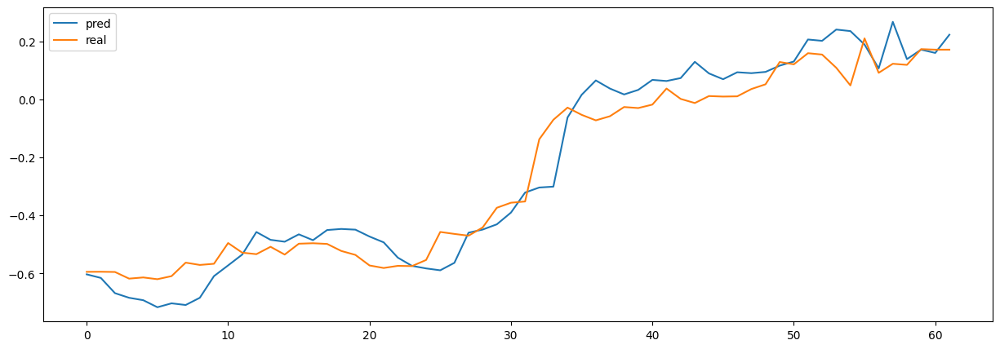

In [6]:
test_df.plot(figsize=(15,5))